# Neural Networks for Classification

In this notebook we are going to explore the use of Neural Networks for image classification. We are going to use a dataset of small images of clothes and accessories, the Fashion MNIST. You can find more information regarding the dataset here: https://pravarmahajan.github.io/fashion/

Each instance in the dataset consist of an image, in a format similar to the digit images you have seen in the previous homework, and a label. The labels correspond to the type of clothing, as follows:

| Label | Description |
| --- | --- |
| 0 | T-shirt/top |
| 1 | Trouser |
| 2 | Pullover |
| 3 | Dress |
| 4 | Coat |
| 5 | Sandal |
| 6 | Shirt |
| 7 | Sneaker |
| 8 | Bag |
| 9 | Ankle boot |

Let's first load the required packages.

In [ ]:
#load the required packages

%matplotlib inline  

import numpy as np
import scipy as sp
import matplotlib.pyplot as plt

import sklearn
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV

The following is a function to load the data, that we are going to use later in the notebook.

In [ ]:
# helper function to load Fashion MNIST dataset from disk
def load_fashion_mnist(path, kind='train'):
    import os
    import gzip
    import numpy as np
    labels_path = os.path.join(path, '%s-labels-idx1-ubyte.gz' % kind)
    images_path = os.path.join(path, '%s-images-idx3-ubyte.gz' % kind)
    with gzip.open(labels_path, 'rb') as lbpath:
        labels = np.frombuffer(lbpath.read(), dtype=np.uint8,offset=8)
    with gzip.open(images_path, 'rb') as imgpath:
        images = np.frombuffer(imgpath.read(), dtype=np.uint8,offset=16).reshape(len(labels), 784)
    return images, labels

## TO DO 0
Place your ID ("numero di matricola") that will be used as seed for random generator. Change the ID number in case you observe unexpected behaviours and want to test if this is due to randomization (e.g., train/test split). If you change the ID number explain why you have change it.

In [ ]:
ID = 4546872 # COMPLETE
np.random.seed(ID)

Now we load the dataset using the function above.

In [ ]:
#load the fashion MNIST dataset and normalize the features so that each value is in [0,1]
X, y = load_fashion_mnist("data")
# rescale the data
X = X / 255.0

Now we split the data into training and test. Make sure that each label is present at least 10 times
in the training set.

In [ ]:
#random permute the data and split into training and test taking the first 500
#data samples as training and the rest as test
permutation = np.random.permutation(X.shape[0])

X = X[permutation]
y = y[permutation]

m_training = 500

X_train, X_test = X[:m_training], X[m_training:]
y_train, y_test = y[:m_training], y[m_training:]

labels, freqs = np.unique(y_train, return_counts=True)
print("Labels in training dataset: ", labels)
print("Frequencies in training dataset: ", freqs)


Labels in training dataset:  [0 1 2 3 4 5 6 7 8 9]
Frequencies in training dataset:  [36 59 56 56 61 38 55 40 43 56]


The following function plots an image and the corresponding label, to be used to inspect the data when needed.

In [ ]:
#function for plotting a image and printing the corresponding label
def plot_input(X_matrix, labels, index):
    print("INPUT:")
    plt.imshow(
        X_matrix[index].reshape(28,28),
        cmap          = plt.cm.gray_r,
        interpolation = "nearest"
    )
    plt.show()
    print("LABEL: %i"%labels[index])
    return

Now let's test the function above and check few images.

INPUT:


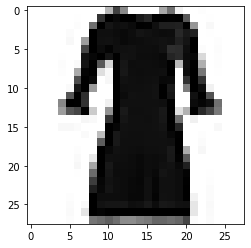

LABEL: 3
INPUT:


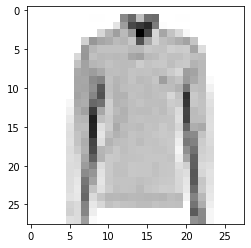

LABEL: 2
INPUT:


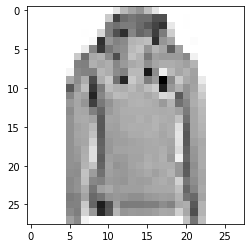

LABEL: 2


In [ ]:
#let's try the plotting function
plot_input(X_train,y_train,10)
plot_input(X_test,y_test,50)
plot_input(X_test,y_test,300)

## TO DO 1

Now use a (feed-forward) Neural Network for prediction. Use the multi-layer perceptron (MLP) classifier MLPClassifier(...) in scikit-learn, with the following parameters: max_iter=300, alpha=1e-4, solver='sgd', tol=1e-4, learning_rate_init=.1, random_state=ID (this last parameter ensures the run is the same even if you run it more than once). The alpha parameter is the regularization parameter for L2 regularization that is used by the MLP in sklearn.

Then, using the default activation function, pick four or five architectures to consider, with different numbers of hidden layers and different sizes. It is not necessary to create huge neural networks, you can limit to 3 layers and, for each layer, its maximum size can be of 100. You can evaluate the architectures you chose using the GridSearchCV with a 5-fold cross-validation, and use the results to pick the best architecture. The code below provides some architectures you can use, but you can choose other ones if you prefer.


In [ ]:
#MLPclassifier requires in input the parameter hidden_layer_sizes, that is a tuple specifying the number of 
#neurons in the hidden layers; for example: (10,) means that there is only 1 hidden layer with 10 neurons; 
#(10,50) means that there are 2 hidden layers, the first with 10 neurons, the second with 50 neurons

#these are examples of possible architectures you can test, but feel free to use different architectures! 
hl_parameters = {'hidden_layer_sizes': [(10,), (50,), (10,10,), (50,50,)]}

mlp_cv = MLPClassifier(max_iter=300, alpha=1e-4, solver='sgd', tol=1e-4, learning_rate_init=.1, random_state=ID)

clf = GridSearchCV(mlp_cv, hl_parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('RESULTS FOR NN\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")
scores = ['params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score']

for i in scores:
    print(results[i])

/usr/local/lib/python3.6/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


RESULTS FOR NN

{'mean_fit_time': array([0.60769272, 1.03835239, 0.25364113, 0.69070964]), 'std_fit_time': array([0.43679772, 0.28579099, 0.1059399 , 0.21202777]), 'mean_score_time': array([0.00110507, 0.00136633, 0.00105958, 0.00146165]), 'std_score_time': array([1.62892557e-04, 4.63306624e-05, 3.33661329e-05, 2.36708228e-05]), 'param_hidden_layer_sizes': masked_array(data=[(10,), (50,), (10, 10), (50, 50)],
             mask=[False, False, False, False],
       fill_value='?',
            dtype=object), 'params': [{'hidden_layer_sizes': (10,)}, {'hidden_layer_sizes': (50,)}, {'hidden_layer_sizes': (10, 10)}, {'hidden_layer_sizes': (50, 50)}], 'split0_test_score': array([0.69, 0.79, 0.64, 0.81]), 'split1_test_score': array([0.74, 0.7 , 0.61, 0.72]), 'split2_test_score': array([0.61, 0.78, 0.19, 0.11]), 'split3_test_score': array([0.66, 0.67, 0.66, 0.71]), 'split4_test_score': array([0.73, 0.74, 0.75, 0.72]), 'mean_test_score': array([0.686, 0.736, 0.57 , 0.614]), 'std_test_score': arr

## TO DO 2

What do you observe for different architectures and their scores? How do the number of layers and their sizes affect the performances?


Best architecture is 1 hidden layer and 50 neuron. In this example, if we consider this result, we can say that increasing number of neuron increased score and increasing number of hidden layer decreased it.

## TO DO 3

Now get training and test error (according to the initial split) for a NN with best parameters chosen from the cross-validation above (and learning the NN weights from the entire training set). Use verbose=True
in input so to see how loss changes in iterations. (Note that the loss used by the MLPclassifier may be different from the 0-1 loss, also called *accuracy*.)

In [ ]:
#get training and test error for the best NN model from CV

mlp = MLPClassifier(hidden_layer_sizes=(50,), max_iter=300, alpha=1e-4, solver='sgd', tol=1e-4, learning_rate_init=.1, random_state=ID).fit(X_train,y_train)

training_error = 1. - mlp.score(X_train,y_train)

test_error = 1. - mlp.score(X_test,y_test)

print ('\nRESULTS FOR BEST NN\n')

print ("Best NN training error: %f" % training_error)
print ("Best NN test error: %f" % test_error)


RESULTS FOR BEST NN

Best NN training error: 0.000000
Best NN test error: 0.222286


## More data 
Now let's do the same but using 10000 (or less if it takes too long on your machine) data points for training. Use the same NN architectures as before, but you can try more if you want!

In [ ]:
X = X[permutation]
y = y[permutation]

m_training = 10000

X_train, X_test = X[:m_training], X[m_training:]
y_train, y_test = y[:m_training], y[m_training:]

print("Labels and frequencies in training dataset: ")
np.unique(y_train, return_counts=True)

Labels and frequencies in training dataset: 


(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8),
 array([1004, 1037,  997, 1018,  978, 1003,  994, 1033,  973,  963]))

## TO DO 4

Now train the NNs with the added data points. Feel free to try more different architectures than before if you want, or less if it takes too much time. You can use 'verbose=True' so have an idea of how long it takes to run 1 iteration (eventually reduce also the number of iterations to 50).

In [ ]:
#for NN we try the same architectures as before
hl_parameters = {'hidden_layer_sizes': [(10,), (50,), (10,10,), (50,50,), (25,), (50,25,), (50,10,)]}

mlp_large_cv = MLPClassifier(max_iter=300, alpha=1e-4, solver='sgd', tol=1e-4, learning_rate_init=.1, random_state=ID, verbose=True)


clf = GridSearchCV(mlp_cv, hl_parameters, cv=5)
clf.fit(X_train, y_train)
results = clf.cv_results_

print ('RESULTS FOR NN\n')
print(results)

print("Best parameters set found:")
print(clf.best_params_)

print("Score with best parameters:")
print([clf.best_params_, clf.best_score_])

print("\nAll scores on the grid:")
scores = ['params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score']

for i in scores:
    print(results[i])

RESULTS FOR NN

{'mean_fit_time': array([ 8.04960961, 20.31332655,  6.1540729 , 14.89942212, 11.45445619,
       14.63251591, 11.77930222]), 'std_fit_time': array([1.70022824, 4.42131589, 1.19945429, 2.87714329, 2.23190568,
       1.19166576, 2.50114821]), 'mean_score_time': array([0.00733171, 0.01157999, 0.0075367 , 0.01591182, 0.0087512 ,
       0.01233459, 0.01188388]), 'std_score_time': array([0.00017181, 0.00035192, 0.00015014, 0.00469177, 0.00011843,
       0.00021765, 0.00043833]), 'param_hidden_layer_sizes': masked_array(data=[(10,), (50,), (10, 10), (50, 50), (25,), (50, 25),
                   (50, 10)],
             mask=[False, False, False, False, False, False, False],
       fill_value='?',
            dtype=object), 'params': [{'hidden_layer_sizes': (10,)}, {'hidden_layer_sizes': (50,)}, {'hidden_layer_sizes': (10, 10)}, {'hidden_layer_sizes': (50, 50)}, {'hidden_layer_sizes': (25,)}, {'hidden_layer_sizes': (50, 25)}, {'hidden_layer_sizes': (50, 10)}], 'split0_test_score

## TO DO 5
Describe your architecture choices and the results you observe with respect to the architectures you used.

My architecture choices's hidden layers are (25,), (50,25,), (50,10,) and also I added verbose=True. I chose them because I tought maybe if I can decrease a few of neuron of best model or adding a seccond hidden layer and keeping its neuron number small could increase my score. My architectures with respectively as above took place 3, 4, 5 and it means my choices are not best model but they are avarage models for this models.

## TO DO 6

Get the train and test error for the best NN you obtained with 10000 points. This time you can run for 100 iterations if you cannot run for 300 iterations. 


In [ ]:
#get training and test error for the best NN model from CV

best_mlp_large = MLPClassifier(hidden_layer_sizes=(50,), max_iter=300, alpha=1e-4, solver='sgd', tol=1e-4, learning_rate_init=.1, random_state=ID, verbose=True).fit(X_train,y_train)

training_error = 1. - mlp.score(X_train,y_train)

test_error = 1. - mlp.score(X_test,y_test)

print ('\nRESULTS FOR BEST NN\n')

print ("Best NN training error: %f" % training_error)
print ("Best NN test error: %f" % test_error)

Iteration 1, loss = 0.90133860
Iteration 2, loss = 0.52623815
Iteration 3, loss = 0.46629212
Iteration 4, loss = 0.42783699
Iteration 5, loss = 0.38768720
Iteration 6, loss = 0.36950551
Iteration 7, loss = 0.34904544
Iteration 8, loss = 0.33941409
Iteration 9, loss = 0.32041802
Iteration 10, loss = 0.30593633
Iteration 11, loss = 0.29874886
Iteration 12, loss = 0.27852633
Iteration 13, loss = 0.27021931
Iteration 14, loss = 0.26222815
Iteration 15, loss = 0.25096049
Iteration 16, loss = 0.25000270
Iteration 17, loss = 0.23745163
Iteration 18, loss = 0.23299413
Iteration 19, loss = 0.22959826
Iteration 20, loss = 0.21436912
Iteration 21, loss = 0.20146429
Iteration 22, loss = 0.20252435
Iteration 23, loss = 0.20240315
Iteration 24, loss = 0.20650729
Iteration 25, loss = 0.18961839
Iteration 26, loss = 0.17960878
Iteration 27, loss = 0.17116285
Iteration 28, loss = 0.17834049
Iteration 29, loss = 0.17929755
Iteration 30, loss = 0.16070456
Iteration 31, loss = 0.15916975
Iteration 32, los

## TO DO 7

Compare the train and test error you got with a large number of samples with the best one you obtained with only 500 data points. Are the architectures the same or do they differ? What about the errors you get?

Except verbose=True other parts of architectures was same. Large number of samples's training error = 0.220100, test error = 0.220500 and small number of samples's training error = 0, test error = 222286. It means, because Large number of samples's test error is less than small number of samples's test error we could say that with Large number of samples we get better results. Also, if we check training errors we can see Large number of samples's training error is nearly same as test error and small number of samples's training error = 0. It means with small number of samples our model overriding and with Large number of samples our model finding optimum.

## TO DO 8

Plot an image that was missclassified by NN with m=500 training data points and it is now instead correctly classified by NN with m=10000 training data points.

INPUT:


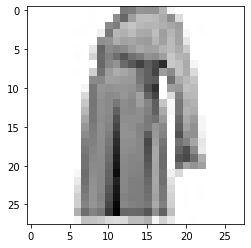

LABEL: 3
INPUT:


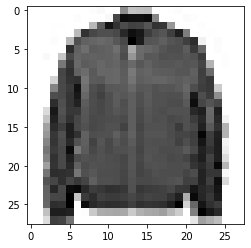

LABEL: 4
INPUT:


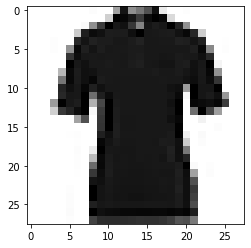

LABEL: 0
INPUT:


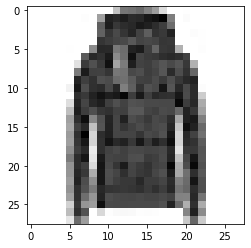

LABEL: 2
INPUT:


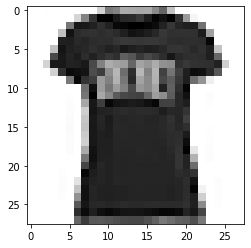

LABEL: 0
INPUT:


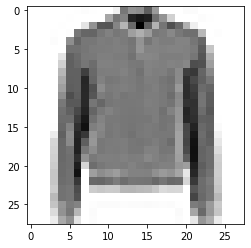

LABEL: 4
INPUT:


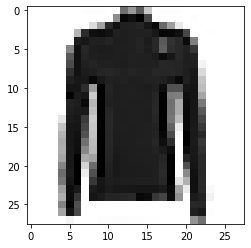

LABEL: 2
INPUT:


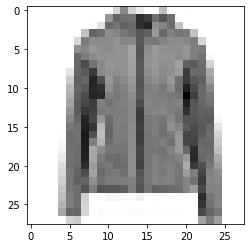

LABEL: 4
INPUT:


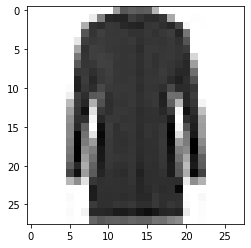

LABEL: 4
INPUT:


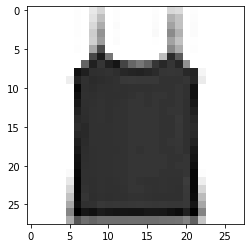

LABEL: 0
INPUT:


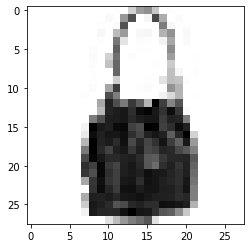

LABEL: 8
INPUT:


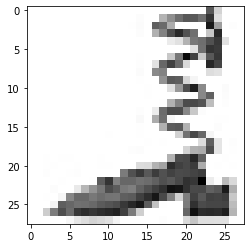

LABEL: 5
INPUT:


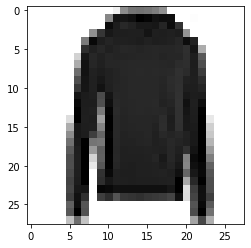

LABEL: 2
INPUT:


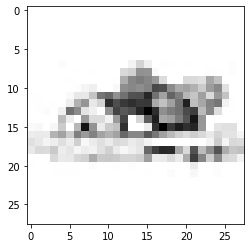

LABEL: 5
INPUT:


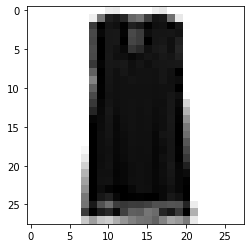

LABEL: 6
INPUT:


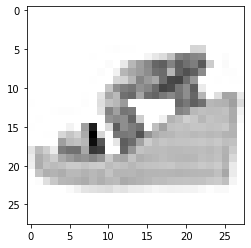

LABEL: 5
INPUT:


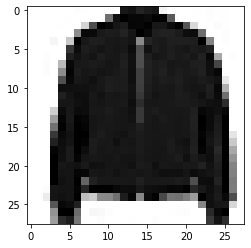

LABEL: 4
INPUT:


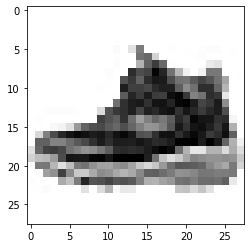

LABEL: 9
INPUT:


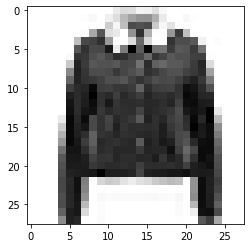

LABEL: 4
INPUT:


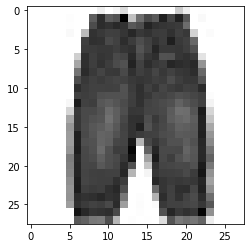

LABEL: 1
INPUT:


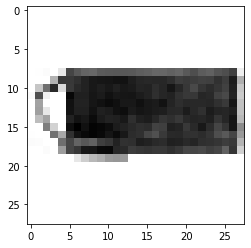

LABEL: 8
INPUT:


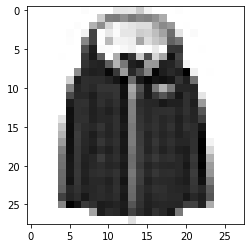

LABEL: 4
INPUT:


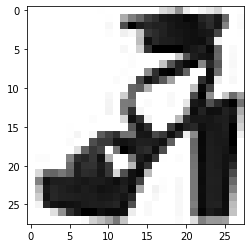

LABEL: 5
INPUT:


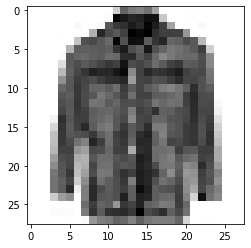

LABEL: 4
INPUT:


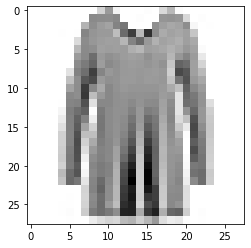

LABEL: 2
INPUT:


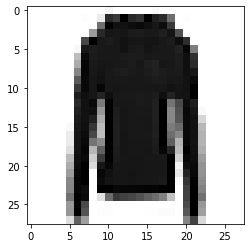

LABEL: 2
INPUT:


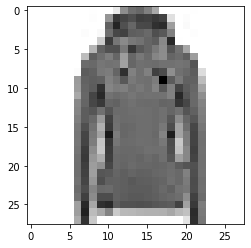

LABEL: 2
INPUT:


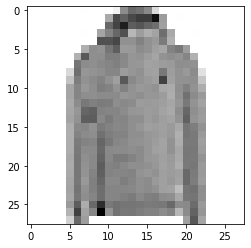

LABEL: 2
INPUT:


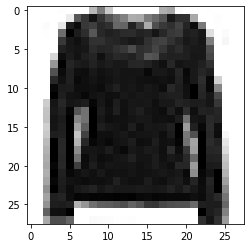

LABEL: 6
INPUT:


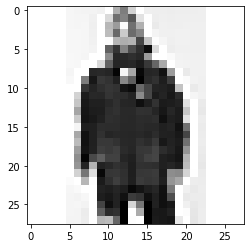

LABEL: 4
INPUT:


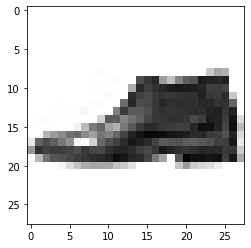

LABEL: 9
INPUT:


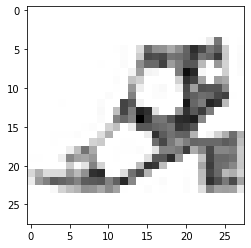

LABEL: 5
INPUT:


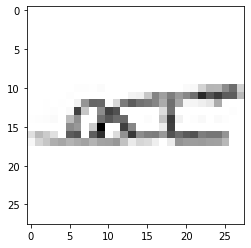

LABEL: 5
INPUT:


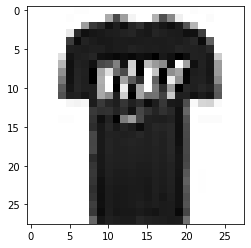

LABEL: 0
INPUT:


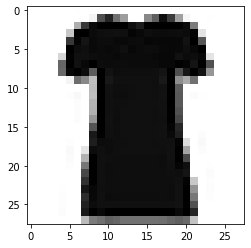

LABEL: 0
INPUT:


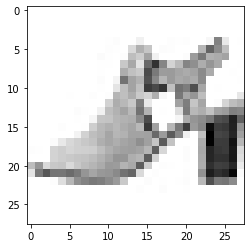

LABEL: 5
INPUT:


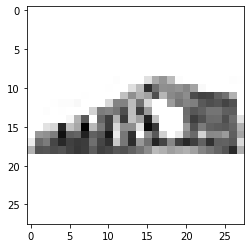

LABEL: 5
INPUT:


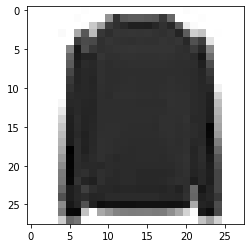

LABEL: 2
INPUT:


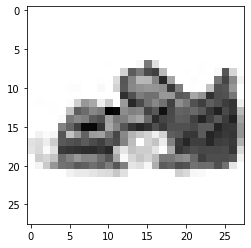

LABEL: 5
INPUT:


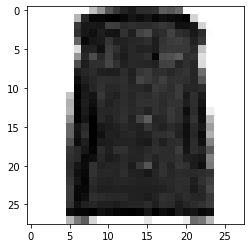

LABEL: 4
INPUT:


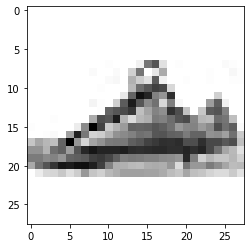

LABEL: 7
INPUT:


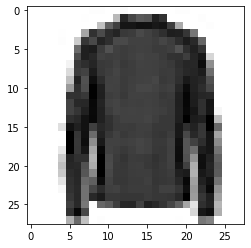

LABEL: 6
INPUT:


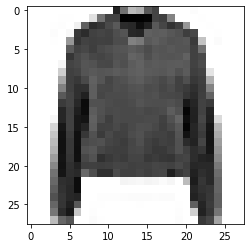

LABEL: 4
INPUT:


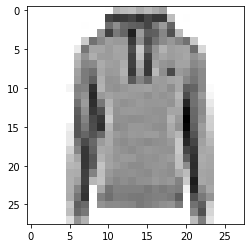

LABEL: 2
INPUT:


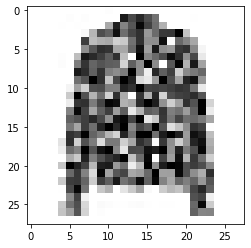

LABEL: 6
INPUT:


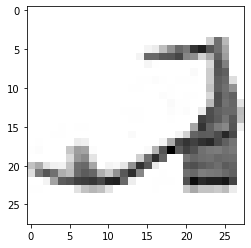

LABEL: 5
INPUT:


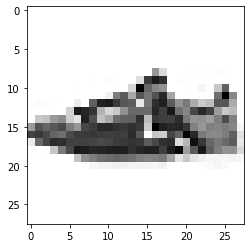

LABEL: 7
INPUT:


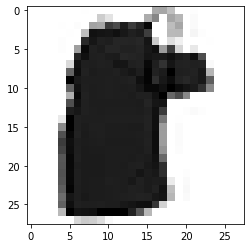

LABEL: 6
INPUT:


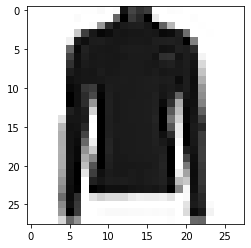

LABEL: 2
INPUT:


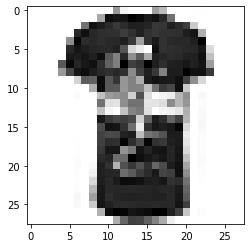

LABEL: 0
INPUT:


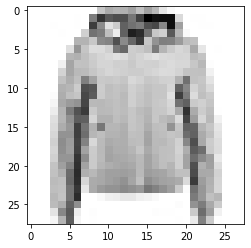

LABEL: 4
INPUT:


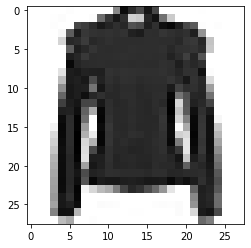

LABEL: 6
INPUT:


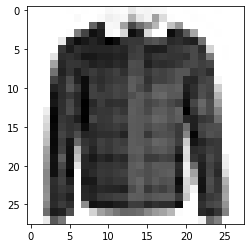

LABEL: 4
INPUT:


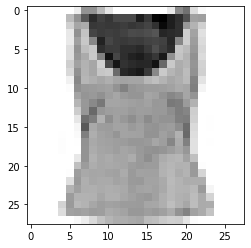

LABEL: 6
INPUT:


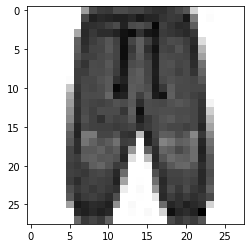

LABEL: 1
INPUT:


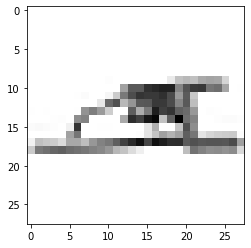

LABEL: 5
INPUT:


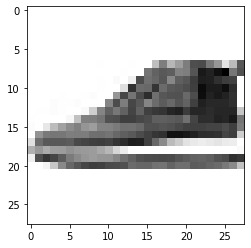

LABEL: 9
INPUT:


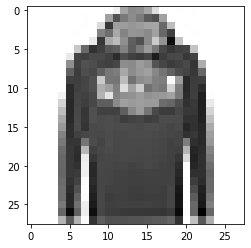

LABEL: 2
INPUT:


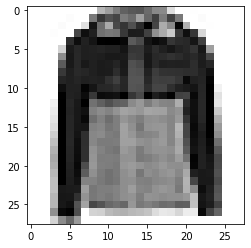

LABEL: 4
INPUT:


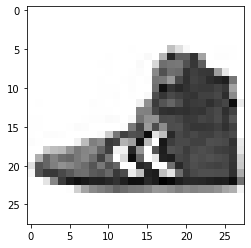

LABEL: 7
INPUT:


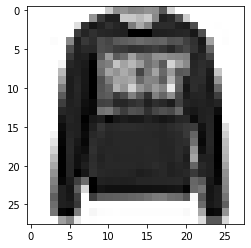

LABEL: 2
INPUT:


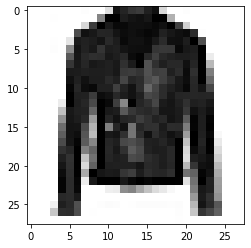

LABEL: 4
INPUT:


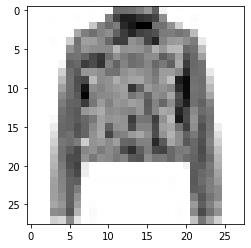

LABEL: 4
INPUT:


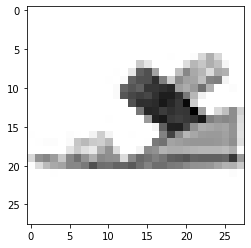

LABEL: 5
INPUT:


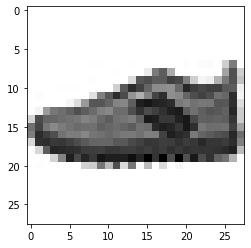

LABEL: 7
INPUT:


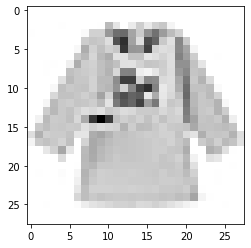

LABEL: 3
INPUT:


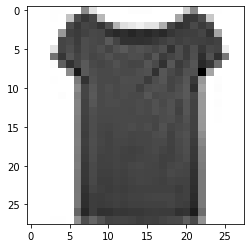

LABEL: 0
INPUT:


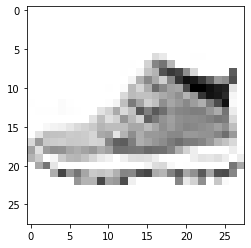

LABEL: 9
INPUT:


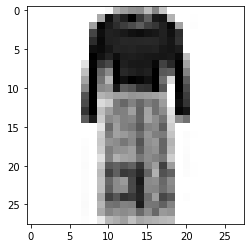

LABEL: 3
INPUT:


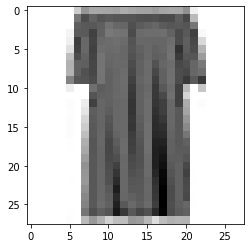

LABEL: 3
INPUT:


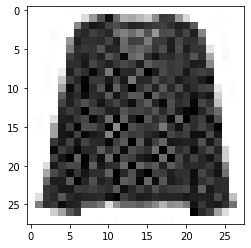

LABEL: 6
INPUT:


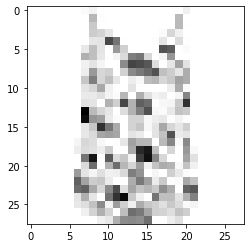

LABEL: 0
INPUT:


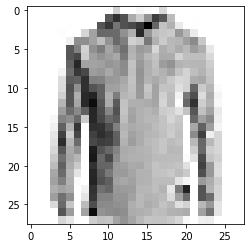

LABEL: 2
INPUT:


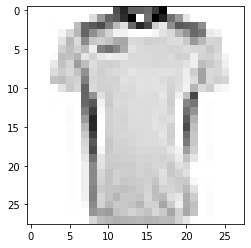

LABEL: 0
INPUT:


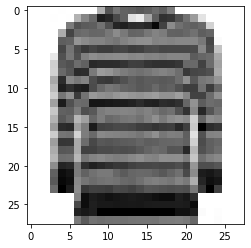

LABEL: 2
INPUT:


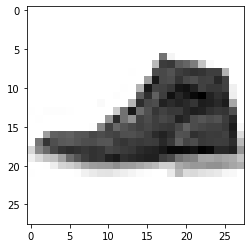

LABEL: 9
INPUT:


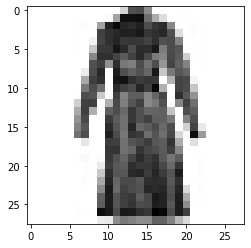

LABEL: 3
INPUT:


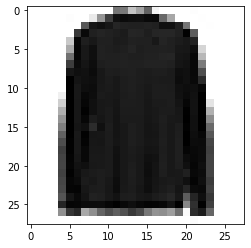

LABEL: 6
INPUT:


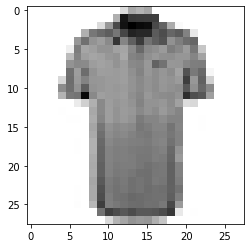

LABEL: 6
INPUT:


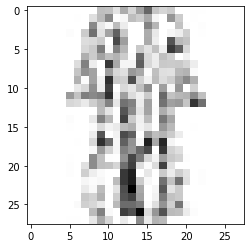

LABEL: 3
INPUT:


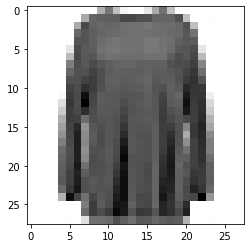

LABEL: 2
INPUT:


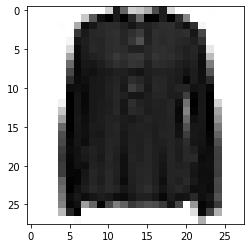

LABEL: 6
INPUT:


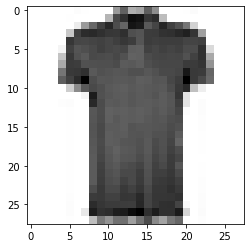

LABEL: 0
INPUT:


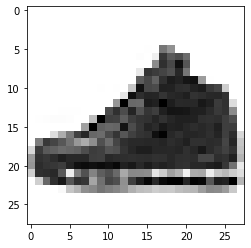

LABEL: 7
INPUT:


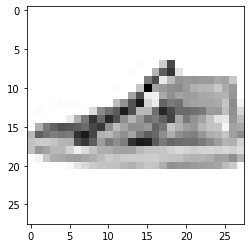

LABEL: 7
INPUT:


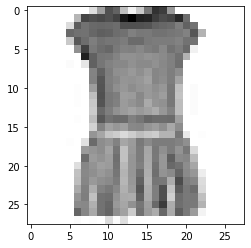

LABEL: 3
INPUT:


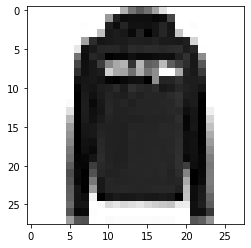

LABEL: 2
INPUT:


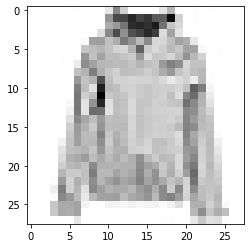

LABEL: 4
INPUT:


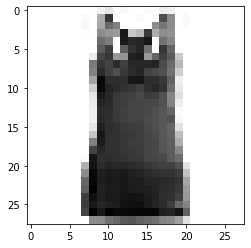

LABEL: 0
INPUT:


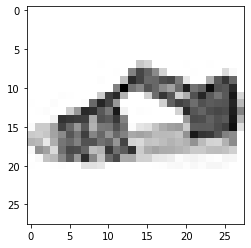

LABEL: 5
INPUT:


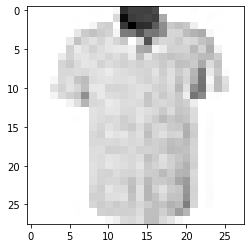

LABEL: 6
INPUT:


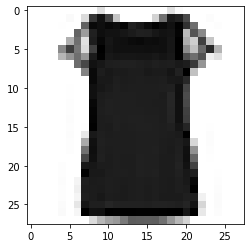

LABEL: 0
INPUT:


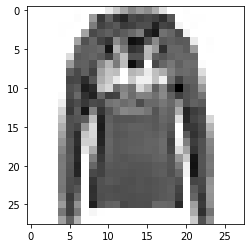

LABEL: 2
INPUT:


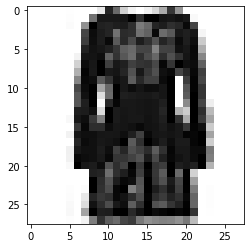

LABEL: 3
INPUT:


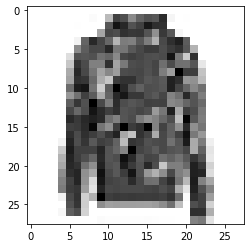

LABEL: 2
INPUT:


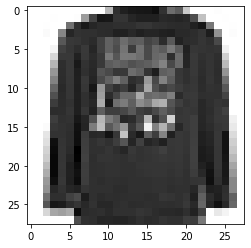

LABEL: 2
INPUT:


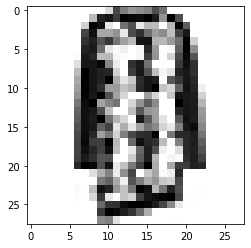

LABEL: 3
INPUT:


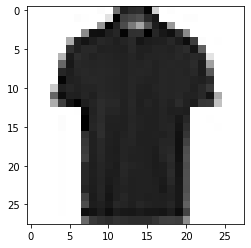

LABEL: 0
INPUT:


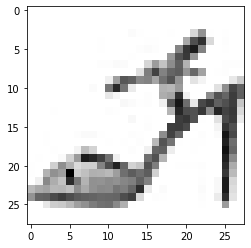

LABEL: 5
INPUT:


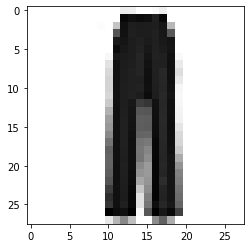

LABEL: 1
INPUT:


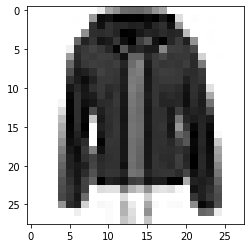

LABEL: 4
INPUT:


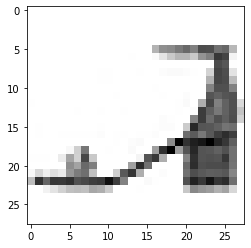

LABEL: 5
INPUT:


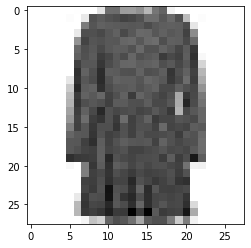

LABEL: 3
INPUT:


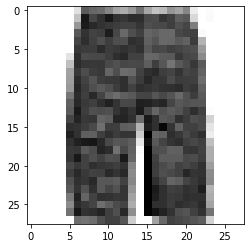

LABEL: 1
INPUT:


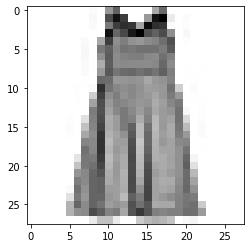

LABEL: 3
INPUT:


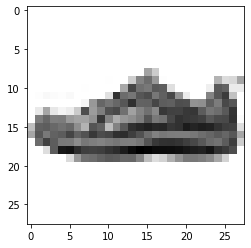

LABEL: 7
INPUT:


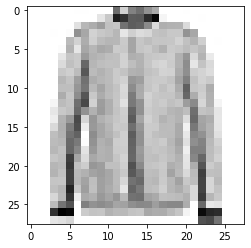

LABEL: 6
INPUT:


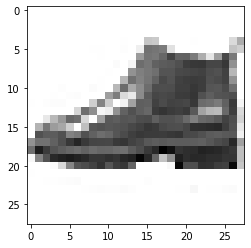

LABEL: 9
INPUT:


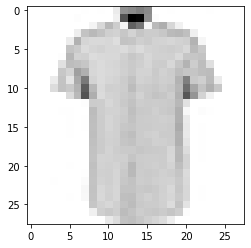

LABEL: 6
INPUT:


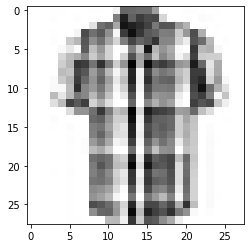

LABEL: 6
INPUT:


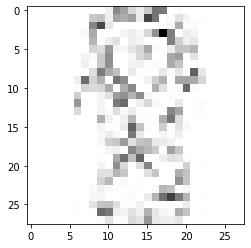

LABEL: 3
INPUT:


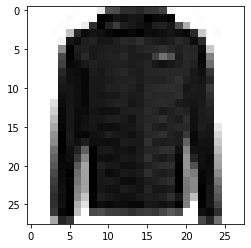

LABEL: 4
INPUT:


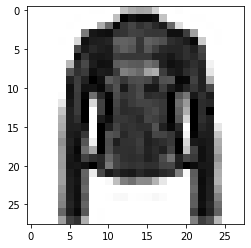

LABEL: 4
INPUT:


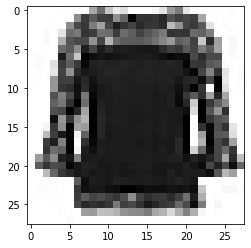

LABEL: 6
INPUT:


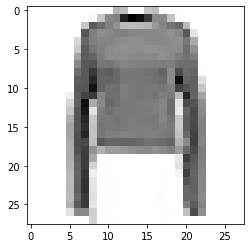

LABEL: 2
INPUT:


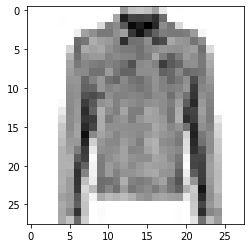

LABEL: 4
INPUT:


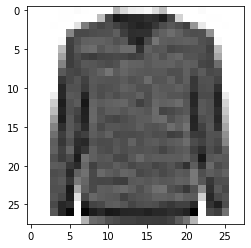

LABEL: 2
INPUT:


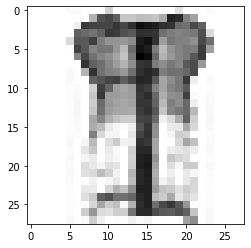

LABEL: 6
INPUT:


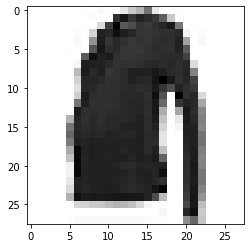

LABEL: 2
INPUT:


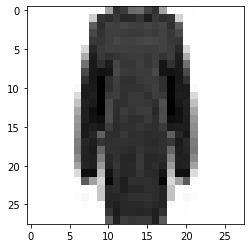

LABEL: 3
INPUT:


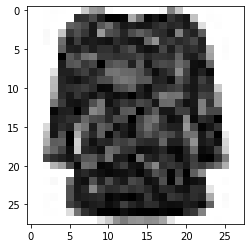

LABEL: 6
INPUT:


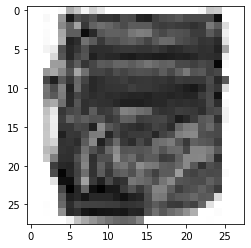

LABEL: 8
INPUT:


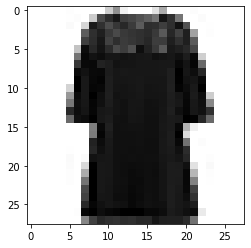

LABEL: 3
INPUT:


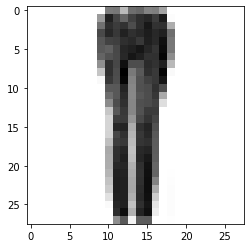

LABEL: 1
INPUT:


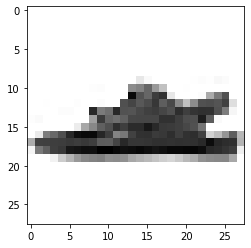

LABEL: 5
INPUT:


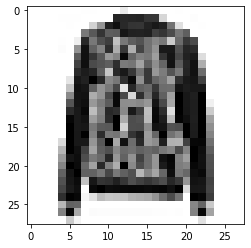

LABEL: 2
INPUT:


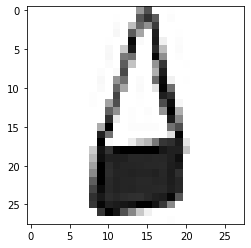

LABEL: 8
INPUT:


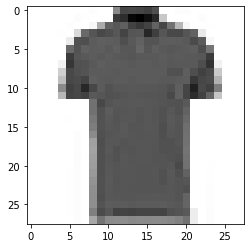

LABEL: 0
INPUT:


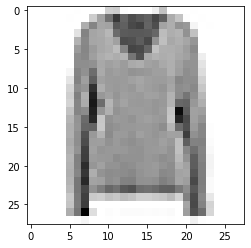

LABEL: 2
INPUT:


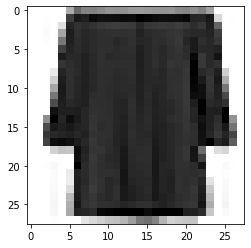

LABEL: 6
INPUT:


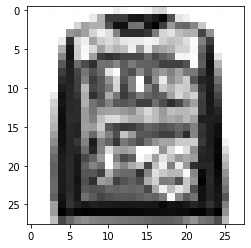

LABEL: 2
INPUT:


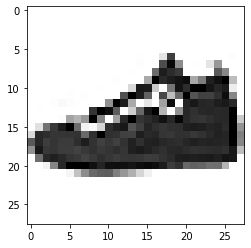

LABEL: 7
INPUT:


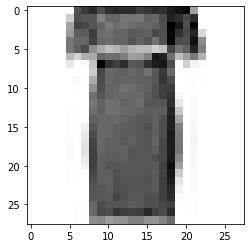

LABEL: 3
INPUT:


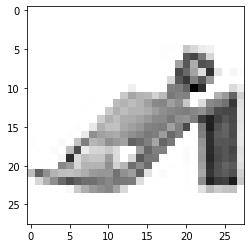

LABEL: 5
INPUT:


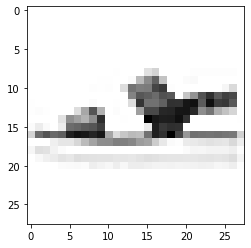

LABEL: 5
INPUT:


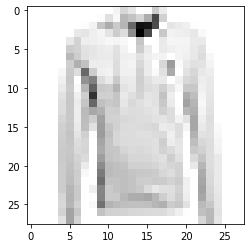

LABEL: 2
INPUT:


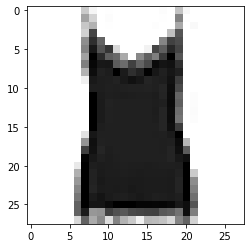

LABEL: 0
INPUT:


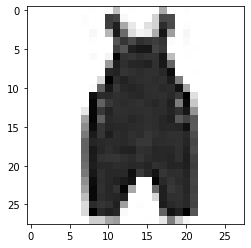

LABEL: 1
INPUT:


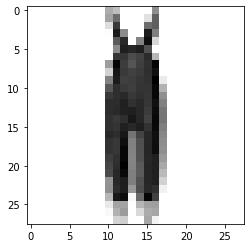

LABEL: 1
INPUT:


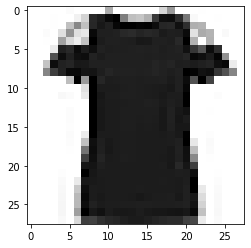

LABEL: 0
INPUT:


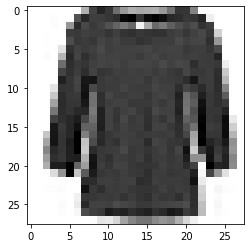

LABEL: 6
INPUT:


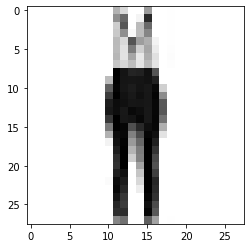

LABEL: 1
INPUT:


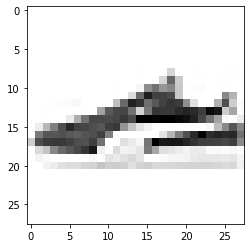

LABEL: 7
INPUT:


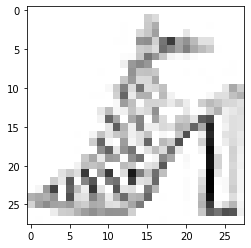

LABEL: 5
INPUT:


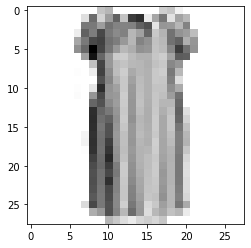

LABEL: 3
INPUT:


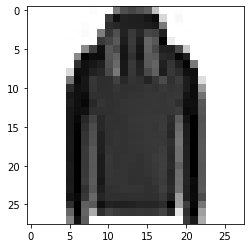

LABEL: 2
INPUT:


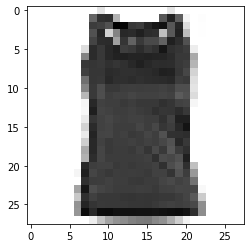

LABEL: 0
INPUT:


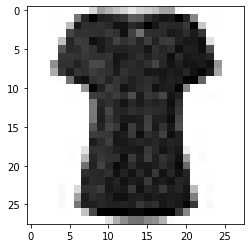

LABEL: 0
INPUT:


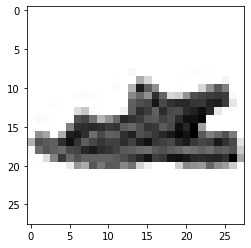

LABEL: 5
INPUT:


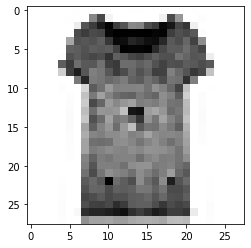

LABEL: 0
INPUT:


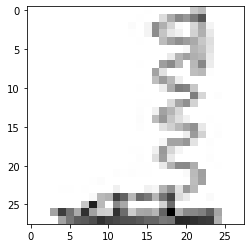

LABEL: 5
INPUT:


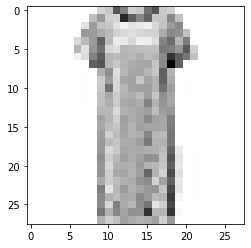

LABEL: 3
INPUT:


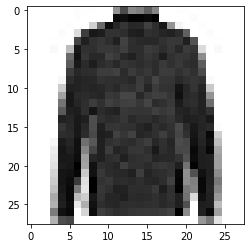

LABEL: 6
INPUT:


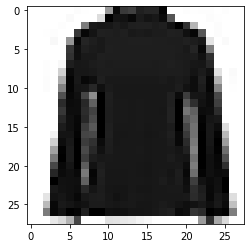

LABEL: 6
INPUT:


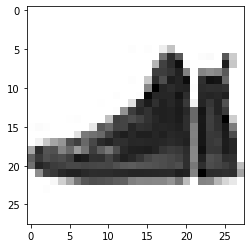

LABEL: 7
INPUT:


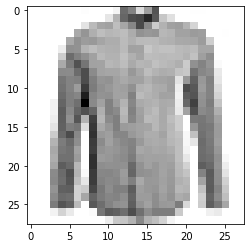

LABEL: 6
INPUT:


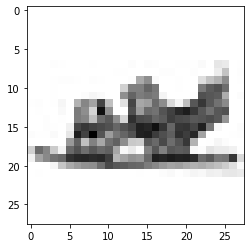

LABEL: 5
INPUT:


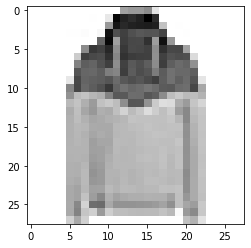

LABEL: 2
INPUT:


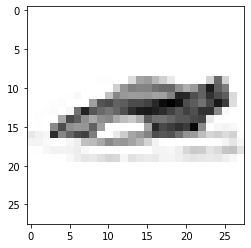

LABEL: 5
INPUT:


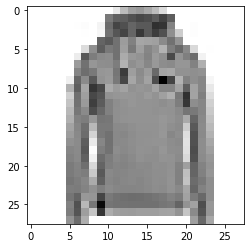

LABEL: 2
INPUT:


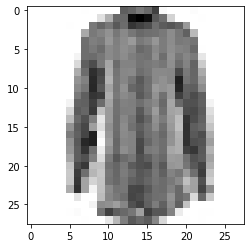

LABEL: 6
INPUT:


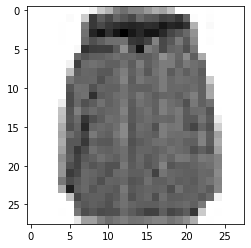

LABEL: 4
INPUT:


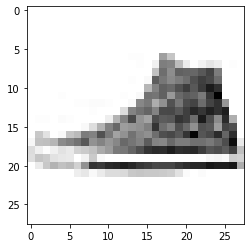

LABEL: 7
INPUT:


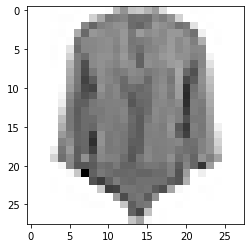

LABEL: 6
INPUT:


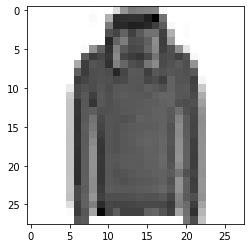

LABEL: 2
INPUT:


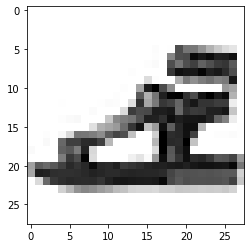

LABEL: 5
INPUT:


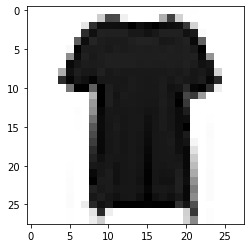

LABEL: 0
INPUT:


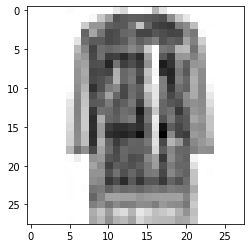

LABEL: 3
INPUT:


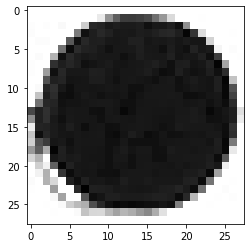

LABEL: 8
INPUT:


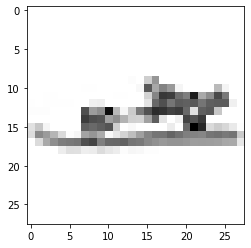

LABEL: 5
INPUT:


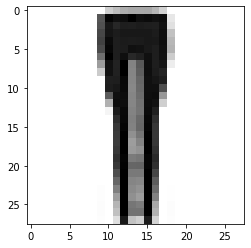

LABEL: 1
INPUT:


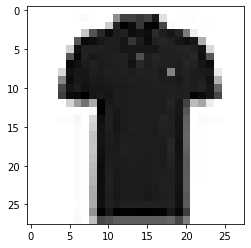

LABEL: 0
INPUT:


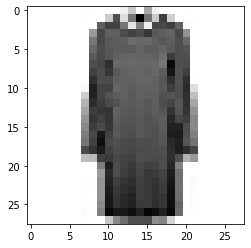

LABEL: 3
INPUT:


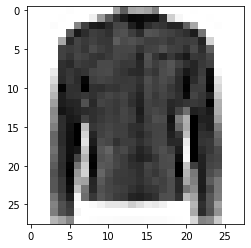

LABEL: 4
INPUT:


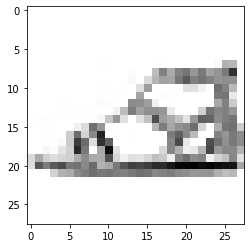

LABEL: 5
INPUT:


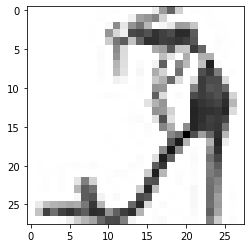

LABEL: 5
INPUT:


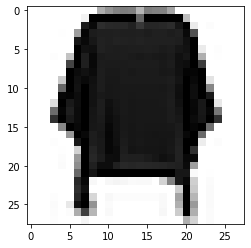

LABEL: 6
INPUT:


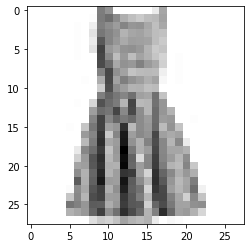

LABEL: 3
INPUT:


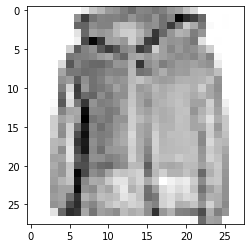

LABEL: 4
INPUT:


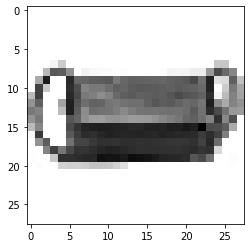

LABEL: 8
INPUT:


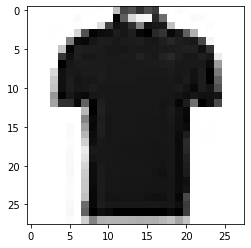

LABEL: 0
INPUT:


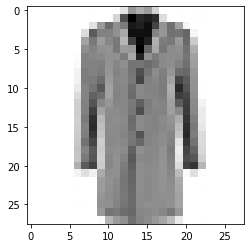

LABEL: 4
INPUT:


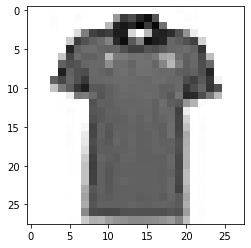

LABEL: 0
INPUT:


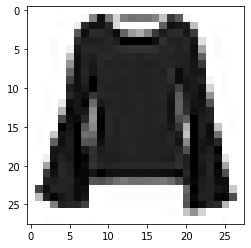

LABEL: 6
INPUT:


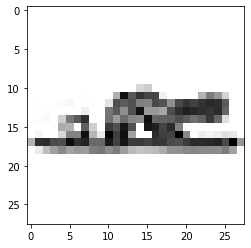

LABEL: 5
INPUT:


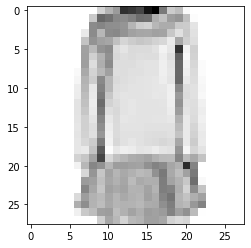

LABEL: 3
INPUT:


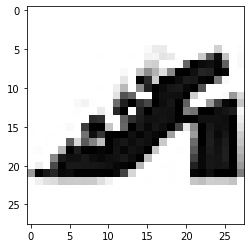

LABEL: 5
INPUT:


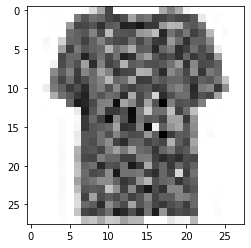

LABEL: 6
INPUT:


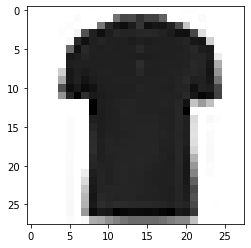

LABEL: 0
INPUT:


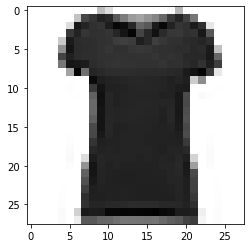

LABEL: 0
INPUT:


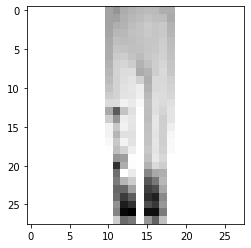

LABEL: 1
INPUT:


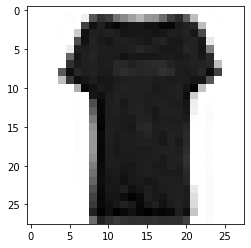

LABEL: 0
INPUT:


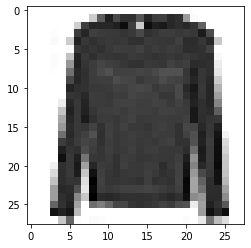

LABEL: 6
INPUT:


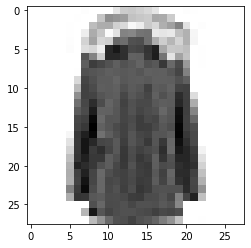

LABEL: 4
INPUT:


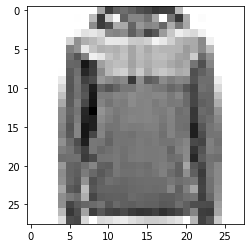

LABEL: 2
INPUT:


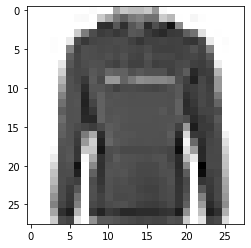

LABEL: 2
INPUT:


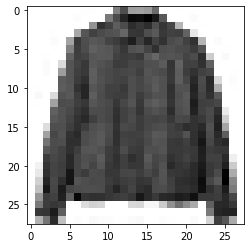

LABEL: 4
INPUT:


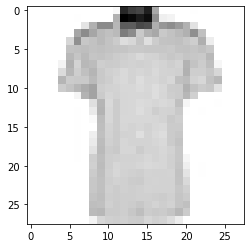

LABEL: 6
INPUT:


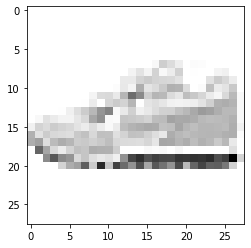

LABEL: 7
INPUT:


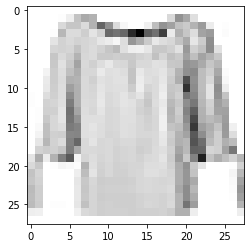

LABEL: 6
INPUT:


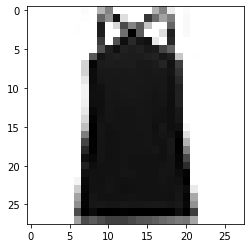

LABEL: 6
INPUT:


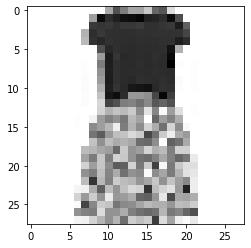

LABEL: 3
INPUT:


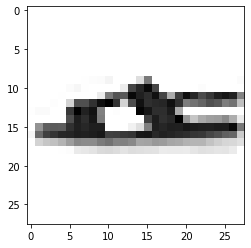

LABEL: 5
INPUT:


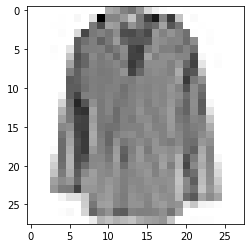

LABEL: 4
INPUT:


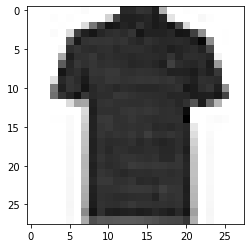

LABEL: 0
INPUT:


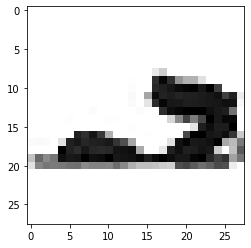

LABEL: 5
INPUT:


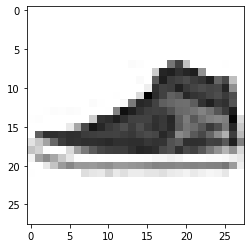

LABEL: 7
INPUT:


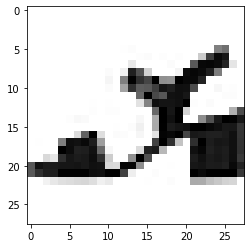

LABEL: 5
INPUT:


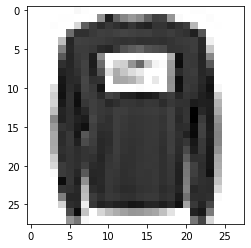

LABEL: 2
INPUT:


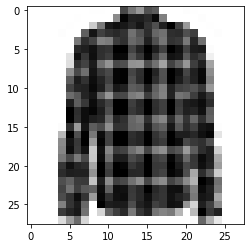

LABEL: 6
INPUT:


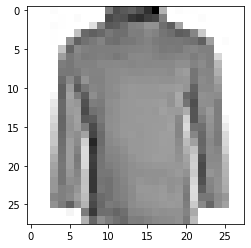

LABEL: 2
INPUT:


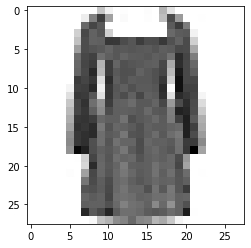

LABEL: 3
INPUT:


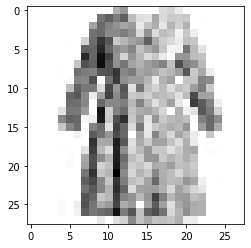

LABEL: 3
INPUT:


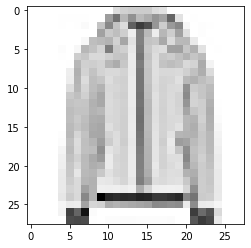

LABEL: 4
INPUT:


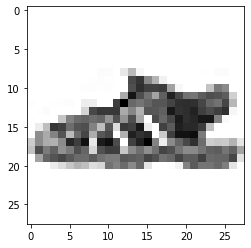

LABEL: 5
INPUT:


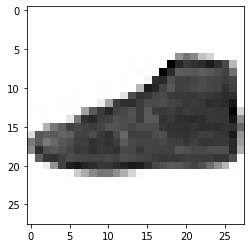

LABEL: 7
INPUT:


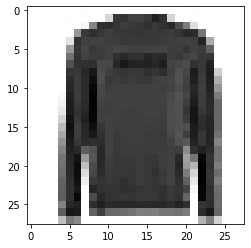

LABEL: 2
INPUT:


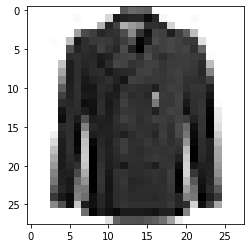

LABEL: 4
INPUT:


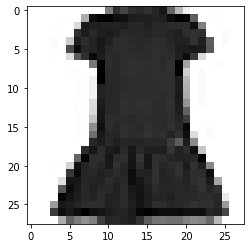

LABEL: 3
INPUT:


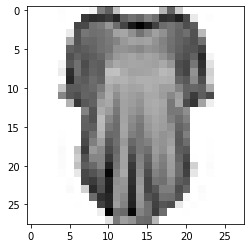

LABEL: 0
INPUT:


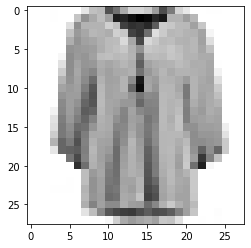

LABEL: 6
INPUT:


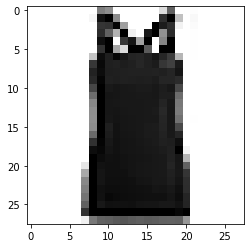

LABEL: 0
INPUT:


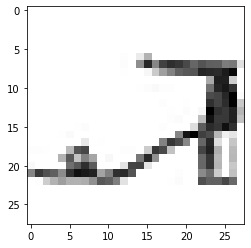

LABEL: 5
INPUT:


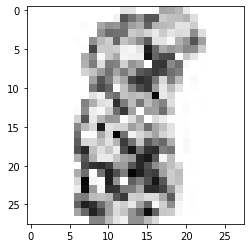

LABEL: 0
INPUT:


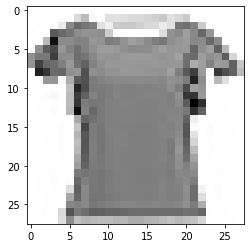

LABEL: 6
INPUT:


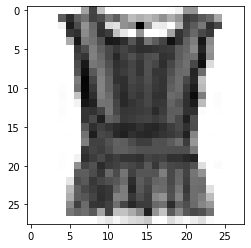

LABEL: 6
INPUT:


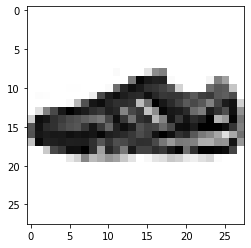

LABEL: 7
INPUT:


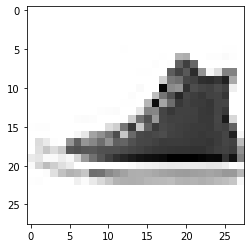

LABEL: 7
INPUT:


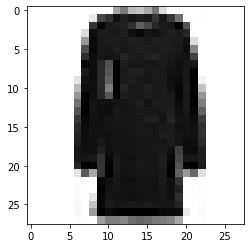

LABEL: 3
INPUT:


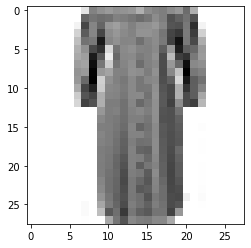

LABEL: 3
INPUT:


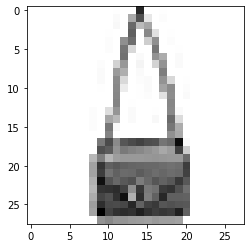

LABEL: 8
INPUT:


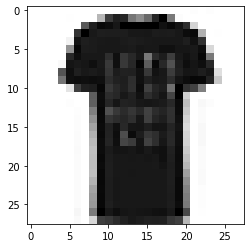

LABEL: 0
INPUT:


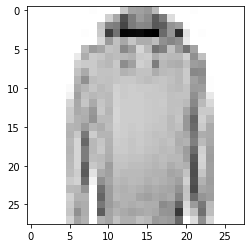

LABEL: 2
INPUT:


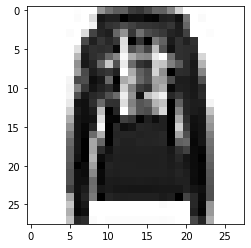

LABEL: 2
INPUT:


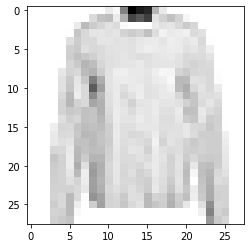

LABEL: 6
INPUT:


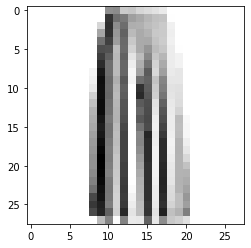

LABEL: 1
INPUT:


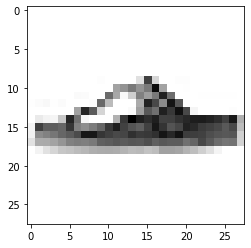

LABEL: 5
INPUT:


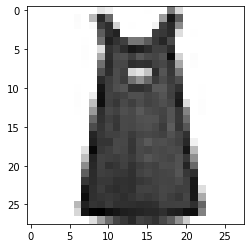

LABEL: 3
INPUT:


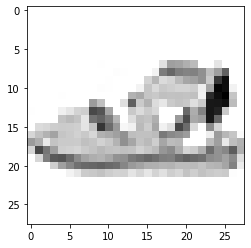

LABEL: 5
INPUT:


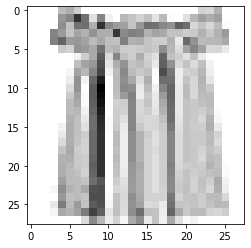

LABEL: 6
INPUT:


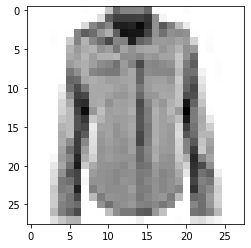

LABEL: 6
INPUT:


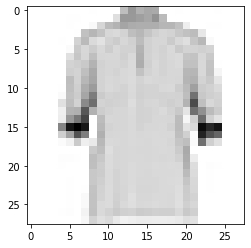

LABEL: 6
INPUT:


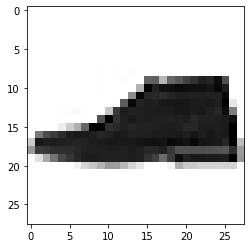

LABEL: 9
INPUT:


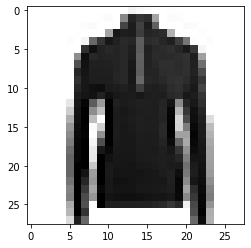

LABEL: 2
INPUT:


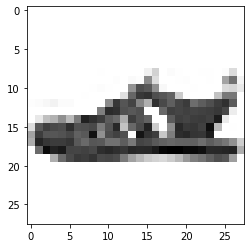

LABEL: 5
INPUT:


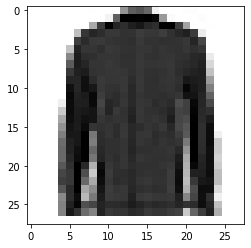

LABEL: 6
INPUT:


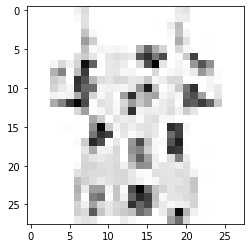

LABEL: 6
INPUT:


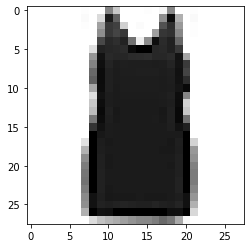

LABEL: 0
INPUT:


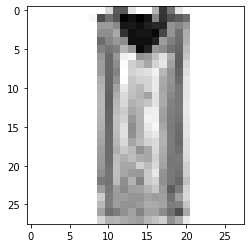

LABEL: 3
INPUT:


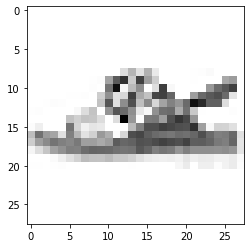

LABEL: 5
INPUT:


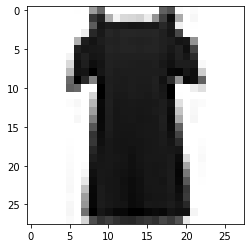

LABEL: 3
INPUT:


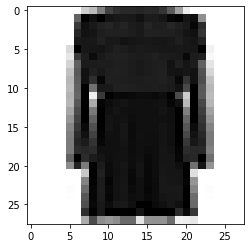

LABEL: 3
INPUT:


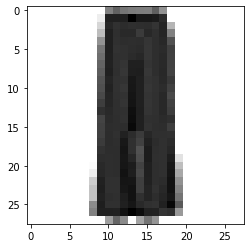

LABEL: 1
INPUT:


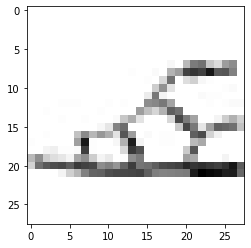

LABEL: 5
INPUT:


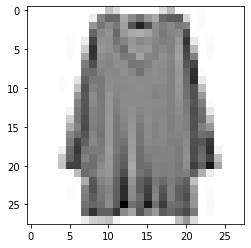

LABEL: 2
INPUT:


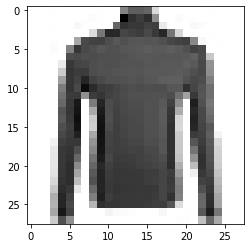

LABEL: 2
INPUT:


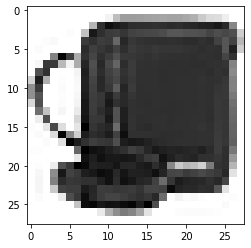

LABEL: 8
INPUT:


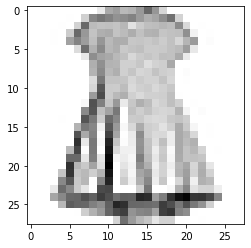

LABEL: 3
INPUT:


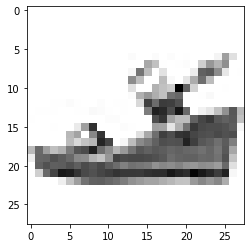

LABEL: 5
INPUT:


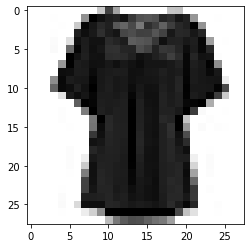

LABEL: 6
INPUT:


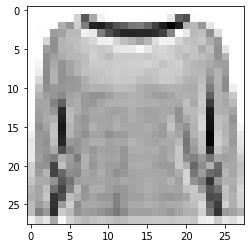

LABEL: 2
INPUT:


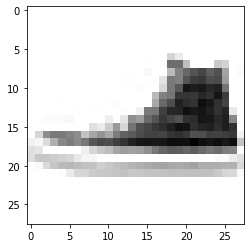

LABEL: 7
INPUT:


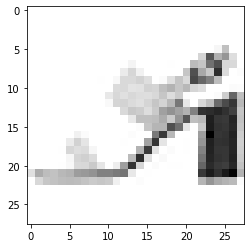

LABEL: 5
INPUT:


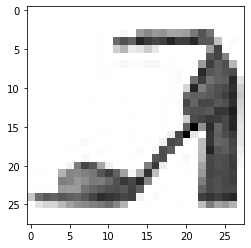

LABEL: 5
INPUT:


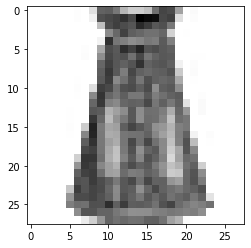

LABEL: 3
INPUT:


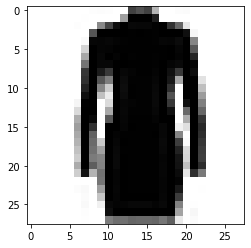

LABEL: 3
INPUT:


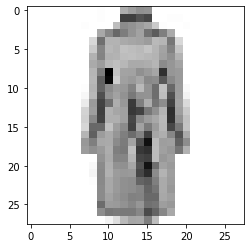

LABEL: 4
INPUT:


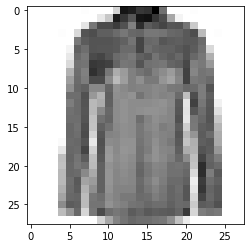

LABEL: 6
INPUT:


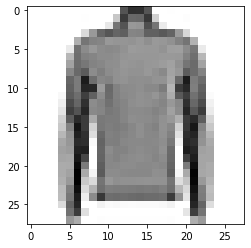

LABEL: 2
INPUT:


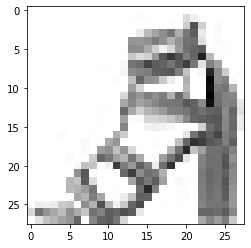

LABEL: 5
INPUT:


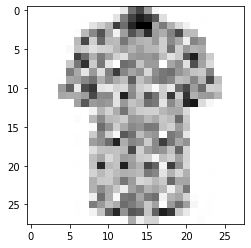

LABEL: 6
INPUT:


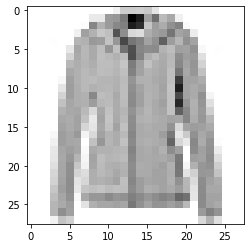

LABEL: 4
INPUT:


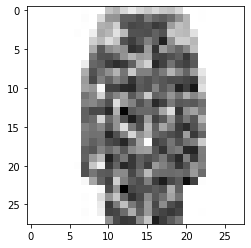

LABEL: 4
INPUT:


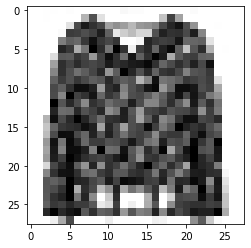

LABEL: 6
INPUT:


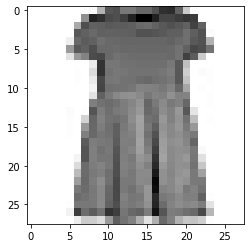

LABEL: 3
INPUT:


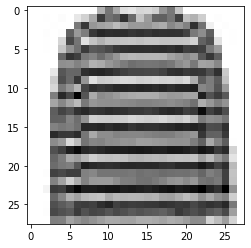

LABEL: 2
INPUT:


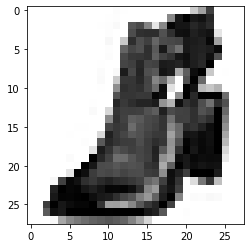

LABEL: 5
INPUT:


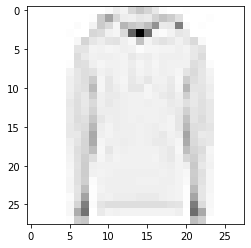

LABEL: 2
INPUT:


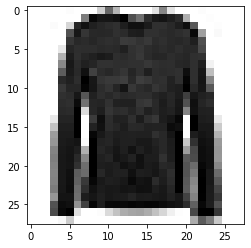

LABEL: 6
INPUT:


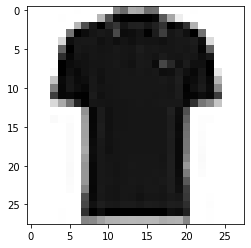

LABEL: 0
INPUT:


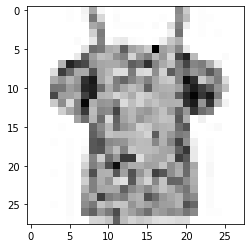

LABEL: 6
INPUT:


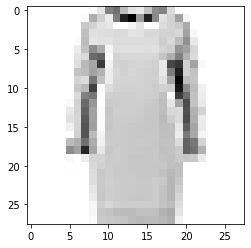

LABEL: 3
INPUT:


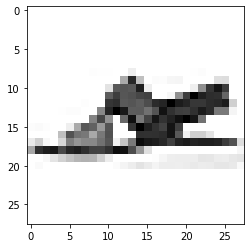

LABEL: 5
INPUT:


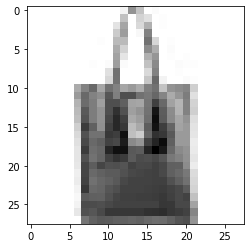

LABEL: 8
INPUT:


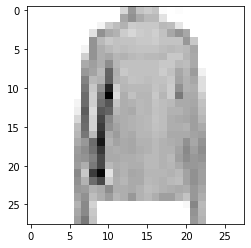

LABEL: 2
INPUT:


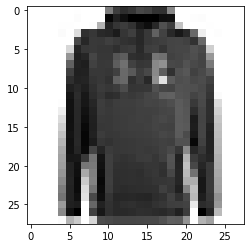

LABEL: 2
INPUT:


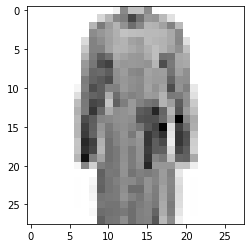

LABEL: 3
INPUT:


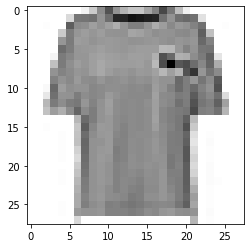

LABEL: 0
INPUT:


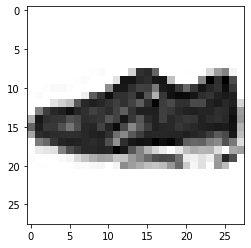

LABEL: 7
INPUT:


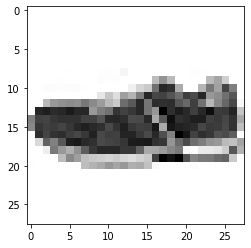

LABEL: 7
INPUT:


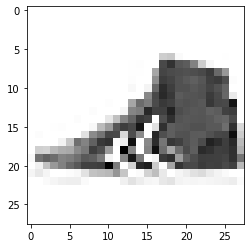

LABEL: 7
INPUT:


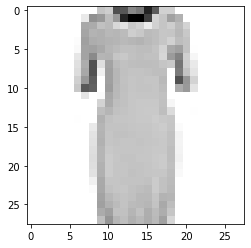

LABEL: 3
INPUT:


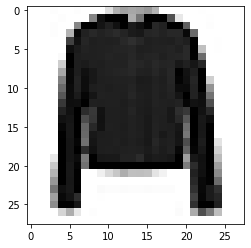

LABEL: 4
INPUT:


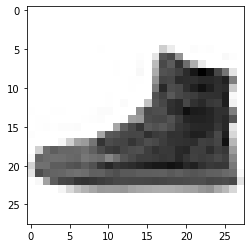

LABEL: 7
INPUT:


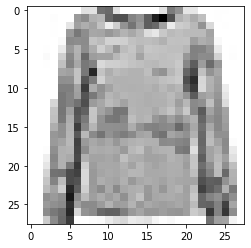

LABEL: 6
INPUT:


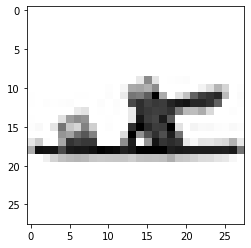

LABEL: 5
INPUT:


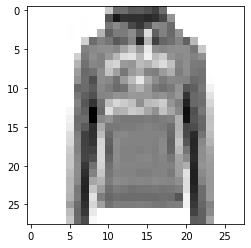

LABEL: 2
INPUT:


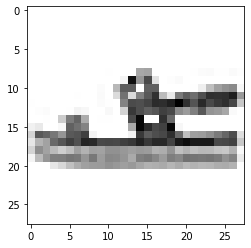

LABEL: 5
INPUT:


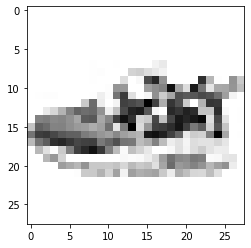

LABEL: 7
INPUT:


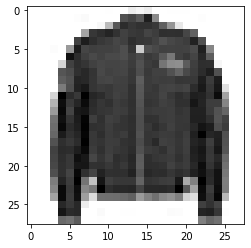

LABEL: 4
INPUT:


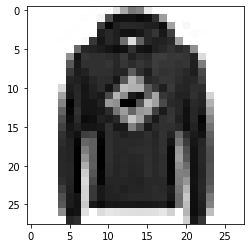

LABEL: 2
INPUT:


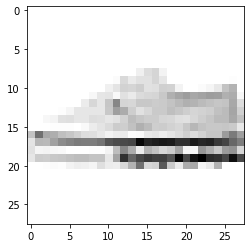

LABEL: 7
INPUT:


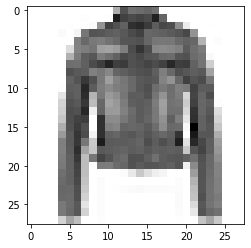

LABEL: 4
INPUT:


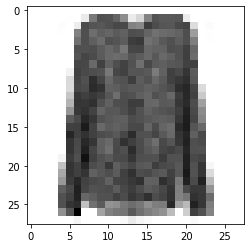

LABEL: 6
INPUT:


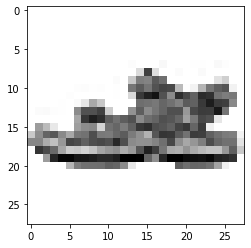

LABEL: 5
INPUT:


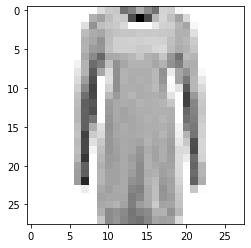

LABEL: 3
INPUT:


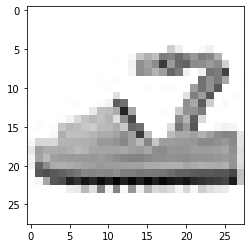

LABEL: 5
INPUT:


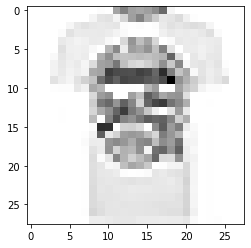

LABEL: 0
INPUT:


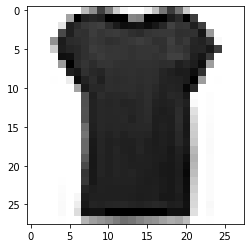

LABEL: 6
INPUT:


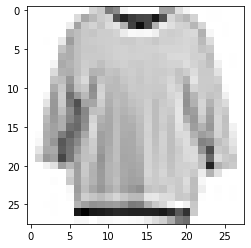

LABEL: 2
INPUT:


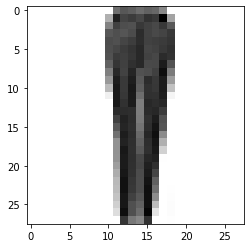

LABEL: 1
INPUT:


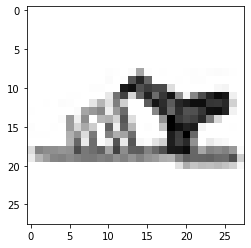

LABEL: 5
INPUT:


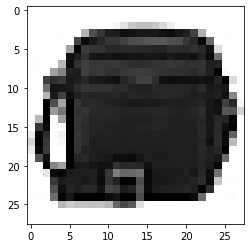

LABEL: 8
INPUT:


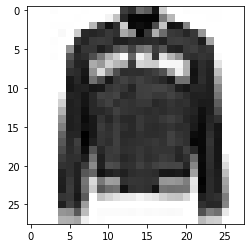

LABEL: 4
INPUT:


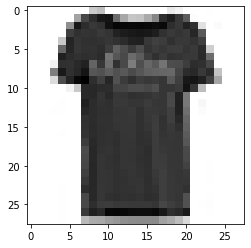

LABEL: 0
INPUT:


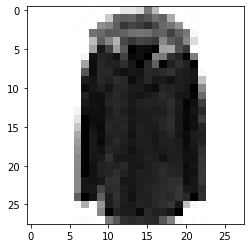

LABEL: 4
INPUT:


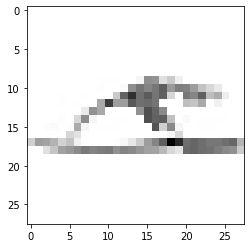

LABEL: 5
INPUT:


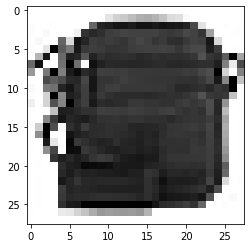

LABEL: 8
INPUT:


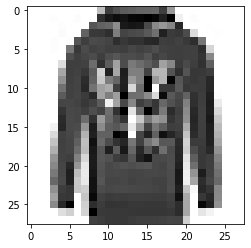

LABEL: 2
INPUT:


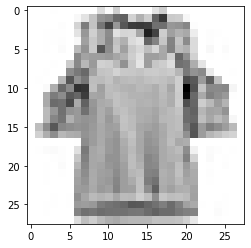

LABEL: 6
INPUT:


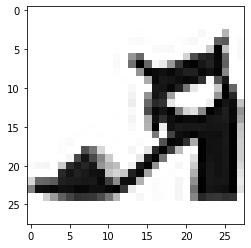

LABEL: 5
INPUT:


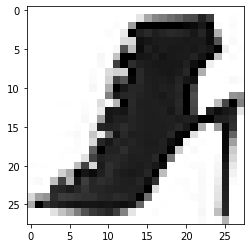

LABEL: 5
INPUT:


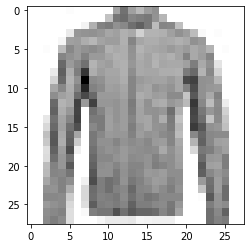

LABEL: 6
INPUT:


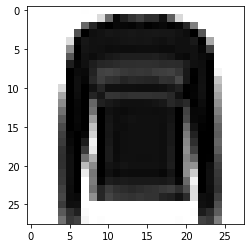

LABEL: 2
INPUT:


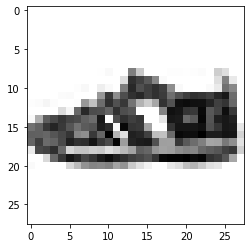

LABEL: 5
INPUT:


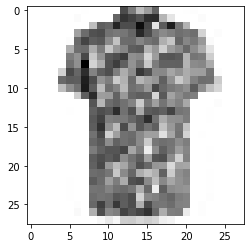

LABEL: 6
INPUT:


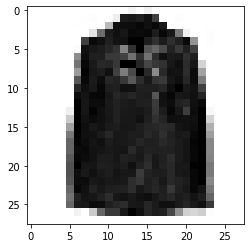

LABEL: 4
INPUT:


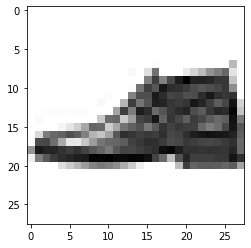

LABEL: 9
INPUT:


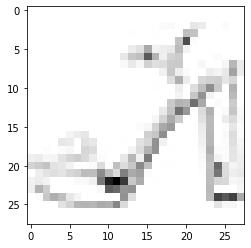

LABEL: 5
INPUT:


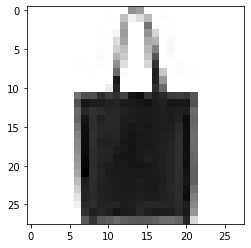

LABEL: 8
INPUT:


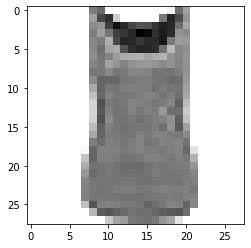

LABEL: 0
INPUT:


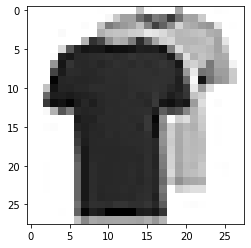

LABEL: 0
INPUT:


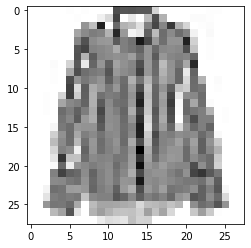

LABEL: 6
INPUT:


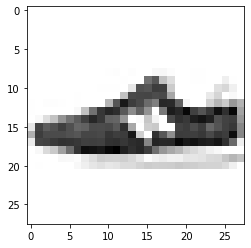

LABEL: 7
INPUT:


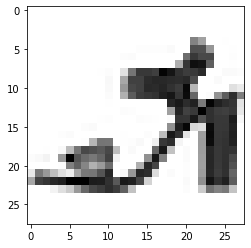

LABEL: 5
INPUT:


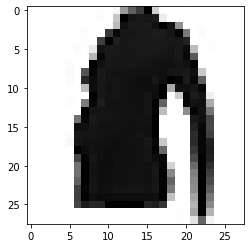

LABEL: 2
INPUT:


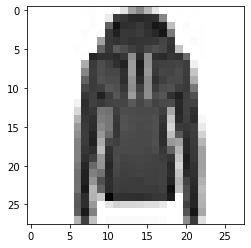

LABEL: 2
INPUT:


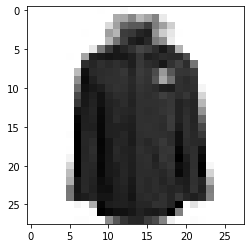

LABEL: 4
INPUT:


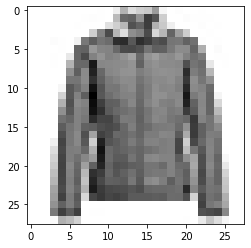

LABEL: 4
INPUT:


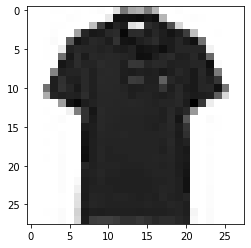

LABEL: 0
INPUT:


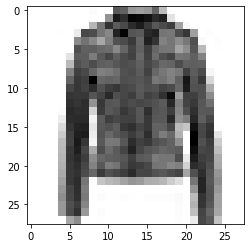

LABEL: 4
INPUT:


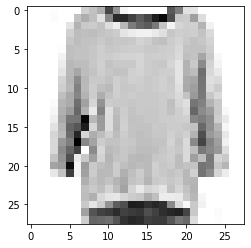

LABEL: 2
INPUT:


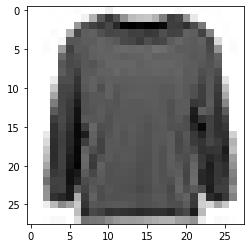

LABEL: 2
INPUT:


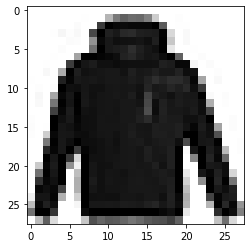

LABEL: 4
INPUT:


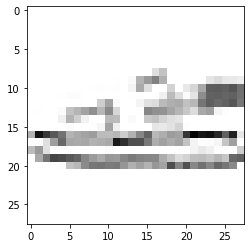

LABEL: 5
INPUT:


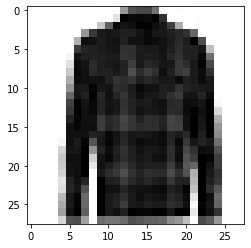

LABEL: 6
INPUT:


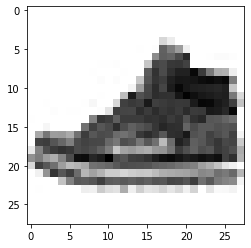

LABEL: 7
INPUT:


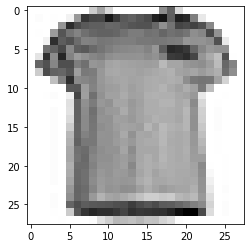

LABEL: 0
INPUT:


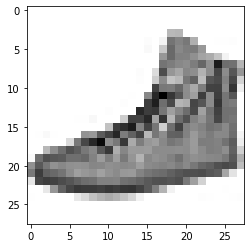

LABEL: 7
INPUT:


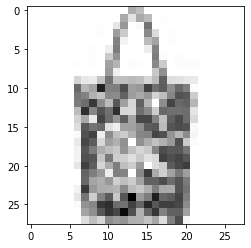

LABEL: 8
INPUT:


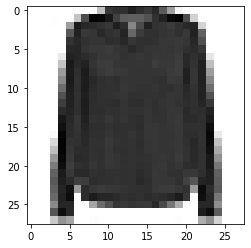

LABEL: 6
INPUT:


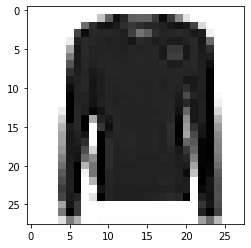

LABEL: 2
INPUT:


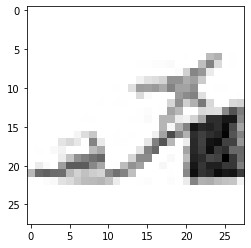

LABEL: 5
INPUT:


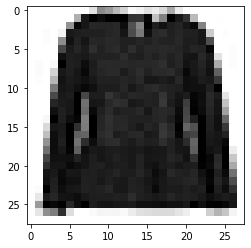

LABEL: 6
INPUT:


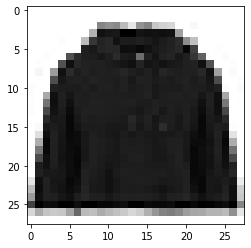

LABEL: 4
INPUT:


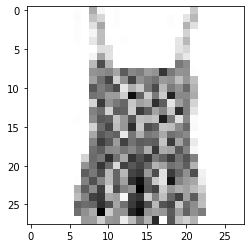

LABEL: 0
INPUT:


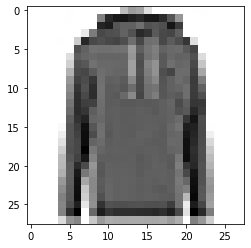

LABEL: 2
INPUT:


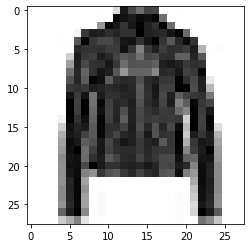

LABEL: 4
INPUT:


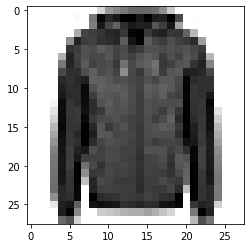

LABEL: 4
INPUT:


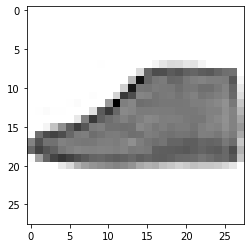

LABEL: 9
INPUT:


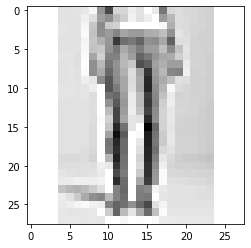

LABEL: 1
INPUT:


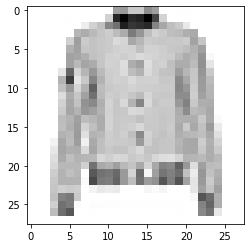

LABEL: 4
INPUT:


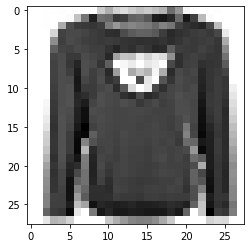

LABEL: 2
INPUT:


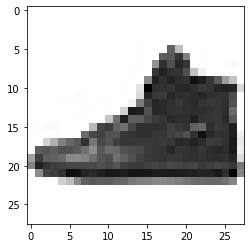

LABEL: 7
INPUT:


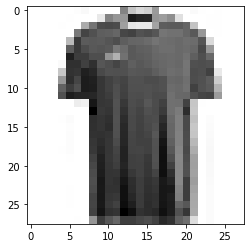

LABEL: 0
INPUT:


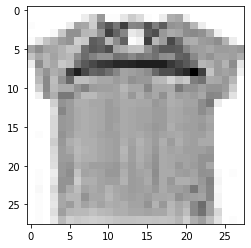

LABEL: 0
INPUT:


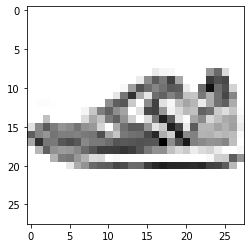

LABEL: 7
INPUT:


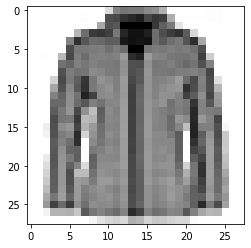

LABEL: 4
INPUT:


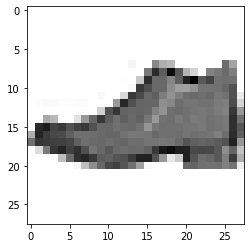

LABEL: 9
INPUT:


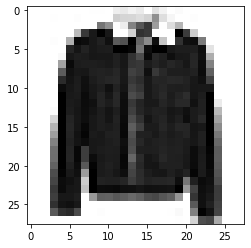

LABEL: 4
INPUT:


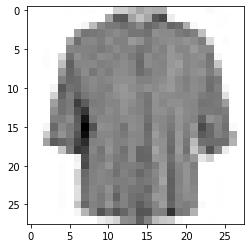

LABEL: 6
INPUT:


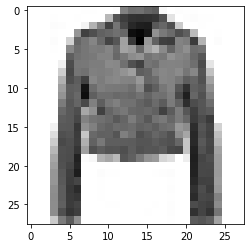

LABEL: 4
INPUT:


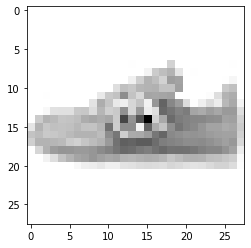

LABEL: 7
INPUT:


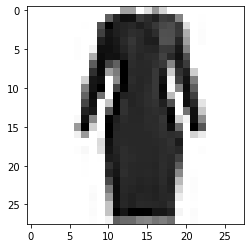

LABEL: 3
INPUT:


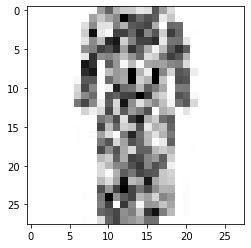

LABEL: 3
INPUT:


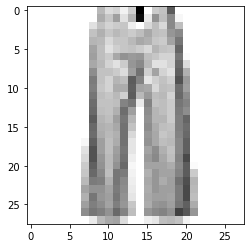

LABEL: 1
INPUT:


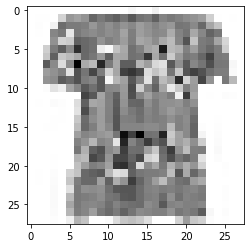

LABEL: 6
INPUT:


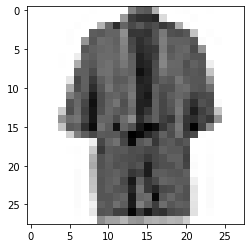

LABEL: 4
INPUT:


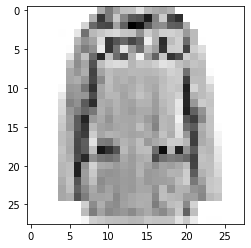

LABEL: 4
INPUT:


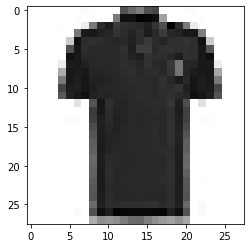

LABEL: 0
INPUT:


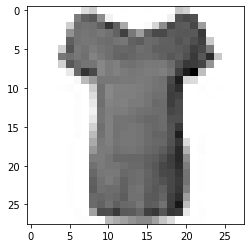

LABEL: 0
INPUT:


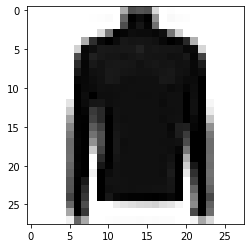

LABEL: 2
INPUT:


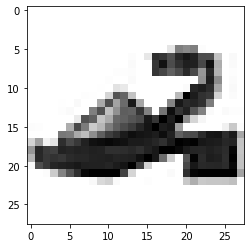

LABEL: 5
INPUT:


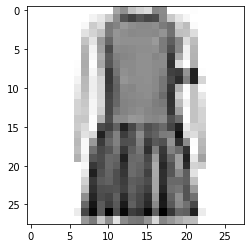

LABEL: 3
INPUT:


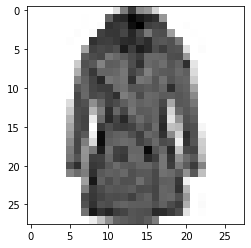

LABEL: 4
INPUT:


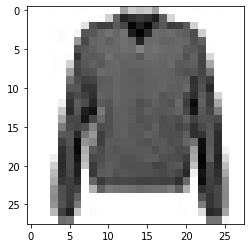

LABEL: 4
INPUT:


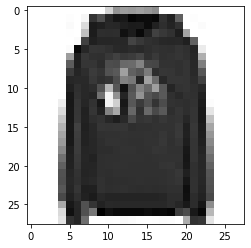

LABEL: 2
INPUT:


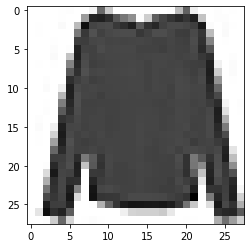

LABEL: 6
INPUT:


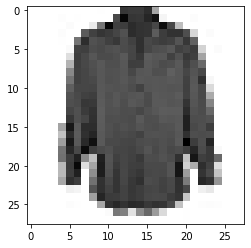

LABEL: 6
INPUT:


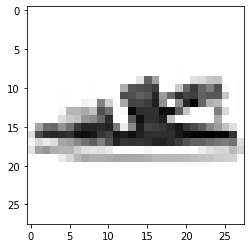

LABEL: 5
INPUT:


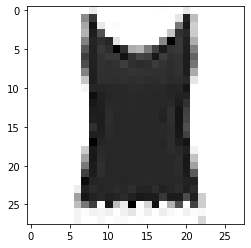

LABEL: 0
INPUT:


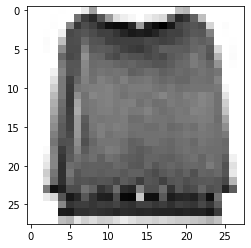

LABEL: 0
INPUT:


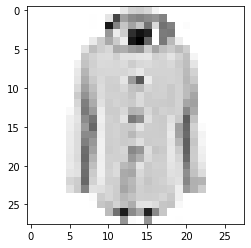

LABEL: 4
INPUT:


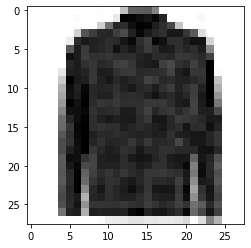

LABEL: 6
INPUT:


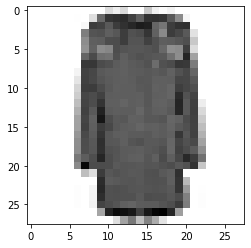

LABEL: 4
INPUT:


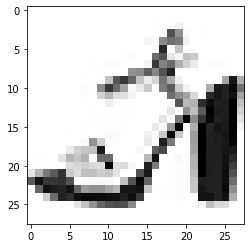

LABEL: 5
INPUT:


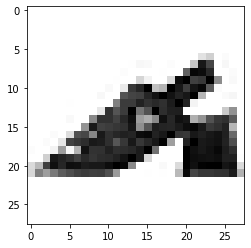

LABEL: 5
INPUT:


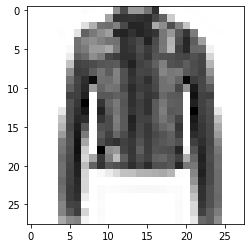

LABEL: 4
INPUT:


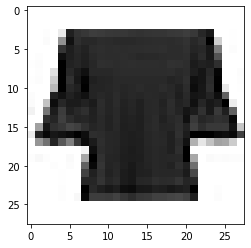

LABEL: 0
INPUT:


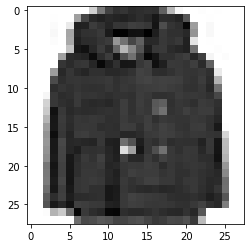

LABEL: 4
INPUT:


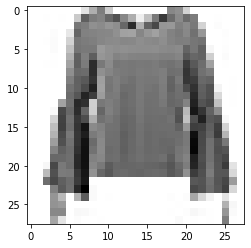

LABEL: 6
INPUT:


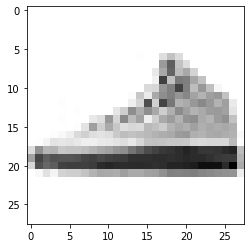

LABEL: 7
INPUT:


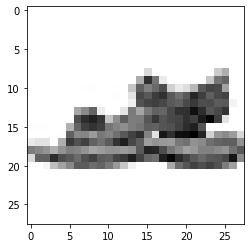

LABEL: 5
INPUT:


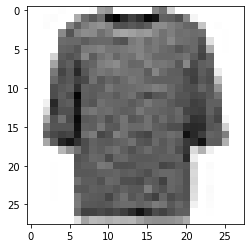

LABEL: 2
INPUT:


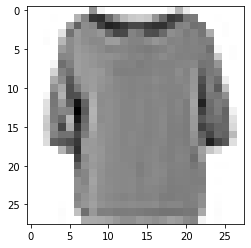

LABEL: 6
INPUT:


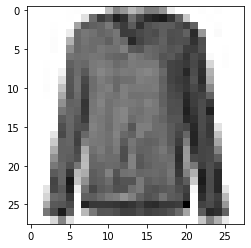

LABEL: 6
INPUT:


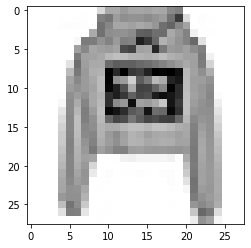

LABEL: 2
INPUT:


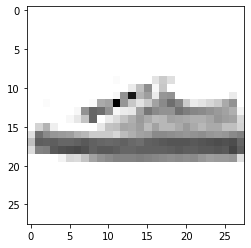

LABEL: 7
INPUT:


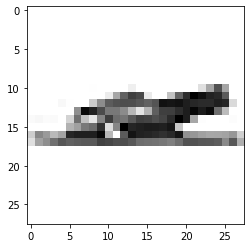

LABEL: 5
INPUT:


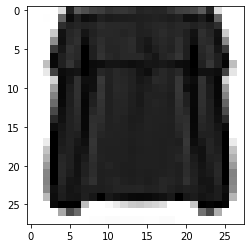

LABEL: 6
INPUT:


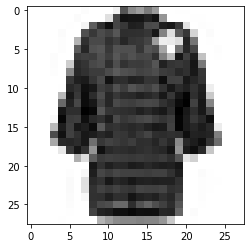

LABEL: 6
INPUT:


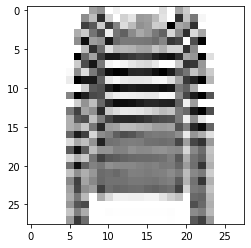

LABEL: 2
INPUT:


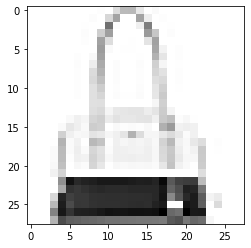

LABEL: 8
INPUT:


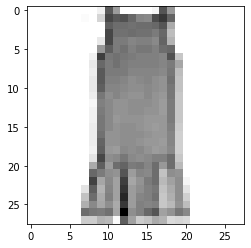

LABEL: 3
INPUT:


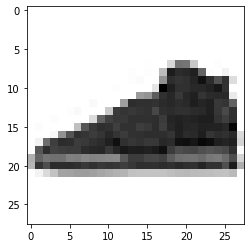

LABEL: 7
INPUT:


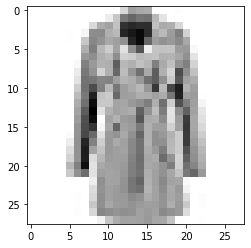

LABEL: 4
INPUT:


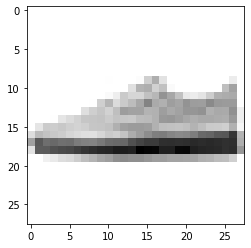

LABEL: 7
INPUT:


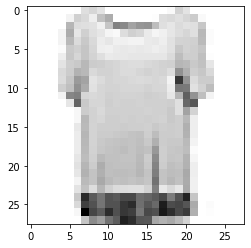

LABEL: 6
INPUT:


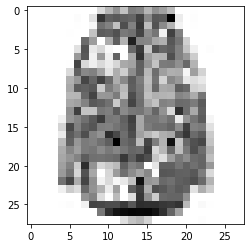

LABEL: 4
INPUT:


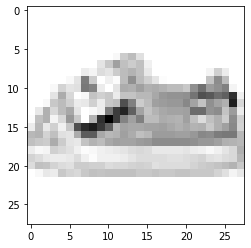

LABEL: 7
INPUT:


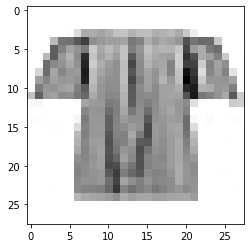

LABEL: 6
INPUT:


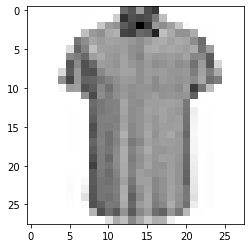

LABEL: 6
INPUT:


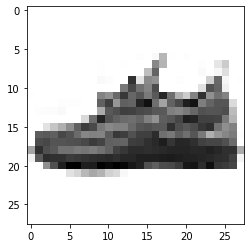

LABEL: 7
INPUT:


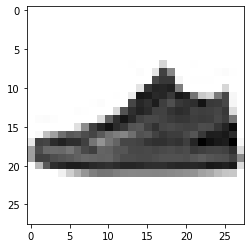

LABEL: 7
INPUT:


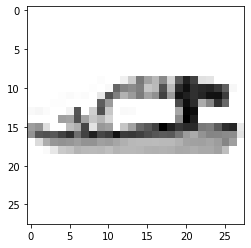

LABEL: 5
INPUT:


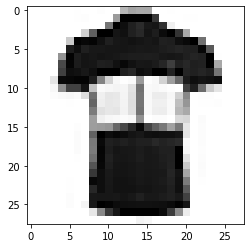

LABEL: 0
INPUT:


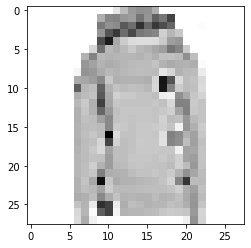

LABEL: 2
INPUT:


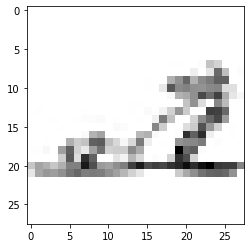

LABEL: 5
INPUT:


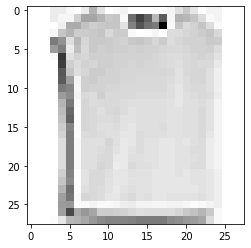

LABEL: 0
INPUT:


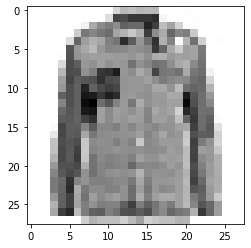

LABEL: 4
INPUT:


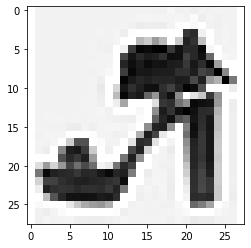

LABEL: 5
INPUT:


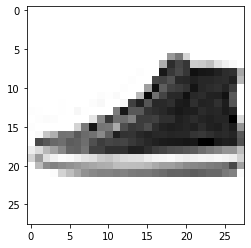

LABEL: 7
INPUT:


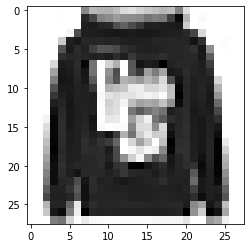

LABEL: 2
INPUT:


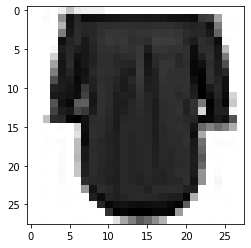

LABEL: 6
INPUT:


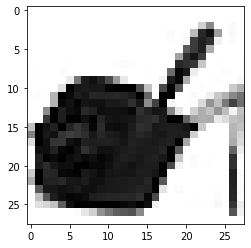

LABEL: 5
INPUT:


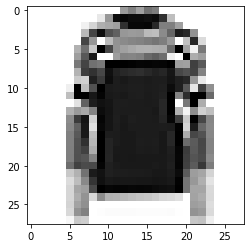

LABEL: 2
INPUT:


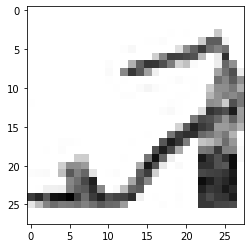

LABEL: 5
INPUT:


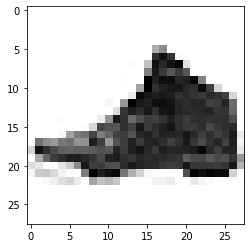

LABEL: 7
INPUT:


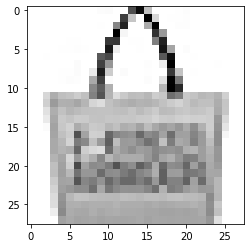

LABEL: 8
INPUT:


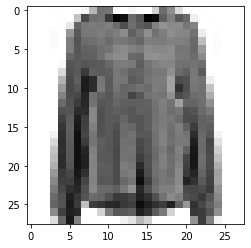

LABEL: 6
INPUT:


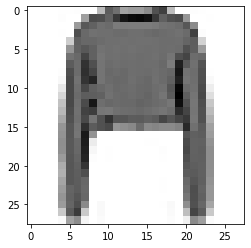

LABEL: 2
INPUT:


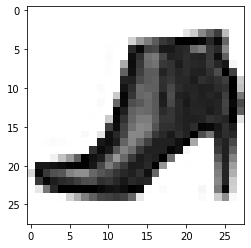

LABEL: 9
INPUT:


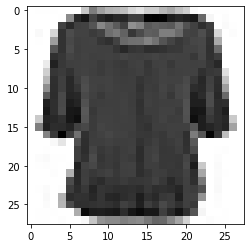

LABEL: 6
INPUT:


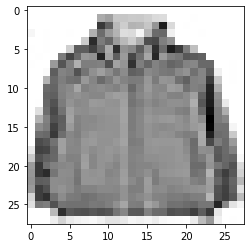

LABEL: 4
INPUT:


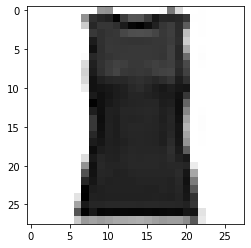

LABEL: 0
INPUT:


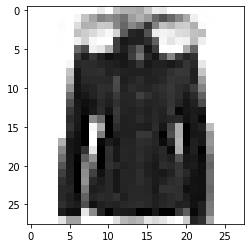

LABEL: 4
INPUT:


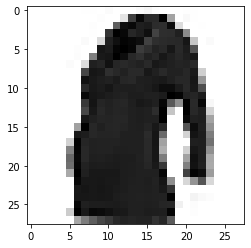

LABEL: 2
INPUT:


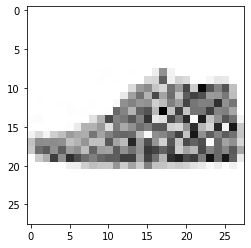

LABEL: 9
INPUT:


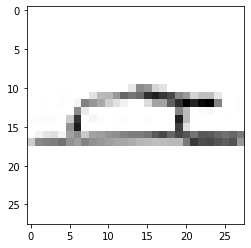

LABEL: 5
INPUT:


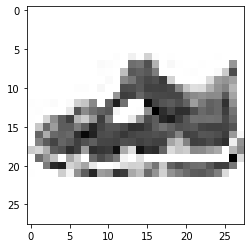

LABEL: 5
INPUT:


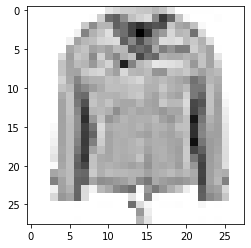

LABEL: 4
INPUT:


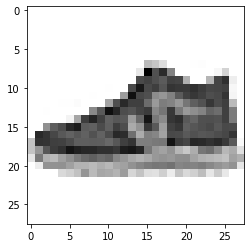

LABEL: 7
INPUT:


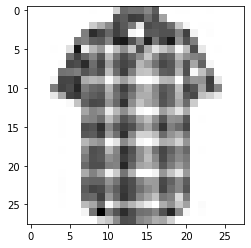

LABEL: 6
INPUT:


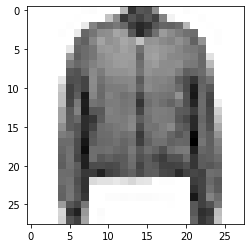

LABEL: 4
INPUT:


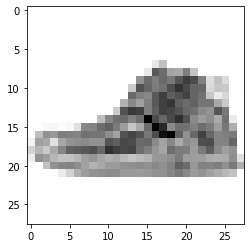

LABEL: 7
INPUT:


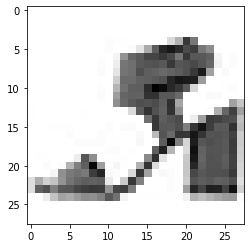

LABEL: 5
INPUT:


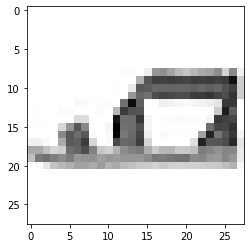

LABEL: 5
INPUT:


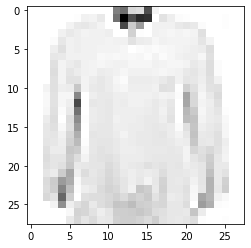

LABEL: 6
INPUT:


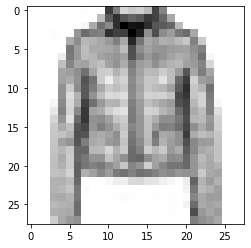

LABEL: 4
INPUT:


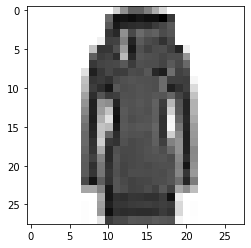

LABEL: 2
INPUT:


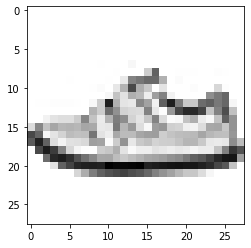

LABEL: 7
INPUT:


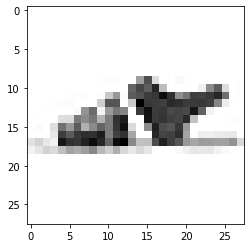

LABEL: 5
INPUT:


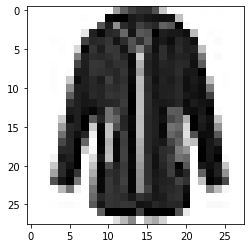

LABEL: 4
INPUT:


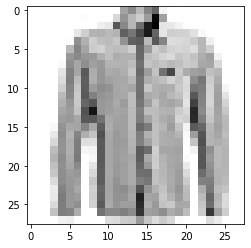

LABEL: 6
INPUT:


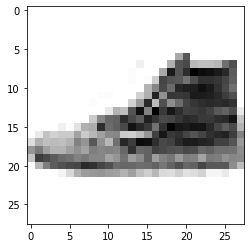

LABEL: 7
INPUT:


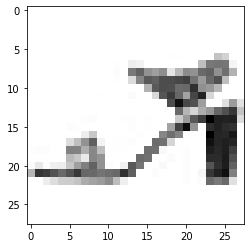

LABEL: 5
INPUT:


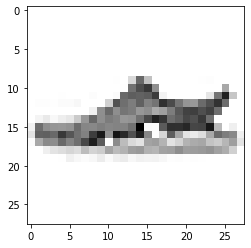

LABEL: 5
INPUT:


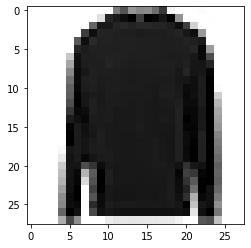

LABEL: 2
INPUT:


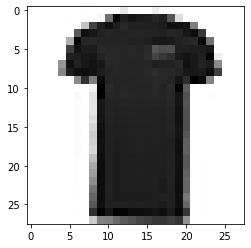

LABEL: 0
INPUT:


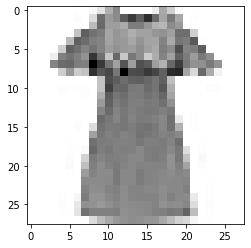

LABEL: 3
INPUT:


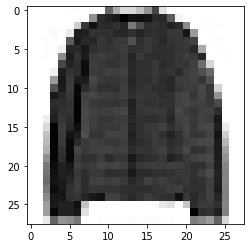

LABEL: 4
INPUT:


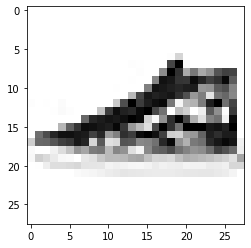

LABEL: 7
INPUT:


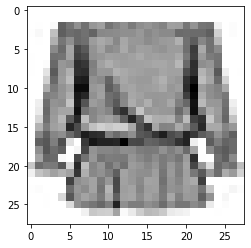

LABEL: 6
INPUT:


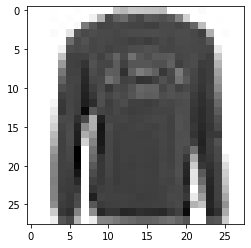

LABEL: 2
INPUT:


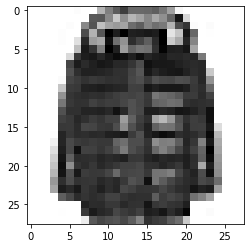

LABEL: 4
INPUT:


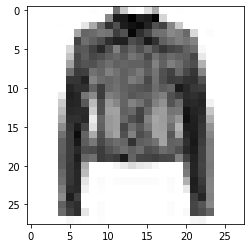

LABEL: 4
INPUT:


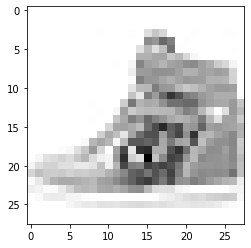

LABEL: 7
INPUT:


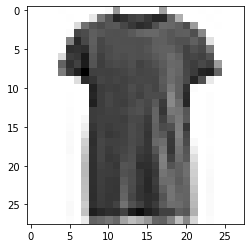

LABEL: 0
INPUT:


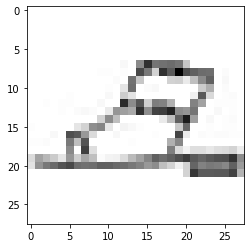

LABEL: 5
INPUT:


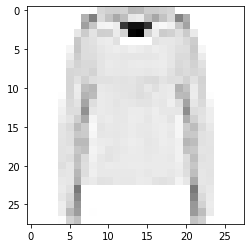

LABEL: 2
INPUT:


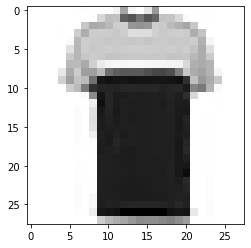

LABEL: 0
INPUT:


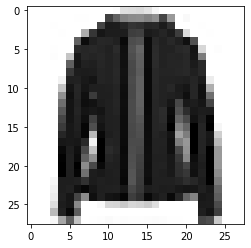

LABEL: 4
INPUT:


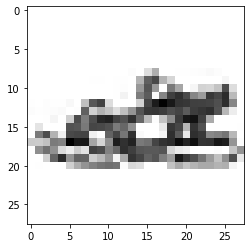

LABEL: 5
INPUT:


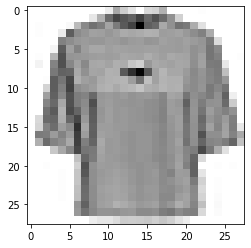

LABEL: 2
INPUT:


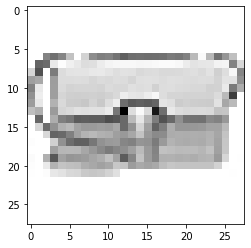

LABEL: 8
INPUT:


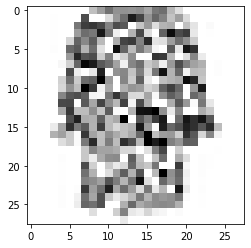

LABEL: 6
INPUT:


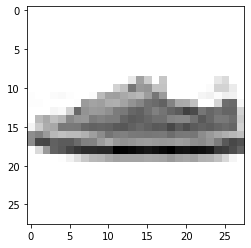

LABEL: 7
INPUT:


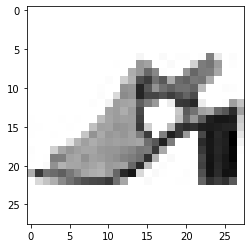

LABEL: 5
INPUT:


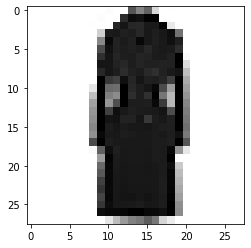

LABEL: 4
INPUT:


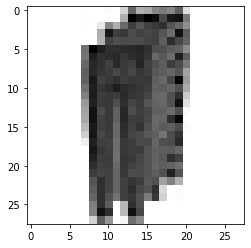

LABEL: 1
INPUT:


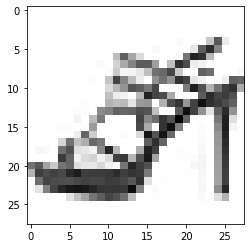

LABEL: 5
INPUT:


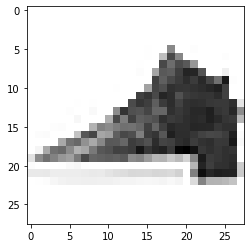

LABEL: 7
INPUT:


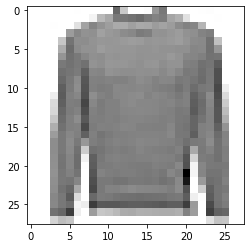

LABEL: 2
INPUT:


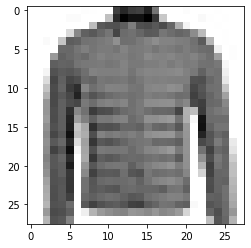

LABEL: 4
INPUT:


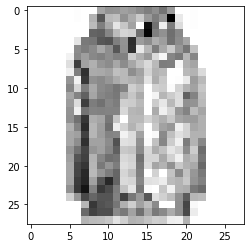

LABEL: 4
INPUT:


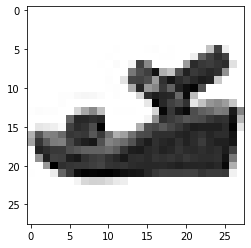

LABEL: 5
INPUT:


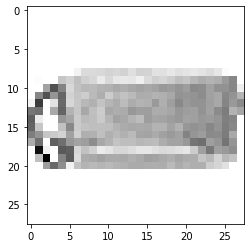

LABEL: 8
INPUT:


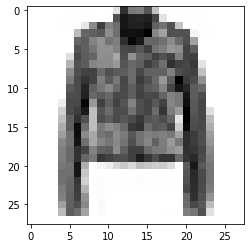

LABEL: 4
INPUT:


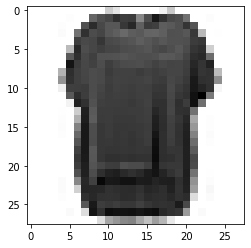

LABEL: 6
INPUT:


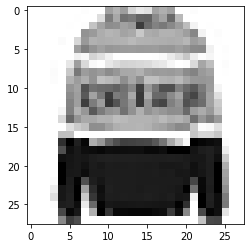

LABEL: 2
INPUT:


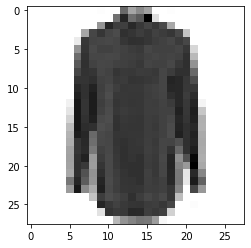

LABEL: 6
INPUT:


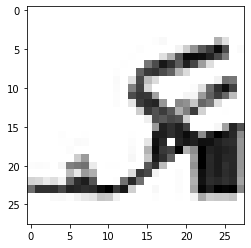

LABEL: 5
INPUT:


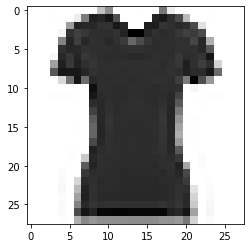

LABEL: 0
INPUT:


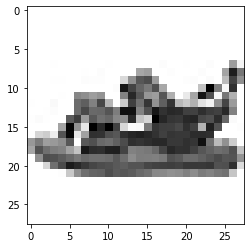

LABEL: 5
INPUT:


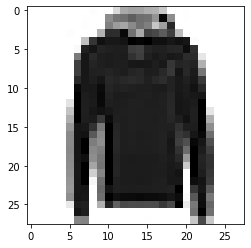

LABEL: 2
INPUT:


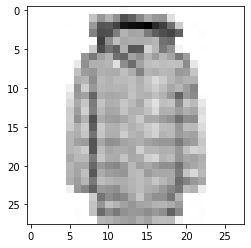

LABEL: 4
INPUT:


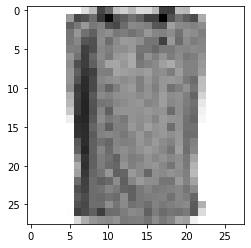

LABEL: 6
INPUT:


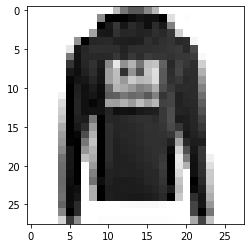

LABEL: 2
INPUT:


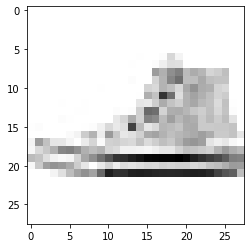

LABEL: 7
INPUT:


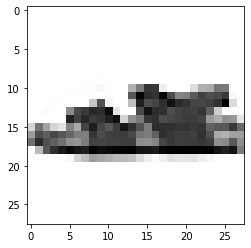

LABEL: 5
INPUT:


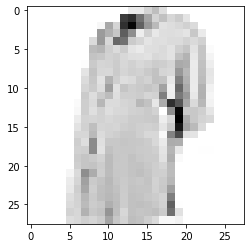

LABEL: 6
INPUT:


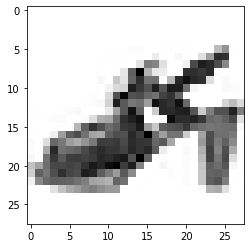

LABEL: 5
INPUT:


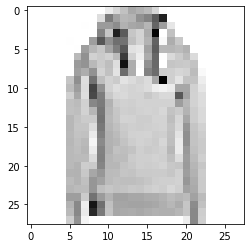

LABEL: 2
INPUT:


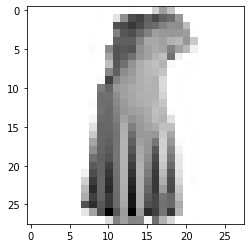

LABEL: 3
INPUT:


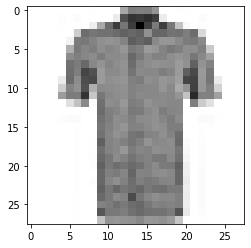

LABEL: 6
INPUT:


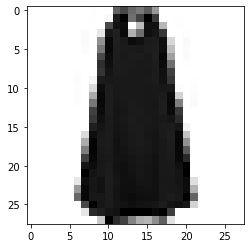

LABEL: 3
INPUT:


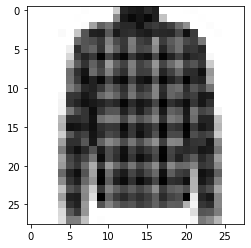

LABEL: 6
INPUT:


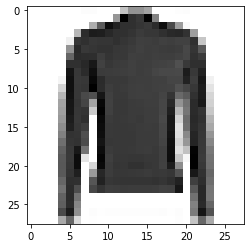

LABEL: 2
INPUT:


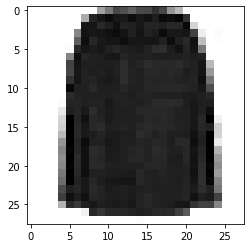

LABEL: 4
INPUT:


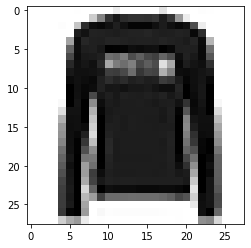

LABEL: 2
INPUT:


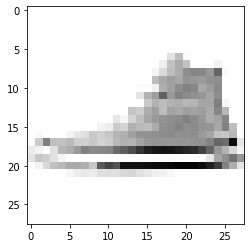

LABEL: 7
INPUT:


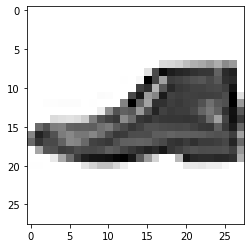

LABEL: 9
INPUT:


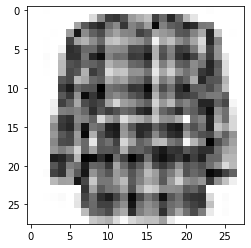

LABEL: 6
INPUT:


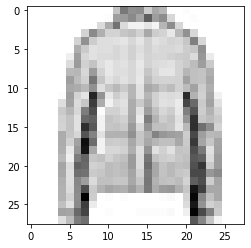

LABEL: 4
INPUT:


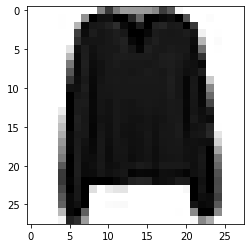

LABEL: 6
INPUT:


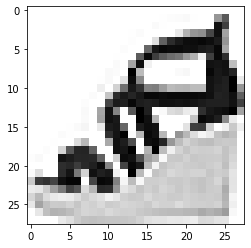

LABEL: 5
INPUT:


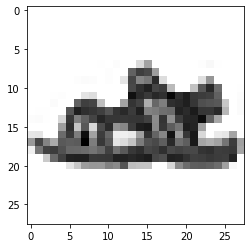

LABEL: 5
INPUT:


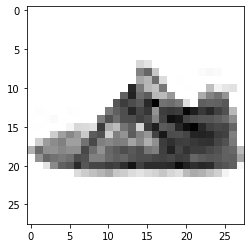

LABEL: 7
INPUT:


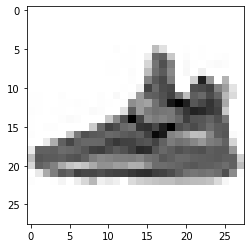

LABEL: 7
INPUT:


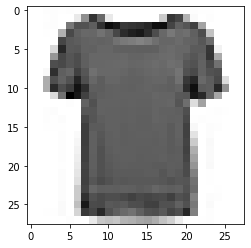

LABEL: 6
INPUT:


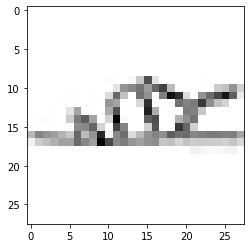

LABEL: 5
INPUT:


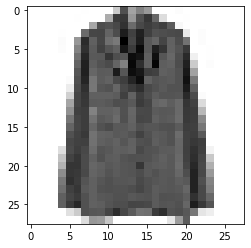

LABEL: 6
INPUT:


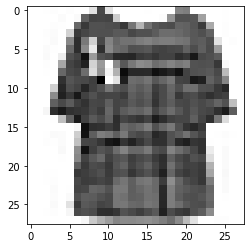

LABEL: 0
INPUT:


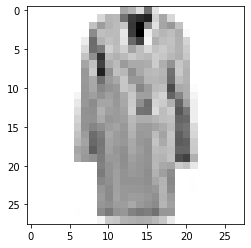

LABEL: 4
INPUT:


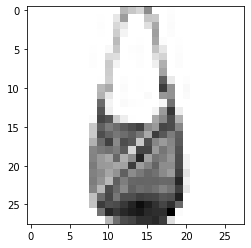

LABEL: 8
INPUT:


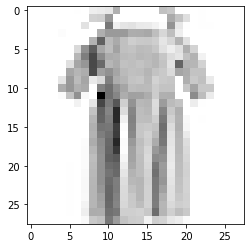

LABEL: 3
INPUT:


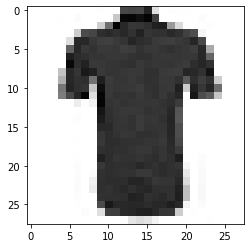

LABEL: 6
INPUT:


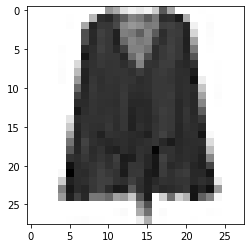

LABEL: 6
INPUT:


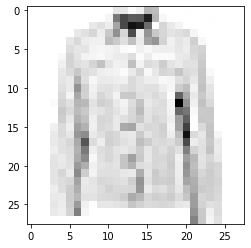

LABEL: 4
INPUT:


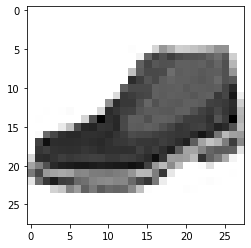

LABEL: 9
INPUT:


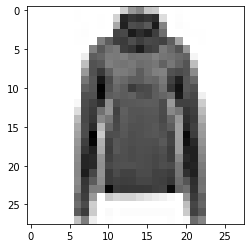

LABEL: 2
INPUT:


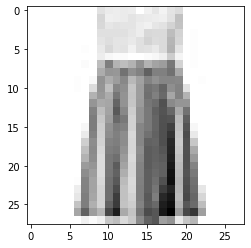

LABEL: 3
INPUT:


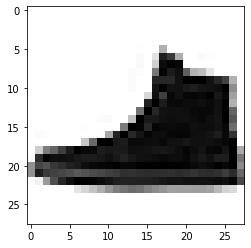

LABEL: 7
INPUT:


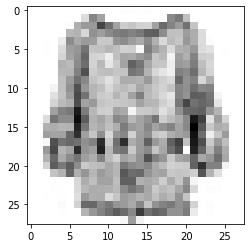

LABEL: 6
INPUT:


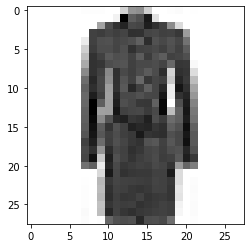

LABEL: 3
INPUT:


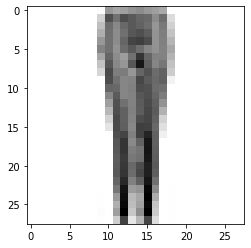

LABEL: 1
INPUT:


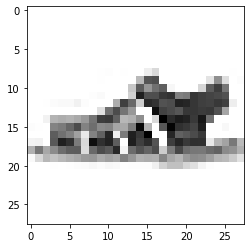

LABEL: 5
INPUT:


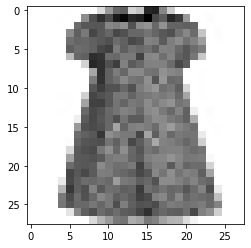

LABEL: 3
INPUT:


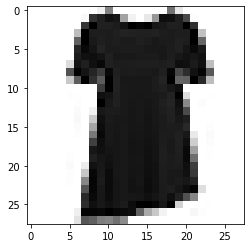

LABEL: 0
INPUT:


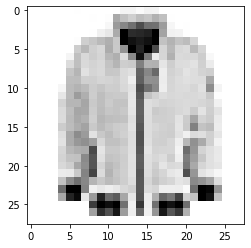

LABEL: 4
INPUT:


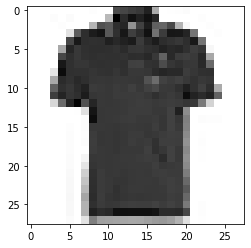

LABEL: 0
INPUT:


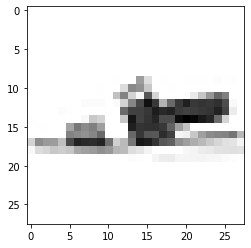

LABEL: 5
INPUT:


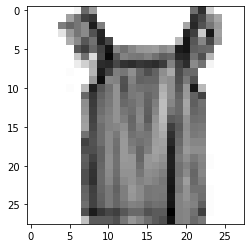

LABEL: 0
INPUT:


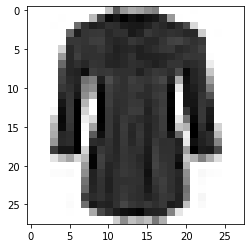

LABEL: 6
INPUT:


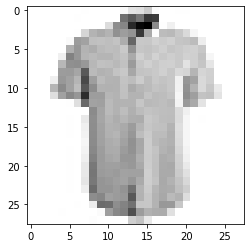

LABEL: 6
INPUT:


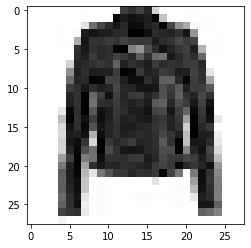

LABEL: 4
INPUT:


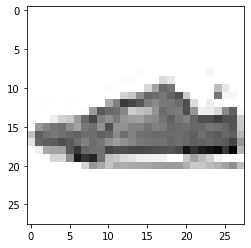

LABEL: 7
INPUT:


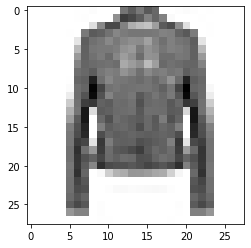

LABEL: 4
INPUT:


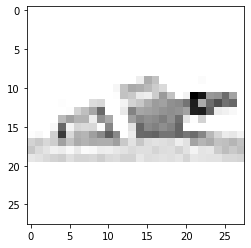

LABEL: 5
INPUT:


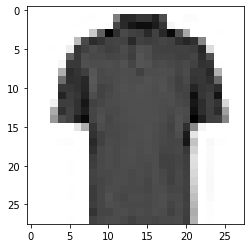

LABEL: 0
INPUT:


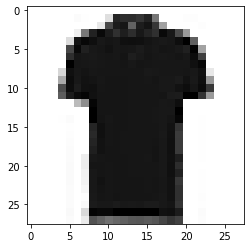

LABEL: 0
INPUT:


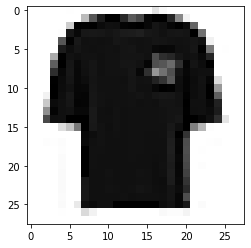

LABEL: 0
INPUT:


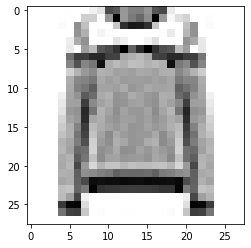

LABEL: 2
INPUT:


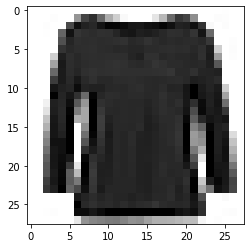

LABEL: 0
INPUT:


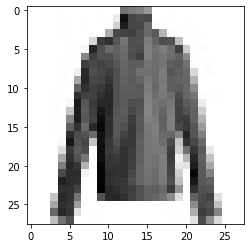

LABEL: 2
INPUT:


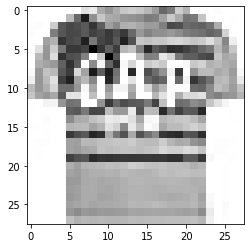

LABEL: 0
INPUT:


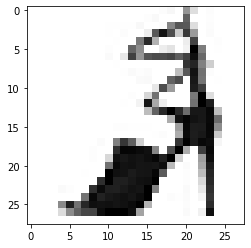

LABEL: 5
INPUT:


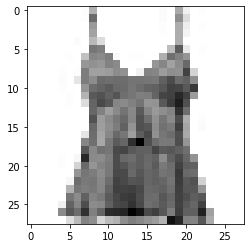

LABEL: 0
INPUT:


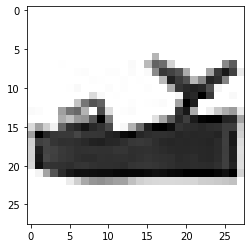

LABEL: 5
INPUT:


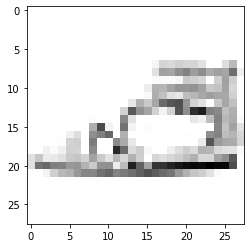

LABEL: 5
INPUT:


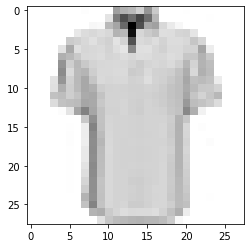

LABEL: 6
INPUT:


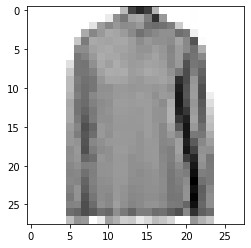

LABEL: 6
INPUT:


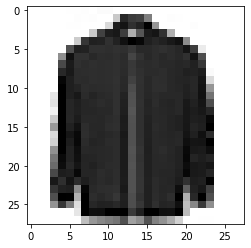

LABEL: 4
INPUT:


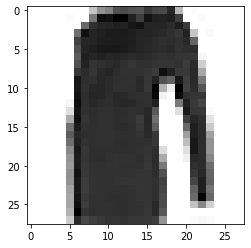

LABEL: 2
INPUT:


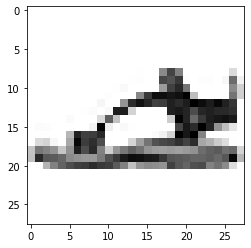

LABEL: 5
INPUT:


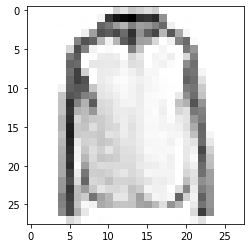

LABEL: 4
INPUT:


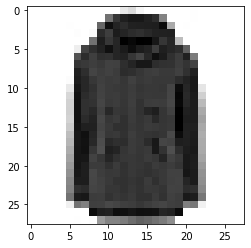

LABEL: 4
INPUT:


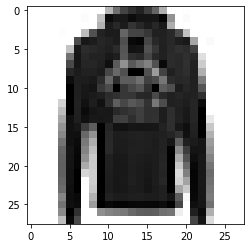

LABEL: 2
INPUT:


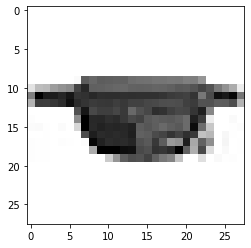

LABEL: 8
INPUT:


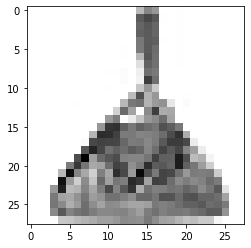

LABEL: 8
INPUT:


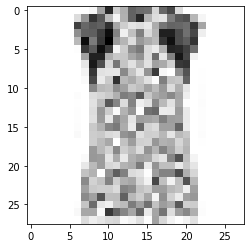

LABEL: 0
INPUT:


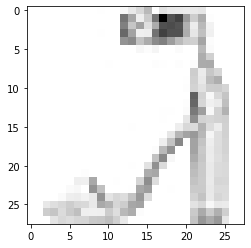

LABEL: 5
INPUT:


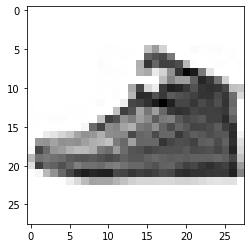

LABEL: 7
INPUT:


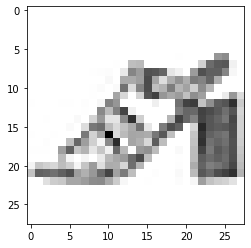

LABEL: 5
INPUT:


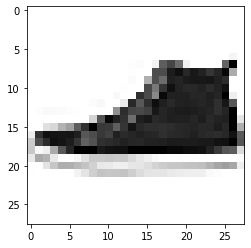

LABEL: 7
INPUT:


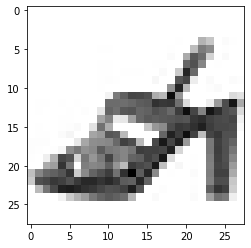

LABEL: 5
INPUT:


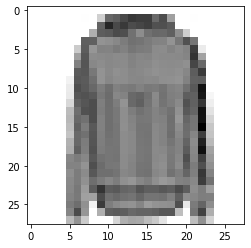

LABEL: 2
INPUT:


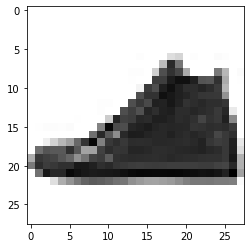

LABEL: 7
INPUT:


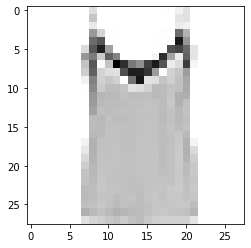

LABEL: 0
INPUT:


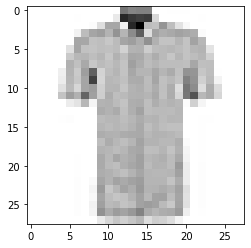

LABEL: 6
INPUT:


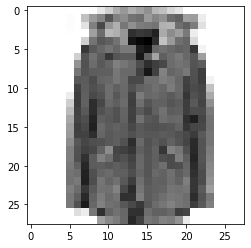

LABEL: 4
INPUT:


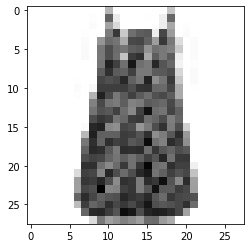

LABEL: 3
INPUT:


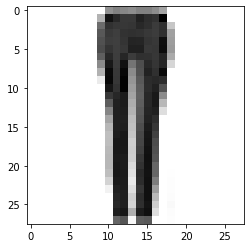

LABEL: 1
INPUT:


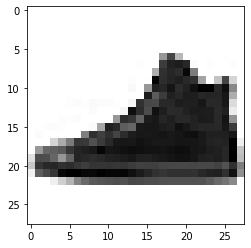

LABEL: 7
INPUT:


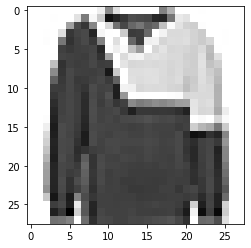

LABEL: 2
INPUT:


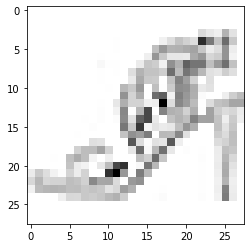

LABEL: 5
INPUT:


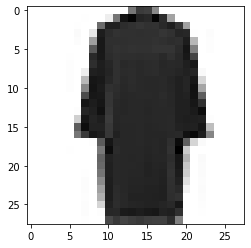

LABEL: 3
INPUT:


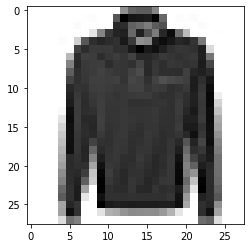

LABEL: 2
INPUT:


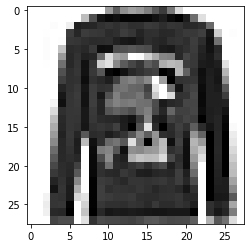

LABEL: 2
INPUT:


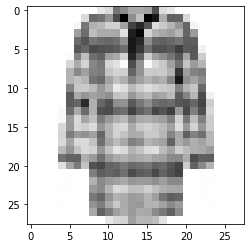

LABEL: 4
INPUT:


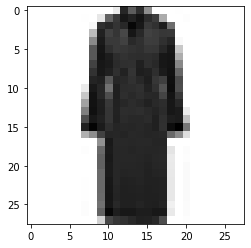

LABEL: 3
INPUT:


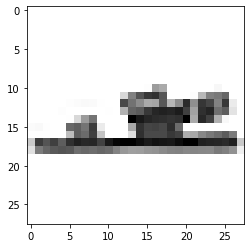

LABEL: 5
INPUT:


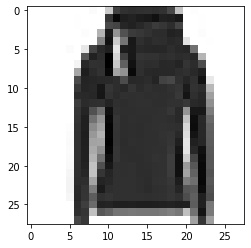

LABEL: 2
INPUT:


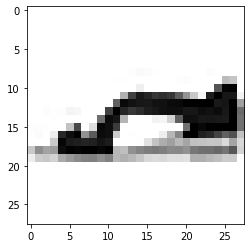

LABEL: 5
INPUT:


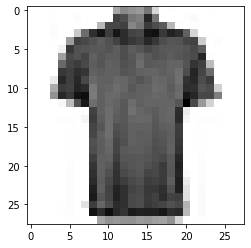

LABEL: 0
INPUT:


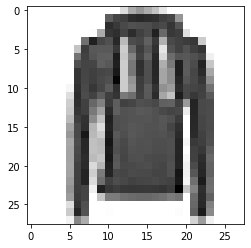

LABEL: 2
INPUT:


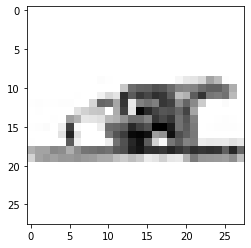

LABEL: 5
INPUT:


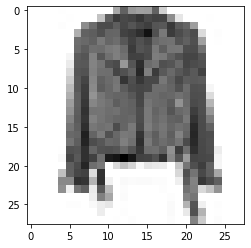

LABEL: 4
INPUT:


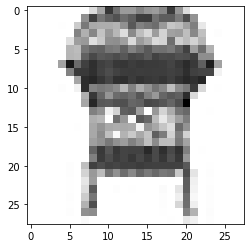

LABEL: 0
INPUT:


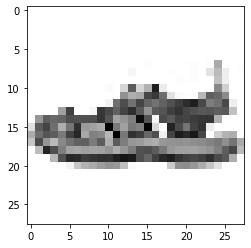

LABEL: 5
INPUT:


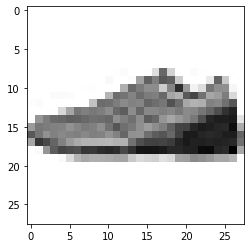

LABEL: 7
INPUT:


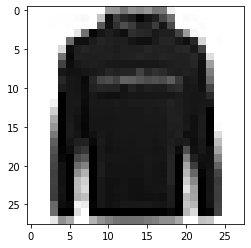

LABEL: 2
INPUT:


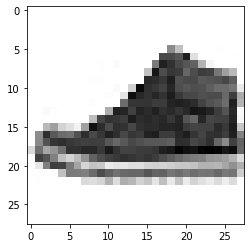

LABEL: 7
INPUT:


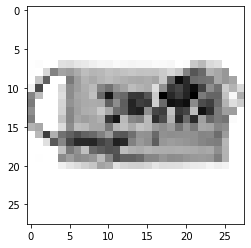

LABEL: 8
INPUT:


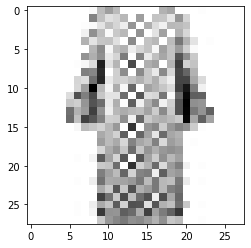

LABEL: 3
INPUT:


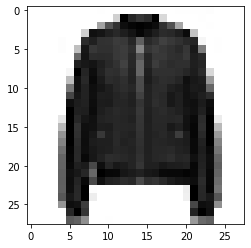

LABEL: 4
INPUT:


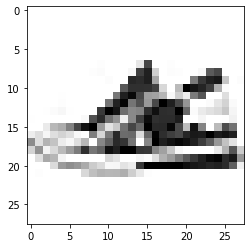

LABEL: 7
INPUT:


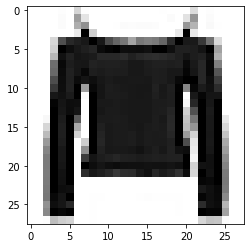

LABEL: 6
INPUT:


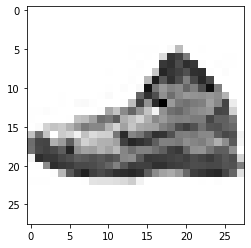

LABEL: 7
INPUT:


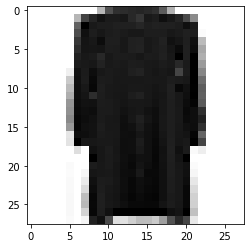

LABEL: 3
INPUT:


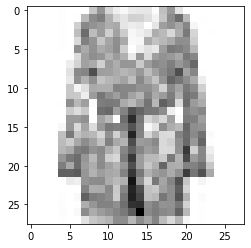

LABEL: 3
INPUT:


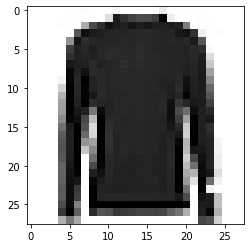

LABEL: 2
INPUT:


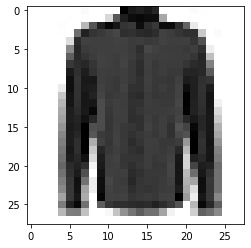

LABEL: 6
INPUT:


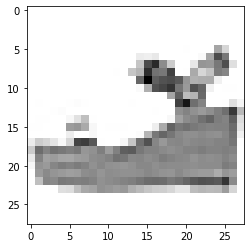

LABEL: 5
INPUT:


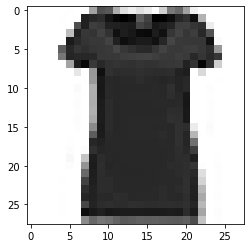

LABEL: 0
INPUT:


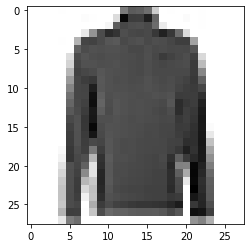

LABEL: 2
INPUT:


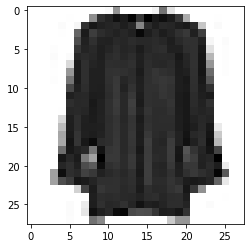

LABEL: 6
INPUT:


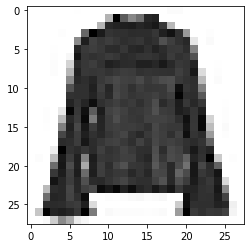

LABEL: 6
INPUT:


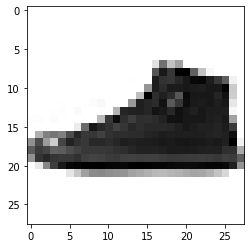

LABEL: 7
INPUT:


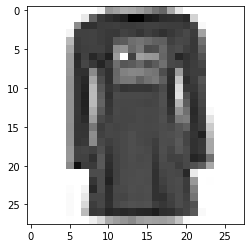

LABEL: 3
INPUT:


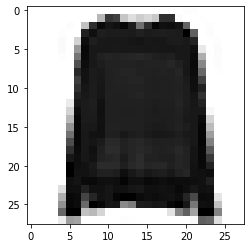

LABEL: 2
INPUT:


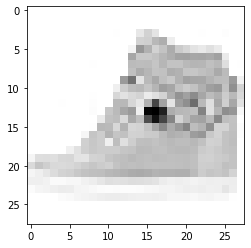

LABEL: 7
INPUT:


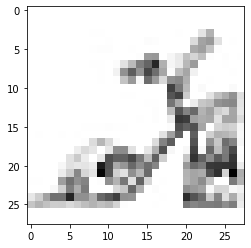

LABEL: 5
INPUT:


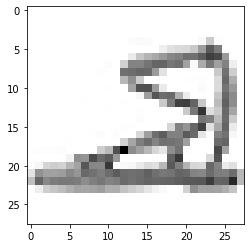

LABEL: 5
INPUT:


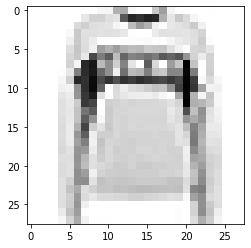

LABEL: 2
INPUT:


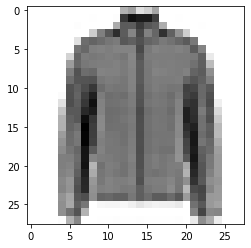

LABEL: 4
INPUT:


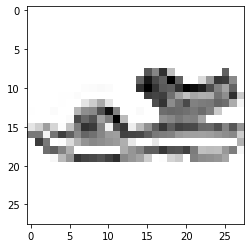

LABEL: 5
INPUT:


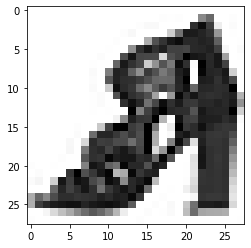

LABEL: 5
INPUT:


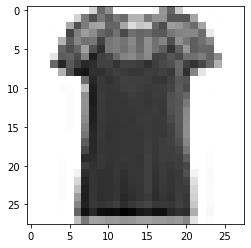

LABEL: 0
INPUT:


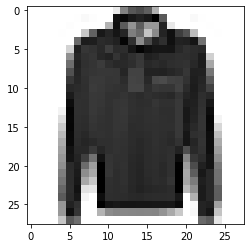

LABEL: 2
INPUT:


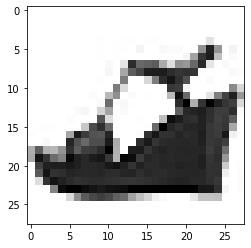

LABEL: 5
INPUT:


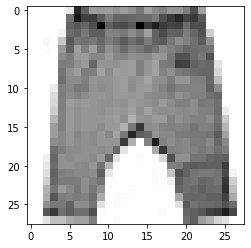

LABEL: 1
INPUT:


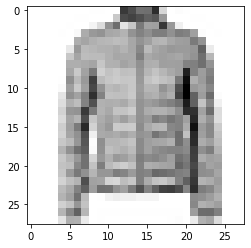

LABEL: 4
INPUT:


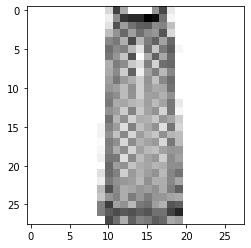

LABEL: 3
INPUT:


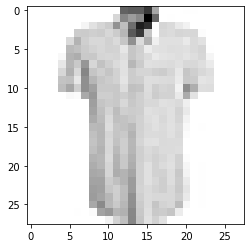

LABEL: 6
INPUT:


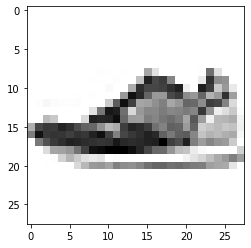

LABEL: 7
INPUT:


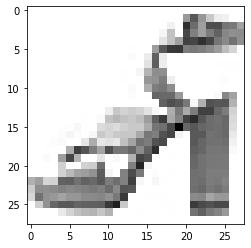

LABEL: 5
INPUT:


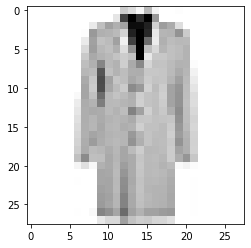

LABEL: 4
INPUT:


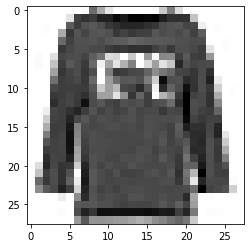

LABEL: 0
INPUT:


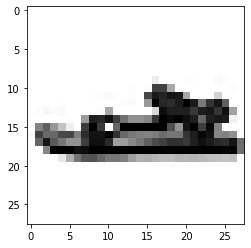

LABEL: 5
INPUT:


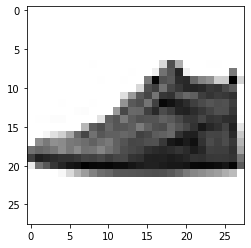

LABEL: 7
INPUT:


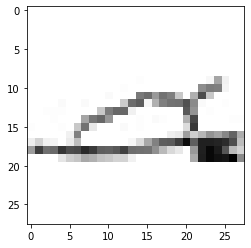

LABEL: 5
INPUT:


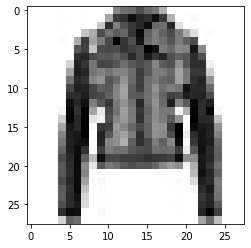

LABEL: 4
INPUT:


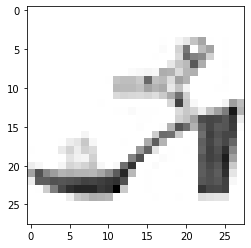

LABEL: 5
INPUT:


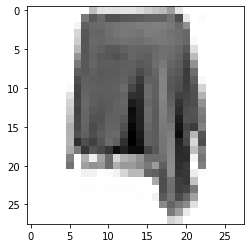

LABEL: 4
INPUT:


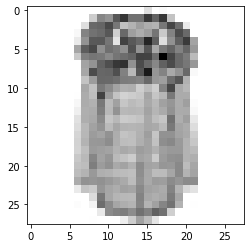

LABEL: 4
INPUT:


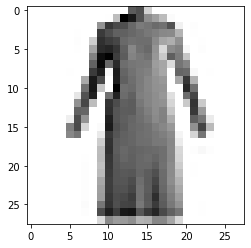

LABEL: 3
INPUT:


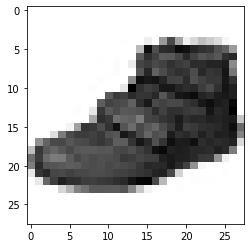

LABEL: 7
INPUT:


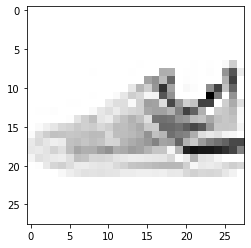

LABEL: 7
INPUT:


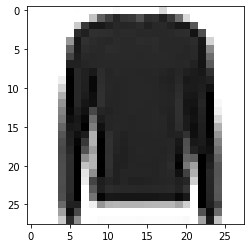

LABEL: 2
INPUT:


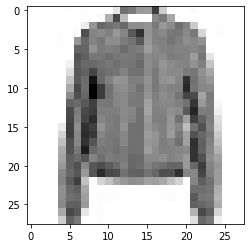

LABEL: 4
INPUT:


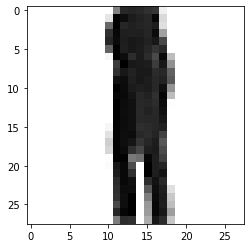

LABEL: 1
INPUT:


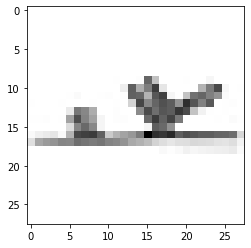

LABEL: 5
INPUT:


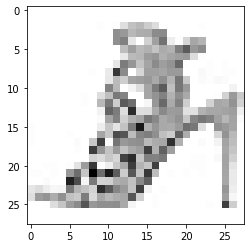

LABEL: 5
INPUT:


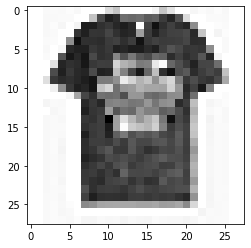

LABEL: 0
INPUT:


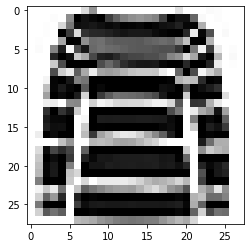

LABEL: 2
INPUT:


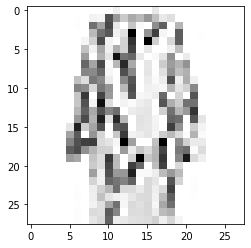

LABEL: 3
INPUT:


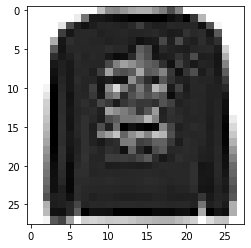

LABEL: 2
INPUT:


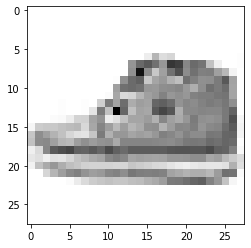

LABEL: 7
INPUT:


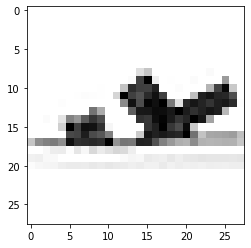

LABEL: 5
INPUT:


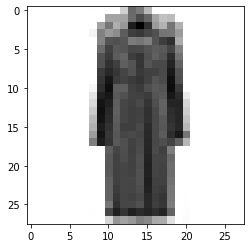

LABEL: 4
INPUT:


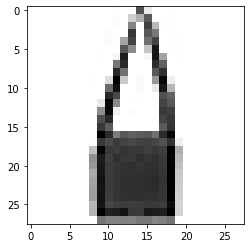

LABEL: 8
INPUT:


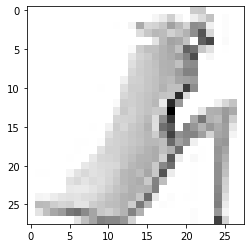

LABEL: 5
INPUT:


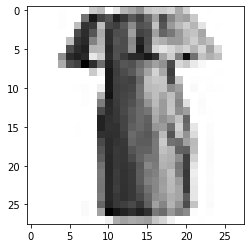

LABEL: 3
INPUT:


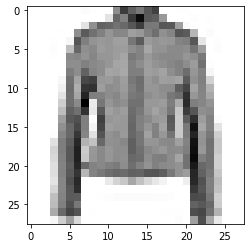

LABEL: 4
INPUT:


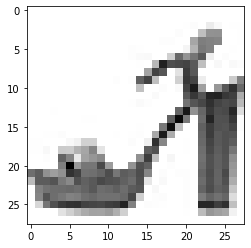

LABEL: 5
INPUT:


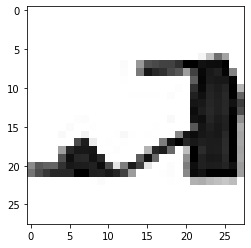

LABEL: 5
INPUT:


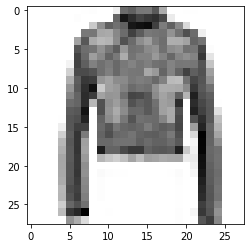

LABEL: 4
INPUT:


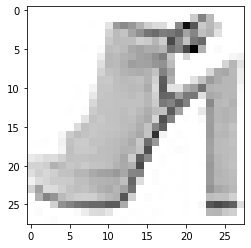

LABEL: 5
INPUT:


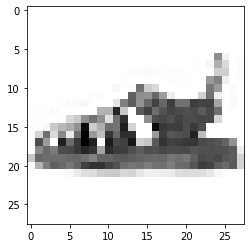

LABEL: 5
INPUT:


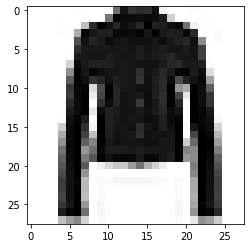

LABEL: 4
INPUT:


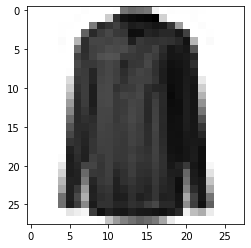

LABEL: 6
INPUT:


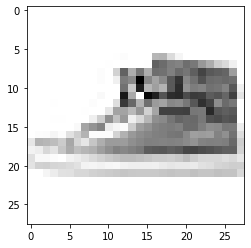

LABEL: 7
INPUT:


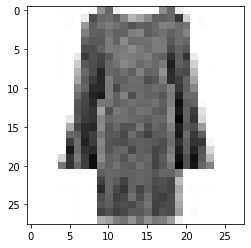

LABEL: 3
INPUT:


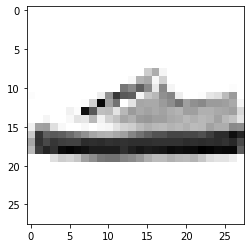

LABEL: 7
INPUT:


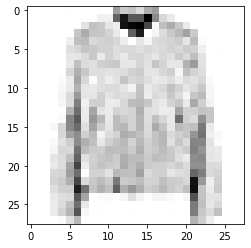

LABEL: 4
INPUT:


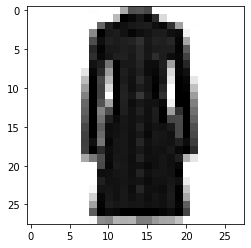

LABEL: 3
INPUT:


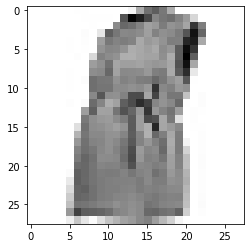

LABEL: 6
INPUT:


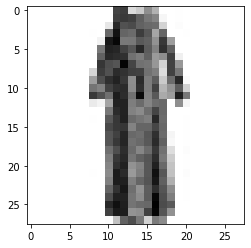

LABEL: 3
INPUT:


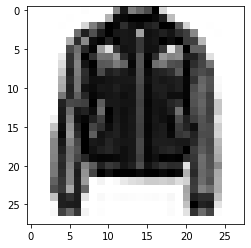

LABEL: 4
INPUT:


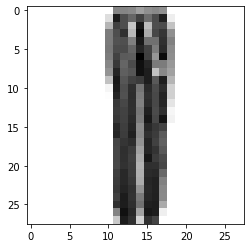

LABEL: 1
INPUT:


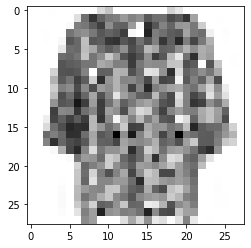

LABEL: 6
INPUT:


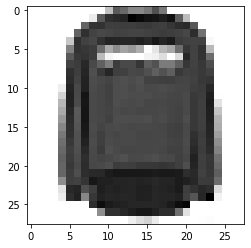

LABEL: 2
INPUT:


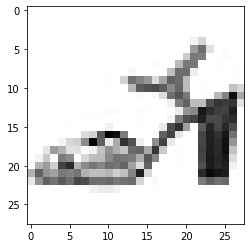

LABEL: 5
INPUT:


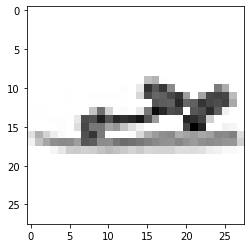

LABEL: 5
INPUT:


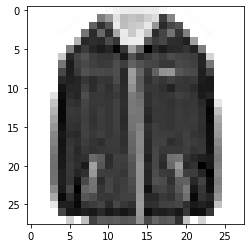

LABEL: 4
INPUT:


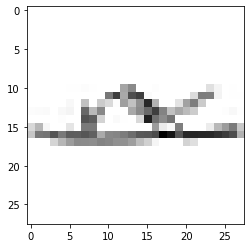

LABEL: 5
INPUT:


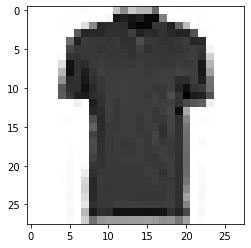

LABEL: 0
INPUT:


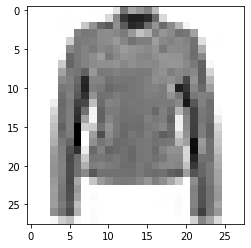

LABEL: 4
INPUT:


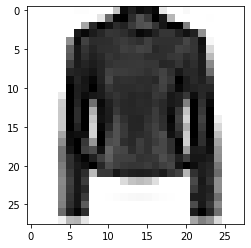

LABEL: 4
INPUT:


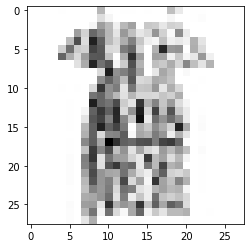

LABEL: 3
INPUT:


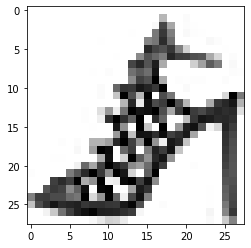

LABEL: 5
INPUT:


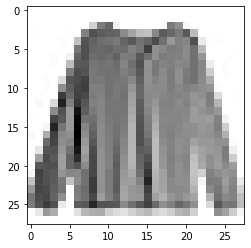

LABEL: 6
INPUT:


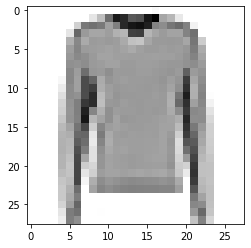

LABEL: 2
INPUT:


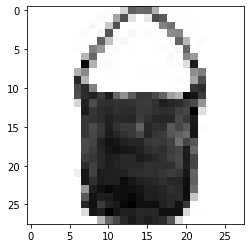

LABEL: 8
INPUT:


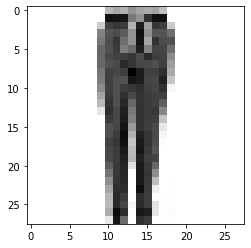

LABEL: 1
INPUT:


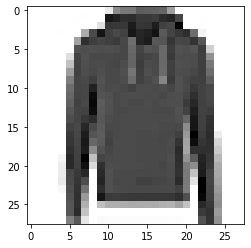

LABEL: 2
INPUT:


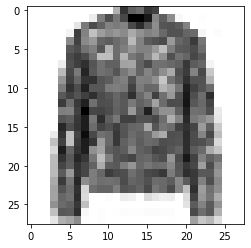

LABEL: 4
INPUT:


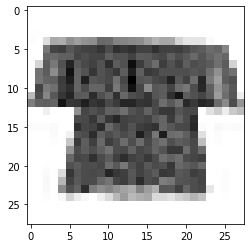

LABEL: 6
INPUT:


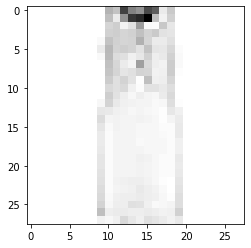

LABEL: 3
INPUT:


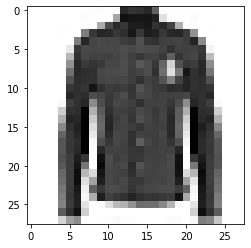

LABEL: 6
INPUT:


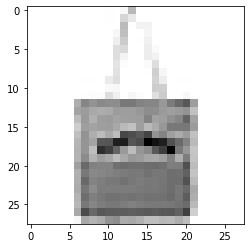

LABEL: 8
INPUT:


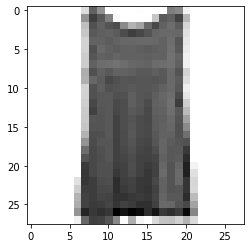

LABEL: 0
INPUT:


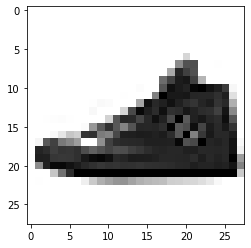

LABEL: 7
INPUT:


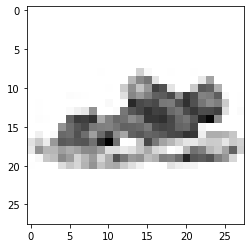

LABEL: 5
INPUT:


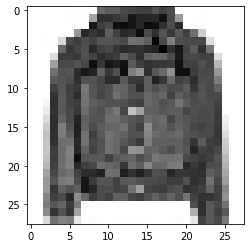

LABEL: 4
INPUT:


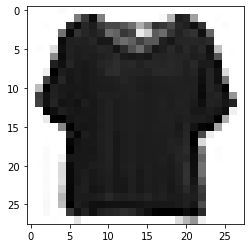

LABEL: 6
INPUT:


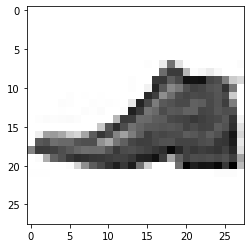

LABEL: 9
INPUT:


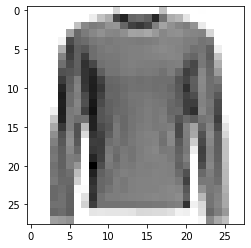

LABEL: 2
INPUT:


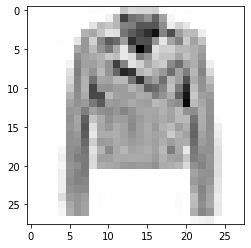

LABEL: 4
INPUT:


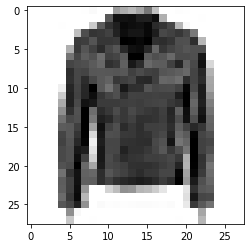

LABEL: 4
INPUT:


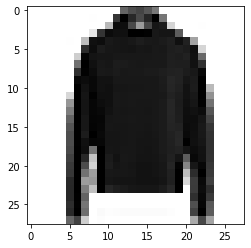

LABEL: 2
INPUT:


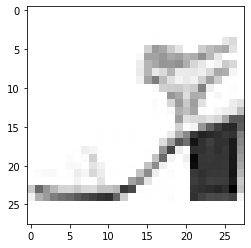

LABEL: 5
INPUT:


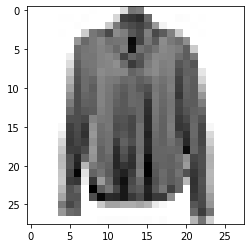

LABEL: 6
INPUT:


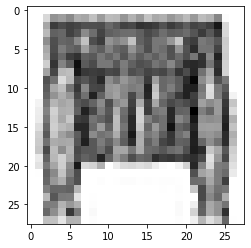

LABEL: 6
INPUT:


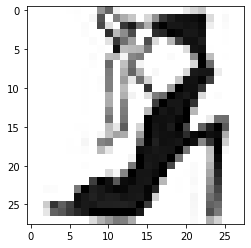

LABEL: 5
INPUT:


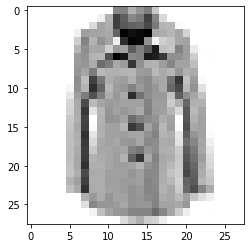

LABEL: 4
INPUT:


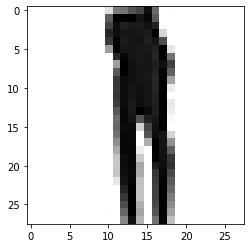

LABEL: 1
INPUT:


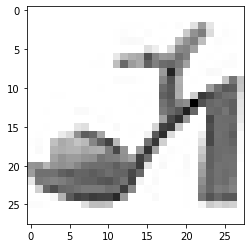

LABEL: 5
INPUT:


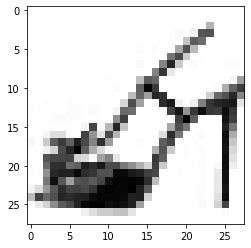

LABEL: 5
INPUT:


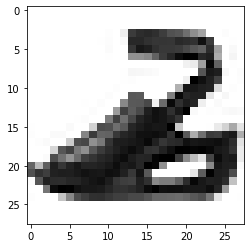

LABEL: 5
INPUT:


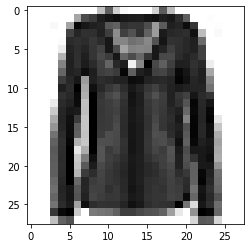

LABEL: 6
INPUT:


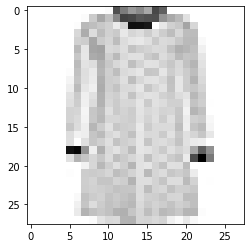

LABEL: 3
INPUT:


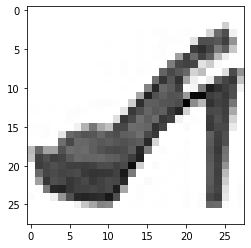

LABEL: 5
INPUT:


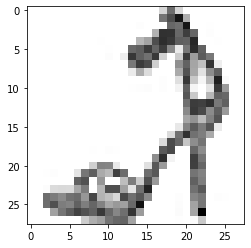

LABEL: 5
INPUT:


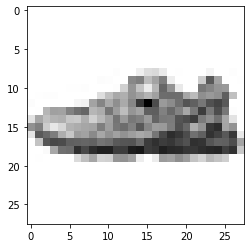

LABEL: 7
INPUT:


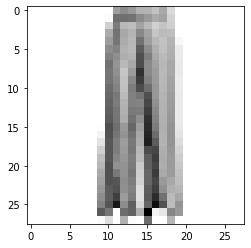

LABEL: 1
INPUT:


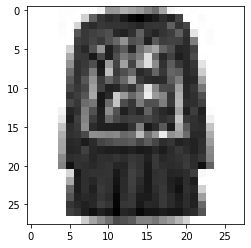

LABEL: 3
INPUT:


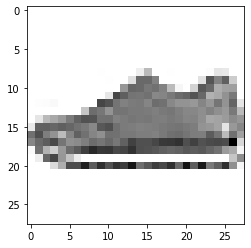

LABEL: 7
INPUT:


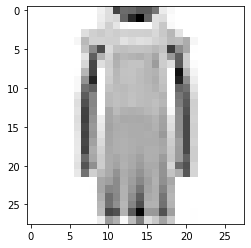

LABEL: 3
INPUT:


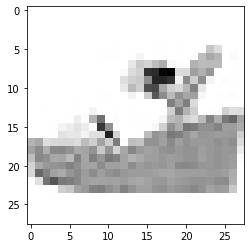

LABEL: 5
INPUT:


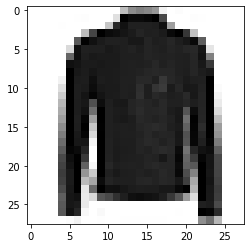

LABEL: 4
INPUT:


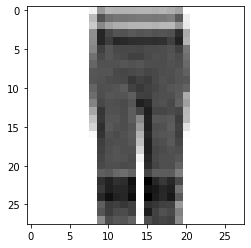

LABEL: 1
INPUT:


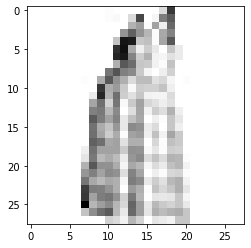

LABEL: 3
INPUT:


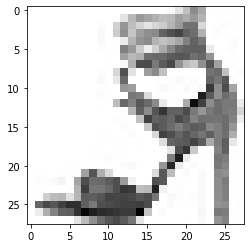

LABEL: 5
INPUT:


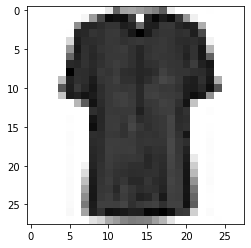

LABEL: 6
INPUT:


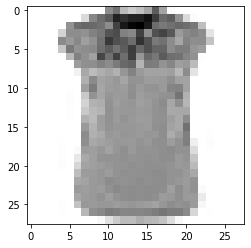

LABEL: 6
INPUT:


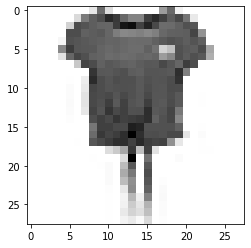

LABEL: 0
INPUT:


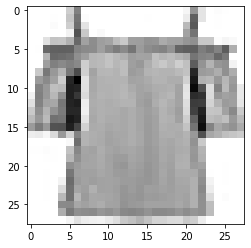

LABEL: 6
INPUT:


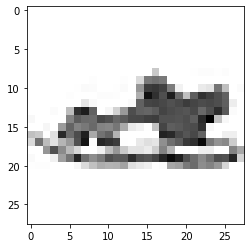

LABEL: 5
INPUT:


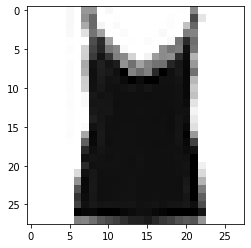

LABEL: 0
INPUT:


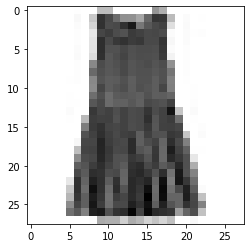

LABEL: 3
INPUT:


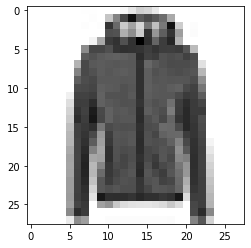

LABEL: 4
INPUT:


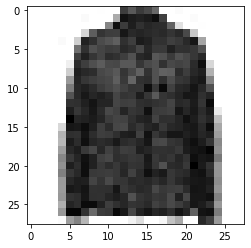

LABEL: 6
INPUT:


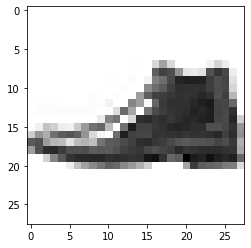

LABEL: 9
INPUT:


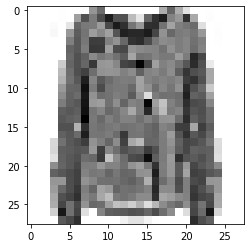

LABEL: 6
INPUT:


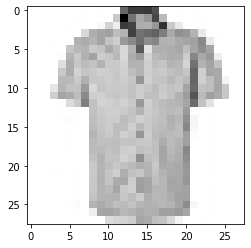

LABEL: 6
INPUT:


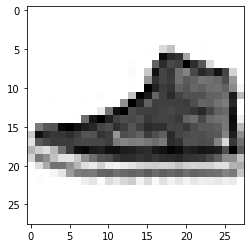

LABEL: 7
INPUT:


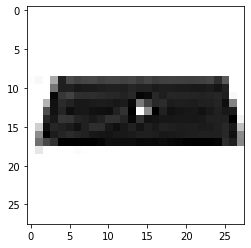

LABEL: 8
INPUT:


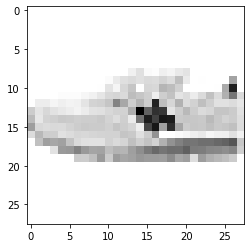

LABEL: 7
INPUT:


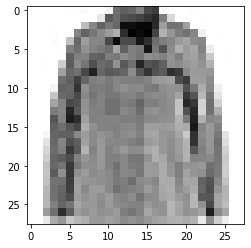

LABEL: 4
INPUT:


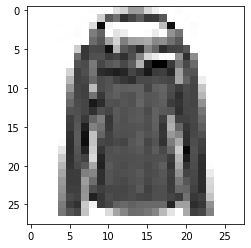

LABEL: 4
INPUT:


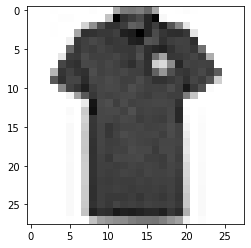

LABEL: 0
INPUT:


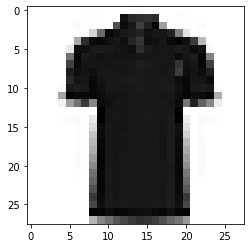

LABEL: 0
INPUT:


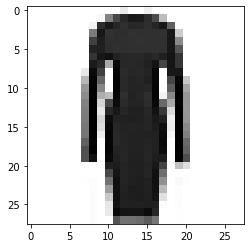

LABEL: 3
INPUT:


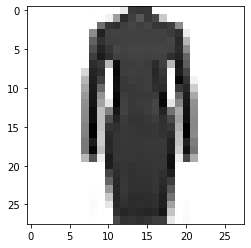

LABEL: 3
INPUT:


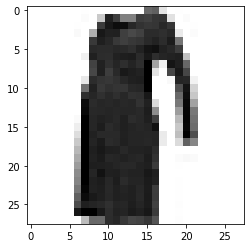

LABEL: 3
INPUT:


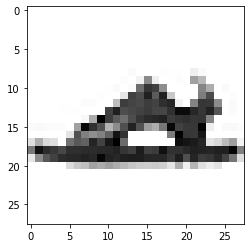

LABEL: 5
INPUT:


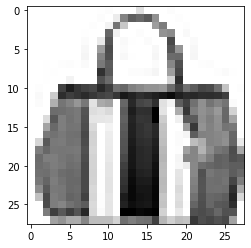

LABEL: 8
INPUT:


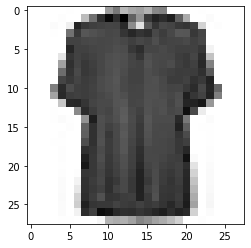

LABEL: 6
INPUT:


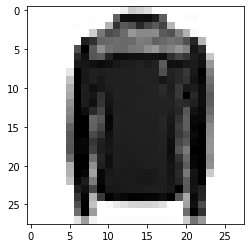

LABEL: 2
INPUT:


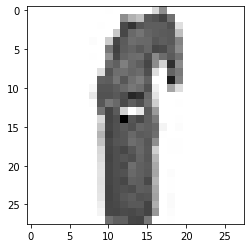

LABEL: 3
INPUT:


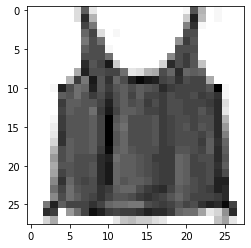

LABEL: 6
INPUT:


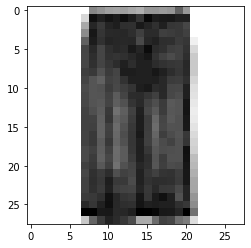

LABEL: 1
INPUT:


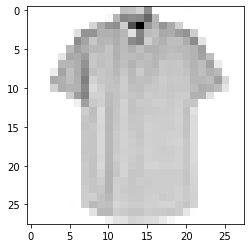

LABEL: 6
INPUT:


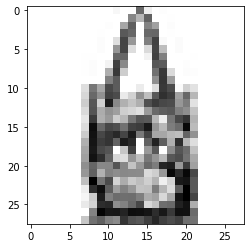

LABEL: 8
INPUT:


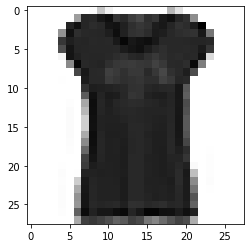

LABEL: 0
INPUT:


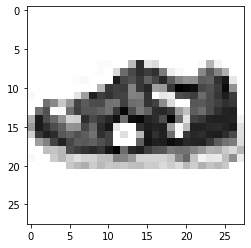

LABEL: 7
INPUT:


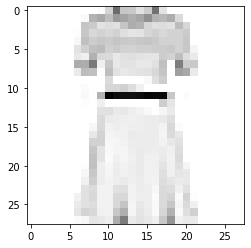

LABEL: 3
INPUT:


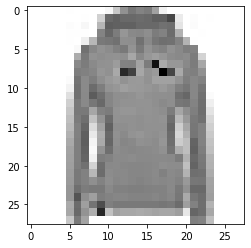

LABEL: 2
INPUT:


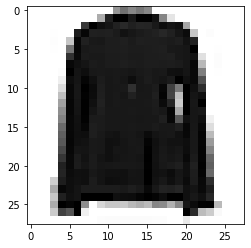

LABEL: 6
INPUT:


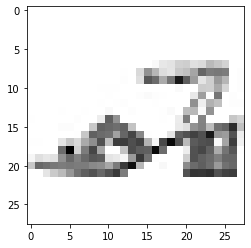

LABEL: 5
INPUT:


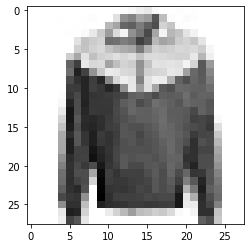

LABEL: 4
INPUT:


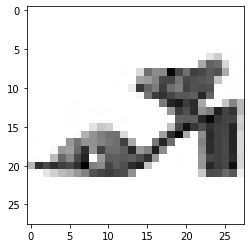

LABEL: 5
INPUT:


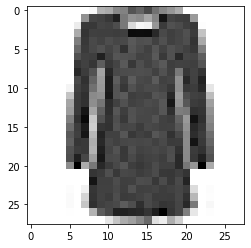

LABEL: 3
INPUT:


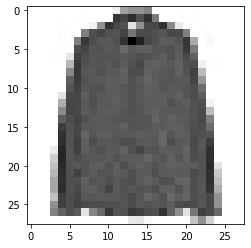

LABEL: 6
INPUT:


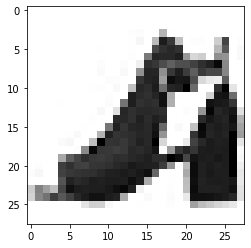

LABEL: 5
INPUT:


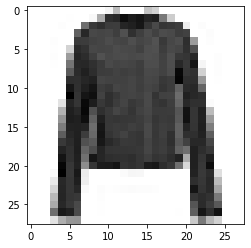

LABEL: 4
INPUT:


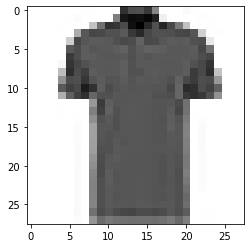

LABEL: 0
INPUT:


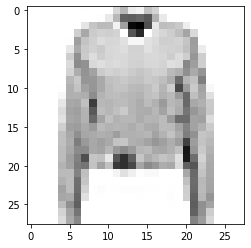

LABEL: 4
INPUT:


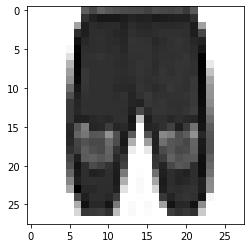

LABEL: 1
INPUT:


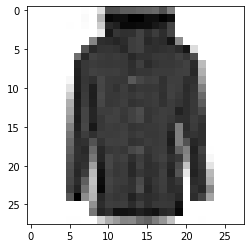

LABEL: 4
INPUT:


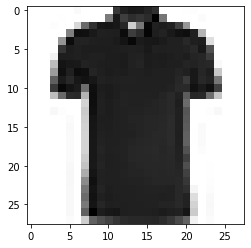

LABEL: 0
INPUT:


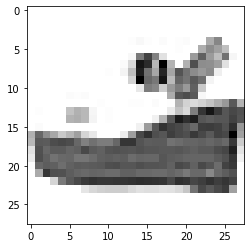

LABEL: 5
INPUT:


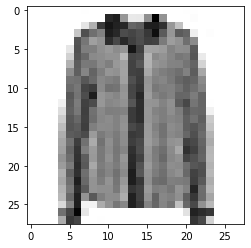

LABEL: 6
INPUT:


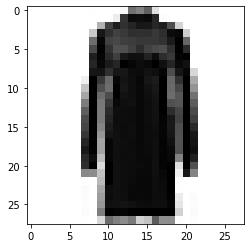

LABEL: 3
INPUT:


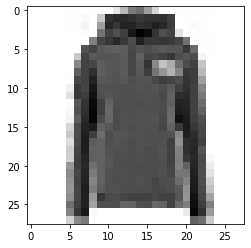

LABEL: 2
INPUT:


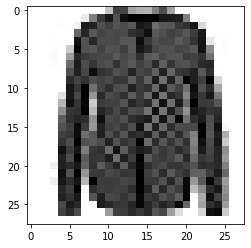

LABEL: 6
INPUT:


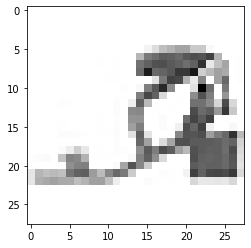

LABEL: 5
INPUT:


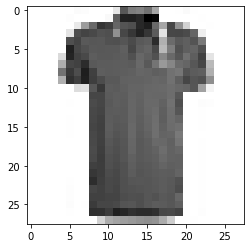

LABEL: 0
INPUT:


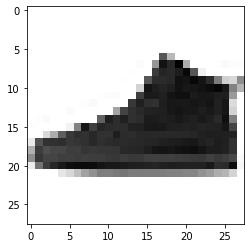

LABEL: 7
INPUT:


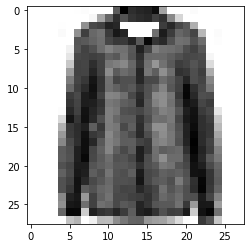

LABEL: 6
INPUT:


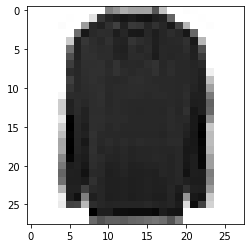

LABEL: 2
INPUT:


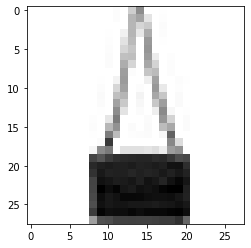

LABEL: 8
INPUT:


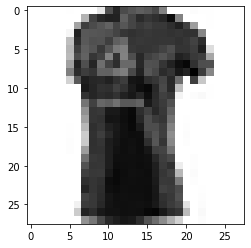

LABEL: 0
INPUT:


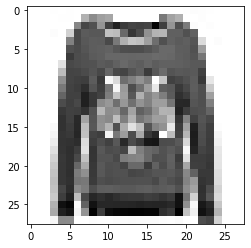

LABEL: 2
INPUT:


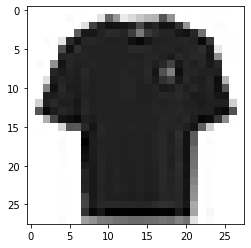

LABEL: 0
INPUT:


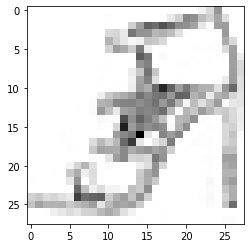

LABEL: 5
INPUT:


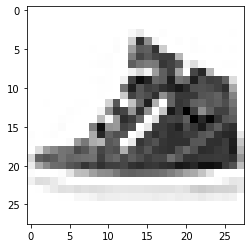

LABEL: 7
INPUT:


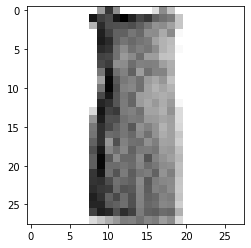

LABEL: 3
INPUT:


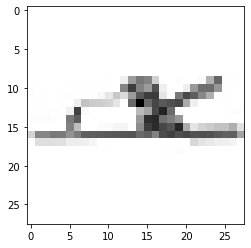

LABEL: 5
INPUT:


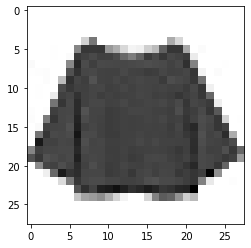

LABEL: 6
INPUT:


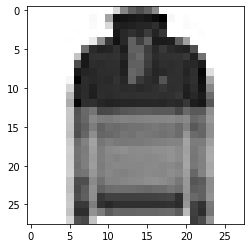

LABEL: 2
INPUT:


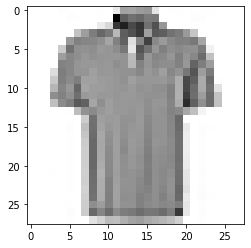

LABEL: 0
INPUT:


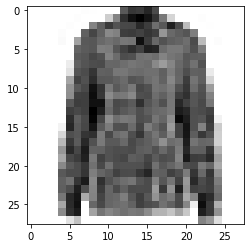

LABEL: 6
INPUT:


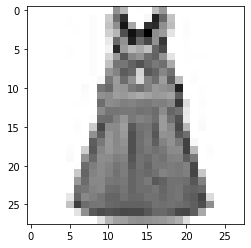

LABEL: 3
INPUT:


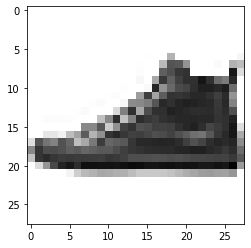

LABEL: 7
INPUT:


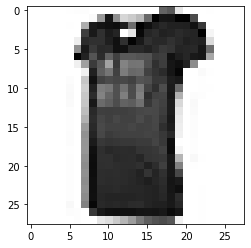

LABEL: 0
INPUT:


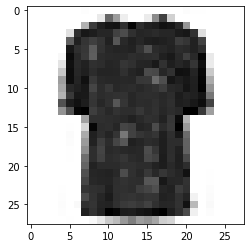

LABEL: 0
INPUT:


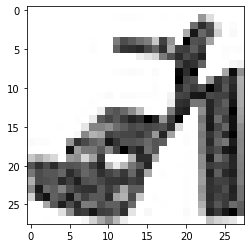

LABEL: 5
INPUT:


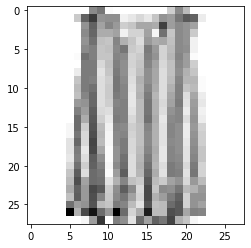

LABEL: 6
INPUT:


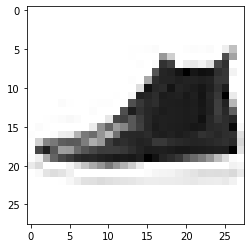

LABEL: 9
INPUT:


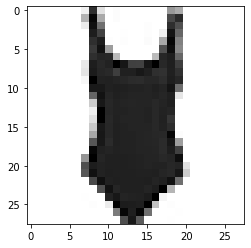

LABEL: 0
INPUT:


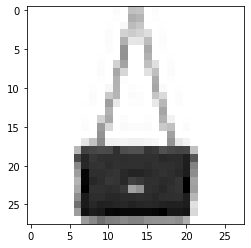

LABEL: 8
INPUT:


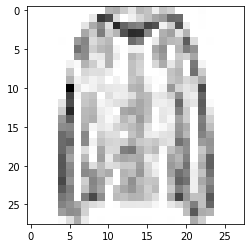

LABEL: 4
INPUT:


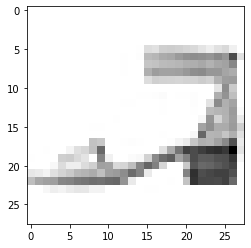

LABEL: 5
INPUT:


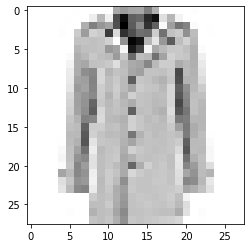

LABEL: 4
INPUT:


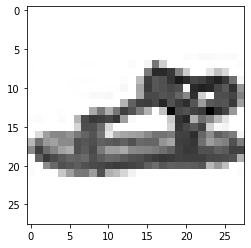

LABEL: 5
INPUT:


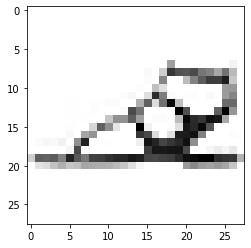

LABEL: 5
INPUT:


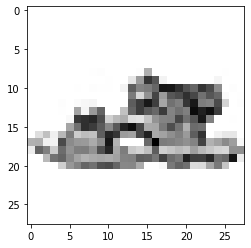

LABEL: 5
INPUT:


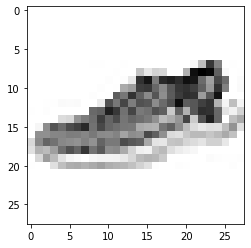

LABEL: 5
INPUT:


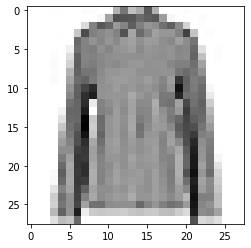

LABEL: 6
INPUT:


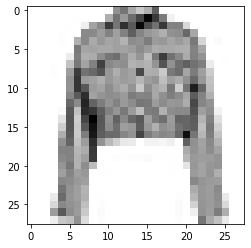

LABEL: 4
INPUT:


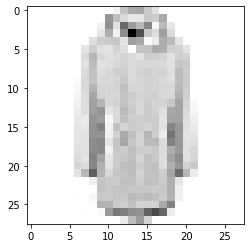

LABEL: 4
INPUT:


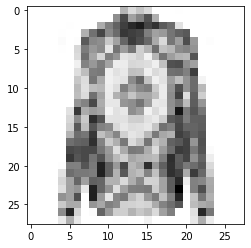

LABEL: 6
INPUT:


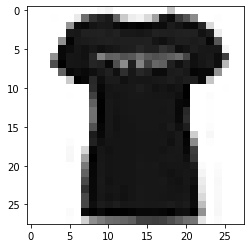

LABEL: 0
INPUT:


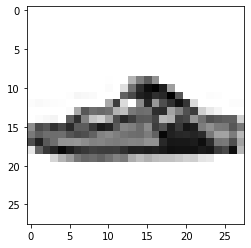

LABEL: 5
INPUT:


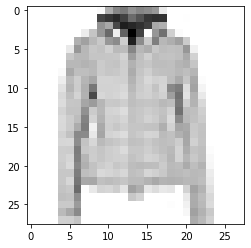

LABEL: 4
INPUT:


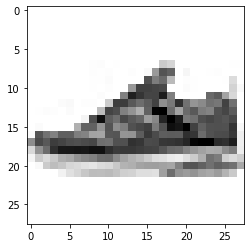

LABEL: 7
INPUT:


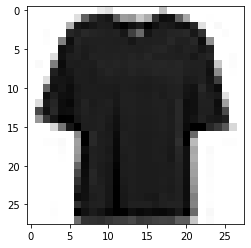

LABEL: 6
INPUT:


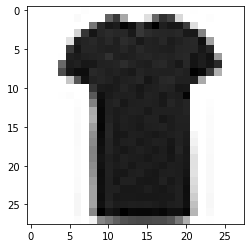

LABEL: 0
INPUT:


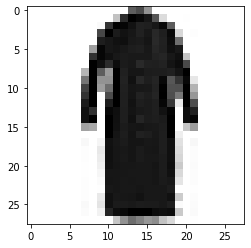

LABEL: 3
INPUT:


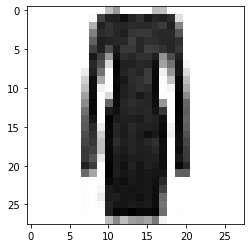

LABEL: 3
INPUT:


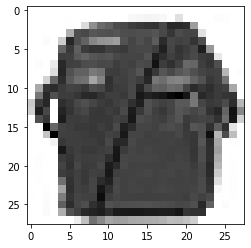

LABEL: 8
INPUT:


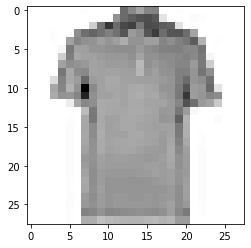

LABEL: 0
INPUT:


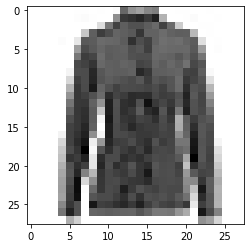

LABEL: 6
INPUT:


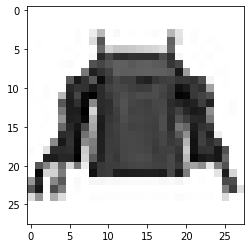

LABEL: 6
INPUT:


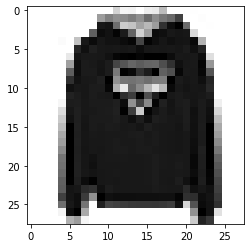

LABEL: 2
INPUT:


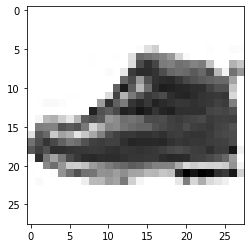

LABEL: 9
INPUT:


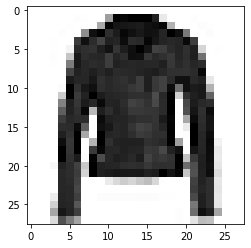

LABEL: 4
INPUT:


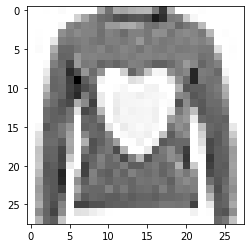

LABEL: 2
INPUT:


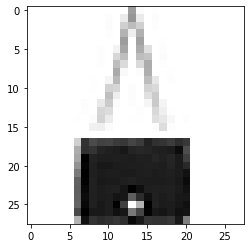

LABEL: 8
INPUT:


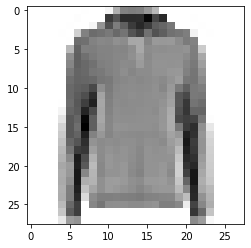

LABEL: 2
INPUT:


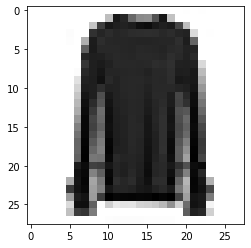

LABEL: 2
INPUT:


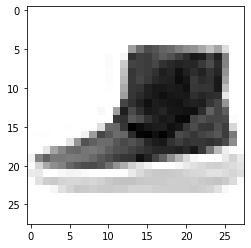

LABEL: 9
INPUT:


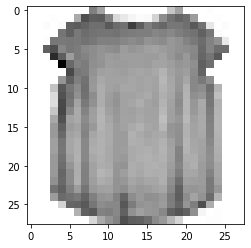

LABEL: 6
INPUT:


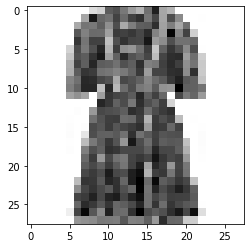

LABEL: 3
INPUT:


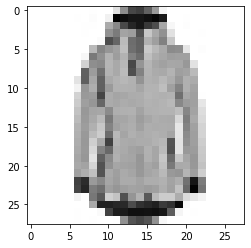

LABEL: 4
INPUT:


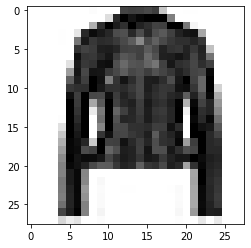

LABEL: 4
INPUT:


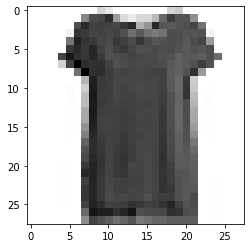

LABEL: 0
INPUT:


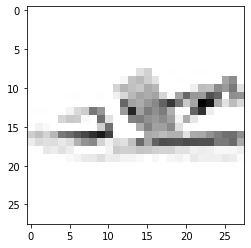

LABEL: 5
INPUT:


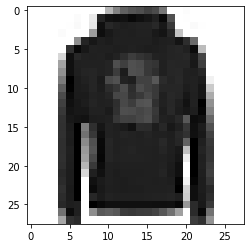

LABEL: 2
INPUT:


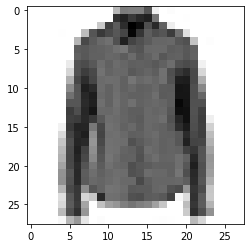

LABEL: 6
INPUT:


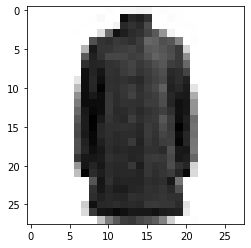

LABEL: 4
INPUT:


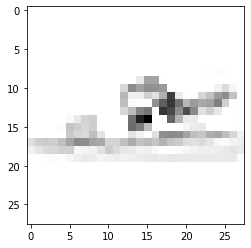

LABEL: 5
INPUT:


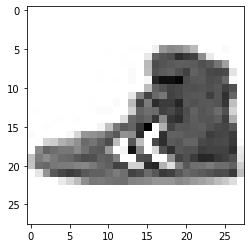

LABEL: 7
INPUT:


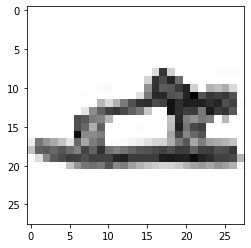

LABEL: 5
INPUT:


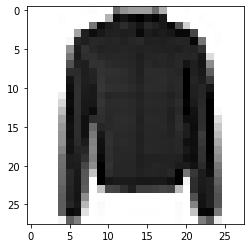

LABEL: 4
INPUT:


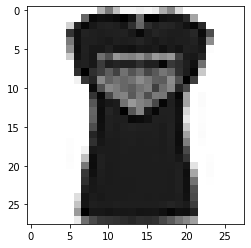

LABEL: 0
INPUT:


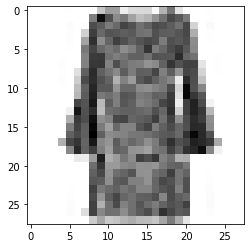

LABEL: 3
INPUT:


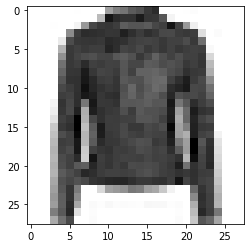

LABEL: 4
INPUT:


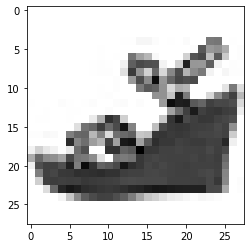

LABEL: 5
INPUT:


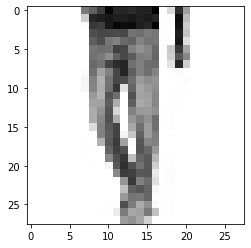

LABEL: 1
INPUT:


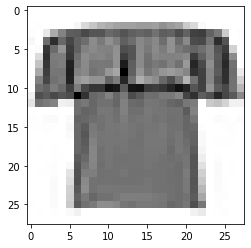

LABEL: 6
INPUT:


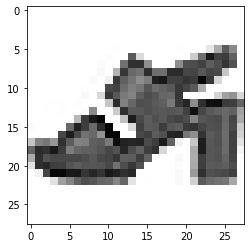

LABEL: 5
INPUT:


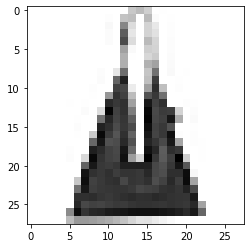

LABEL: 8
INPUT:


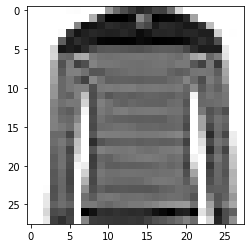

LABEL: 2
INPUT:


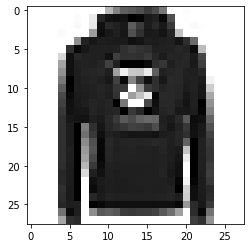

LABEL: 2
INPUT:


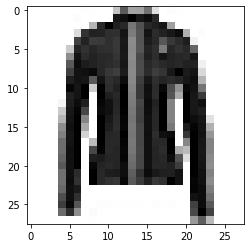

LABEL: 4
INPUT:


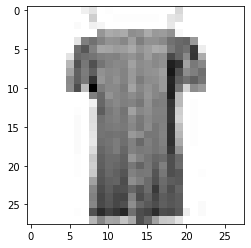

LABEL: 3
INPUT:


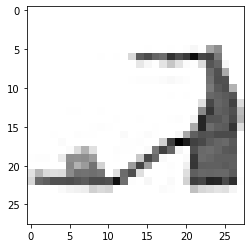

LABEL: 5
INPUT:


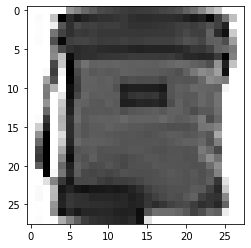

LABEL: 8
INPUT:


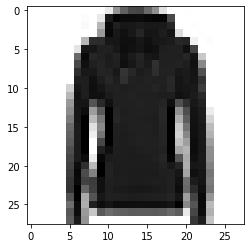

LABEL: 2
INPUT:


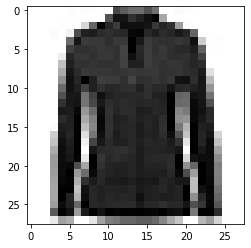

LABEL: 6
INPUT:


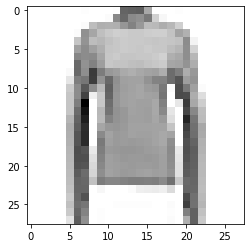

LABEL: 2
INPUT:


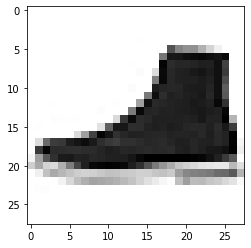

LABEL: 9
INPUT:


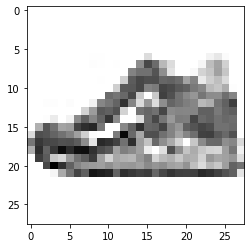

LABEL: 7
INPUT:


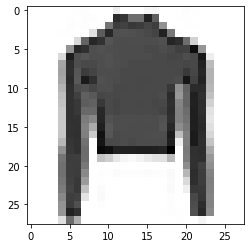

LABEL: 2
INPUT:


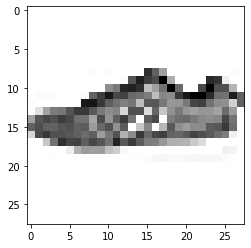

LABEL: 7
INPUT:


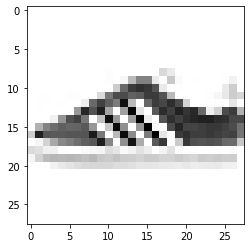

LABEL: 7
INPUT:


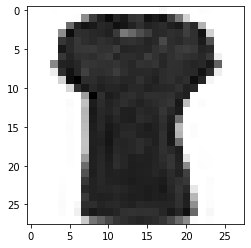

LABEL: 0
INPUT:


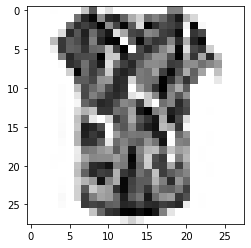

LABEL: 6
INPUT:


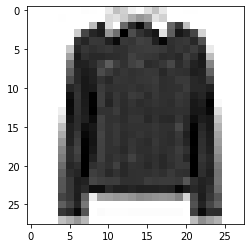

LABEL: 4
INPUT:


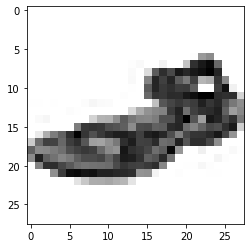

LABEL: 5
INPUT:


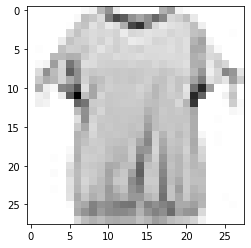

LABEL: 6
INPUT:


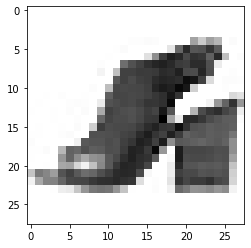

LABEL: 5
INPUT:


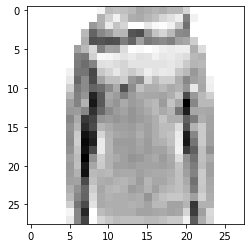

LABEL: 2
INPUT:


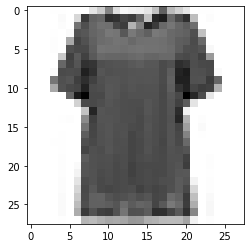

LABEL: 6
INPUT:


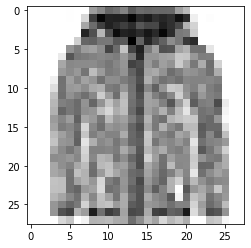

LABEL: 4
INPUT:


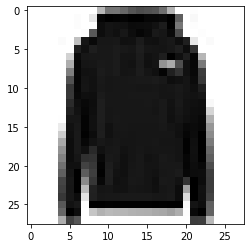

LABEL: 2
INPUT:


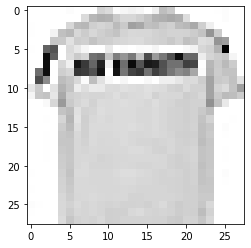

LABEL: 0
INPUT:


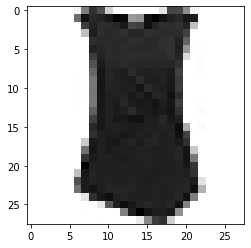

LABEL: 0
INPUT:


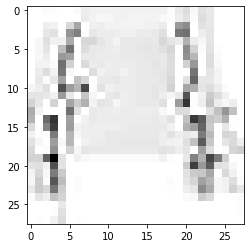

LABEL: 6
INPUT:


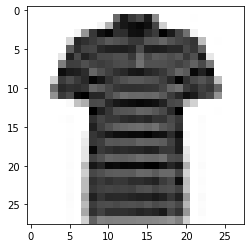

LABEL: 0
INPUT:


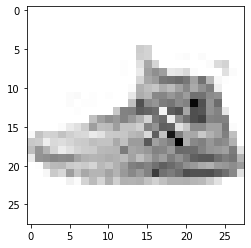

LABEL: 7
INPUT:


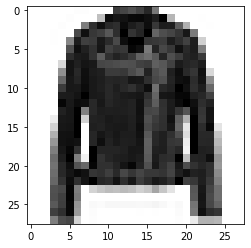

LABEL: 4
INPUT:


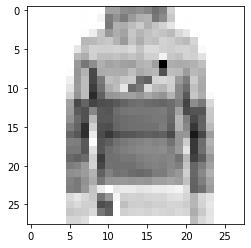

LABEL: 2
INPUT:


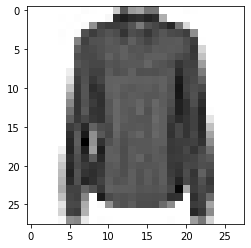

LABEL: 6
INPUT:


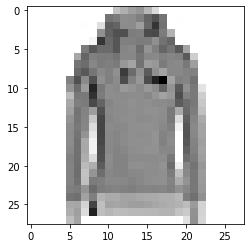

LABEL: 2
INPUT:


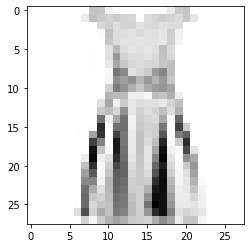

LABEL: 3
INPUT:


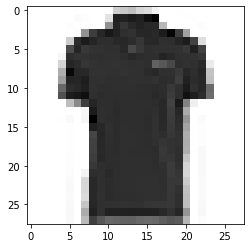

LABEL: 0
INPUT:


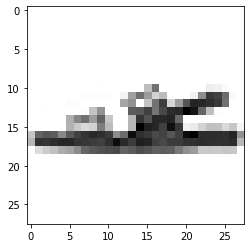

LABEL: 5
INPUT:


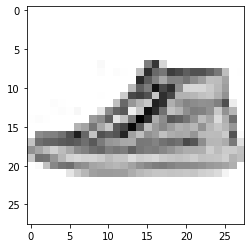

LABEL: 7
INPUT:


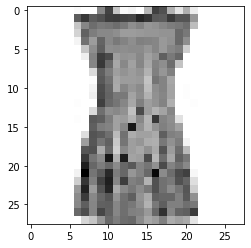

LABEL: 3
INPUT:


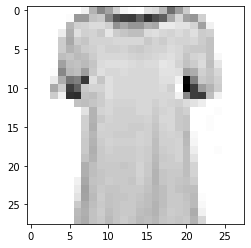

LABEL: 6
INPUT:


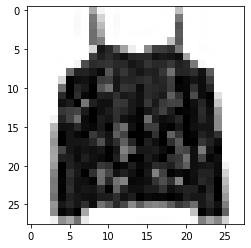

LABEL: 6
INPUT:


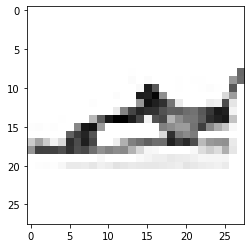

LABEL: 5
INPUT:


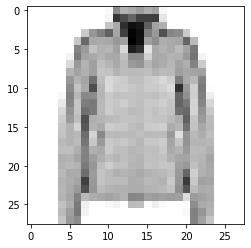

LABEL: 4
INPUT:


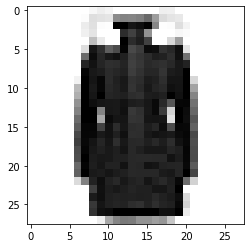

LABEL: 4
INPUT:


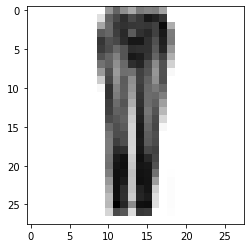

LABEL: 1
INPUT:


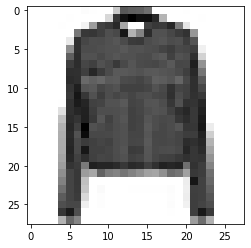

LABEL: 4
INPUT:


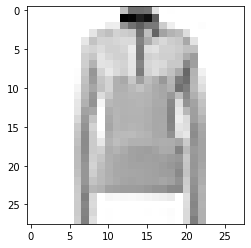

LABEL: 2
INPUT:


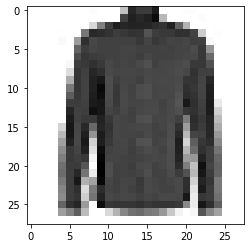

LABEL: 6
INPUT:


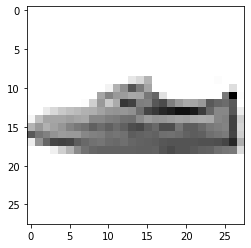

LABEL: 7
INPUT:


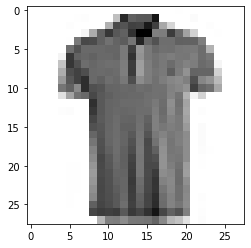

LABEL: 0
INPUT:


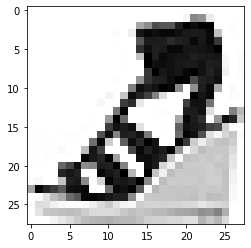

LABEL: 5
INPUT:


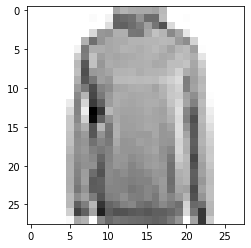

LABEL: 2
INPUT:


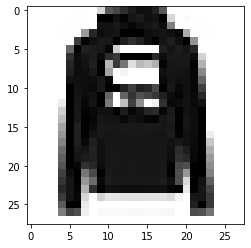

LABEL: 2
INPUT:


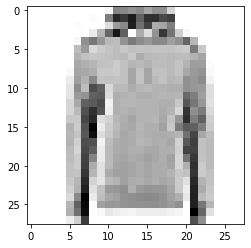

LABEL: 2
INPUT:


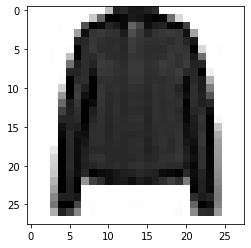

LABEL: 4
INPUT:


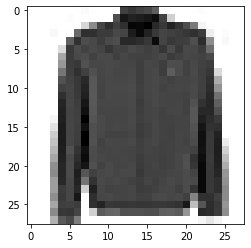

LABEL: 4
INPUT:


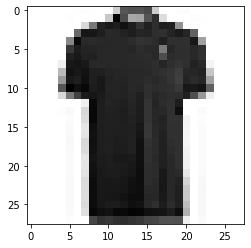

LABEL: 0
INPUT:


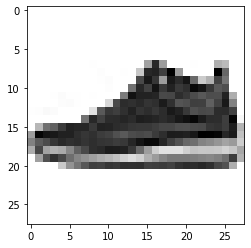

LABEL: 7
INPUT:


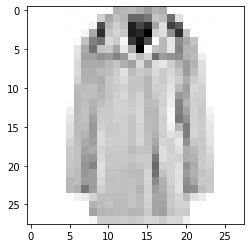

LABEL: 4
INPUT:


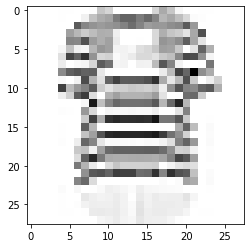

LABEL: 6
INPUT:


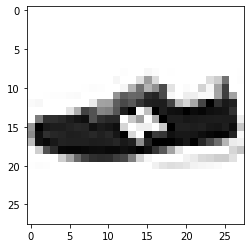

LABEL: 7
INPUT:


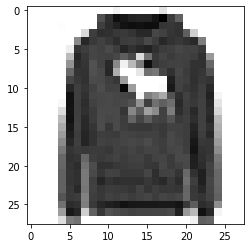

LABEL: 2
INPUT:


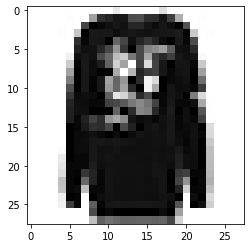

LABEL: 2
INPUT:


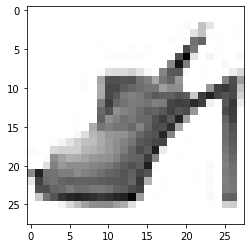

LABEL: 5
INPUT:


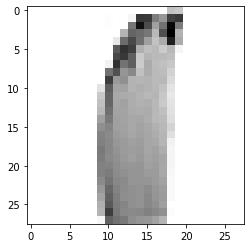

LABEL: 3
INPUT:


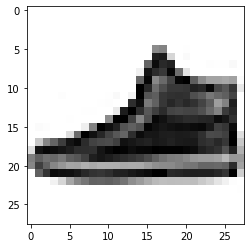

LABEL: 7
INPUT:


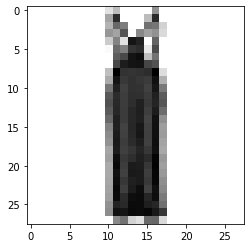

LABEL: 1
INPUT:


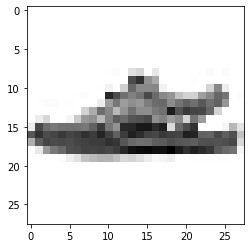

LABEL: 5
INPUT:


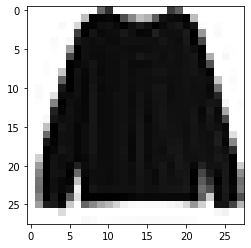

LABEL: 6
INPUT:


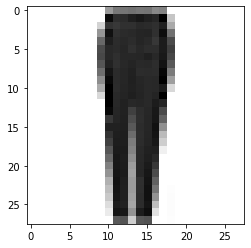

LABEL: 1
INPUT:


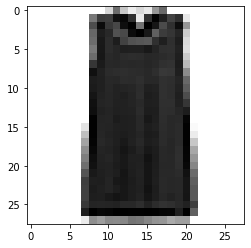

LABEL: 6
INPUT:


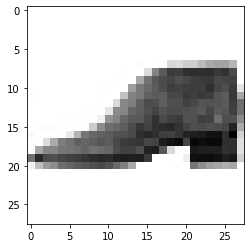

LABEL: 9
INPUT:


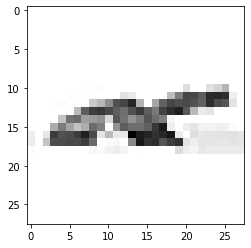

LABEL: 5
INPUT:


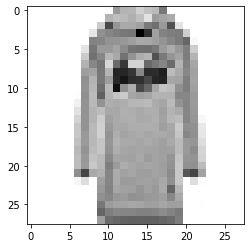

LABEL: 3
INPUT:


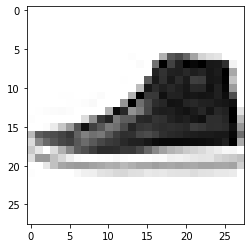

LABEL: 7
INPUT:


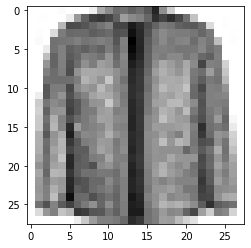

LABEL: 4
INPUT:


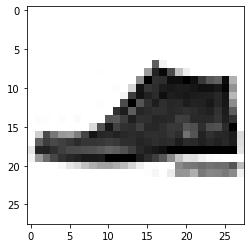

LABEL: 9
INPUT:


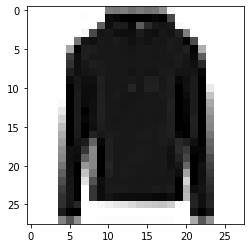

LABEL: 2
INPUT:


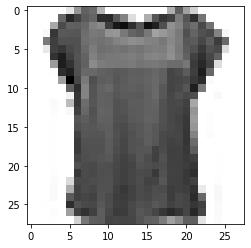

LABEL: 6
INPUT:


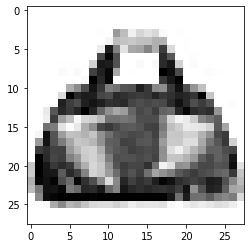

LABEL: 8
INPUT:


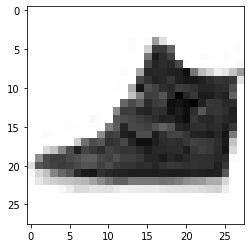

LABEL: 7
INPUT:


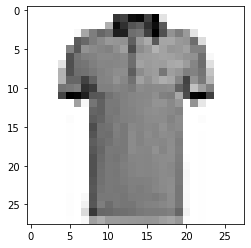

LABEL: 0
INPUT:


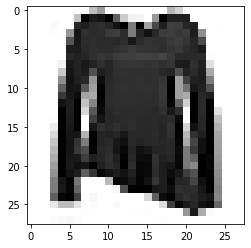

LABEL: 6
INPUT:


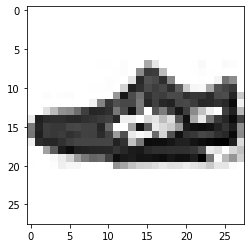

LABEL: 7
INPUT:


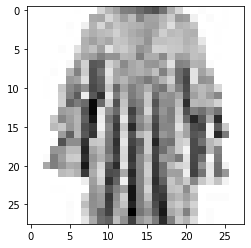

LABEL: 3
INPUT:


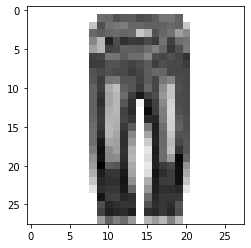

LABEL: 1
INPUT:


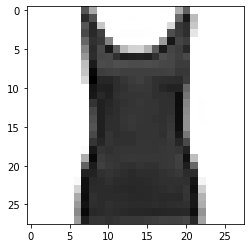

LABEL: 0
INPUT:


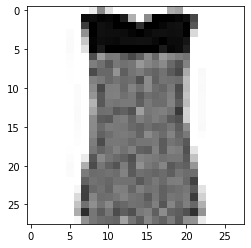

LABEL: 0
INPUT:


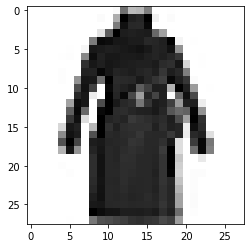

LABEL: 4
INPUT:


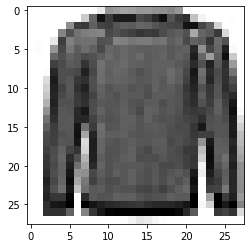

LABEL: 2
INPUT:


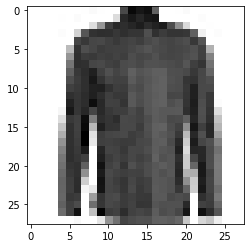

LABEL: 6
INPUT:


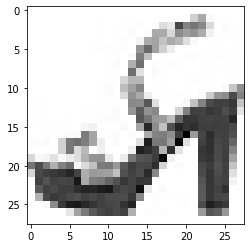

LABEL: 5
INPUT:


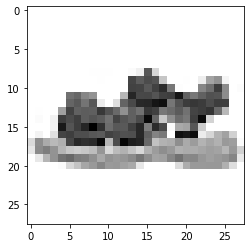

LABEL: 5
INPUT:


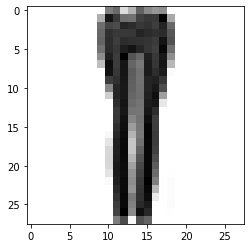

LABEL: 1
INPUT:


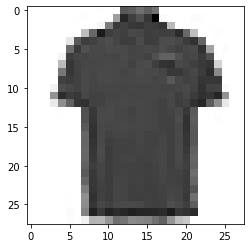

LABEL: 0
INPUT:


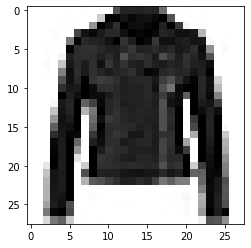

LABEL: 4
INPUT:


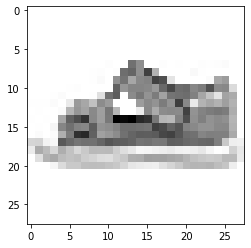

LABEL: 5
INPUT:


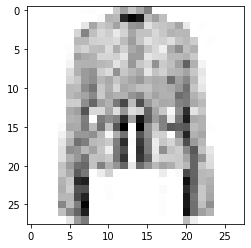

LABEL: 6
INPUT:


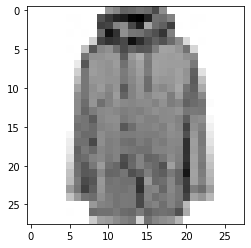

LABEL: 4
INPUT:


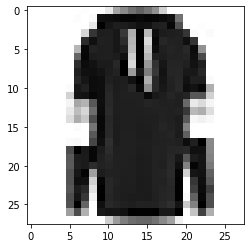

LABEL: 2
INPUT:


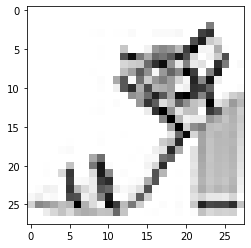

LABEL: 5
INPUT:


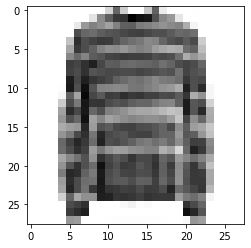

LABEL: 2
INPUT:


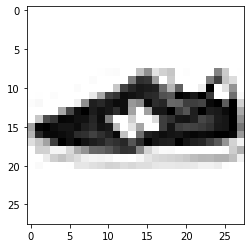

LABEL: 7
INPUT:


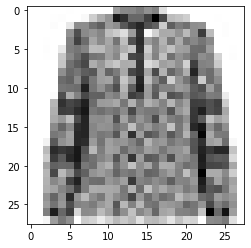

LABEL: 6
INPUT:


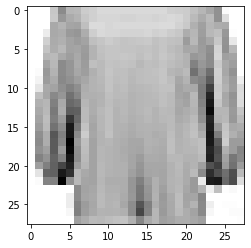

LABEL: 6
INPUT:


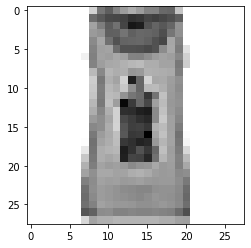

LABEL: 0
INPUT:


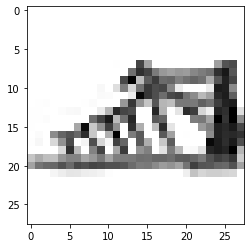

LABEL: 5
INPUT:


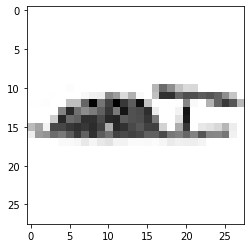

LABEL: 5
INPUT:


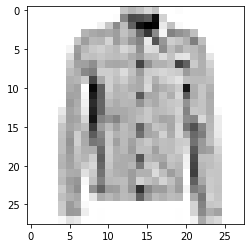

LABEL: 4
INPUT:


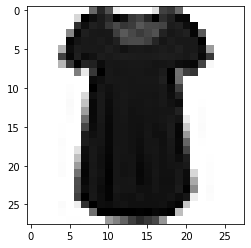

LABEL: 0
INPUT:


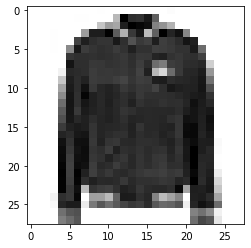

LABEL: 4
INPUT:


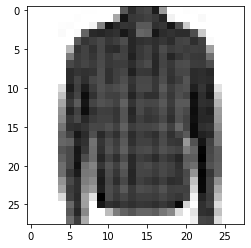

LABEL: 6
INPUT:


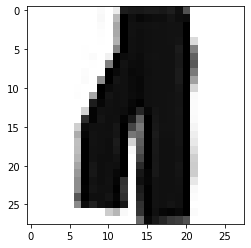

LABEL: 1
INPUT:


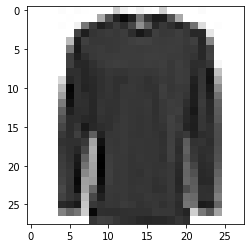

LABEL: 2
INPUT:


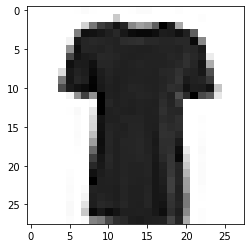

LABEL: 0
INPUT:


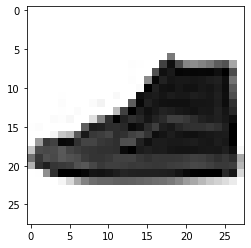

LABEL: 7
INPUT:


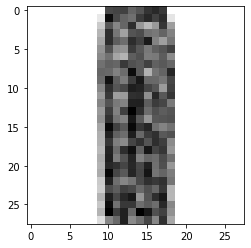

LABEL: 1
INPUT:


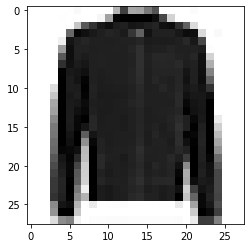

LABEL: 4
INPUT:


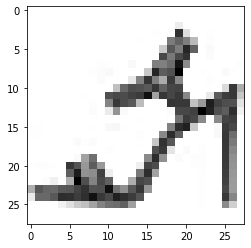

LABEL: 5
INPUT:


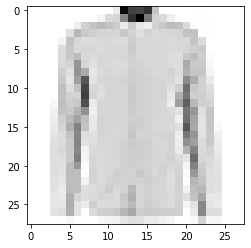

LABEL: 6
INPUT:


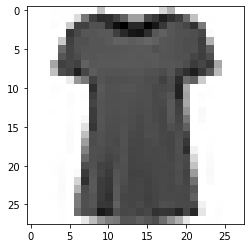

LABEL: 0
INPUT:


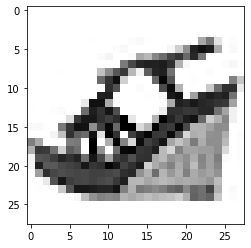

LABEL: 5
INPUT:


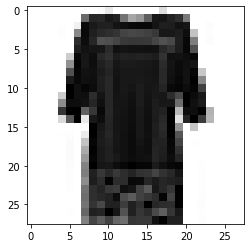

LABEL: 6
INPUT:


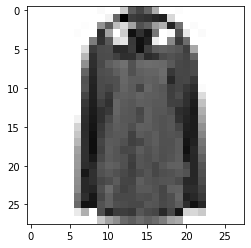

LABEL: 4
INPUT:


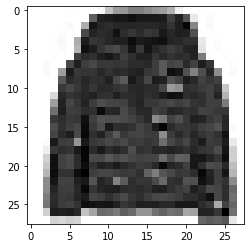

LABEL: 4
INPUT:


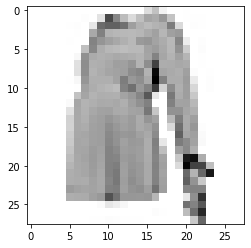

LABEL: 6
INPUT:


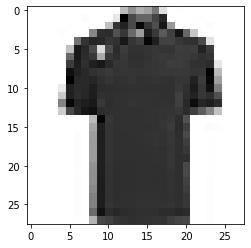

LABEL: 0
INPUT:


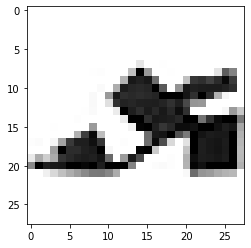

LABEL: 5
INPUT:


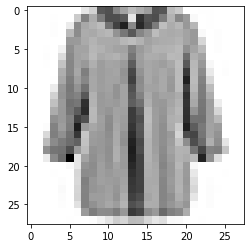

LABEL: 6
INPUT:


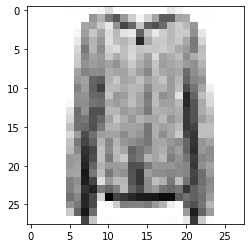

LABEL: 6
INPUT:


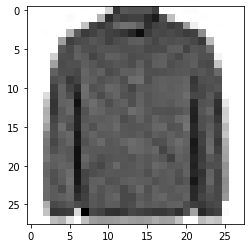

LABEL: 4
INPUT:


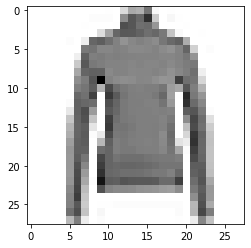

LABEL: 2
INPUT:


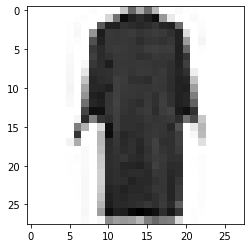

LABEL: 3
INPUT:


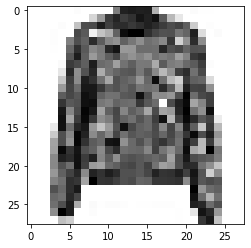

LABEL: 4
INPUT:


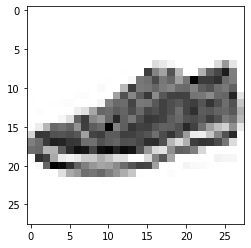

LABEL: 7
INPUT:


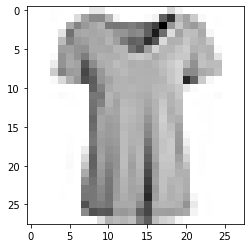

LABEL: 0
INPUT:


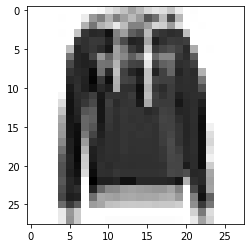

LABEL: 2
INPUT:


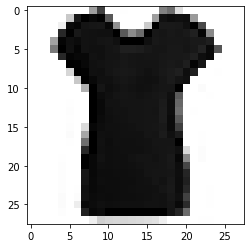

LABEL: 0
INPUT:


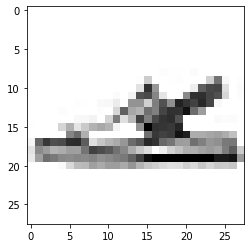

LABEL: 5
INPUT:


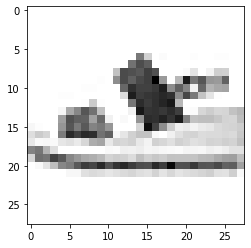

LABEL: 5
INPUT:


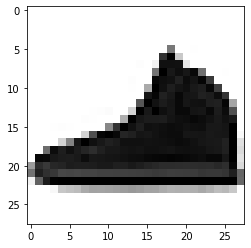

LABEL: 7
INPUT:


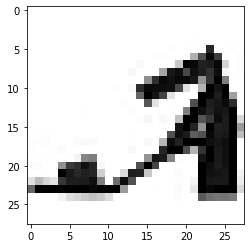

LABEL: 5
INPUT:


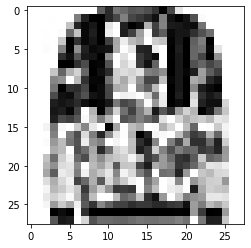

LABEL: 2
INPUT:


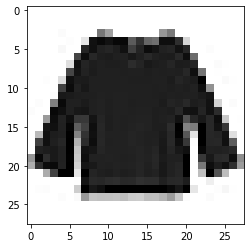

LABEL: 6
INPUT:


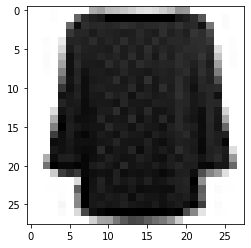

LABEL: 6
INPUT:


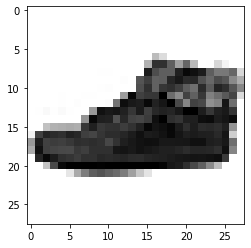

LABEL: 7
INPUT:


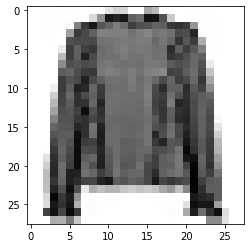

LABEL: 6
INPUT:


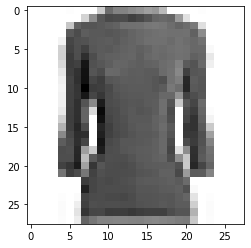

LABEL: 2
INPUT:


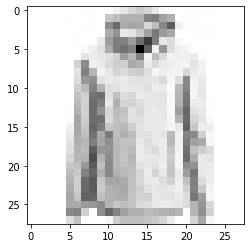

LABEL: 4
INPUT:


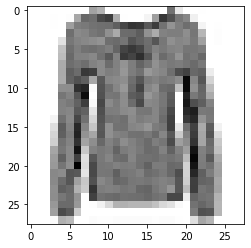

LABEL: 6
INPUT:


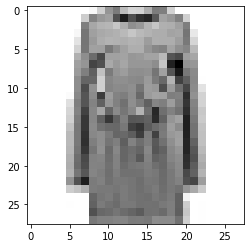

LABEL: 3
INPUT:


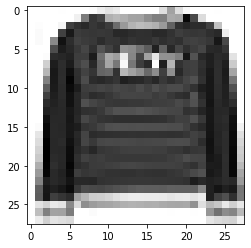

LABEL: 2
INPUT:


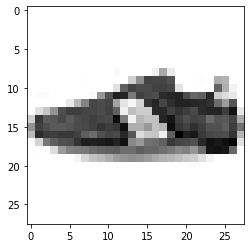

LABEL: 7
INPUT:


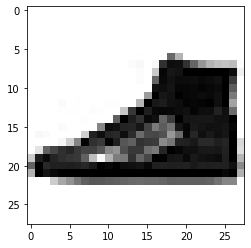

LABEL: 7
INPUT:


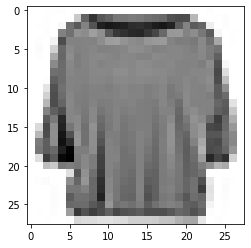

LABEL: 2
INPUT:


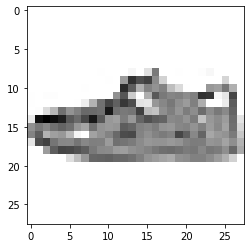

LABEL: 7
INPUT:


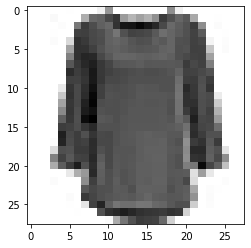

LABEL: 6
INPUT:


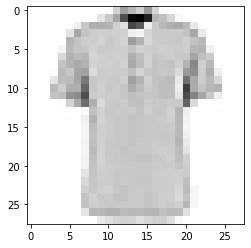

LABEL: 6
INPUT:


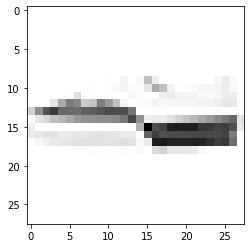

LABEL: 7
INPUT:


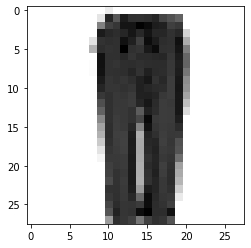

LABEL: 1
INPUT:


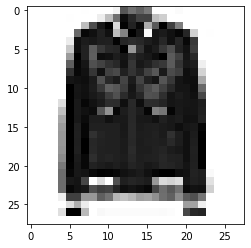

LABEL: 4
INPUT:


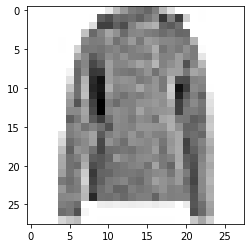

LABEL: 2
INPUT:


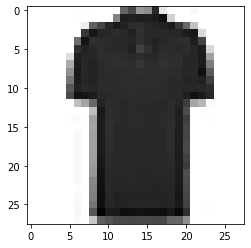

LABEL: 0
INPUT:


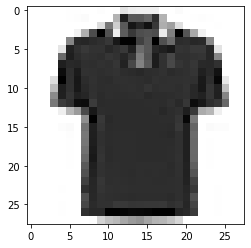

LABEL: 0
INPUT:


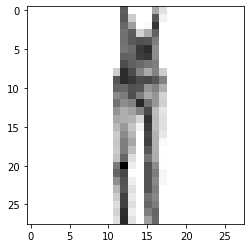

LABEL: 1
INPUT:


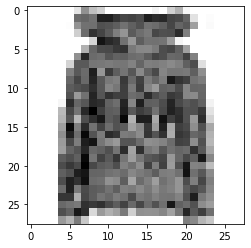

LABEL: 4
INPUT:


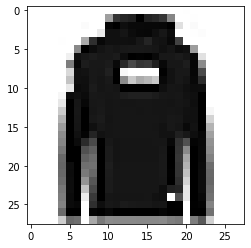

LABEL: 2
INPUT:


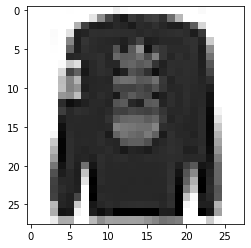

LABEL: 2
INPUT:


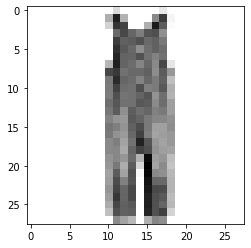

LABEL: 1
INPUT:


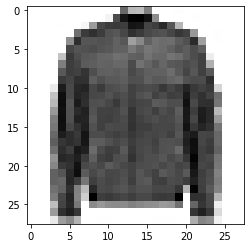

LABEL: 4
INPUT:


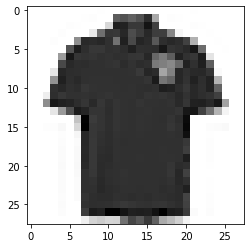

LABEL: 0
INPUT:


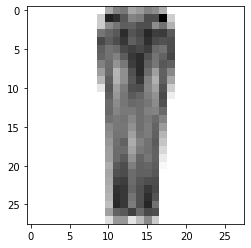

LABEL: 1
INPUT:


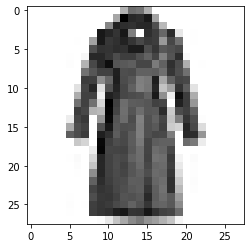

LABEL: 4
INPUT:


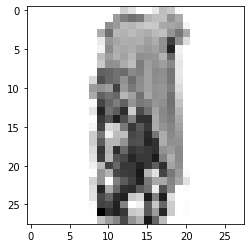

LABEL: 3
INPUT:


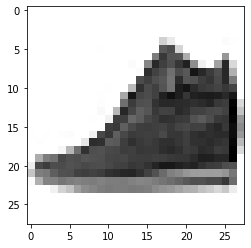

LABEL: 7
INPUT:


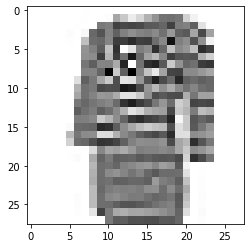

LABEL: 6
INPUT:


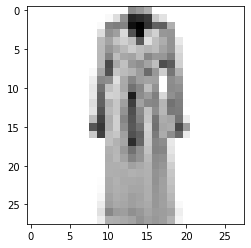

LABEL: 4
INPUT:


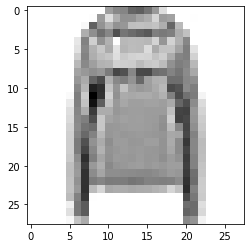

LABEL: 2
INPUT:


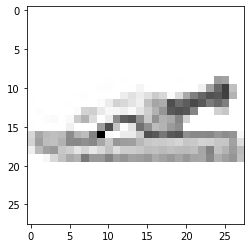

LABEL: 5
INPUT:


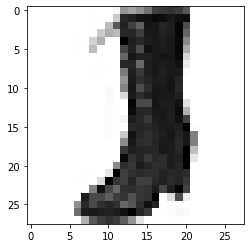

LABEL: 9
INPUT:


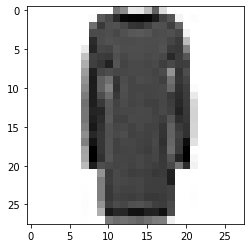

LABEL: 3
INPUT:


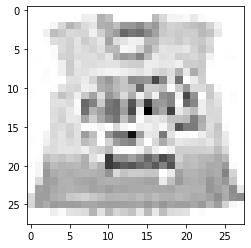

LABEL: 0
INPUT:


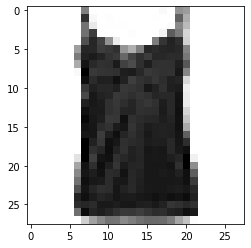

LABEL: 0
INPUT:


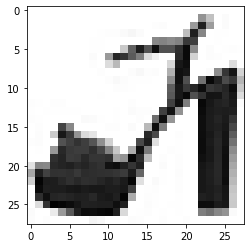

LABEL: 5
INPUT:


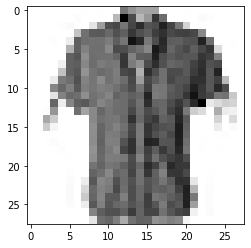

LABEL: 6
INPUT:


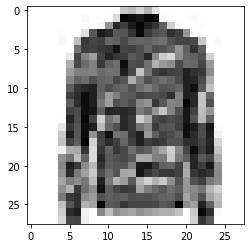

LABEL: 4
INPUT:


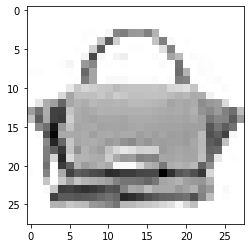

LABEL: 8
INPUT:


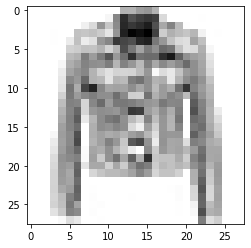

LABEL: 4
INPUT:


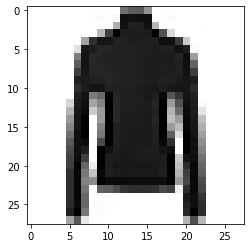

LABEL: 2
INPUT:


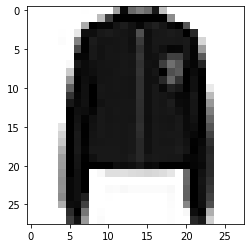

LABEL: 4
INPUT:


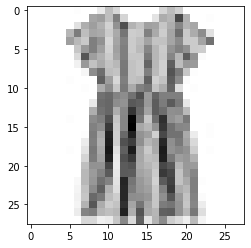

LABEL: 3
INPUT:


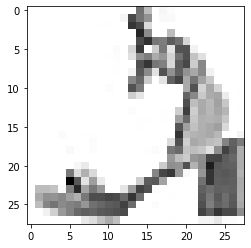

LABEL: 5
INPUT:


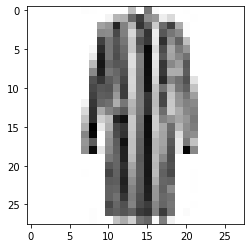

LABEL: 3
INPUT:


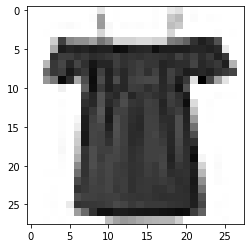

LABEL: 0
INPUT:


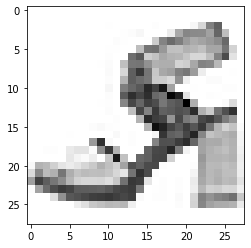

LABEL: 5
INPUT:


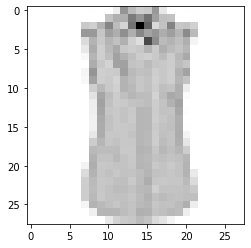

LABEL: 6
INPUT:


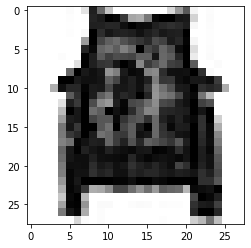

LABEL: 6
INPUT:


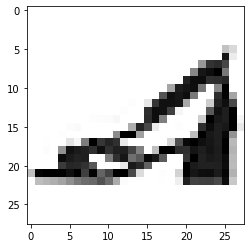

LABEL: 5
INPUT:


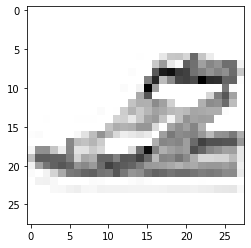

LABEL: 5
INPUT:


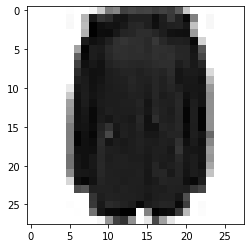

LABEL: 4
INPUT:


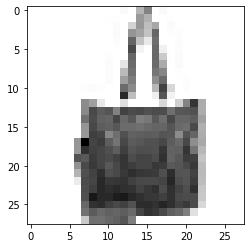

LABEL: 8
INPUT:


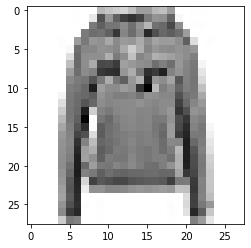

LABEL: 2
INPUT:


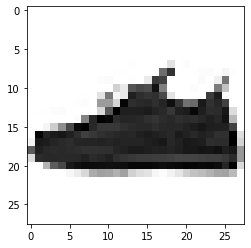

LABEL: 7
INPUT:


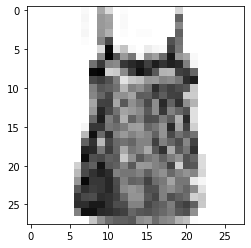

LABEL: 0
INPUT:


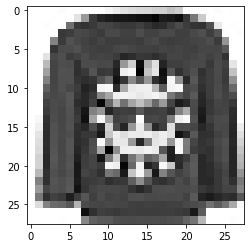

LABEL: 2
INPUT:


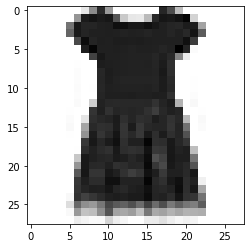

LABEL: 3
INPUT:


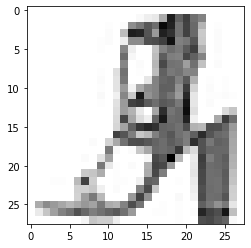

LABEL: 5
INPUT:


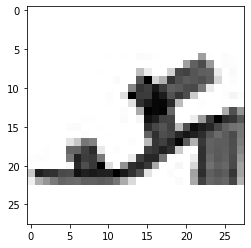

LABEL: 5
INPUT:


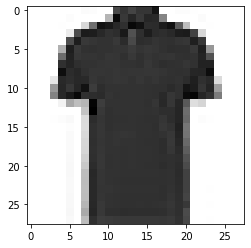

LABEL: 0
INPUT:


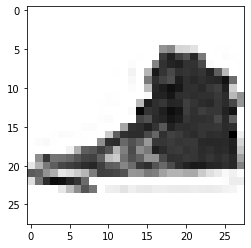

LABEL: 7
INPUT:


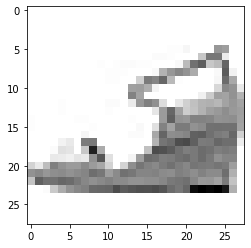

LABEL: 5
INPUT:


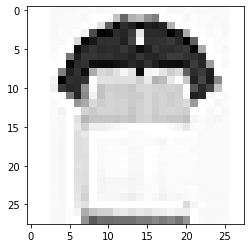

LABEL: 0
INPUT:


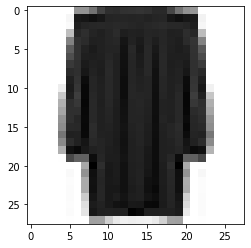

LABEL: 3
INPUT:


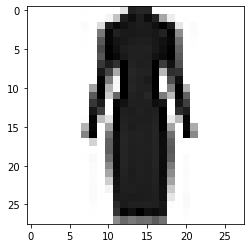

LABEL: 3
INPUT:


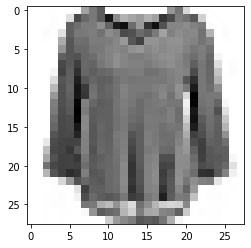

LABEL: 6
INPUT:


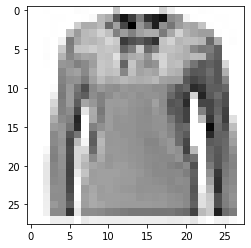

LABEL: 2
INPUT:


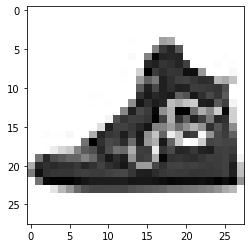

LABEL: 7
INPUT:


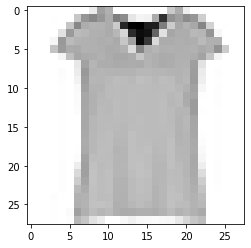

LABEL: 6
INPUT:


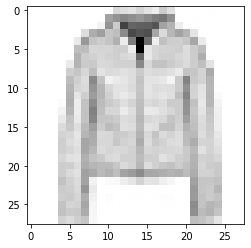

LABEL: 4
INPUT:


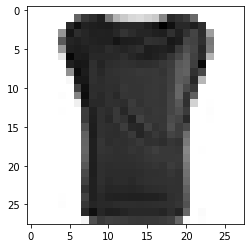

LABEL: 0
INPUT:


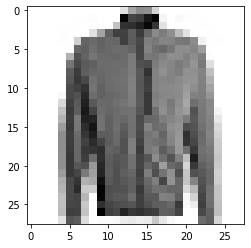

LABEL: 4
INPUT:


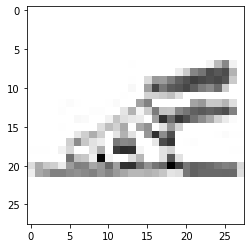

LABEL: 5
INPUT:


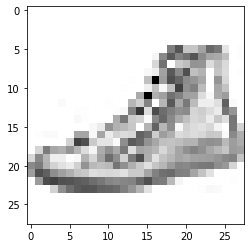

LABEL: 7
INPUT:


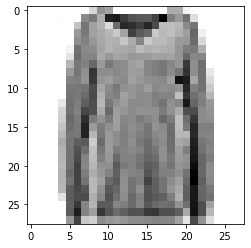

LABEL: 2
INPUT:


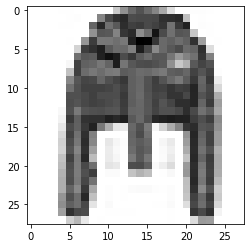

LABEL: 4
INPUT:


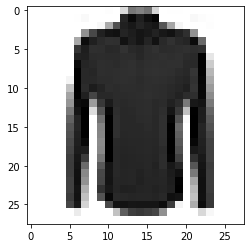

LABEL: 6
INPUT:


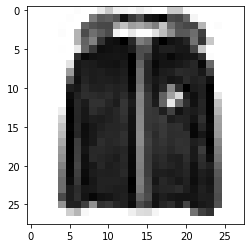

LABEL: 4
INPUT:


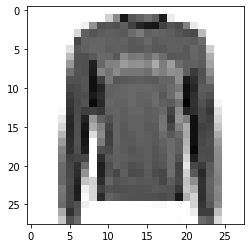

LABEL: 2
INPUT:


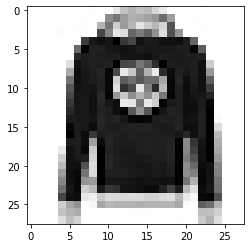

LABEL: 2
INPUT:


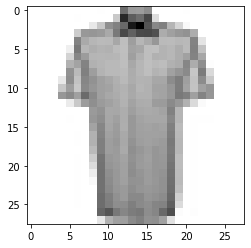

LABEL: 6
INPUT:


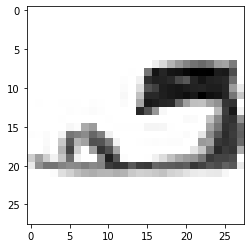

LABEL: 5
INPUT:


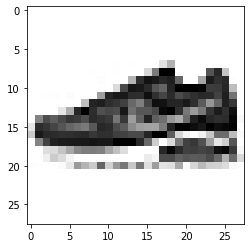

LABEL: 7
INPUT:


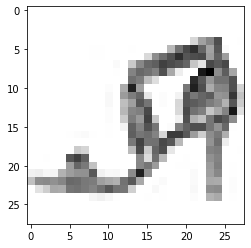

LABEL: 5
INPUT:


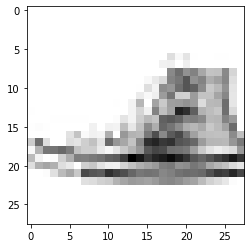

LABEL: 7
INPUT:


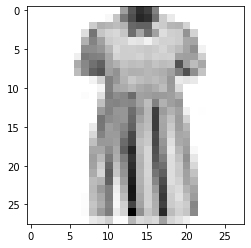

LABEL: 3
INPUT:


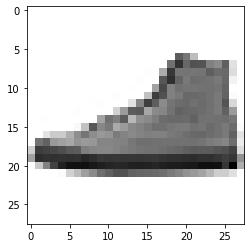

LABEL: 7
INPUT:


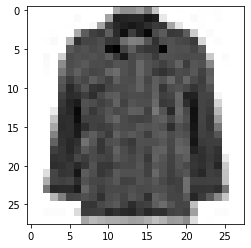

LABEL: 4
INPUT:


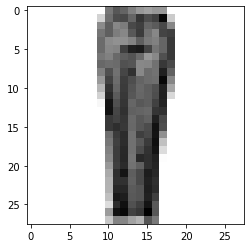

LABEL: 1
INPUT:


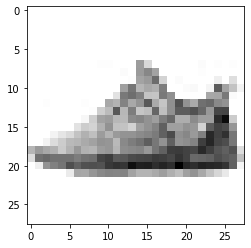

LABEL: 7
INPUT:


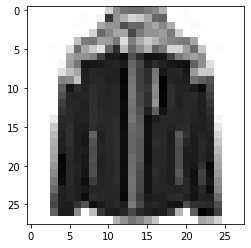

LABEL: 4
INPUT:


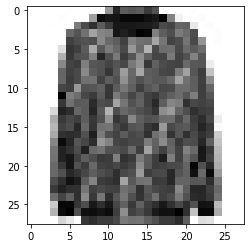

LABEL: 4
INPUT:


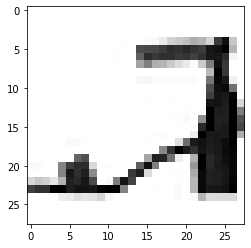

LABEL: 5
INPUT:


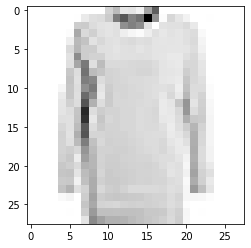

LABEL: 2
INPUT:


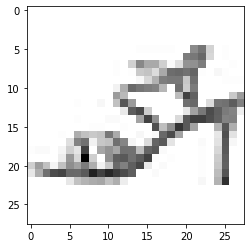

LABEL: 5
INPUT:


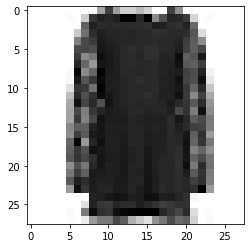

LABEL: 3
INPUT:


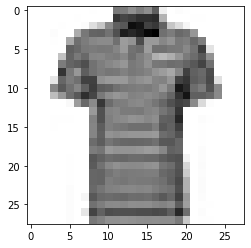

LABEL: 0
INPUT:


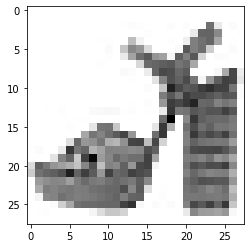

LABEL: 5
INPUT:


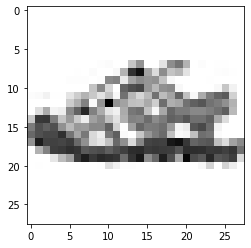

LABEL: 5
INPUT:


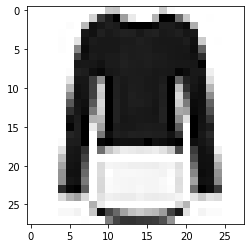

LABEL: 2
INPUT:


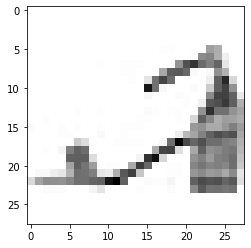

LABEL: 5
INPUT:


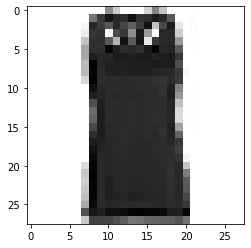

LABEL: 0
INPUT:


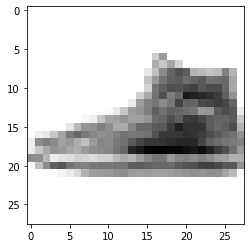

LABEL: 7
INPUT:


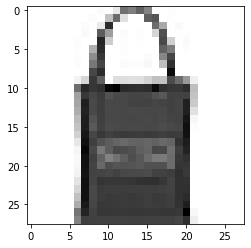

LABEL: 8
INPUT:


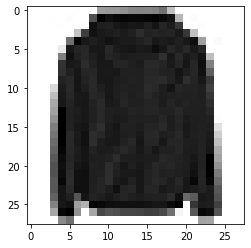

LABEL: 4
INPUT:


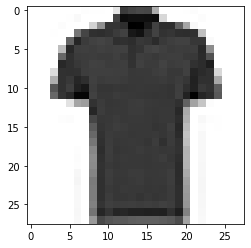

LABEL: 0
INPUT:


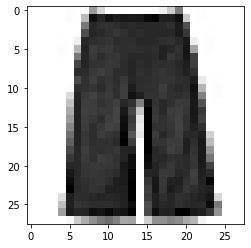

LABEL: 1
INPUT:


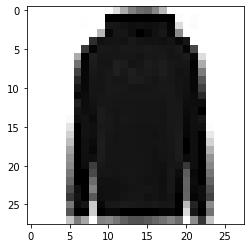

LABEL: 2
INPUT:


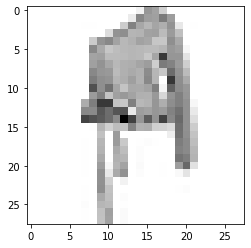

LABEL: 2
INPUT:


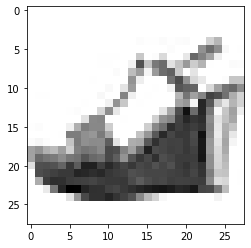

LABEL: 5
INPUT:


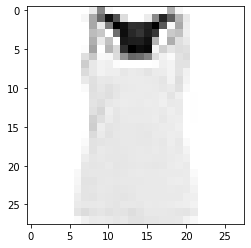

LABEL: 0
INPUT:


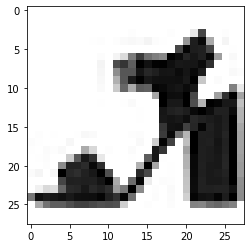

LABEL: 5
INPUT:


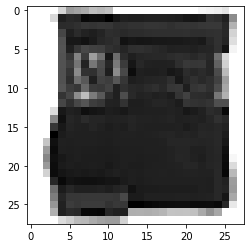

LABEL: 8
INPUT:


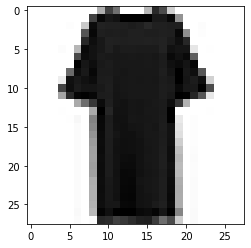

LABEL: 3
INPUT:


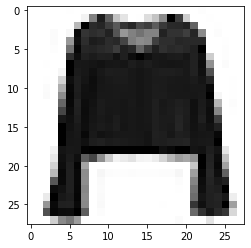

LABEL: 6
INPUT:


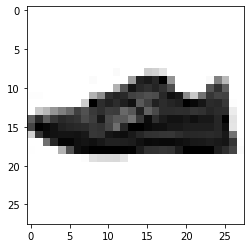

LABEL: 7
INPUT:


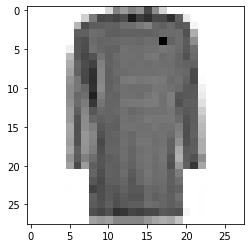

LABEL: 3
INPUT:


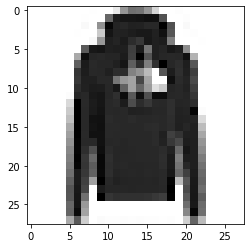

LABEL: 2
INPUT:


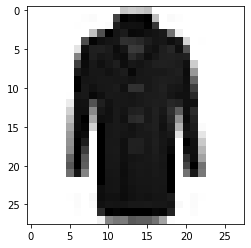

LABEL: 4
INPUT:


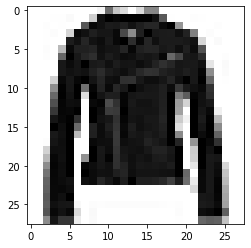

LABEL: 4
INPUT:


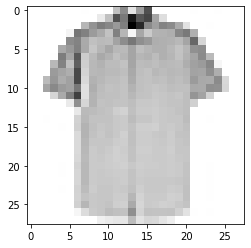

LABEL: 6
INPUT:


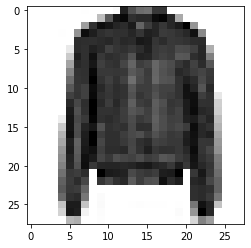

LABEL: 4
INPUT:


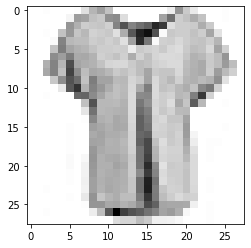

LABEL: 6
INPUT:


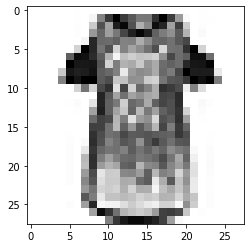

LABEL: 6
INPUT:


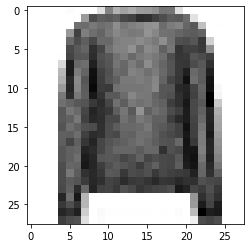

LABEL: 2
INPUT:


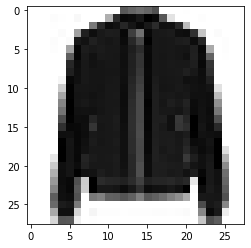

LABEL: 4
INPUT:


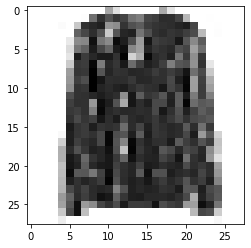

LABEL: 6
INPUT:


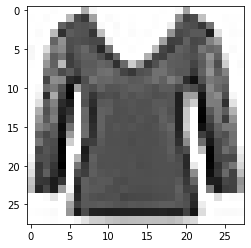

LABEL: 6
INPUT:


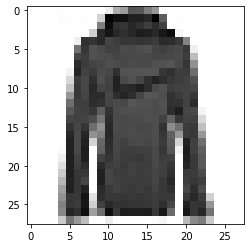

LABEL: 2
INPUT:


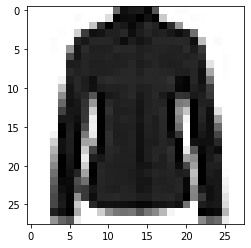

LABEL: 6
INPUT:


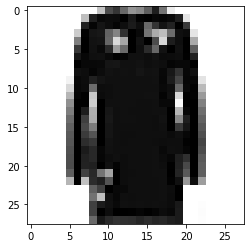

LABEL: 3
INPUT:


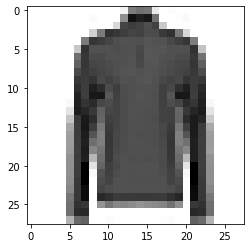

LABEL: 2
INPUT:


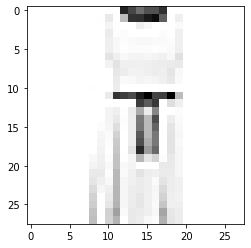

LABEL: 3
INPUT:


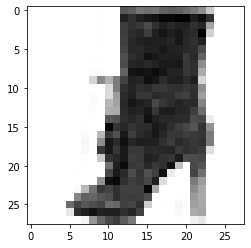

LABEL: 9
INPUT:


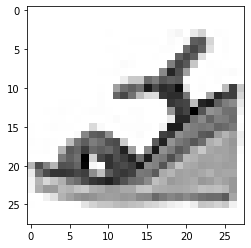

LABEL: 5
INPUT:


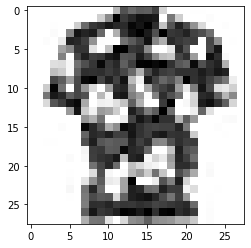

LABEL: 6
INPUT:


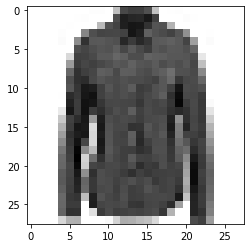

LABEL: 6
INPUT:


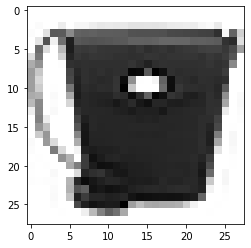

LABEL: 8
INPUT:


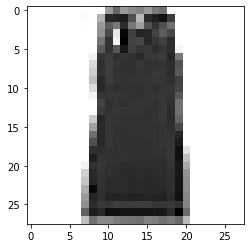

LABEL: 0
INPUT:


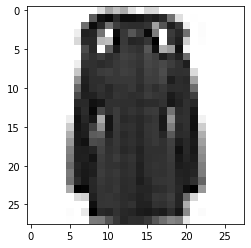

LABEL: 4
INPUT:


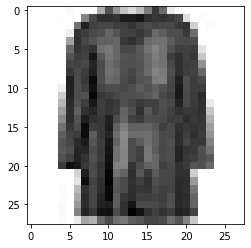

LABEL: 3
INPUT:


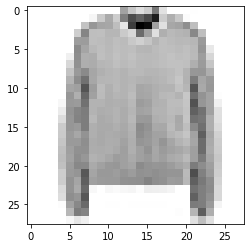

LABEL: 4
INPUT:


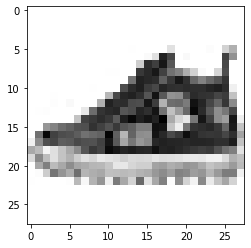

LABEL: 7
INPUT:


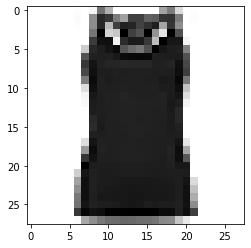

LABEL: 0
INPUT:


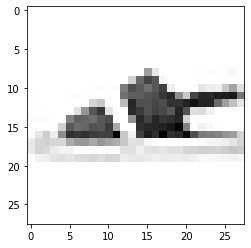

LABEL: 5
INPUT:


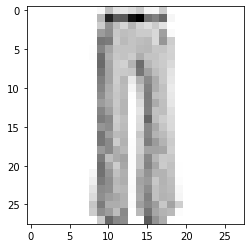

LABEL: 1
INPUT:


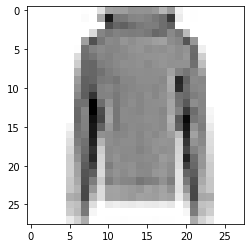

LABEL: 2
INPUT:


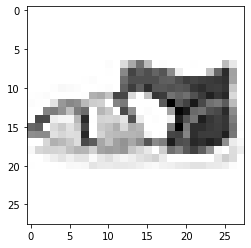

LABEL: 5
INPUT:


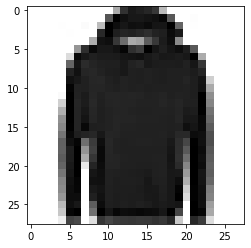

LABEL: 2
INPUT:


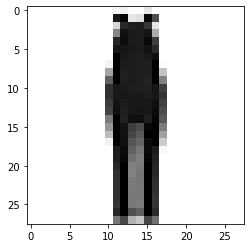

LABEL: 1
INPUT:


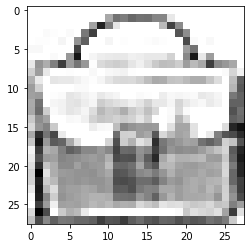

LABEL: 8
INPUT:


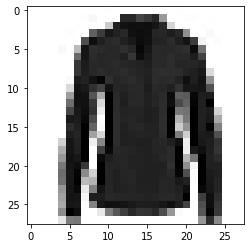

LABEL: 6
INPUT:


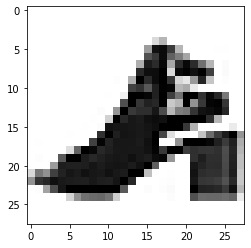

LABEL: 5
INPUT:


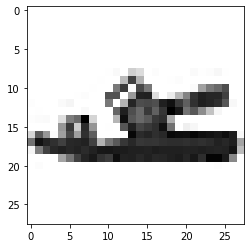

LABEL: 5
INPUT:


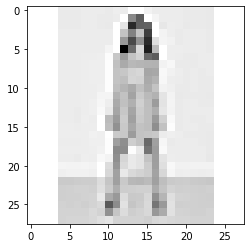

LABEL: 3
INPUT:


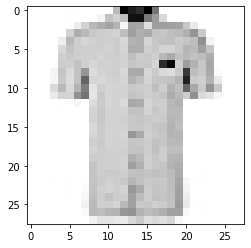

LABEL: 6
INPUT:


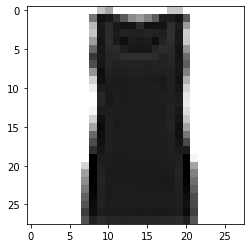

LABEL: 0
INPUT:


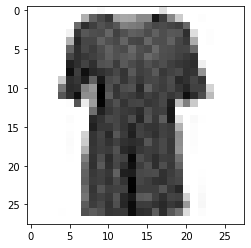

LABEL: 0
INPUT:


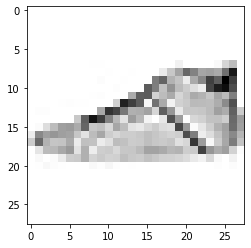

LABEL: 7
INPUT:


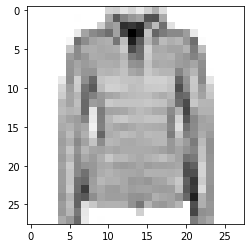

LABEL: 4
INPUT:


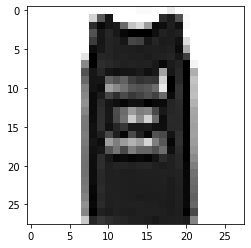

LABEL: 0
INPUT:


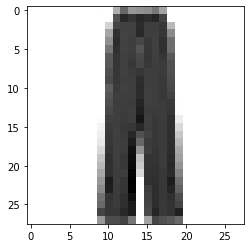

LABEL: 1
INPUT:


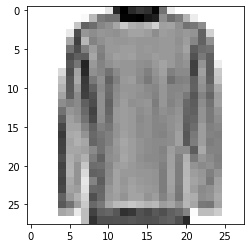

LABEL: 2
INPUT:


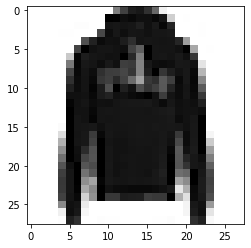

LABEL: 2
INPUT:


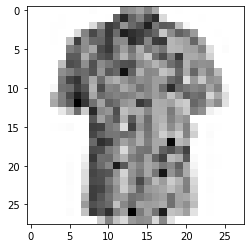

LABEL: 6
INPUT:


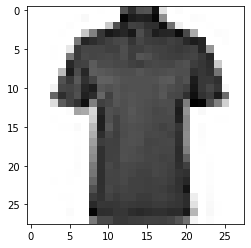

LABEL: 0
INPUT:


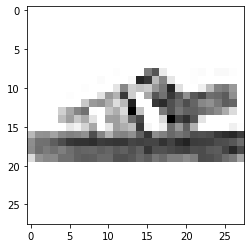

LABEL: 5
INPUT:


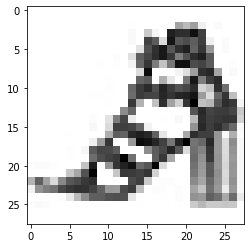

LABEL: 5
INPUT:


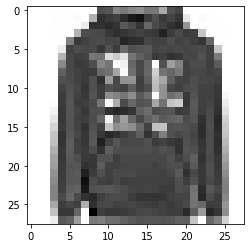

LABEL: 2
INPUT:


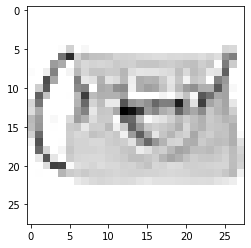

LABEL: 8
INPUT:


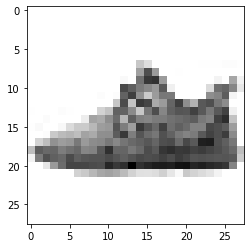

LABEL: 7
INPUT:


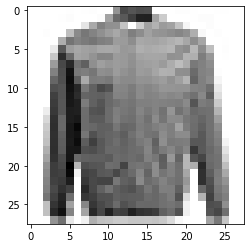

LABEL: 4
INPUT:


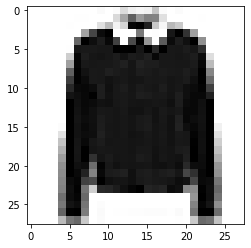

LABEL: 4
INPUT:


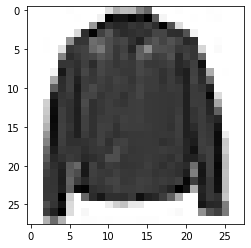

LABEL: 4
INPUT:


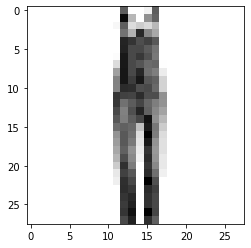

LABEL: 1
INPUT:


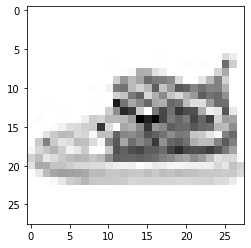

LABEL: 7
INPUT:


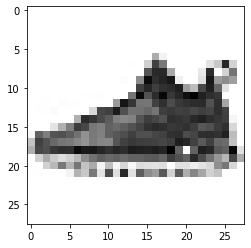

LABEL: 7
INPUT:


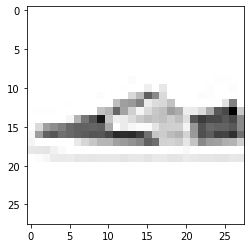

LABEL: 7
INPUT:


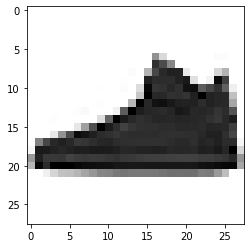

LABEL: 7
INPUT:


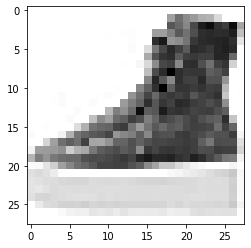

LABEL: 9
INPUT:


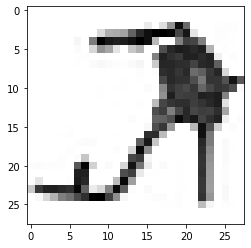

LABEL: 5
INPUT:


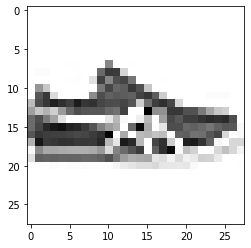

LABEL: 7
INPUT:


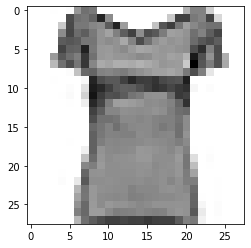

LABEL: 0
INPUT:


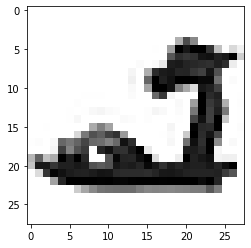

LABEL: 5
INPUT:


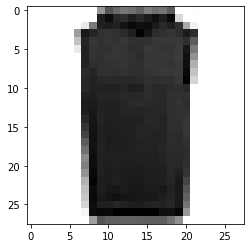

LABEL: 2
INPUT:


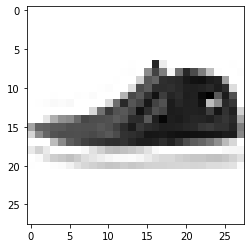

LABEL: 9
INPUT:


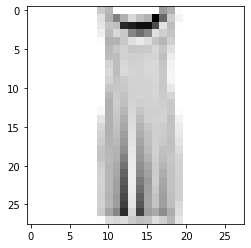

LABEL: 3
INPUT:


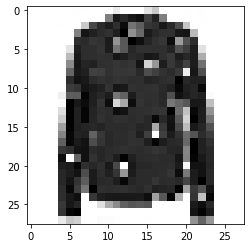

LABEL: 6
INPUT:


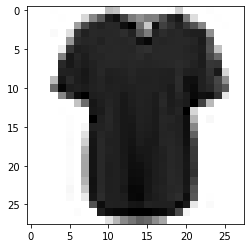

LABEL: 6
INPUT:


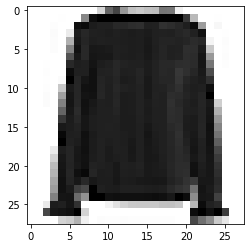

LABEL: 6
INPUT:


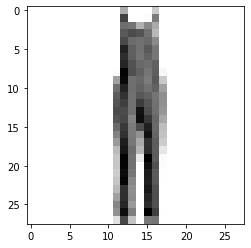

LABEL: 1
INPUT:


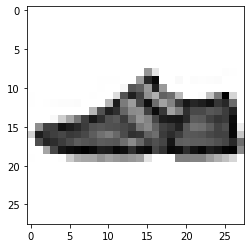

LABEL: 7
INPUT:


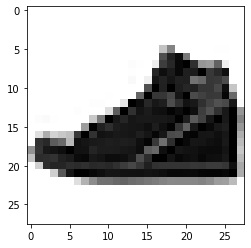

LABEL: 7
INPUT:


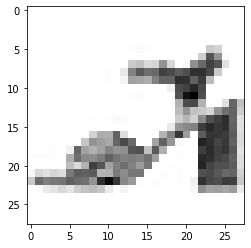

LABEL: 5
INPUT:


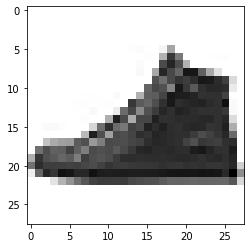

LABEL: 7
INPUT:


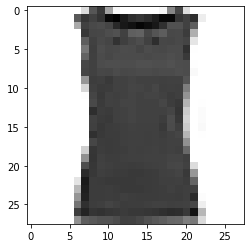

LABEL: 0
INPUT:


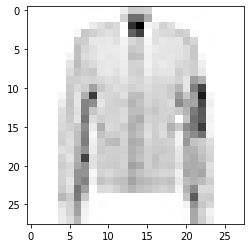

LABEL: 4
INPUT:


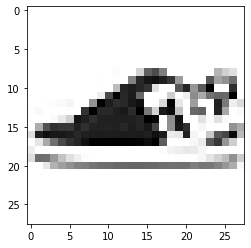

LABEL: 7
INPUT:


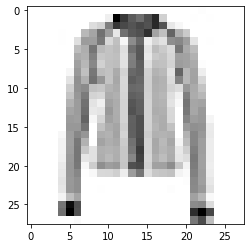

LABEL: 4
INPUT:


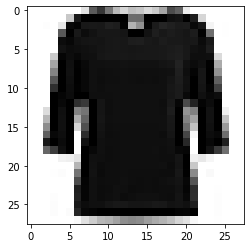

LABEL: 6
INPUT:


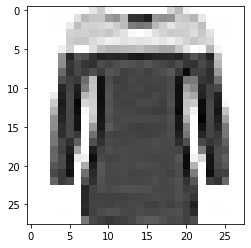

LABEL: 0
INPUT:


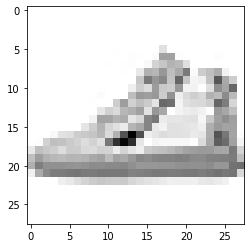

LABEL: 7
INPUT:


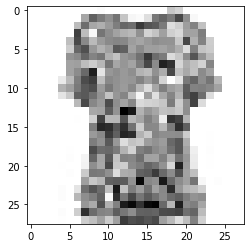

LABEL: 6
INPUT:


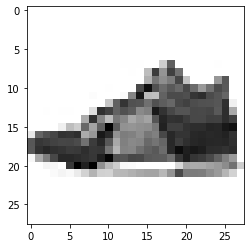

LABEL: 7
INPUT:


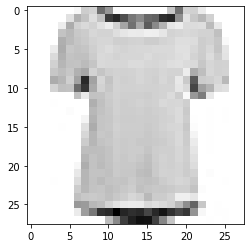

LABEL: 6
INPUT:


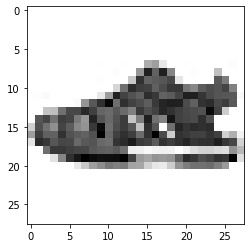

LABEL: 5
INPUT:


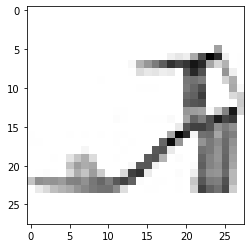

LABEL: 5
INPUT:


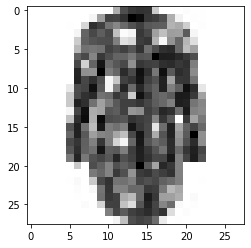

LABEL: 6
INPUT:


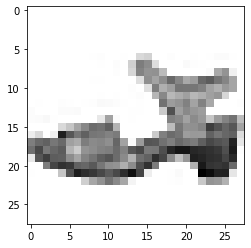

LABEL: 5
INPUT:


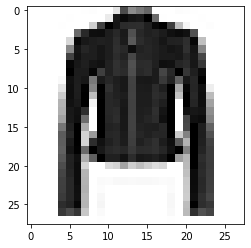

LABEL: 4
INPUT:


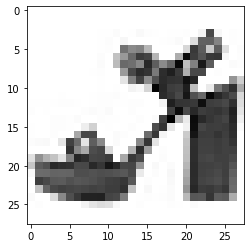

LABEL: 5
INPUT:


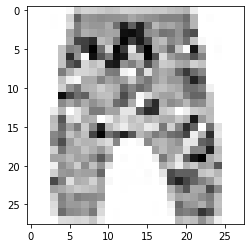

LABEL: 1
INPUT:


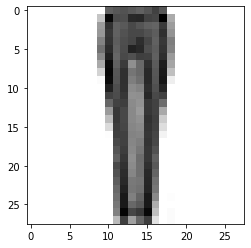

LABEL: 1
INPUT:


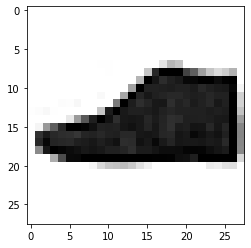

LABEL: 9
INPUT:


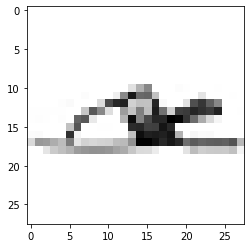

LABEL: 5
INPUT:


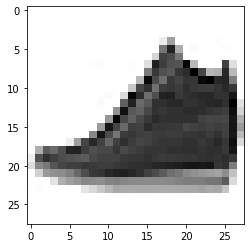

LABEL: 7
INPUT:


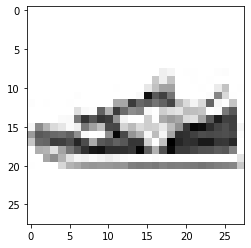

LABEL: 7
INPUT:


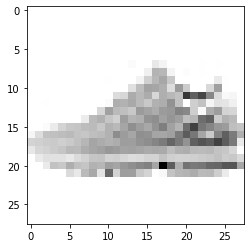

LABEL: 7
INPUT:


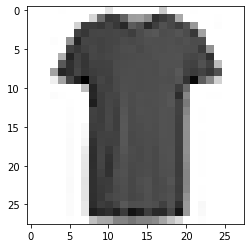

LABEL: 0
INPUT:


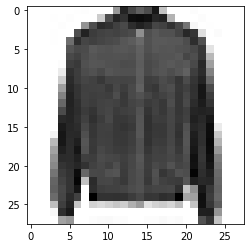

LABEL: 4
INPUT:


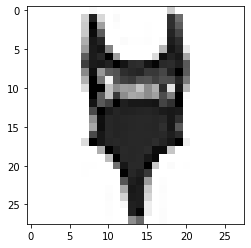

LABEL: 0
INPUT:


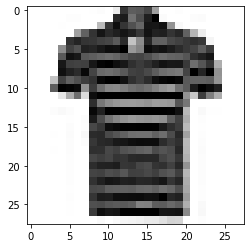

LABEL: 0
INPUT:


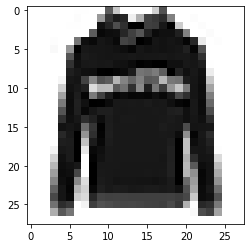

LABEL: 2
INPUT:


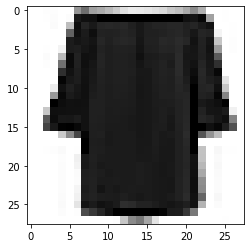

LABEL: 6
INPUT:


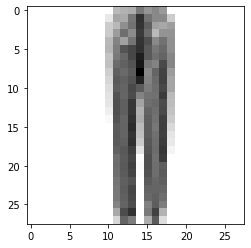

LABEL: 1
INPUT:


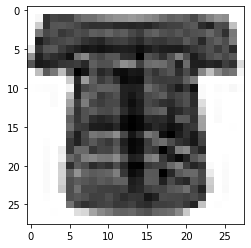

LABEL: 6
INPUT:


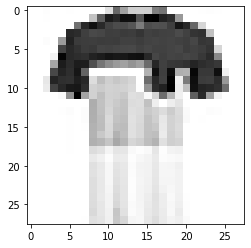

LABEL: 0
INPUT:


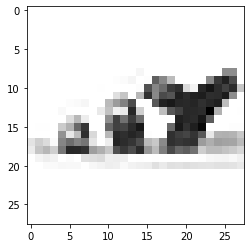

LABEL: 5
INPUT:


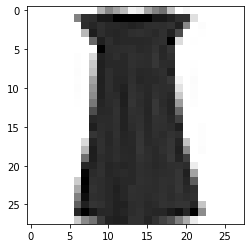

LABEL: 3
INPUT:


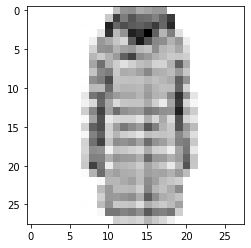

LABEL: 4
INPUT:


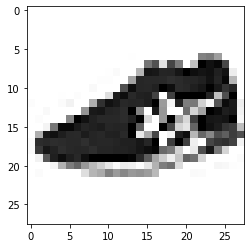

LABEL: 7
INPUT:


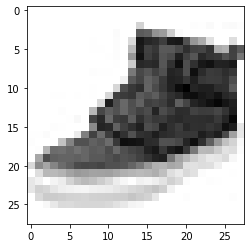

LABEL: 7
INPUT:


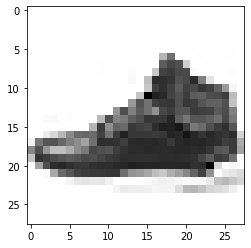

LABEL: 7
INPUT:


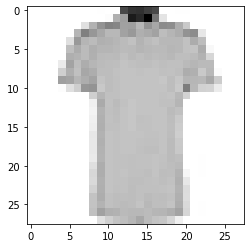

LABEL: 6
INPUT:


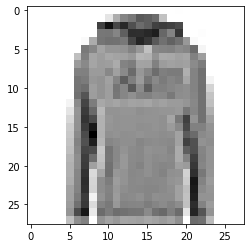

LABEL: 2
INPUT:


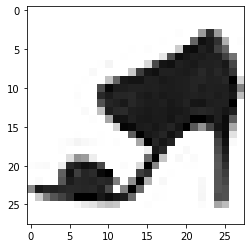

LABEL: 5
INPUT:


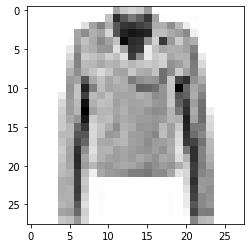

LABEL: 4
INPUT:


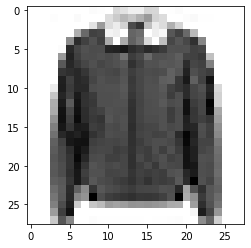

LABEL: 4
INPUT:


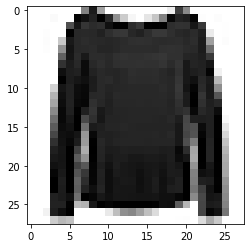

LABEL: 6
INPUT:


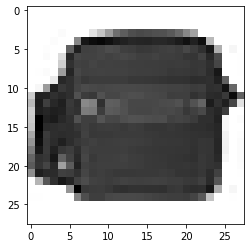

LABEL: 8
INPUT:


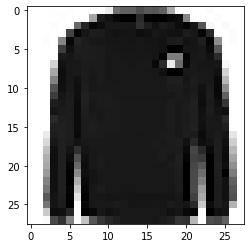

LABEL: 2
INPUT:


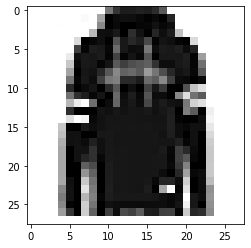

LABEL: 2
INPUT:


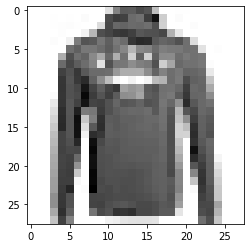

LABEL: 2
INPUT:


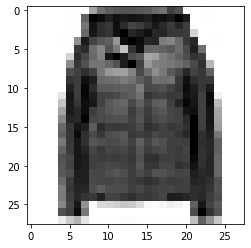

LABEL: 4
INPUT:


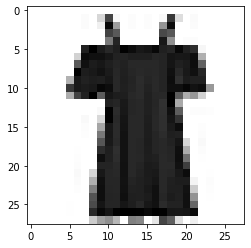

LABEL: 3
INPUT:


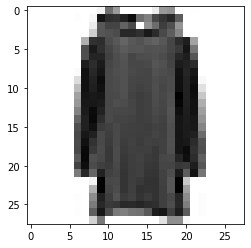

LABEL: 3
INPUT:


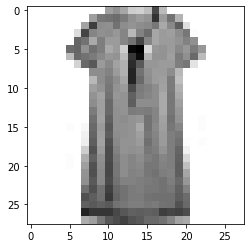

LABEL: 3
INPUT:


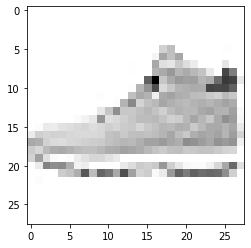

LABEL: 7
INPUT:


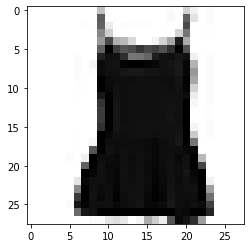

LABEL: 0
INPUT:


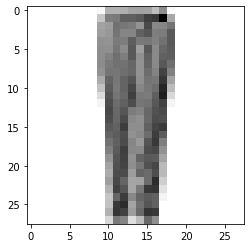

LABEL: 1
INPUT:


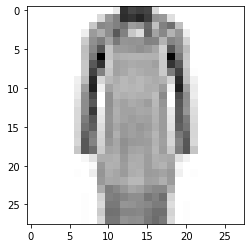

LABEL: 3
INPUT:


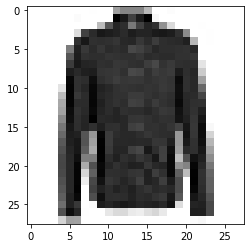

LABEL: 6
INPUT:


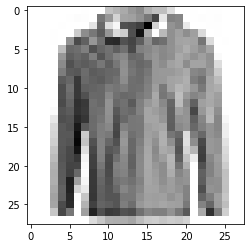

LABEL: 4
INPUT:


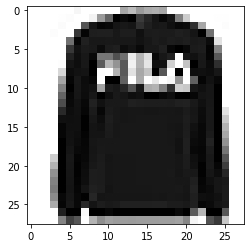

LABEL: 2
INPUT:


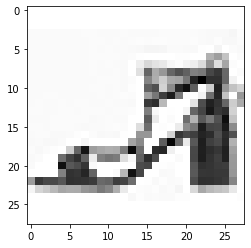

LABEL: 5
INPUT:


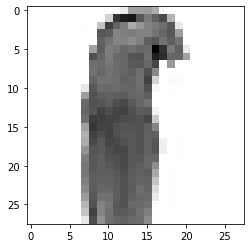

LABEL: 3
INPUT:


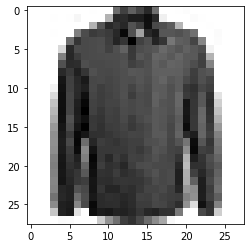

LABEL: 4
INPUT:


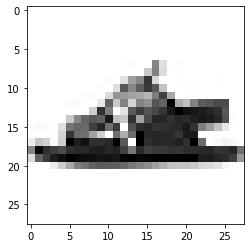

LABEL: 5
INPUT:


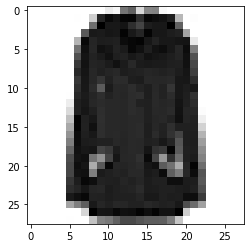

LABEL: 4
INPUT:


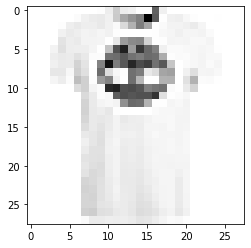

LABEL: 0
INPUT:


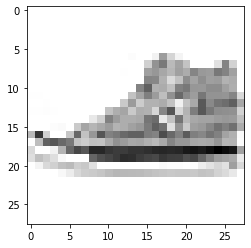

LABEL: 7
INPUT:


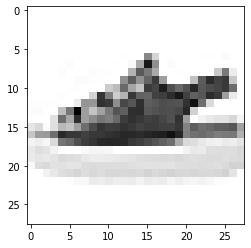

LABEL: 5
INPUT:


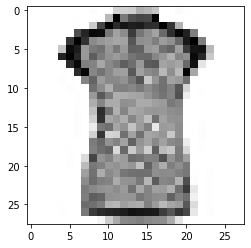

LABEL: 0
INPUT:


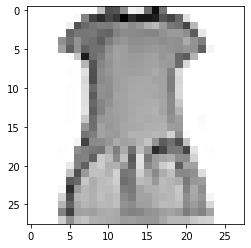

LABEL: 3
INPUT:


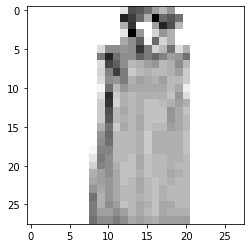

LABEL: 3
INPUT:


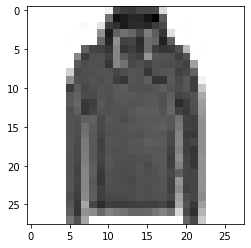

LABEL: 2
INPUT:


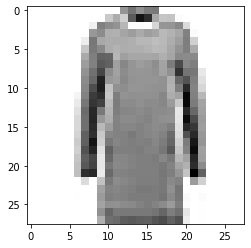

LABEL: 3
INPUT:


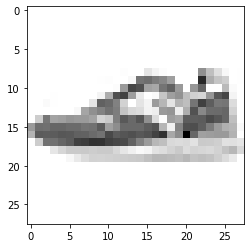

LABEL: 7
INPUT:


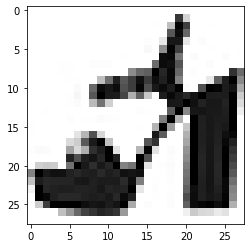

LABEL: 5
INPUT:


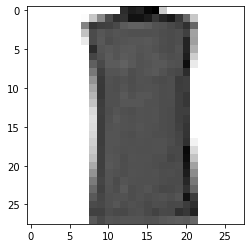

LABEL: 0
INPUT:


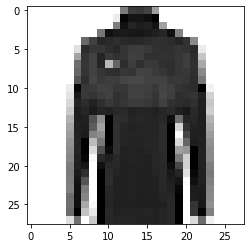

LABEL: 2
INPUT:


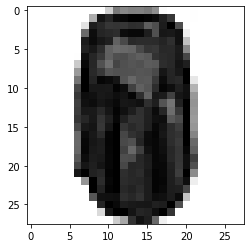

LABEL: 4
INPUT:


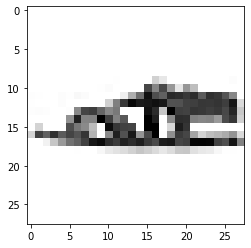

LABEL: 5
INPUT:


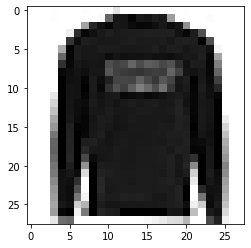

LABEL: 2
INPUT:


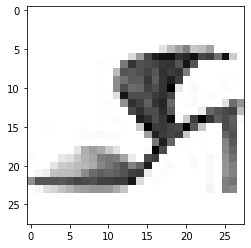

LABEL: 5
INPUT:


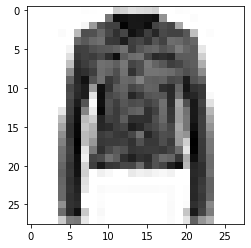

LABEL: 4
INPUT:


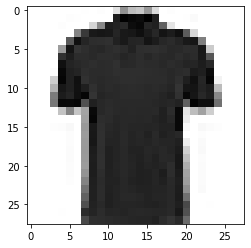

LABEL: 0
INPUT:


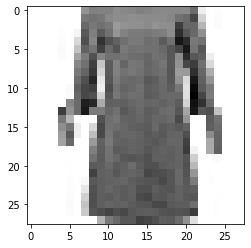

LABEL: 3
INPUT:


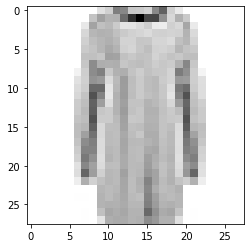

LABEL: 3
INPUT:


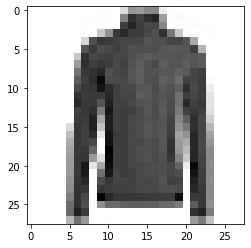

LABEL: 2
INPUT:


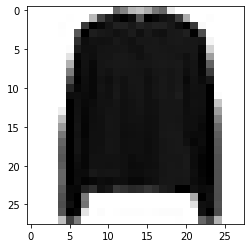

LABEL: 6
INPUT:


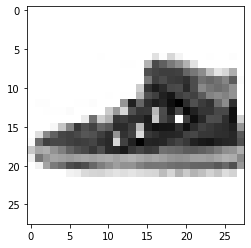

LABEL: 7
INPUT:


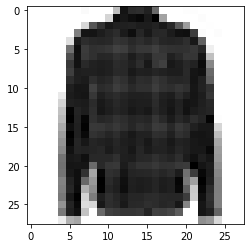

LABEL: 6
INPUT:


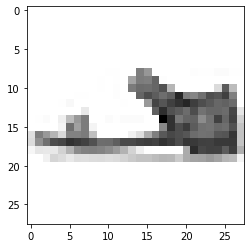

LABEL: 5
INPUT:


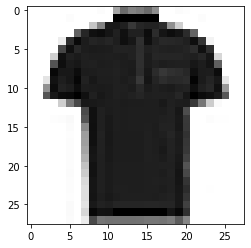

LABEL: 0
INPUT:


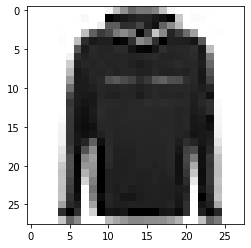

LABEL: 2
INPUT:


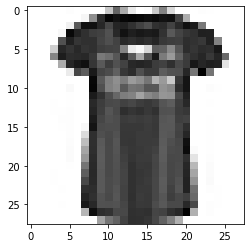

LABEL: 0
INPUT:


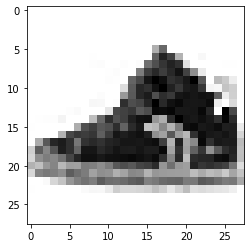

LABEL: 7
INPUT:


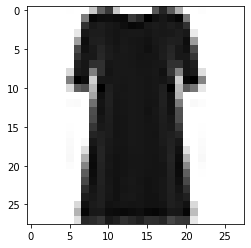

LABEL: 3
INPUT:


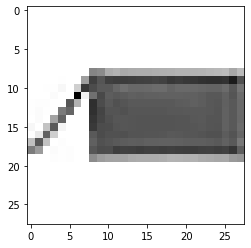

LABEL: 8
INPUT:


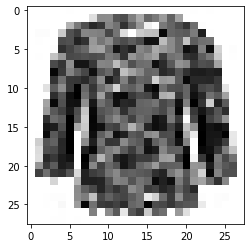

LABEL: 6
INPUT:


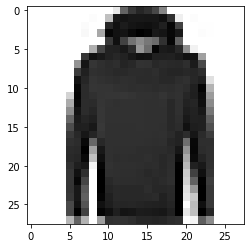

LABEL: 2
INPUT:


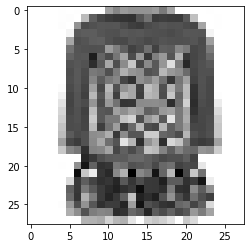

LABEL: 3
INPUT:


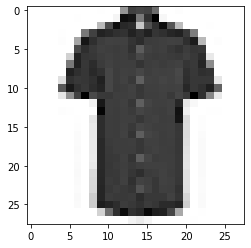

LABEL: 6
INPUT:


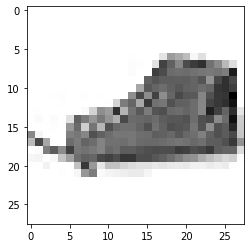

LABEL: 7
INPUT:


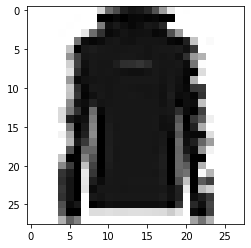

LABEL: 2
INPUT:


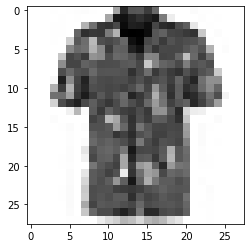

LABEL: 6
INPUT:


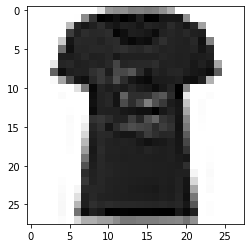

LABEL: 0
INPUT:


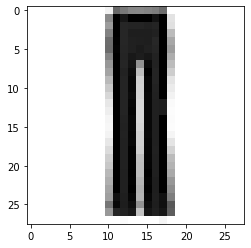

LABEL: 1
INPUT:


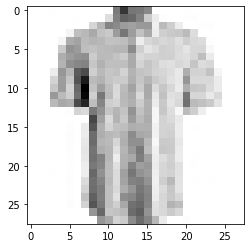

LABEL: 6
INPUT:


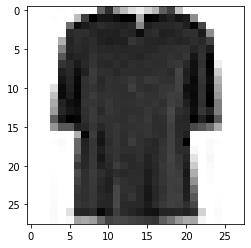

LABEL: 6
INPUT:


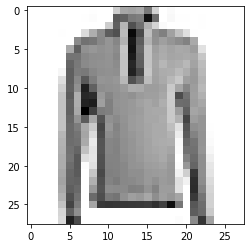

LABEL: 2
INPUT:


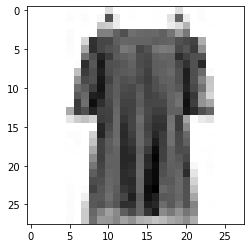

LABEL: 3
INPUT:


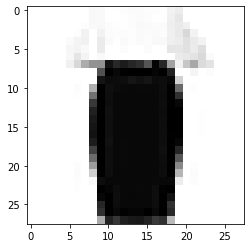

LABEL: 3
INPUT:


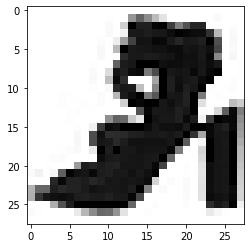

LABEL: 5
INPUT:


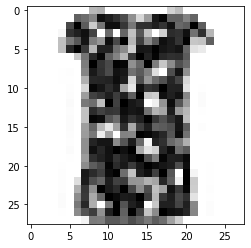

LABEL: 6
INPUT:


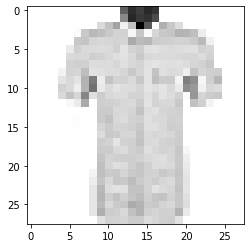

LABEL: 6
INPUT:


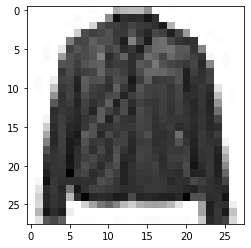

LABEL: 4
INPUT:


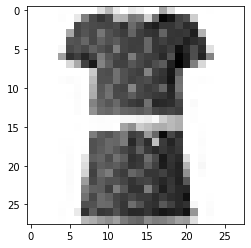

LABEL: 3
INPUT:


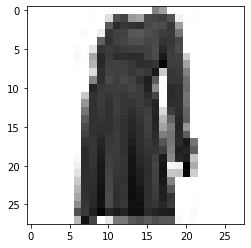

LABEL: 3
INPUT:


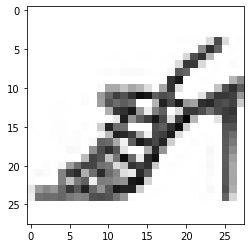

LABEL: 5
INPUT:


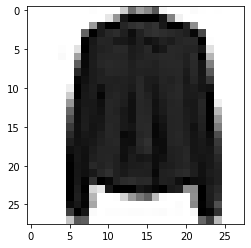

LABEL: 6
INPUT:


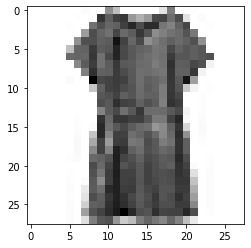

LABEL: 3
INPUT:


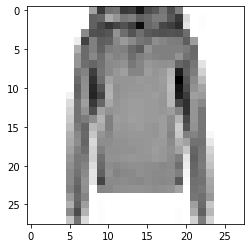

LABEL: 2
INPUT:


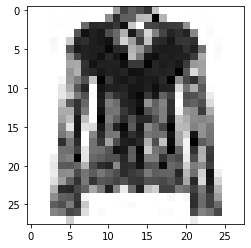

LABEL: 6
INPUT:


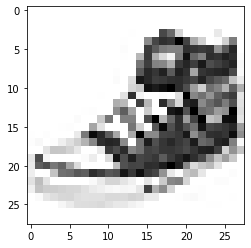

LABEL: 7
INPUT:


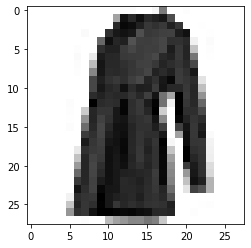

LABEL: 4
INPUT:


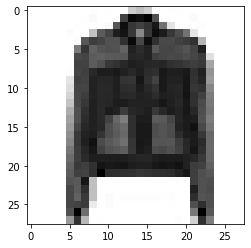

LABEL: 4
INPUT:


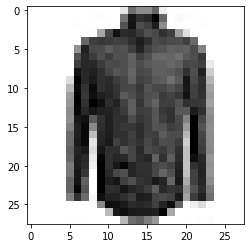

LABEL: 4
INPUT:


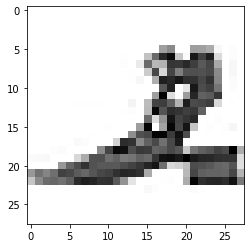

LABEL: 5
INPUT:


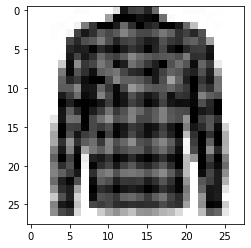

LABEL: 6
INPUT:


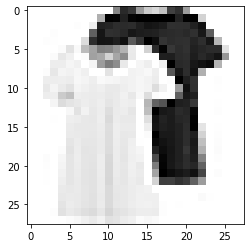

LABEL: 0
INPUT:


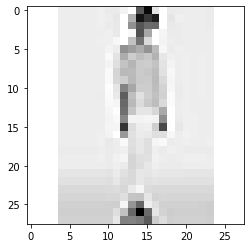

LABEL: 6
INPUT:


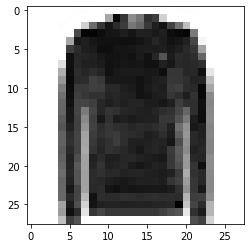

LABEL: 2
INPUT:


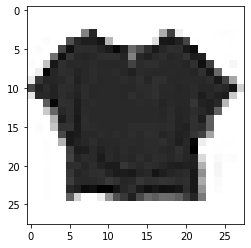

LABEL: 6
INPUT:


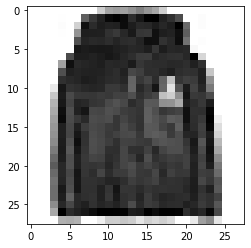

LABEL: 4
INPUT:


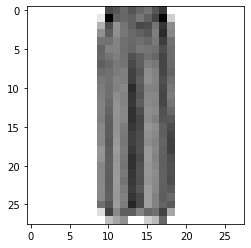

LABEL: 1
INPUT:


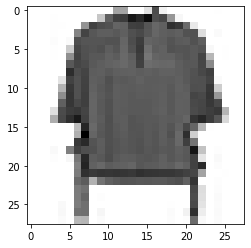

LABEL: 6
INPUT:


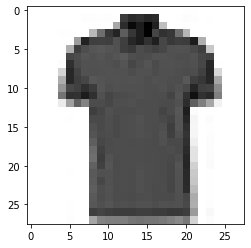

LABEL: 0
INPUT:


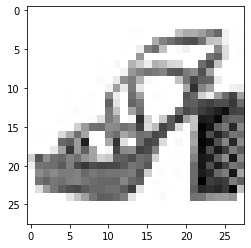

LABEL: 5
INPUT:


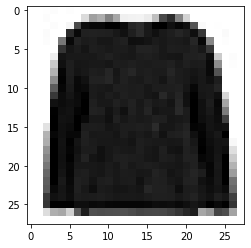

LABEL: 2
INPUT:


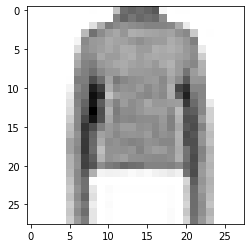

LABEL: 2
INPUT:


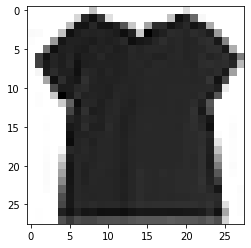

LABEL: 0
INPUT:


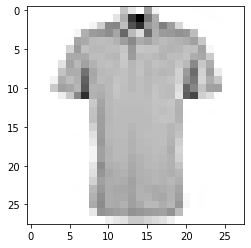

LABEL: 6
INPUT:


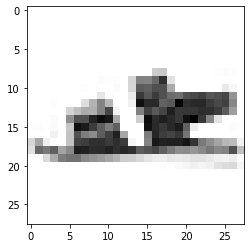

LABEL: 5
INPUT:


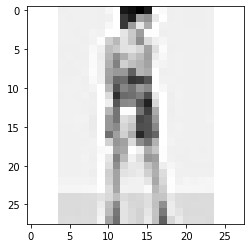

LABEL: 3
INPUT:


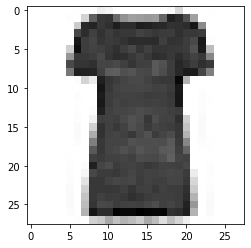

LABEL: 0
INPUT:


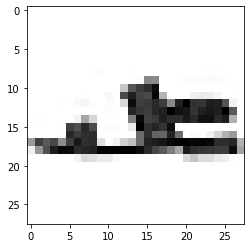

LABEL: 5
INPUT:


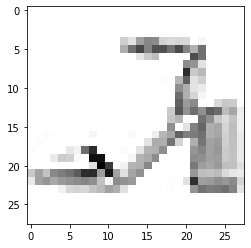

LABEL: 5
INPUT:


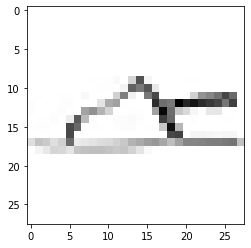

LABEL: 5
INPUT:


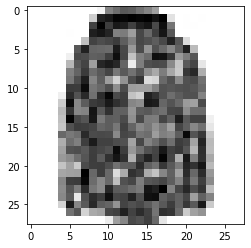

LABEL: 4
INPUT:


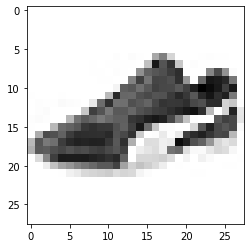

LABEL: 7
INPUT:


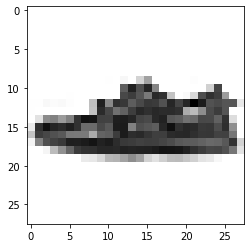

LABEL: 5
INPUT:


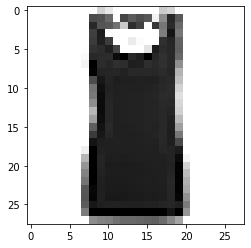

LABEL: 0
INPUT:


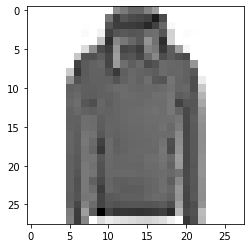

LABEL: 2
INPUT:


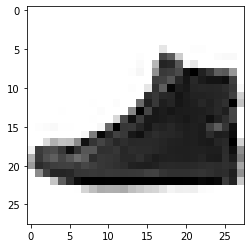

LABEL: 7
INPUT:


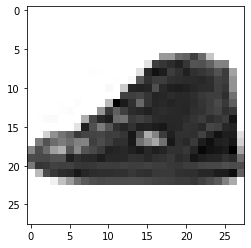

LABEL: 7
INPUT:


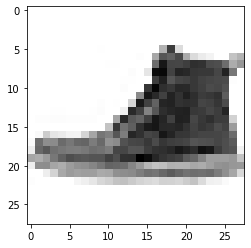

LABEL: 9
INPUT:


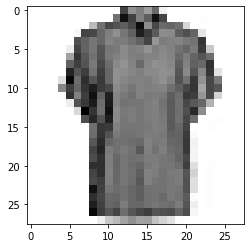

LABEL: 6
INPUT:


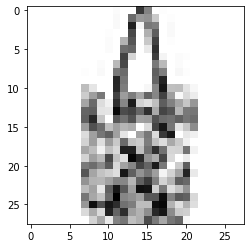

LABEL: 8
INPUT:


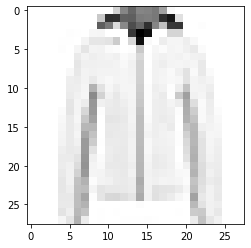

LABEL: 4
INPUT:


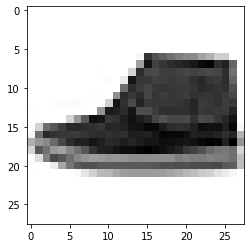

LABEL: 9
INPUT:


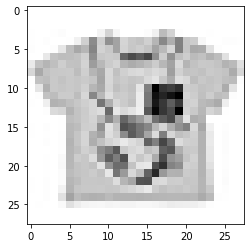

LABEL: 0
INPUT:


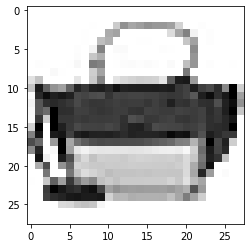

LABEL: 8
INPUT:


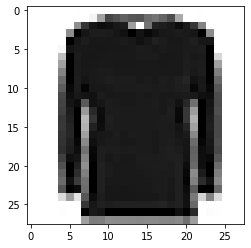

LABEL: 2
INPUT:


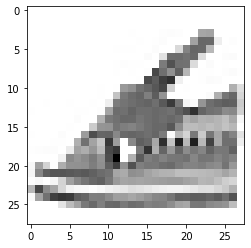

LABEL: 5
INPUT:


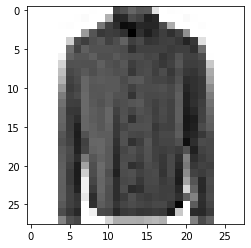

LABEL: 6
INPUT:


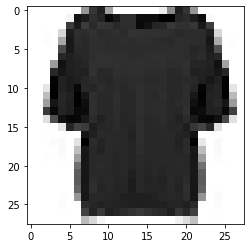

LABEL: 6
INPUT:


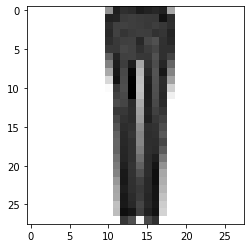

LABEL: 1
INPUT:


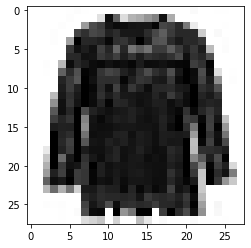

LABEL: 6
INPUT:


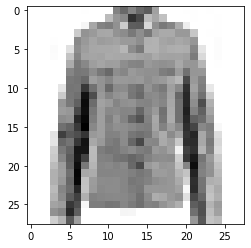

LABEL: 6
INPUT:


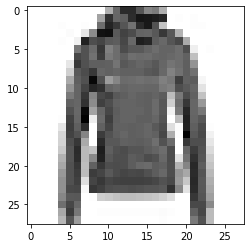

LABEL: 2
INPUT:


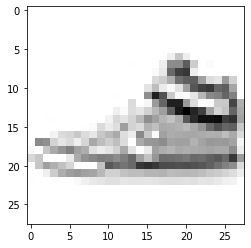

LABEL: 7
INPUT:


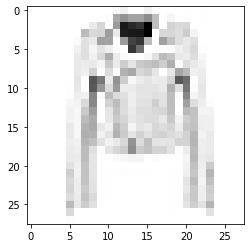

LABEL: 4
INPUT:


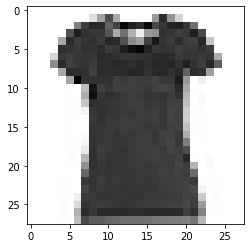

LABEL: 0
INPUT:


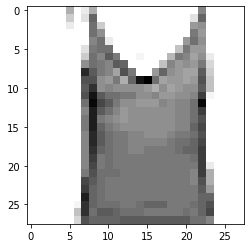

LABEL: 0
INPUT:


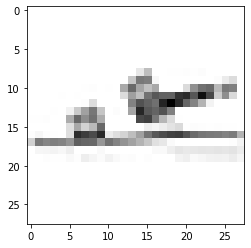

LABEL: 5
INPUT:


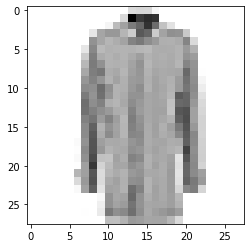

LABEL: 4
INPUT:


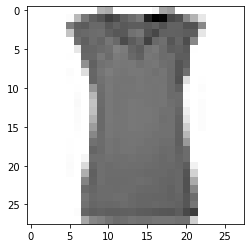

LABEL: 6
INPUT:


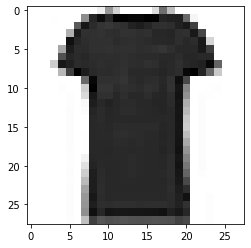

LABEL: 0
INPUT:


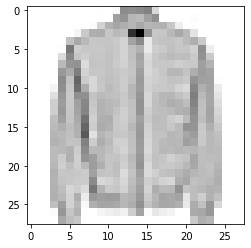

LABEL: 4
INPUT:


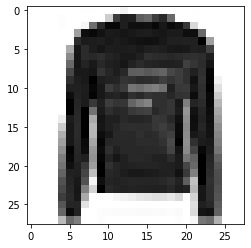

LABEL: 2
INPUT:


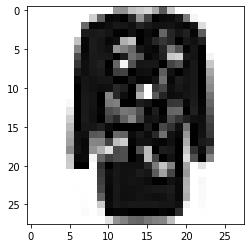

LABEL: 3
INPUT:


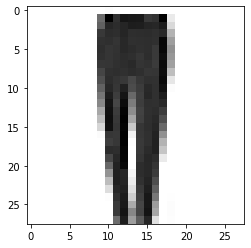

LABEL: 1
INPUT:


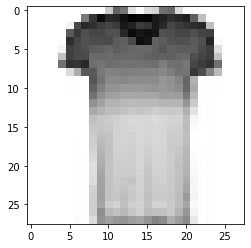

LABEL: 0
INPUT:


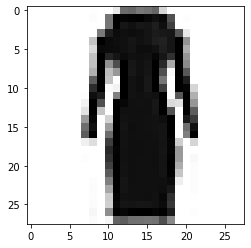

LABEL: 3
INPUT:


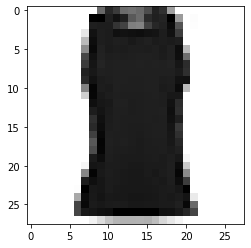

LABEL: 0
INPUT:


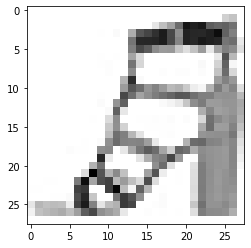

LABEL: 5
INPUT:


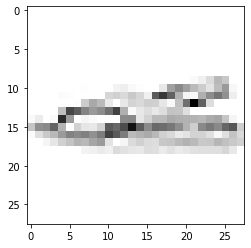

LABEL: 5
INPUT:


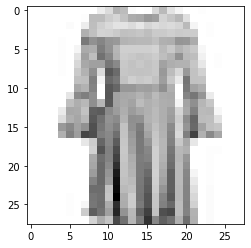

LABEL: 3
INPUT:


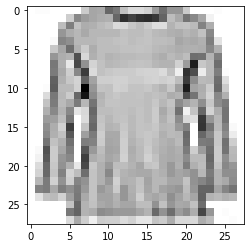

LABEL: 2
INPUT:


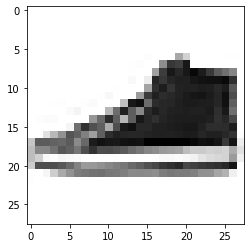

LABEL: 7
INPUT:


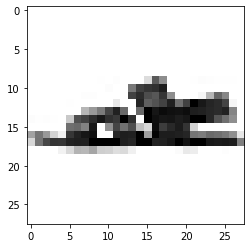

LABEL: 5
INPUT:


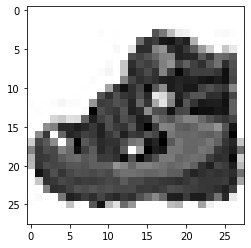

LABEL: 9
INPUT:


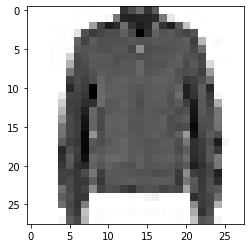

LABEL: 4
INPUT:


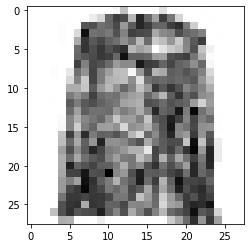

LABEL: 6
INPUT:


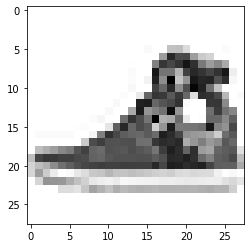

LABEL: 7
INPUT:


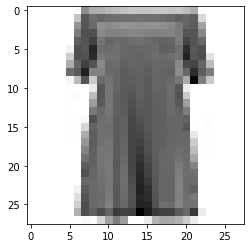

LABEL: 3
INPUT:


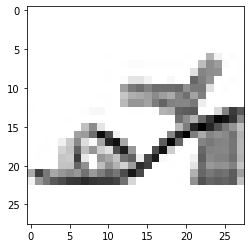

LABEL: 5
INPUT:


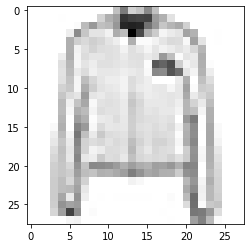

LABEL: 4
INPUT:


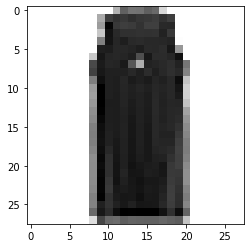

LABEL: 0
INPUT:


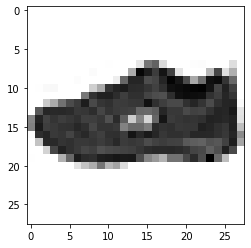

LABEL: 7
INPUT:


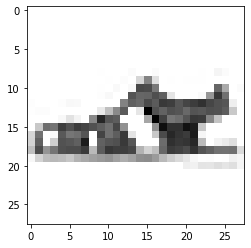

LABEL: 5
INPUT:


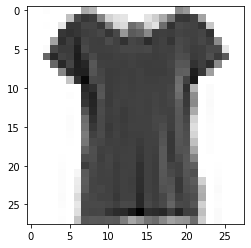

LABEL: 0
INPUT:


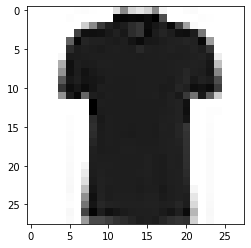

LABEL: 0
INPUT:


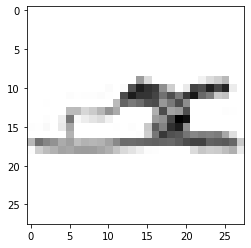

LABEL: 5
INPUT:


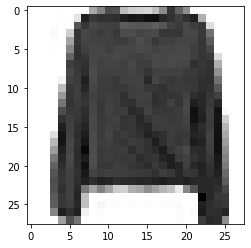

LABEL: 6
INPUT:


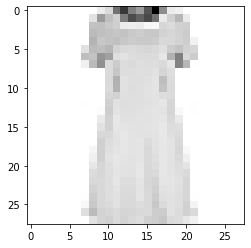

LABEL: 3
INPUT:


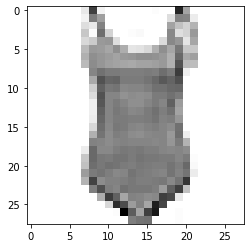

LABEL: 0
INPUT:


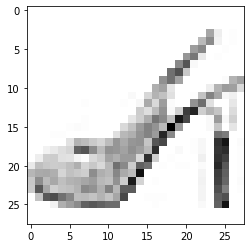

LABEL: 5
INPUT:


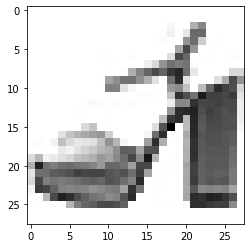

LABEL: 5
INPUT:


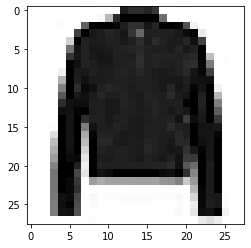

LABEL: 4
INPUT:


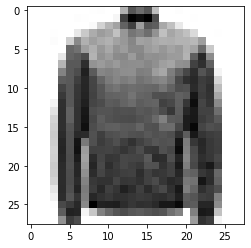

LABEL: 4
INPUT:


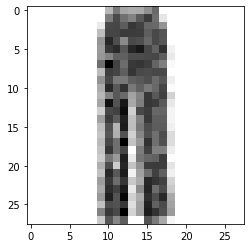

LABEL: 1
INPUT:


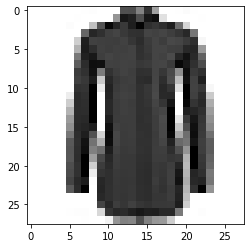

LABEL: 6
INPUT:


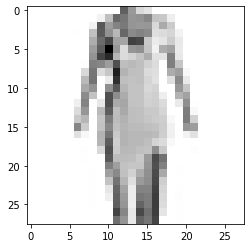

LABEL: 3
INPUT:


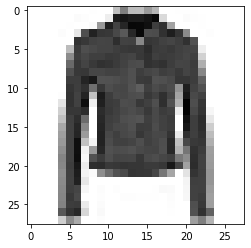

LABEL: 4
INPUT:


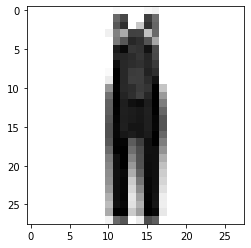

LABEL: 1
INPUT:


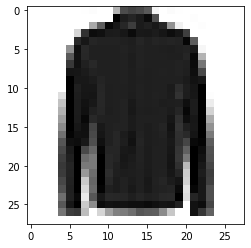

LABEL: 6
INPUT:


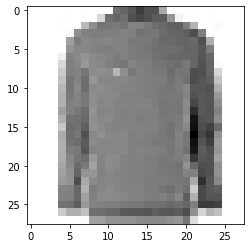

LABEL: 2
INPUT:


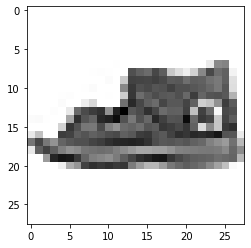

LABEL: 5
INPUT:


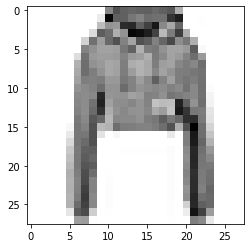

LABEL: 2
INPUT:


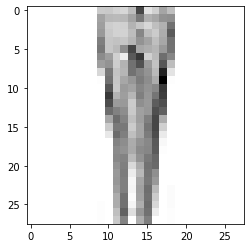

LABEL: 1
INPUT:


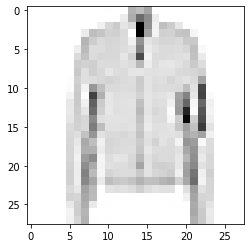

LABEL: 4
INPUT:


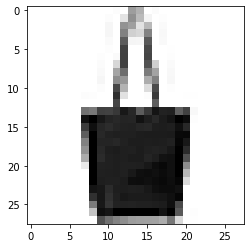

LABEL: 8
INPUT:


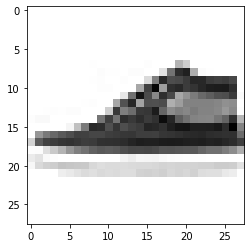

LABEL: 7
INPUT:


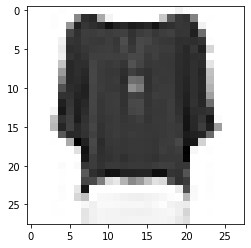

LABEL: 6
INPUT:


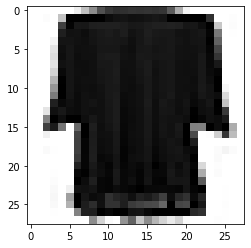

LABEL: 6
INPUT:


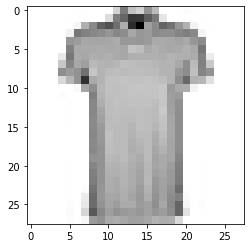

LABEL: 0
INPUT:


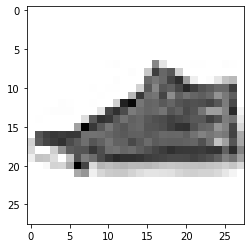

LABEL: 7
INPUT:


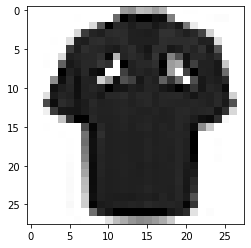

LABEL: 6
INPUT:


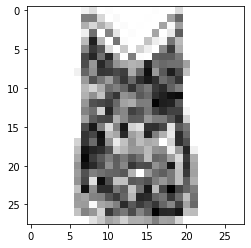

LABEL: 0
INPUT:


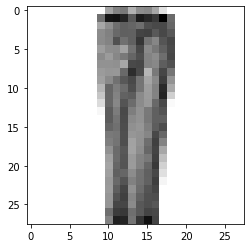

LABEL: 1
INPUT:


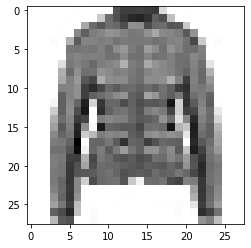

LABEL: 4
INPUT:


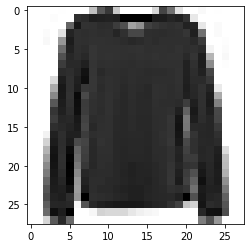

LABEL: 6
INPUT:


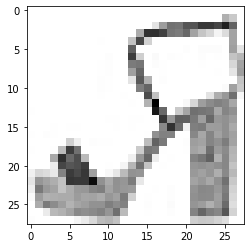

LABEL: 5
INPUT:


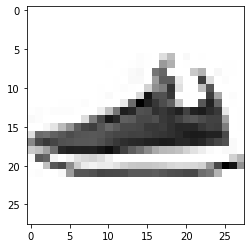

LABEL: 7
INPUT:


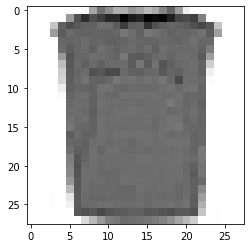

LABEL: 0
INPUT:


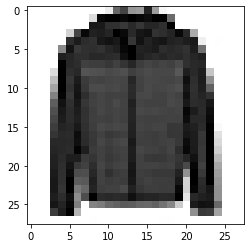

LABEL: 4
INPUT:


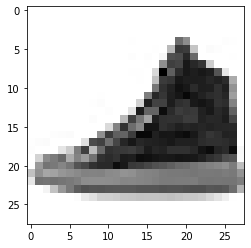

LABEL: 7
INPUT:


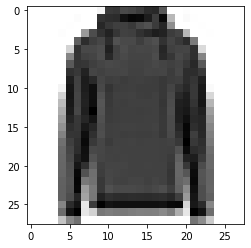

LABEL: 2
INPUT:


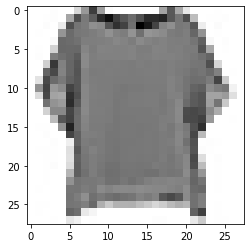

LABEL: 6
INPUT:


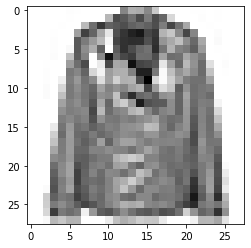

LABEL: 4
INPUT:


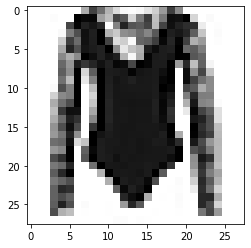

LABEL: 6
INPUT:


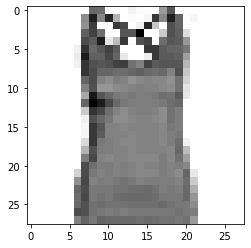

LABEL: 0
INPUT:


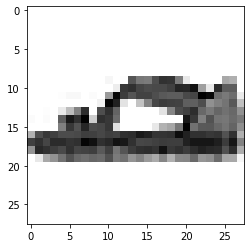

LABEL: 5
INPUT:


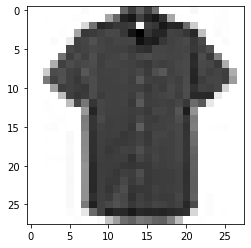

LABEL: 6
INPUT:


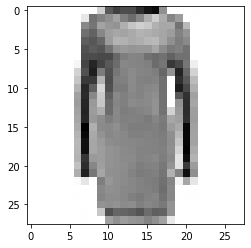

LABEL: 3
INPUT:


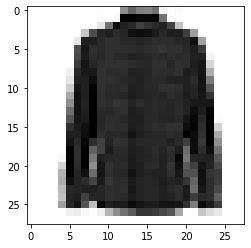

LABEL: 6
INPUT:


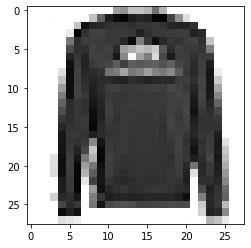

LABEL: 2
INPUT:


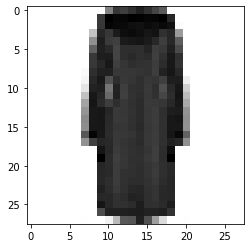

LABEL: 4
INPUT:


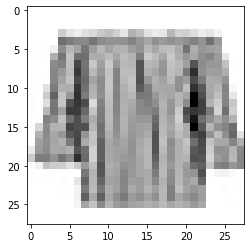

LABEL: 6
INPUT:


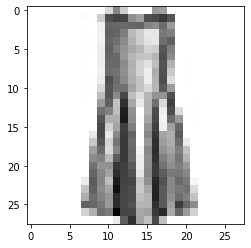

LABEL: 3
INPUT:


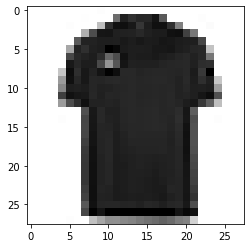

LABEL: 0
INPUT:


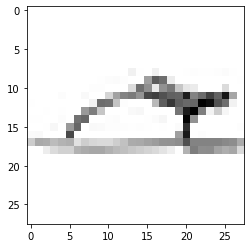

LABEL: 5
INPUT:


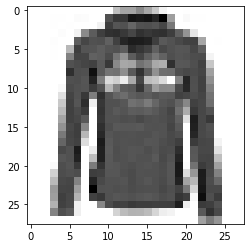

LABEL: 2
INPUT:


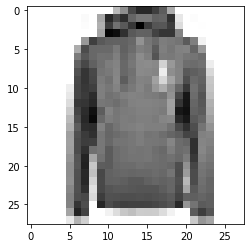

LABEL: 2
INPUT:


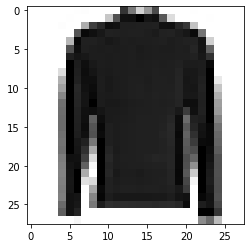

LABEL: 2
INPUT:


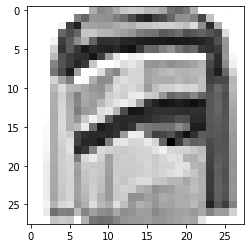

LABEL: 2
INPUT:


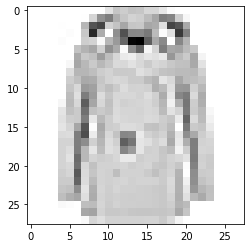

LABEL: 4
INPUT:


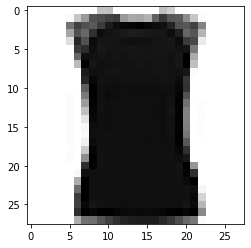

LABEL: 0
INPUT:


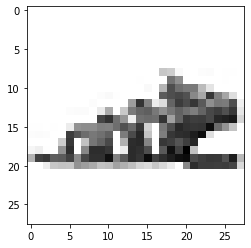

LABEL: 5
INPUT:


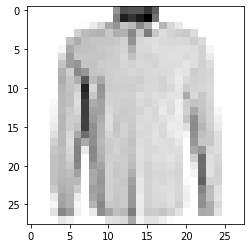

LABEL: 6
INPUT:


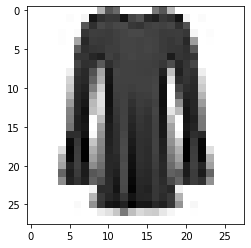

LABEL: 3
INPUT:


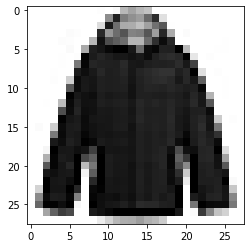

LABEL: 4
INPUT:


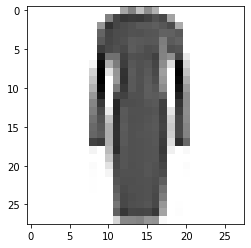

LABEL: 3
INPUT:


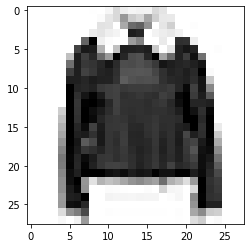

LABEL: 4
INPUT:


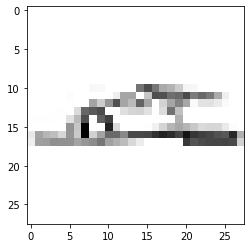

LABEL: 5
INPUT:


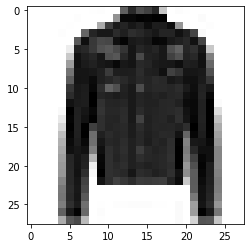

LABEL: 4
INPUT:


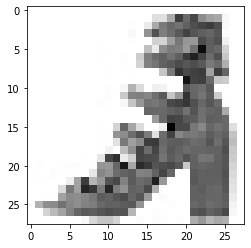

LABEL: 5
INPUT:


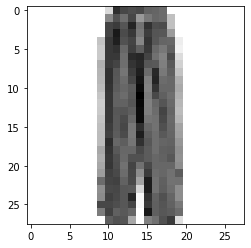

LABEL: 1
INPUT:


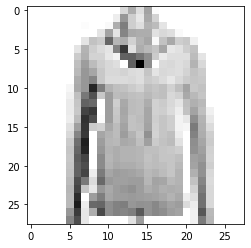

LABEL: 2
INPUT:


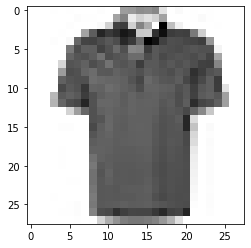

LABEL: 0
INPUT:


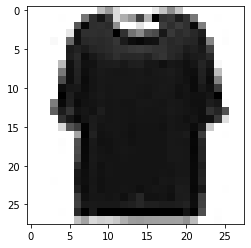

LABEL: 6
INPUT:


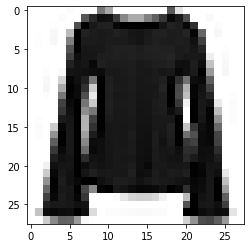

LABEL: 6
INPUT:


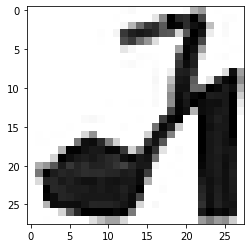

LABEL: 5
INPUT:


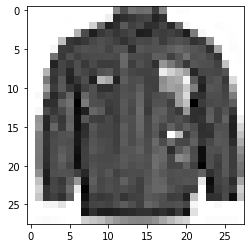

LABEL: 4
INPUT:


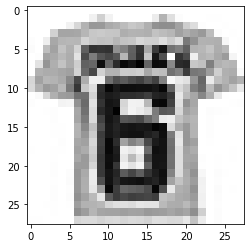

LABEL: 0
INPUT:


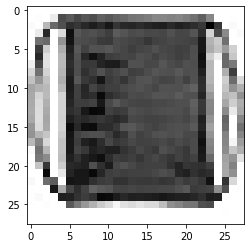

LABEL: 8
INPUT:


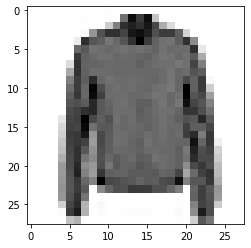

LABEL: 4
INPUT:


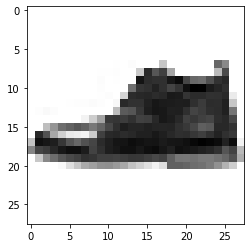

LABEL: 9
INPUT:


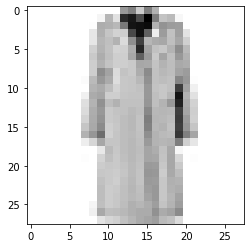

LABEL: 4
INPUT:


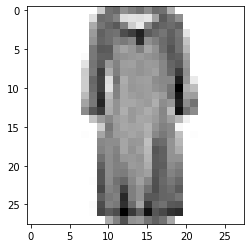

LABEL: 3
INPUT:


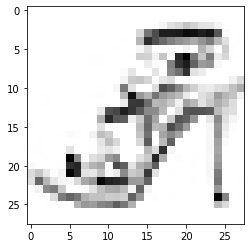

LABEL: 5
INPUT:


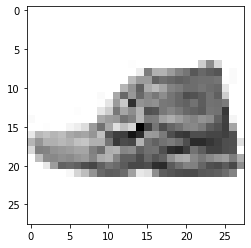

LABEL: 7
INPUT:


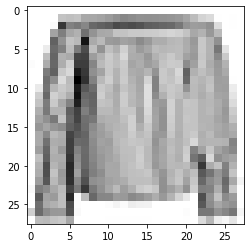

LABEL: 6
INPUT:


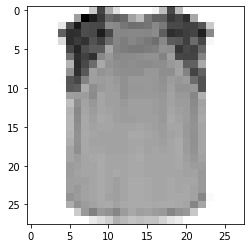

LABEL: 0
INPUT:


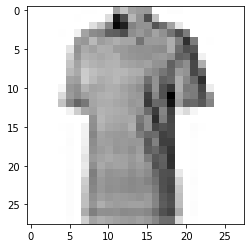

LABEL: 0
INPUT:


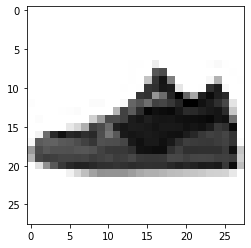

LABEL: 7
INPUT:


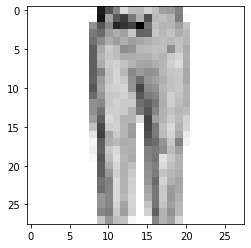

LABEL: 1
INPUT:


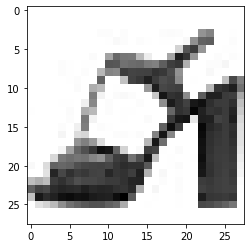

LABEL: 5
INPUT:


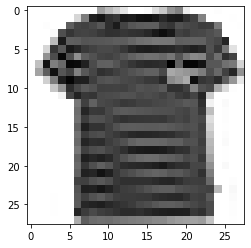

LABEL: 0
INPUT:


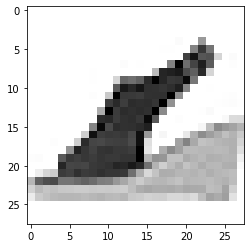

LABEL: 5
INPUT:


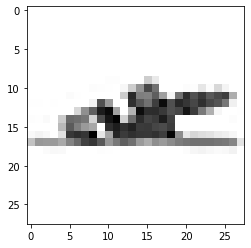

LABEL: 5
INPUT:


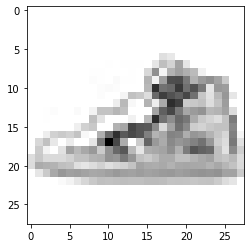

LABEL: 7
INPUT:


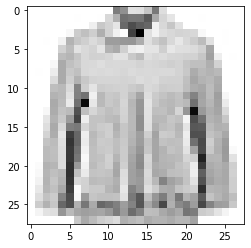

LABEL: 4
INPUT:


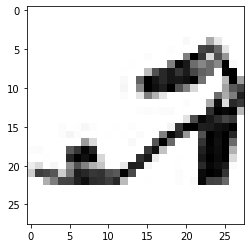

LABEL: 5
INPUT:


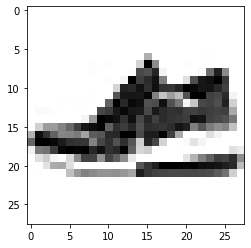

LABEL: 7
INPUT:


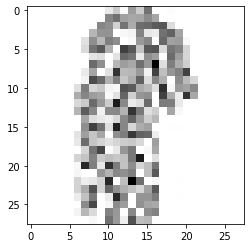

LABEL: 3
INPUT:


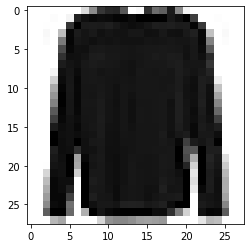

LABEL: 6
INPUT:


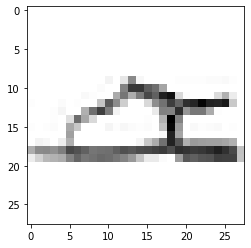

LABEL: 5
INPUT:


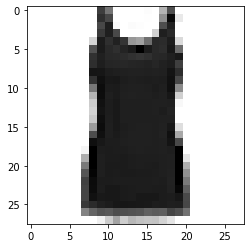

LABEL: 0
INPUT:


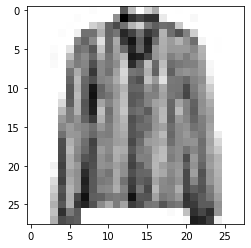

LABEL: 6
INPUT:


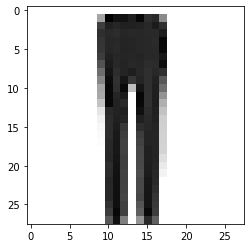

LABEL: 1
INPUT:


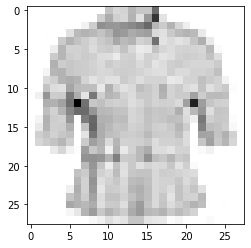

LABEL: 6
INPUT:


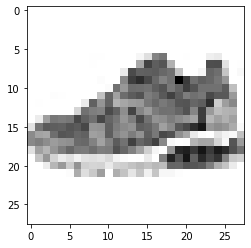

LABEL: 7
INPUT:


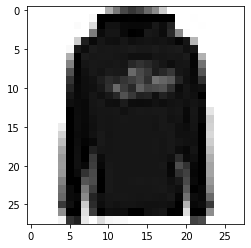

LABEL: 2
INPUT:


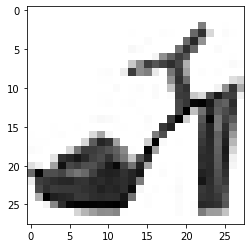

LABEL: 5
INPUT:


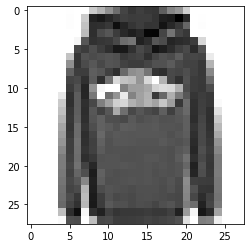

LABEL: 2
INPUT:


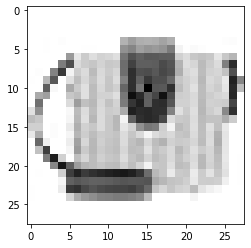

LABEL: 8
INPUT:


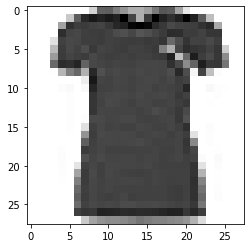

LABEL: 0
INPUT:


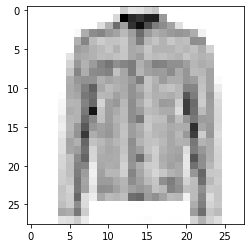

LABEL: 4
INPUT:


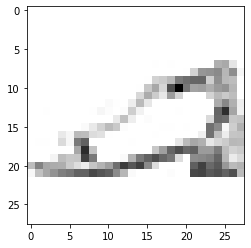

LABEL: 5
INPUT:


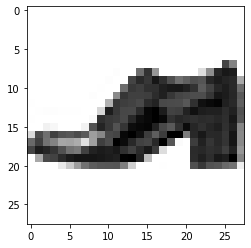

LABEL: 9
INPUT:


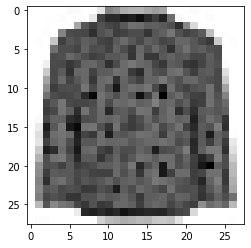

LABEL: 2
INPUT:


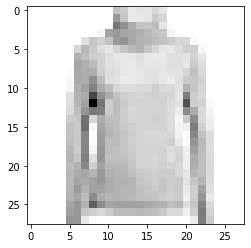

LABEL: 2
INPUT:


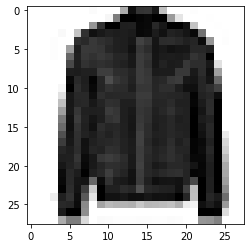

LABEL: 4
INPUT:


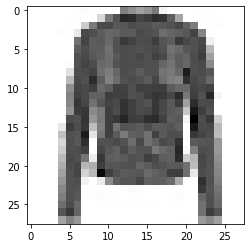

LABEL: 4
INPUT:


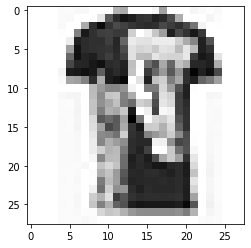

LABEL: 0
INPUT:


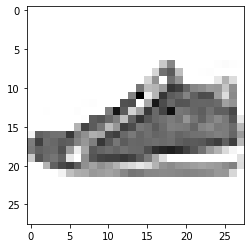

LABEL: 7
INPUT:


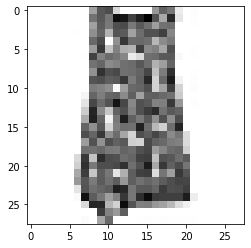

LABEL: 6
INPUT:


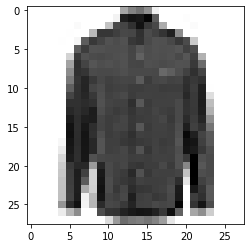

LABEL: 6
INPUT:


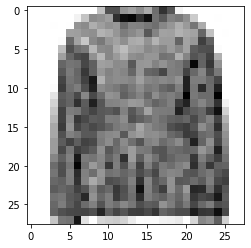

LABEL: 2
INPUT:


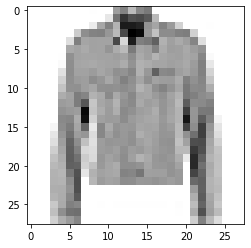

LABEL: 4
INPUT:


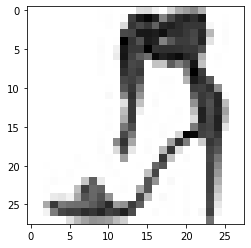

LABEL: 5
INPUT:


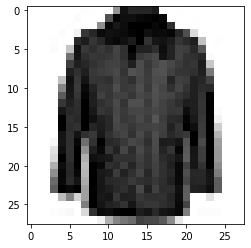

LABEL: 4
INPUT:


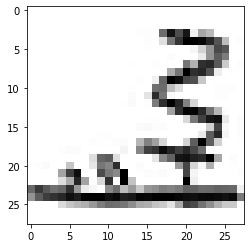

LABEL: 5
INPUT:


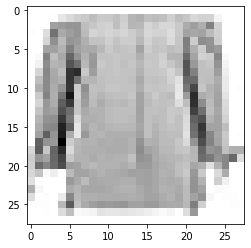

LABEL: 6
INPUT:


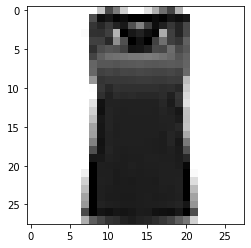

LABEL: 0
INPUT:


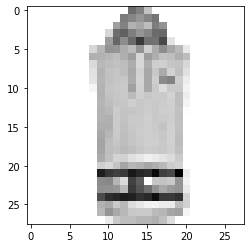

LABEL: 2
INPUT:


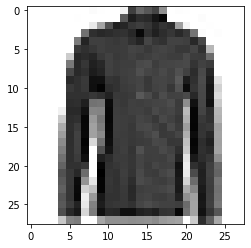

LABEL: 6
INPUT:


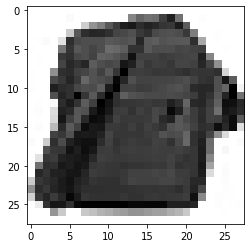

LABEL: 8
INPUT:


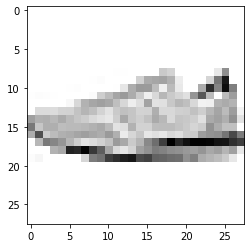

LABEL: 7
INPUT:


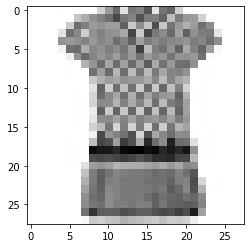

LABEL: 6
INPUT:


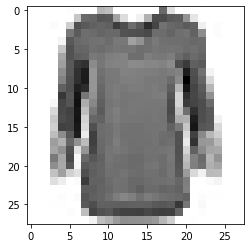

LABEL: 6
INPUT:


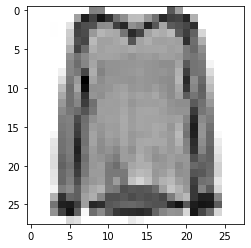

LABEL: 6
INPUT:


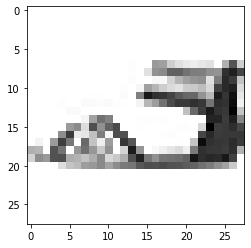

LABEL: 5
INPUT:


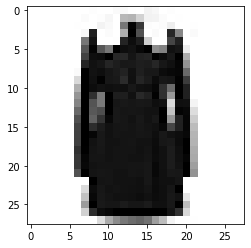

LABEL: 4
INPUT:


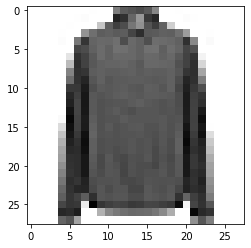

LABEL: 6
INPUT:


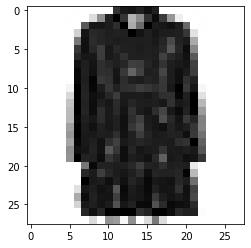

LABEL: 3
INPUT:


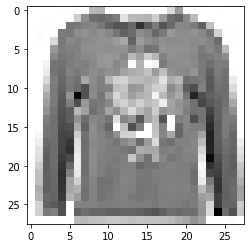

LABEL: 2
INPUT:


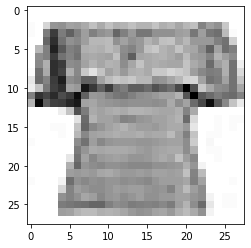

LABEL: 6
INPUT:


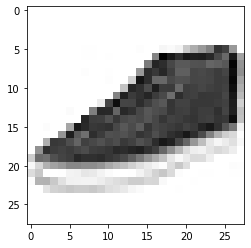

LABEL: 7
INPUT:


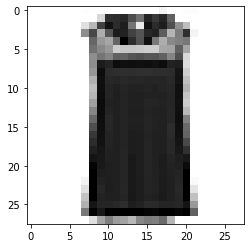

LABEL: 6
INPUT:


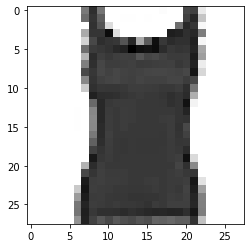

LABEL: 0
INPUT:


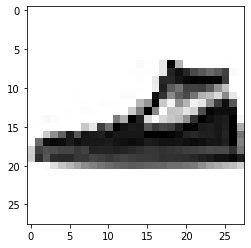

LABEL: 7
INPUT:


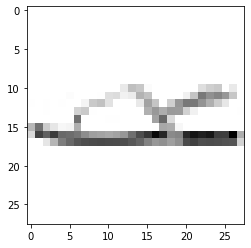

LABEL: 5
INPUT:


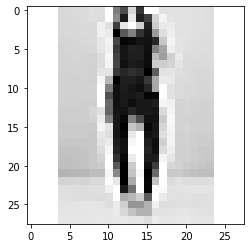

LABEL: 1
INPUT:


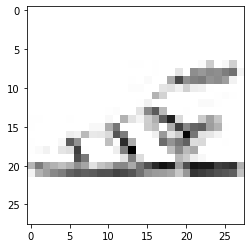

LABEL: 5
INPUT:


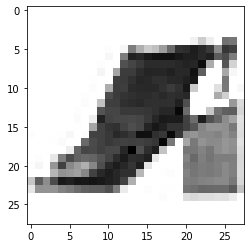

LABEL: 5
INPUT:


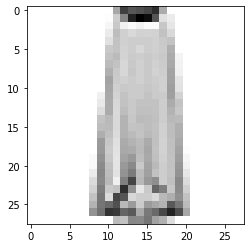

LABEL: 3
INPUT:


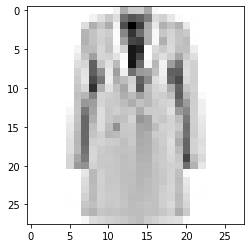

LABEL: 4
INPUT:


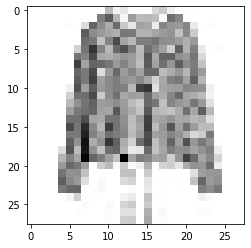

LABEL: 4
INPUT:


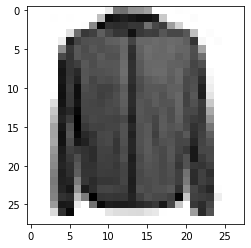

LABEL: 4
INPUT:


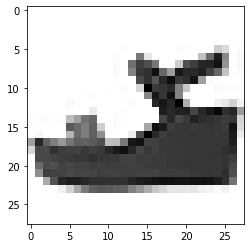

LABEL: 5
INPUT:


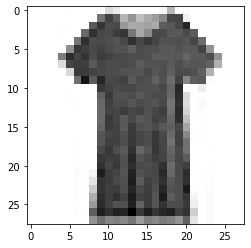

LABEL: 3
INPUT:


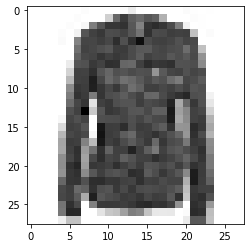

LABEL: 6
INPUT:


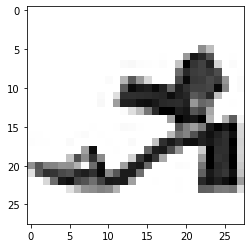

LABEL: 5
INPUT:


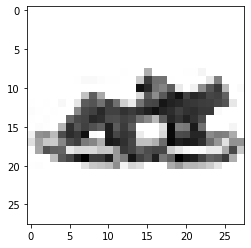

LABEL: 5
INPUT:


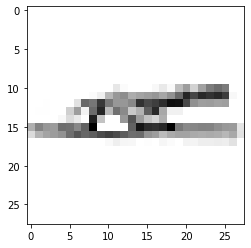

LABEL: 5
INPUT:


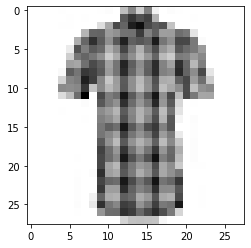

LABEL: 6
INPUT:


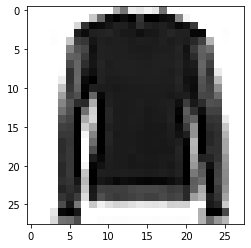

LABEL: 6
INPUT:


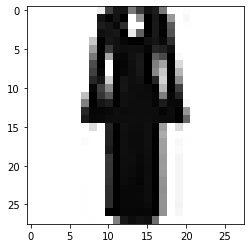

LABEL: 3
INPUT:


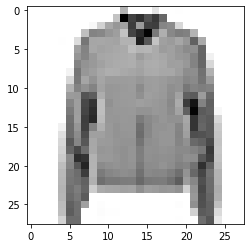

LABEL: 4
INPUT:


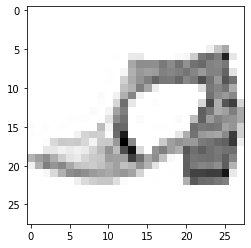

LABEL: 5
INPUT:


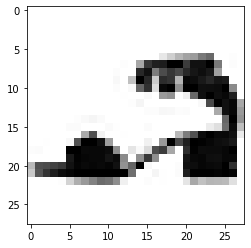

LABEL: 5
INPUT:


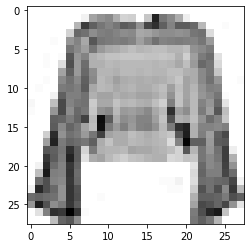

LABEL: 6
INPUT:


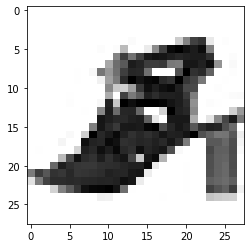

LABEL: 5
INPUT:


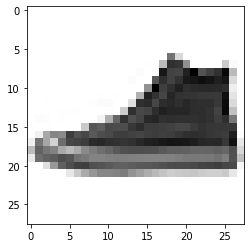

LABEL: 7
INPUT:


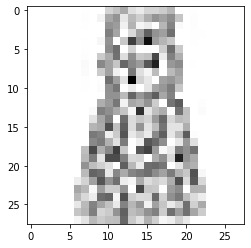

LABEL: 3
INPUT:


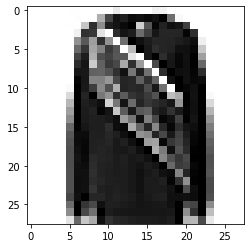

LABEL: 2
INPUT:


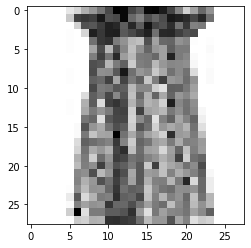

LABEL: 3
INPUT:


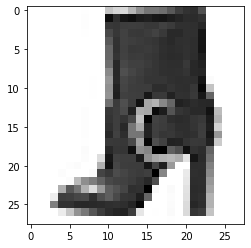

LABEL: 9
INPUT:


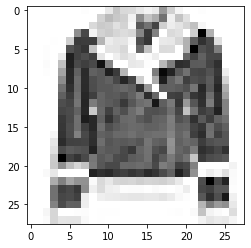

LABEL: 4
INPUT:


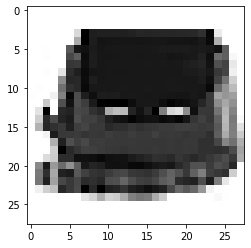

LABEL: 8
INPUT:


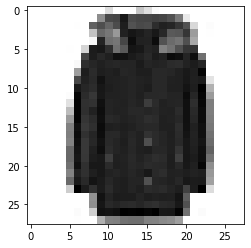

LABEL: 4
INPUT:


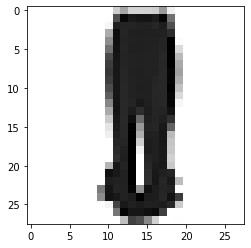

LABEL: 1
INPUT:


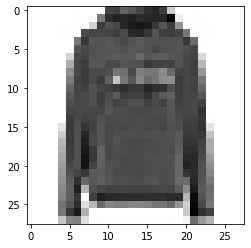

LABEL: 2
INPUT:


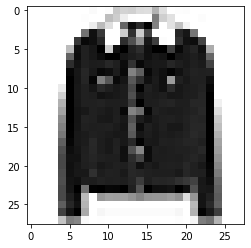

LABEL: 4
INPUT:


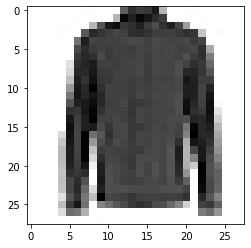

LABEL: 6
INPUT:


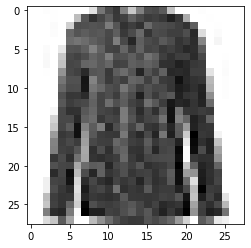

LABEL: 6
INPUT:


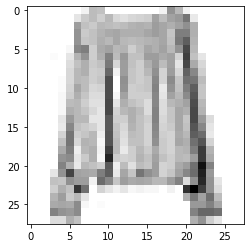

LABEL: 6
INPUT:


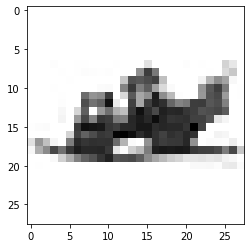

LABEL: 5
INPUT:


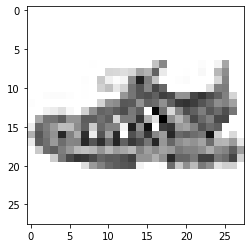

LABEL: 5
INPUT:


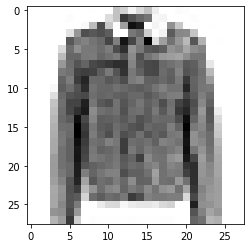

LABEL: 4
INPUT:


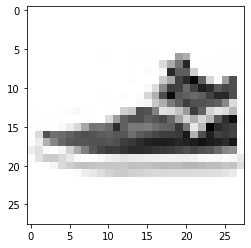

LABEL: 7
INPUT:


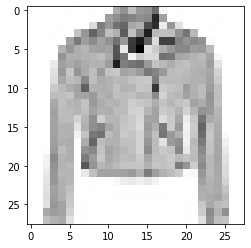

LABEL: 4
INPUT:


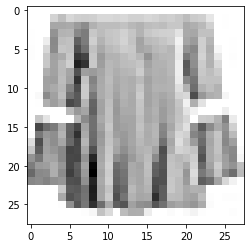

LABEL: 6
INPUT:


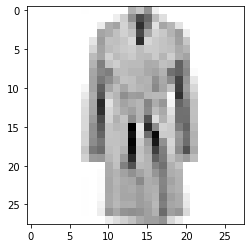

LABEL: 4
INPUT:


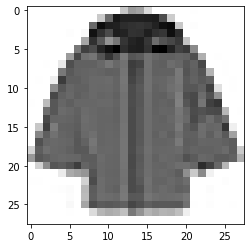

LABEL: 4
INPUT:


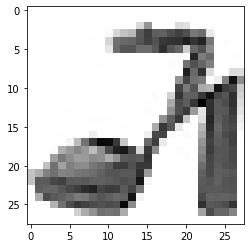

LABEL: 5
INPUT:


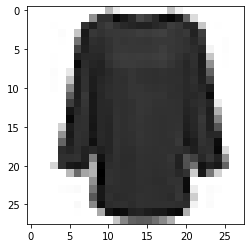

LABEL: 6
INPUT:


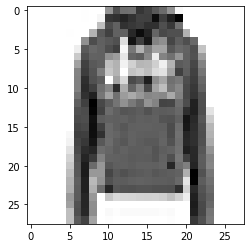

LABEL: 2
INPUT:


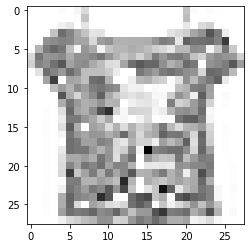

LABEL: 0
INPUT:


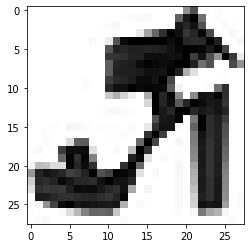

LABEL: 5
INPUT:


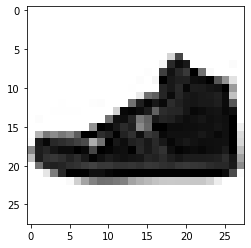

LABEL: 7
INPUT:


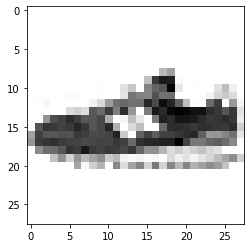

LABEL: 7
INPUT:


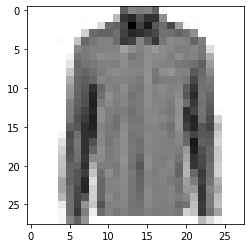

LABEL: 6
INPUT:


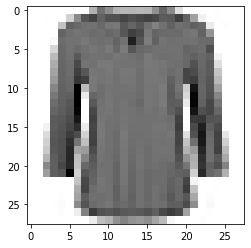

LABEL: 6
INPUT:


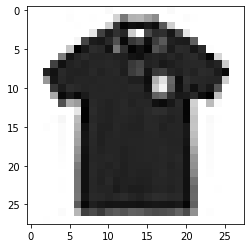

LABEL: 0
INPUT:


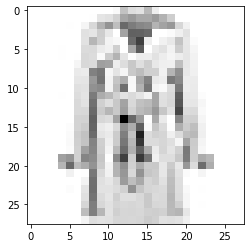

LABEL: 4
INPUT:


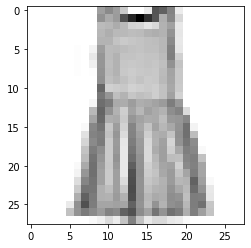

LABEL: 3
INPUT:


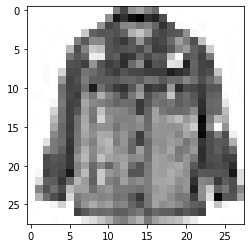

LABEL: 4
INPUT:


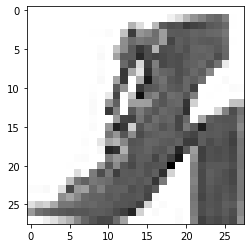

LABEL: 5
INPUT:


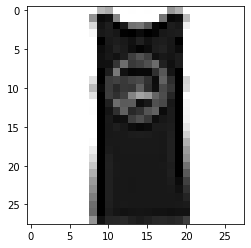

LABEL: 0
INPUT:


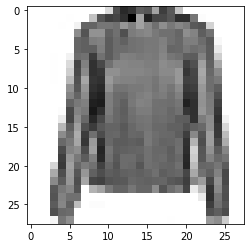

LABEL: 6
INPUT:


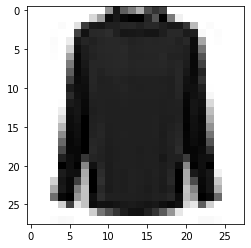

LABEL: 6
INPUT:


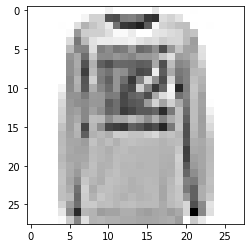

LABEL: 2
INPUT:


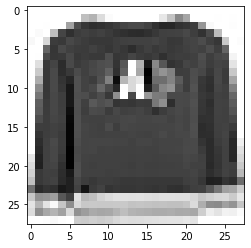

LABEL: 2
INPUT:


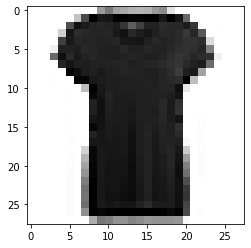

LABEL: 0
INPUT:


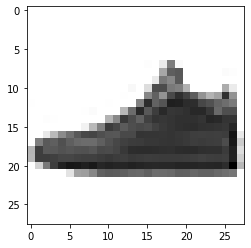

LABEL: 7
INPUT:


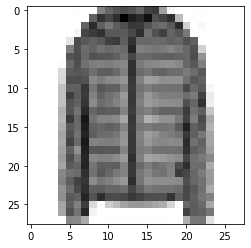

LABEL: 4
INPUT:


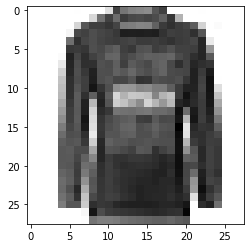

LABEL: 2
INPUT:


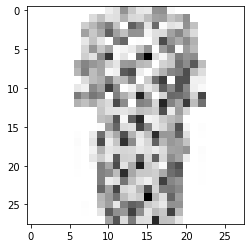

LABEL: 3
INPUT:


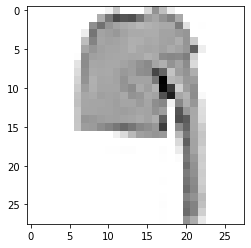

LABEL: 2
INPUT:


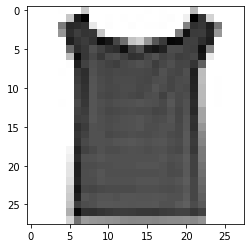

LABEL: 0
INPUT:


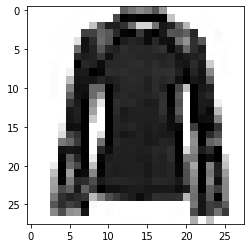

LABEL: 6
INPUT:


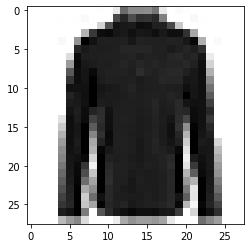

LABEL: 6
INPUT:


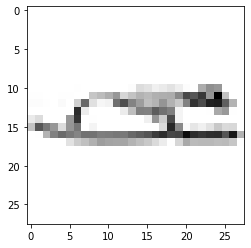

LABEL: 5
INPUT:


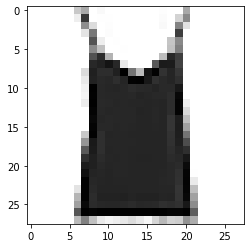

LABEL: 0
INPUT:


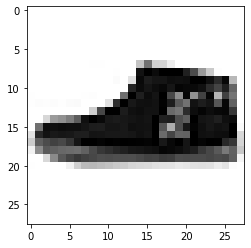

LABEL: 9
INPUT:


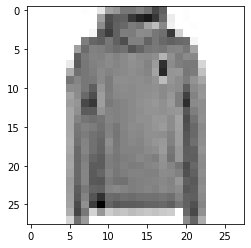

LABEL: 2
INPUT:


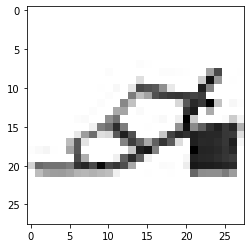

LABEL: 5
INPUT:


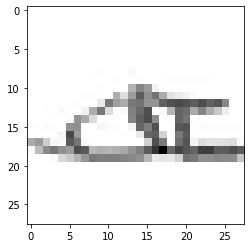

LABEL: 5
INPUT:


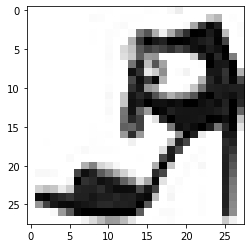

LABEL: 5
INPUT:


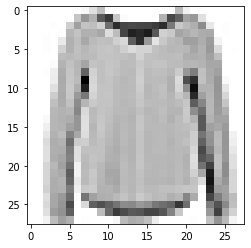

LABEL: 6
INPUT:


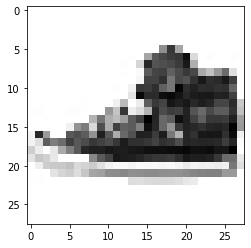

LABEL: 7
INPUT:


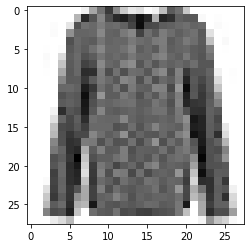

LABEL: 6
INPUT:


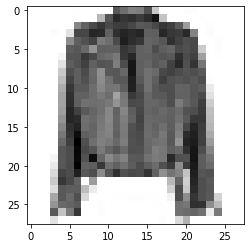

LABEL: 4
INPUT:


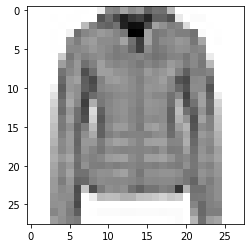

LABEL: 4
INPUT:


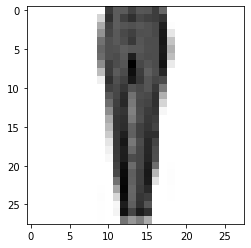

LABEL: 1
INPUT:


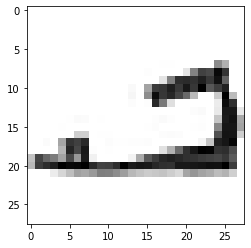

LABEL: 5
INPUT:


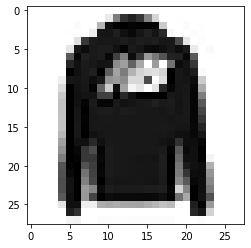

LABEL: 2
INPUT:


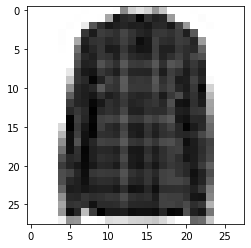

LABEL: 6
INPUT:


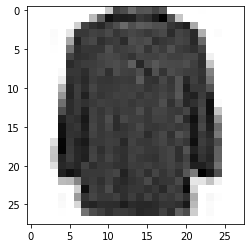

LABEL: 6
INPUT:


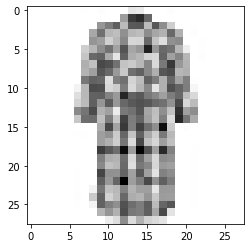

LABEL: 3
INPUT:


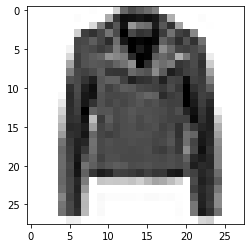

LABEL: 4
INPUT:


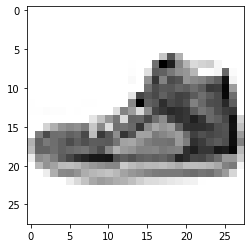

LABEL: 7
INPUT:


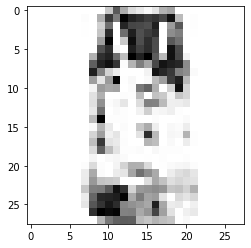

LABEL: 0
INPUT:


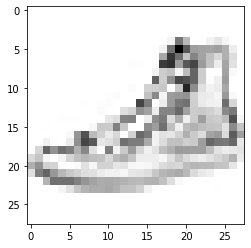

LABEL: 7
INPUT:


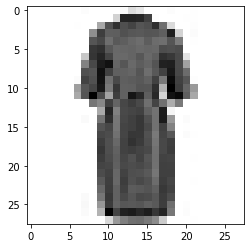

LABEL: 3
INPUT:


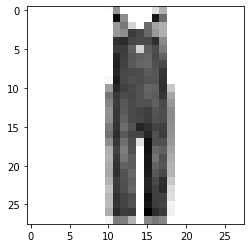

LABEL: 1
INPUT:


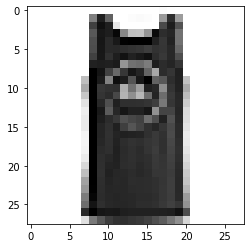

LABEL: 0
INPUT:


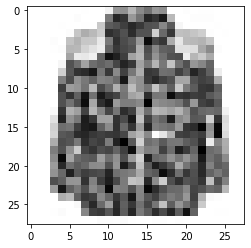

LABEL: 4
INPUT:


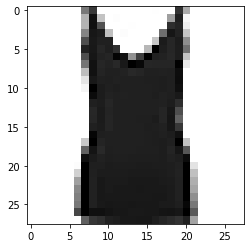

LABEL: 0
INPUT:


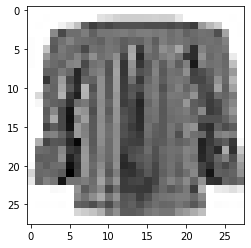

LABEL: 6
INPUT:


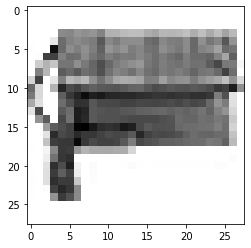

LABEL: 8
INPUT:


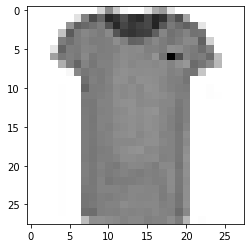

LABEL: 0
INPUT:


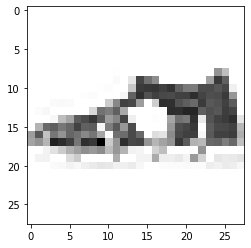

LABEL: 5
INPUT:


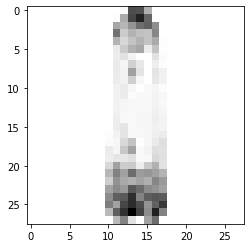

LABEL: 3
INPUT:


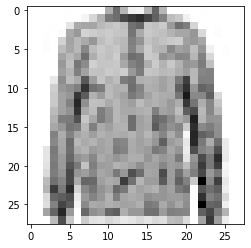

LABEL: 6
INPUT:


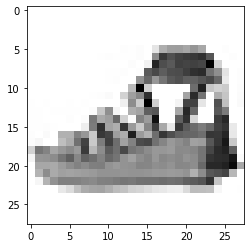

LABEL: 5
INPUT:


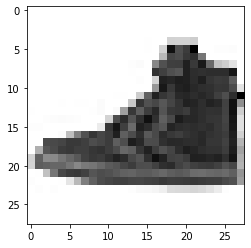

LABEL: 7
INPUT:


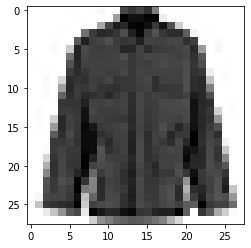

LABEL: 4
INPUT:


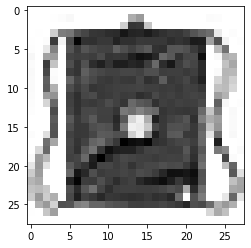

LABEL: 8
INPUT:


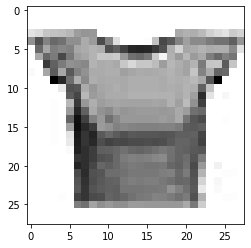

LABEL: 6
INPUT:


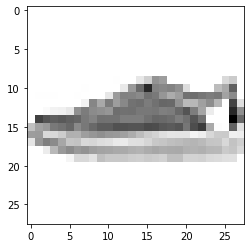

LABEL: 7
INPUT:


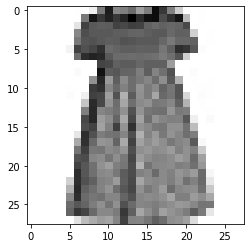

LABEL: 3
INPUT:


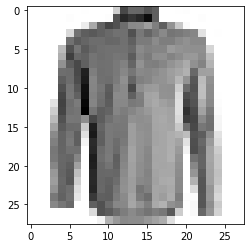

LABEL: 6
INPUT:


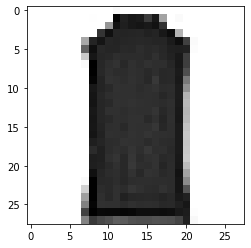

LABEL: 2
INPUT:


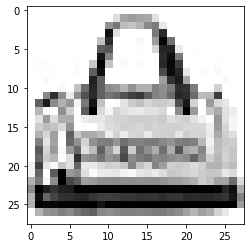

LABEL: 8
INPUT:


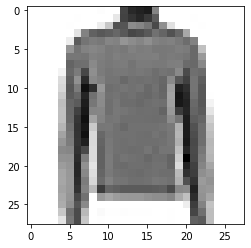

LABEL: 2
INPUT:


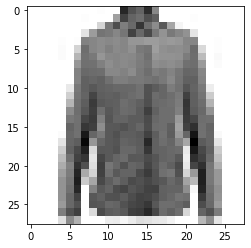

LABEL: 6
INPUT:


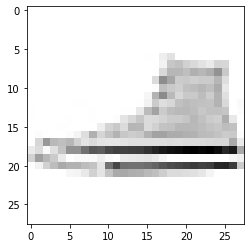

LABEL: 7
INPUT:


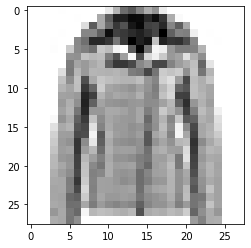

LABEL: 4
INPUT:


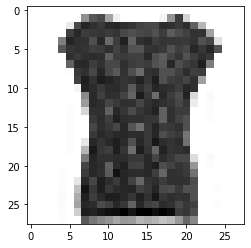

LABEL: 0
INPUT:


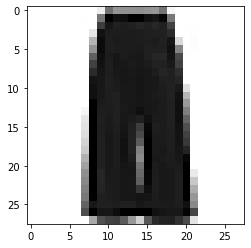

LABEL: 1
INPUT:


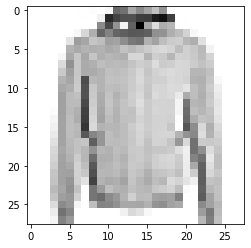

LABEL: 4
INPUT:


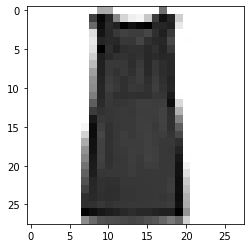

LABEL: 3
INPUT:


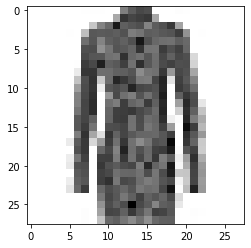

LABEL: 3
INPUT:


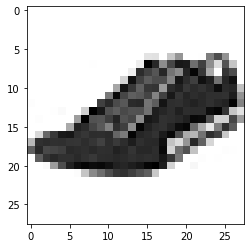

LABEL: 7
INPUT:


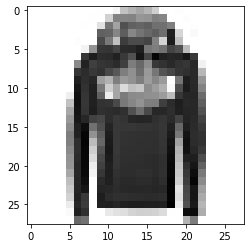

LABEL: 2
INPUT:


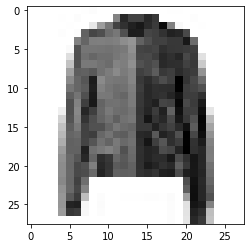

LABEL: 4
INPUT:


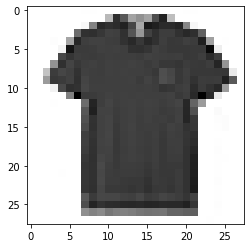

LABEL: 0
INPUT:


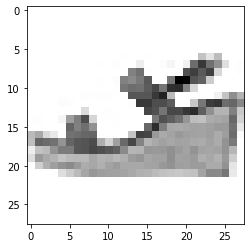

LABEL: 5
INPUT:


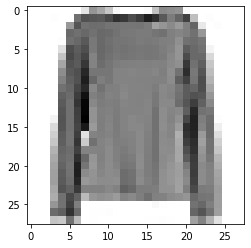

LABEL: 6
INPUT:


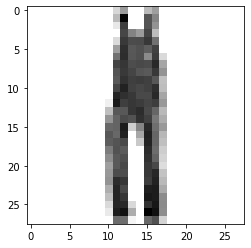

LABEL: 1
INPUT:


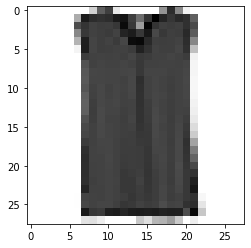

LABEL: 6
INPUT:


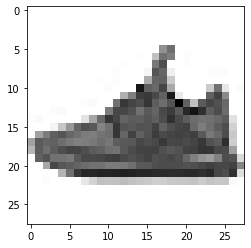

LABEL: 7
INPUT:


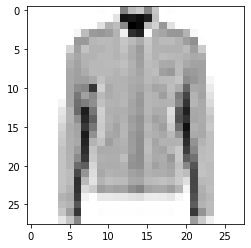

LABEL: 4
INPUT:


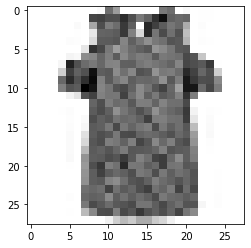

LABEL: 6
INPUT:


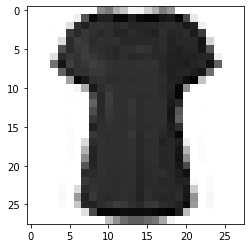

LABEL: 0
INPUT:


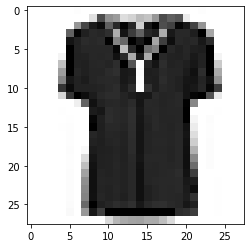

LABEL: 6
INPUT:


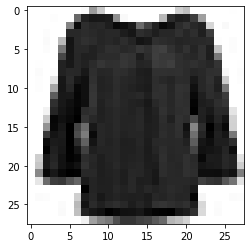

LABEL: 6
INPUT:


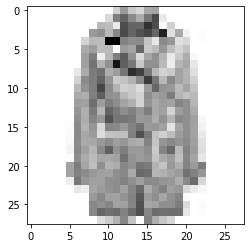

LABEL: 4
INPUT:


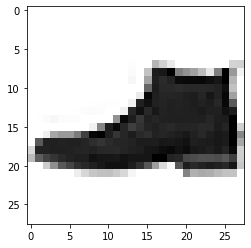

LABEL: 9
INPUT:


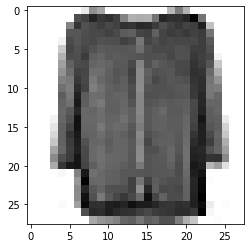

LABEL: 6
INPUT:


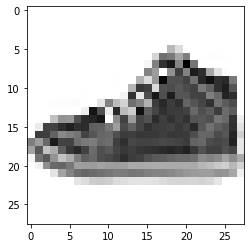

LABEL: 7
INPUT:


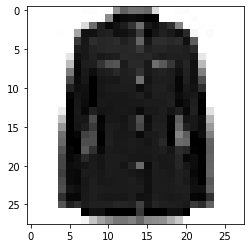

LABEL: 4
INPUT:


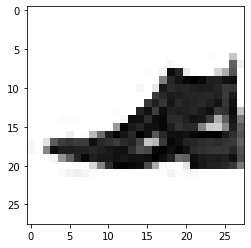

LABEL: 9
INPUT:


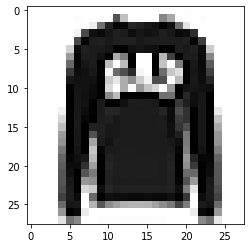

LABEL: 2
INPUT:


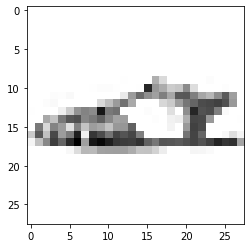

LABEL: 5
INPUT:


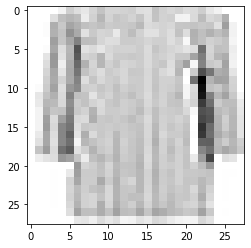

LABEL: 6
INPUT:


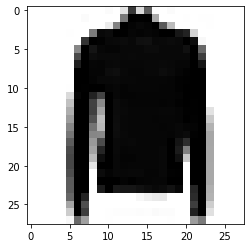

LABEL: 2
INPUT:


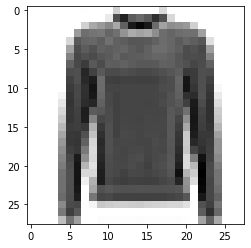

LABEL: 2
INPUT:


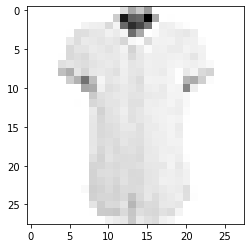

LABEL: 6
INPUT:


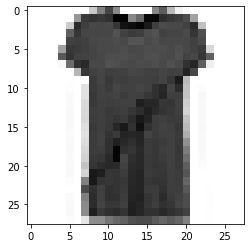

LABEL: 0
INPUT:


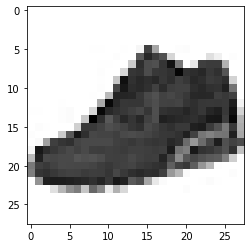

LABEL: 7
INPUT:


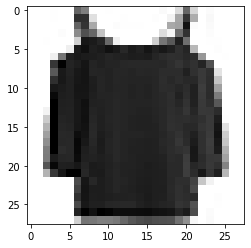

LABEL: 6
INPUT:


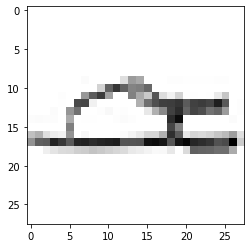

LABEL: 5
INPUT:


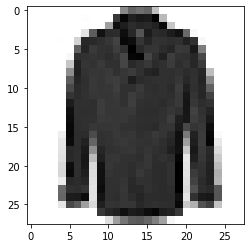

LABEL: 4
INPUT:


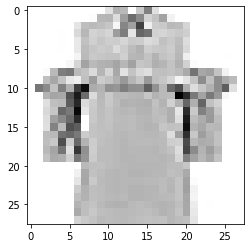

LABEL: 6
INPUT:


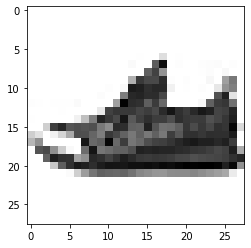

LABEL: 7
INPUT:


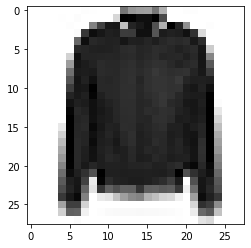

LABEL: 4
INPUT:


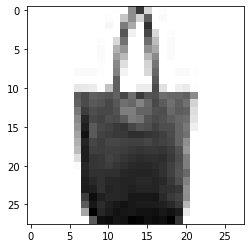

LABEL: 8
INPUT:


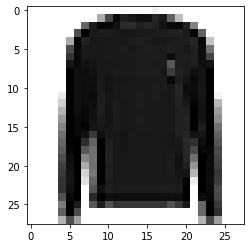

LABEL: 2
INPUT:


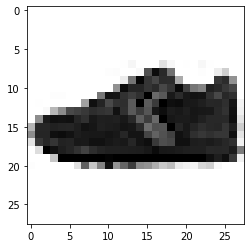

LABEL: 7
INPUT:


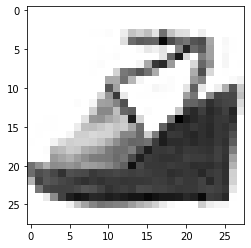

LABEL: 5
INPUT:


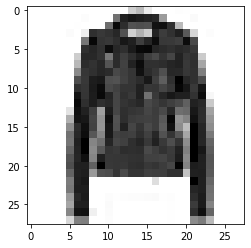

LABEL: 4
INPUT:


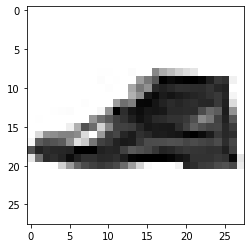

LABEL: 9
INPUT:


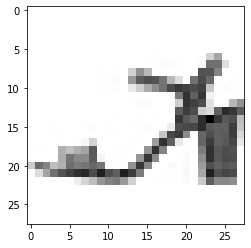

LABEL: 5
INPUT:


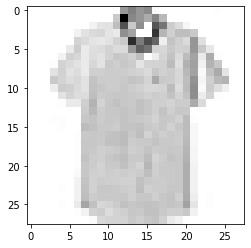

LABEL: 6
INPUT:


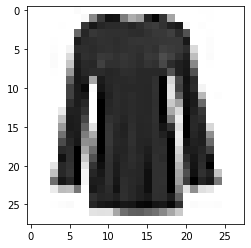

LABEL: 6
INPUT:


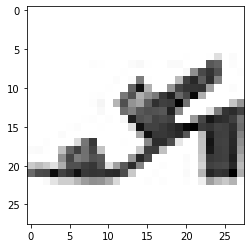

LABEL: 5
INPUT:


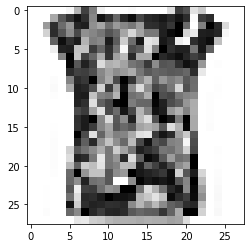

LABEL: 6
INPUT:


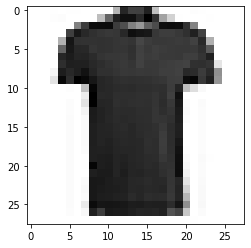

LABEL: 0
INPUT:


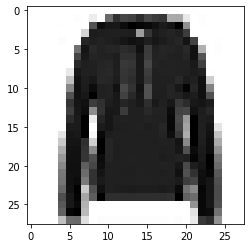

LABEL: 2
INPUT:


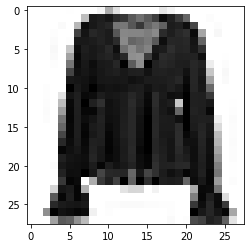

LABEL: 6
INPUT:


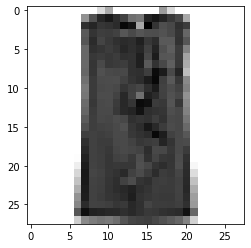

LABEL: 6
INPUT:


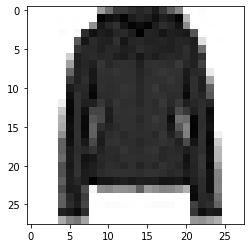

LABEL: 4
INPUT:


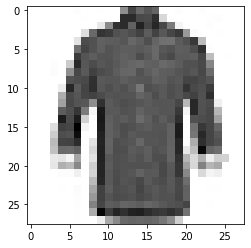

LABEL: 6
INPUT:


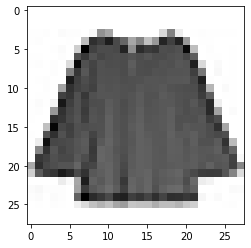

LABEL: 6
INPUT:


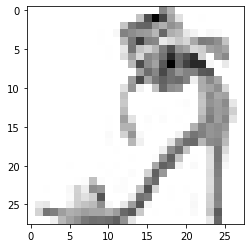

LABEL: 5
INPUT:


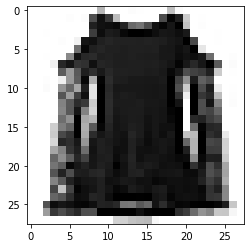

LABEL: 6
INPUT:


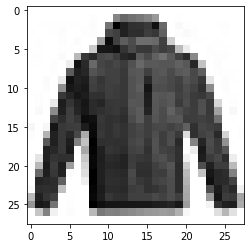

LABEL: 4
INPUT:


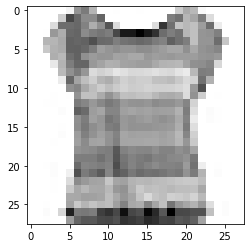

LABEL: 6
INPUT:


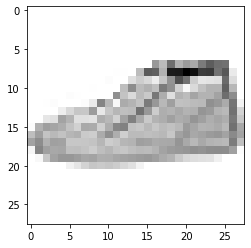

LABEL: 7
INPUT:


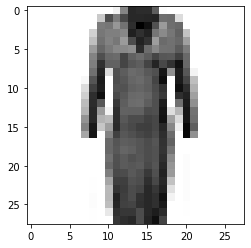

LABEL: 3
INPUT:


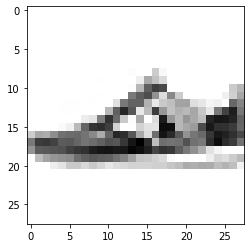

LABEL: 7
INPUT:


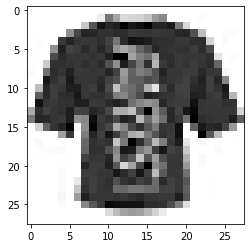

LABEL: 0
INPUT:


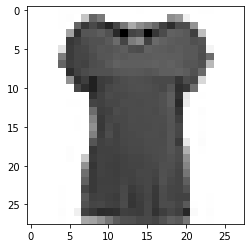

LABEL: 0
INPUT:


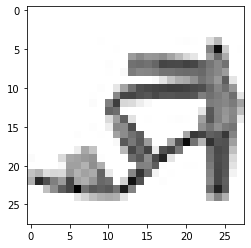

LABEL: 5
INPUT:


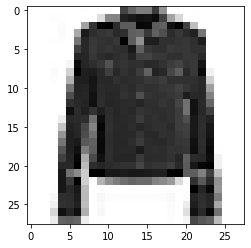

LABEL: 4
INPUT:


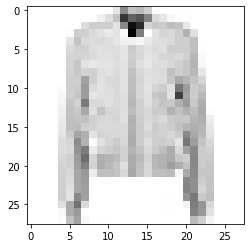

LABEL: 4
INPUT:


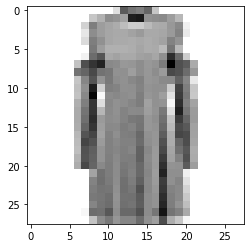

LABEL: 3
INPUT:


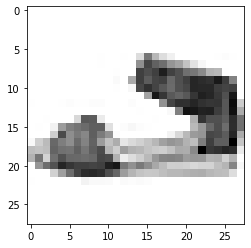

LABEL: 5
INPUT:


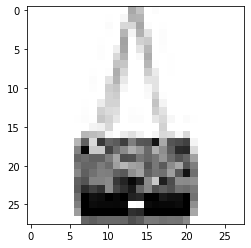

LABEL: 8
INPUT:


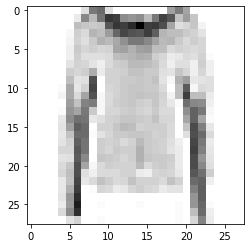

LABEL: 2
INPUT:


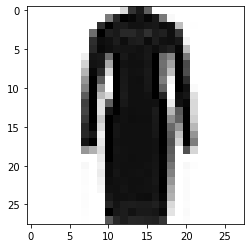

LABEL: 3
INPUT:


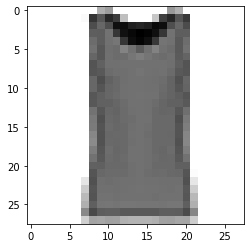

LABEL: 0
INPUT:


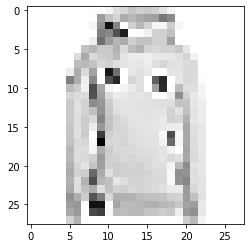

LABEL: 2
INPUT:


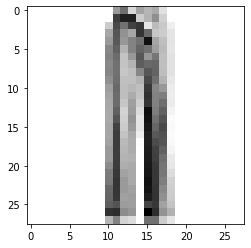

LABEL: 1
INPUT:


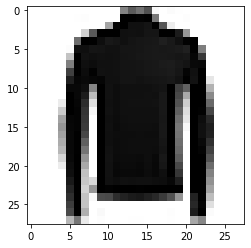

LABEL: 2
INPUT:


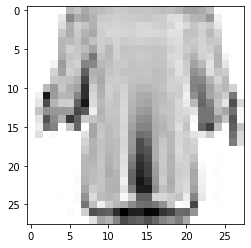

LABEL: 6
INPUT:


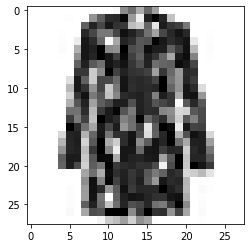

LABEL: 4
INPUT:


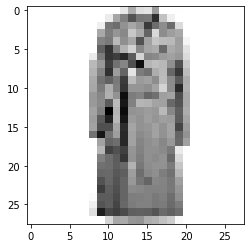

LABEL: 4
INPUT:


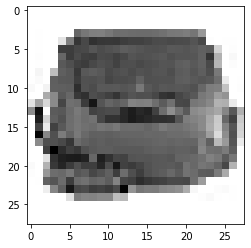

LABEL: 8
INPUT:


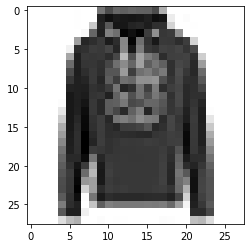

LABEL: 2
INPUT:


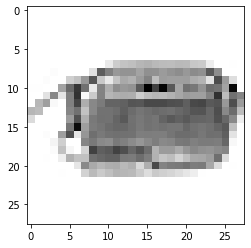

LABEL: 8
INPUT:


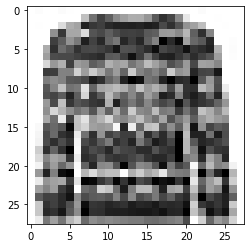

LABEL: 2
INPUT:


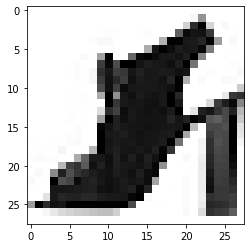

LABEL: 5
INPUT:


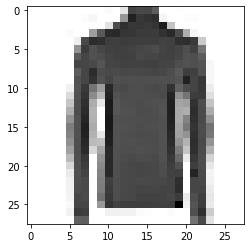

LABEL: 2
INPUT:


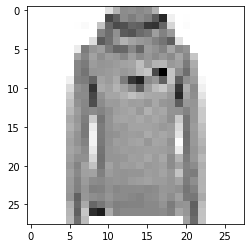

LABEL: 2
INPUT:


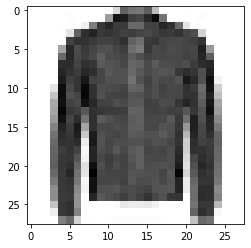

LABEL: 4
INPUT:


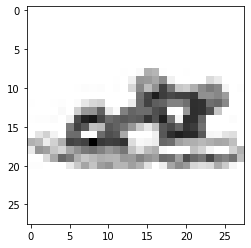

LABEL: 5
INPUT:


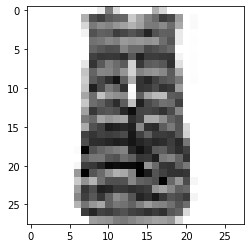

LABEL: 6
INPUT:


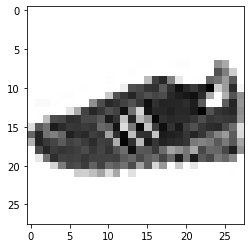

LABEL: 7
INPUT:


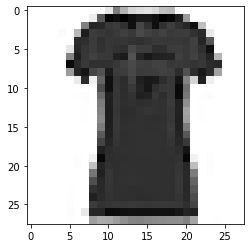

LABEL: 0
INPUT:


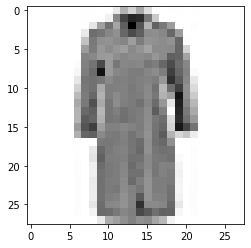

LABEL: 3
INPUT:


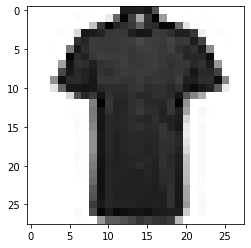

LABEL: 6
INPUT:


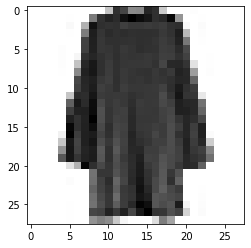

LABEL: 3
INPUT:


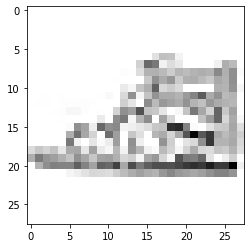

LABEL: 5
INPUT:


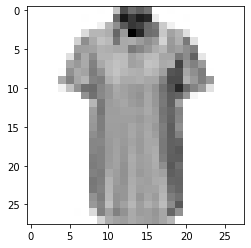

LABEL: 6
INPUT:


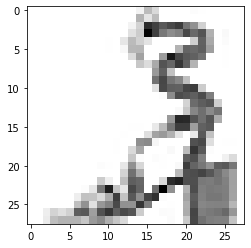

LABEL: 5
INPUT:


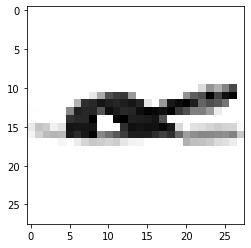

LABEL: 5
INPUT:


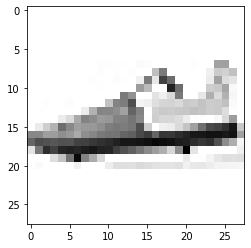

LABEL: 7
INPUT:


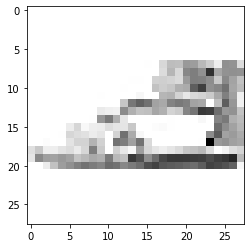

LABEL: 5
INPUT:


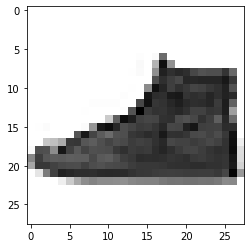

LABEL: 7
INPUT:


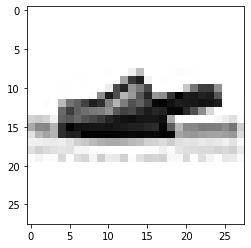

LABEL: 5
INPUT:


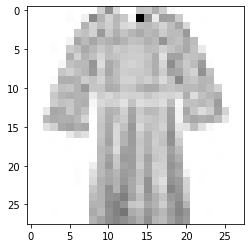

LABEL: 3
INPUT:


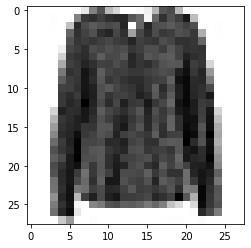

LABEL: 6
INPUT:


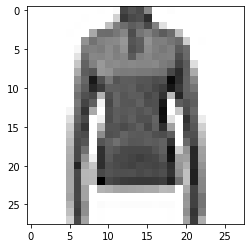

LABEL: 2
INPUT:


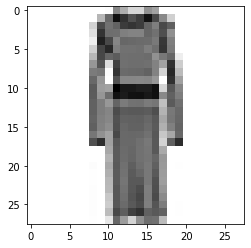

LABEL: 3
INPUT:


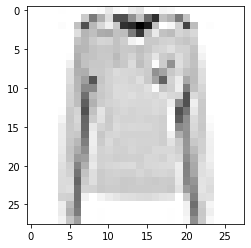

LABEL: 2
INPUT:


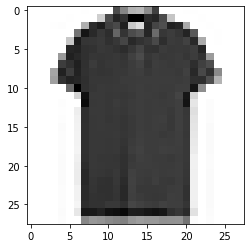

LABEL: 0
INPUT:


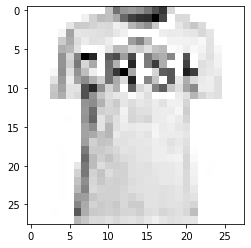

LABEL: 0
INPUT:


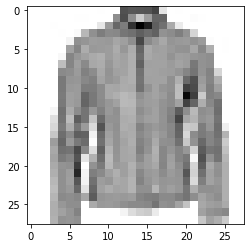

LABEL: 4
INPUT:


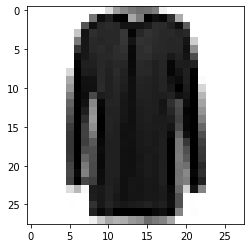

LABEL: 4
INPUT:


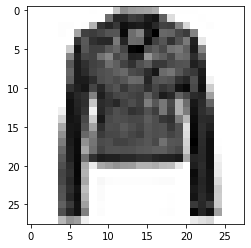

LABEL: 4
INPUT:


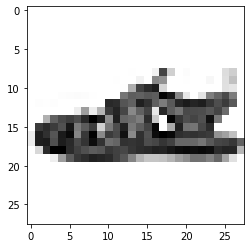

LABEL: 5
INPUT:


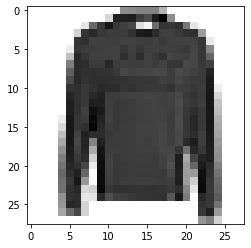

LABEL: 2
INPUT:


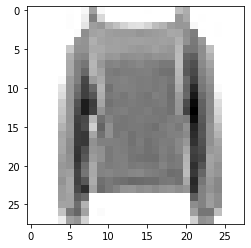

LABEL: 2
INPUT:


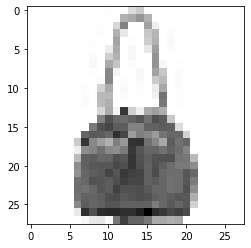

LABEL: 8
INPUT:


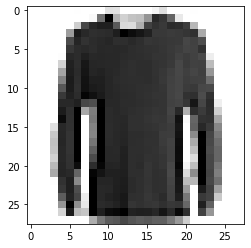

LABEL: 2
INPUT:


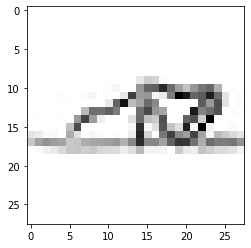

LABEL: 5
INPUT:


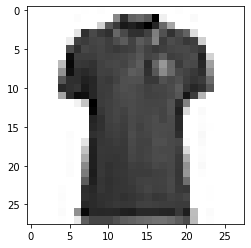

LABEL: 0
INPUT:


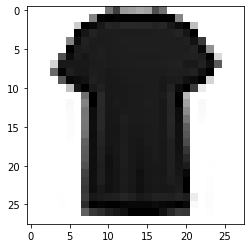

LABEL: 0
INPUT:


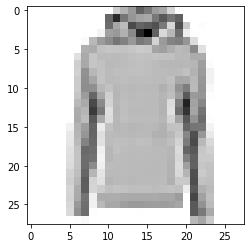

LABEL: 2
INPUT:


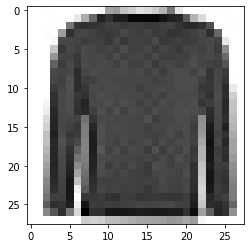

LABEL: 2
INPUT:


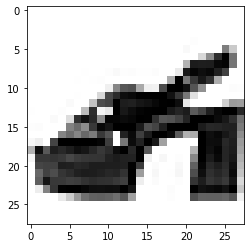

LABEL: 5
INPUT:


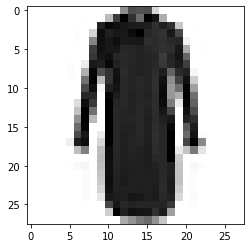

LABEL: 3
INPUT:


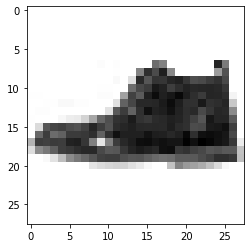

LABEL: 9
INPUT:


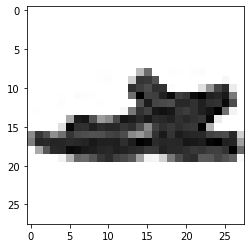

LABEL: 5
INPUT:


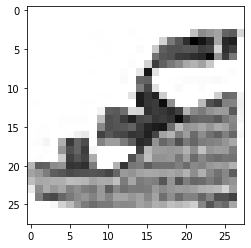

LABEL: 5
INPUT:


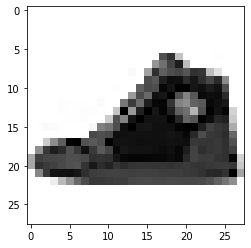

LABEL: 7
INPUT:


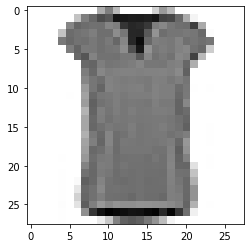

LABEL: 6
INPUT:


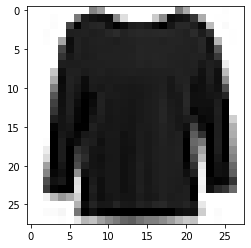

LABEL: 2
INPUT:


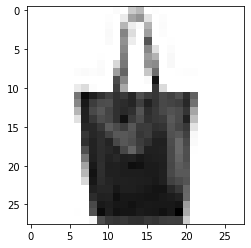

LABEL: 8
INPUT:


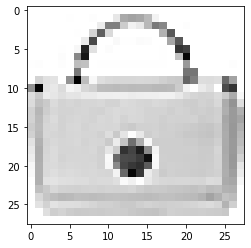

LABEL: 8
INPUT:


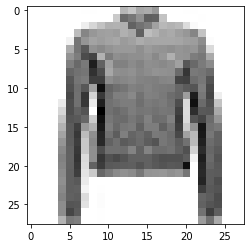

LABEL: 4
INPUT:


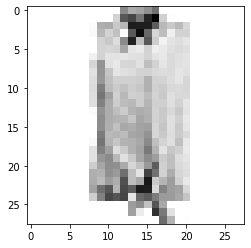

LABEL: 6
INPUT:


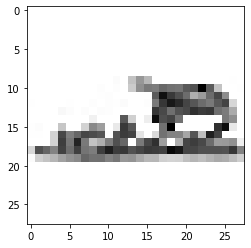

LABEL: 5
INPUT:


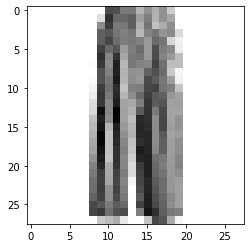

LABEL: 1
INPUT:


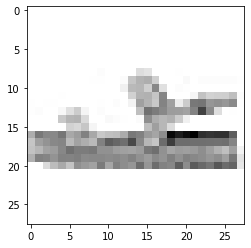

LABEL: 5
INPUT:


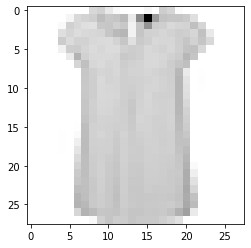

LABEL: 6
INPUT:


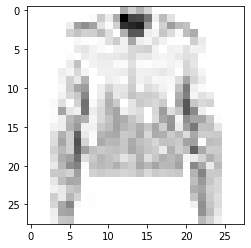

LABEL: 4
INPUT:


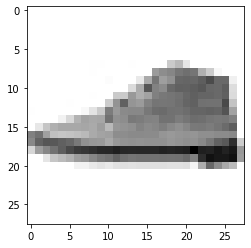

LABEL: 7
INPUT:


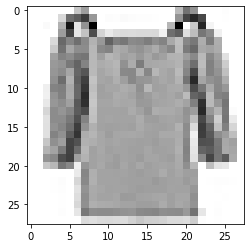

LABEL: 6
INPUT:


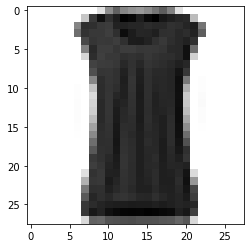

LABEL: 6
INPUT:


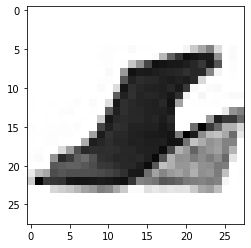

LABEL: 5
INPUT:


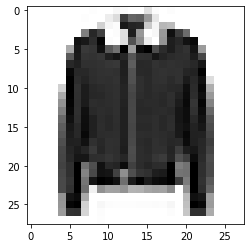

LABEL: 4
INPUT:


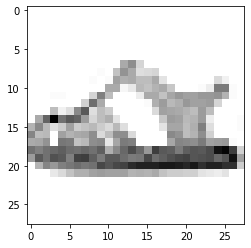

LABEL: 5
INPUT:


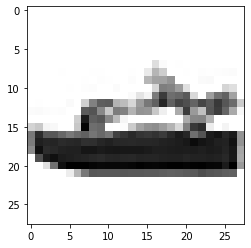

LABEL: 5
INPUT:


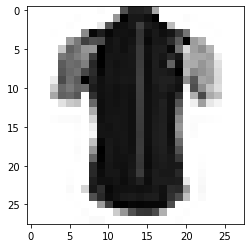

LABEL: 0
INPUT:


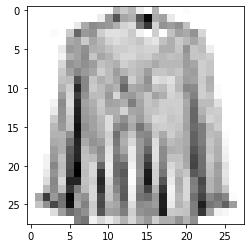

LABEL: 6
INPUT:


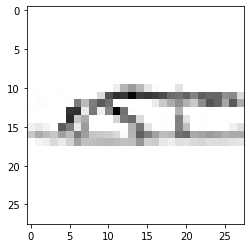

LABEL: 5
INPUT:


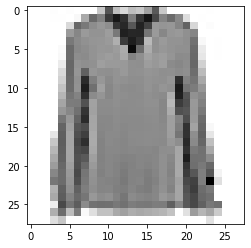

LABEL: 6
INPUT:


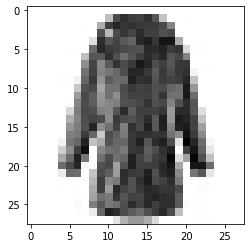

LABEL: 4
INPUT:


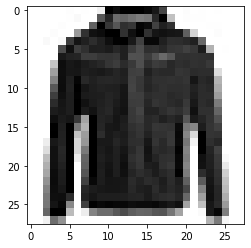

LABEL: 4
INPUT:


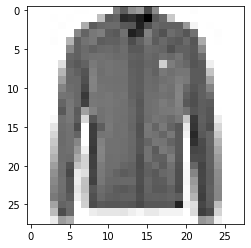

LABEL: 4
INPUT:


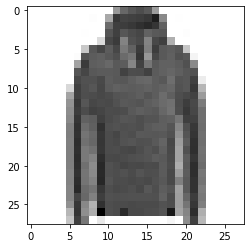

LABEL: 2
INPUT:


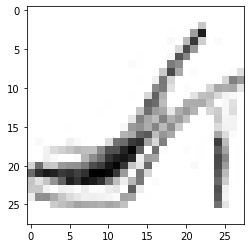

LABEL: 5
INPUT:


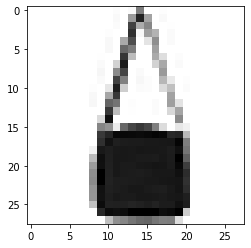

LABEL: 8
INPUT:


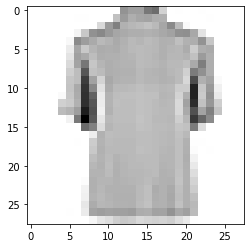

LABEL: 6
INPUT:


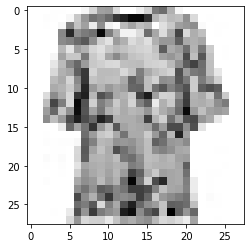

LABEL: 6
INPUT:


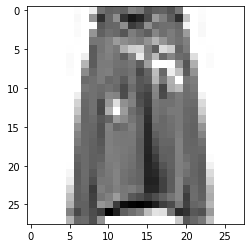

LABEL: 2
INPUT:


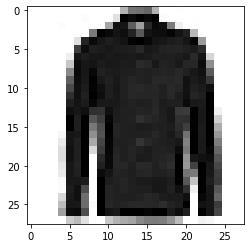

LABEL: 6
INPUT:


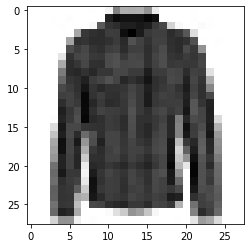

LABEL: 4
INPUT:


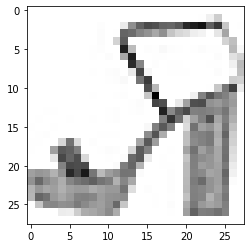

LABEL: 5
INPUT:


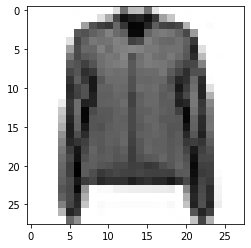

LABEL: 4
INPUT:


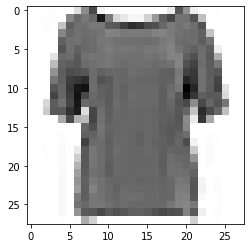

LABEL: 6
INPUT:


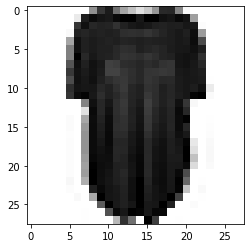

LABEL: 0
INPUT:


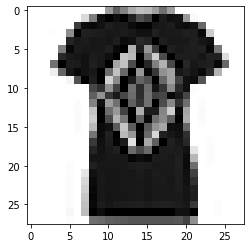

LABEL: 0
INPUT:


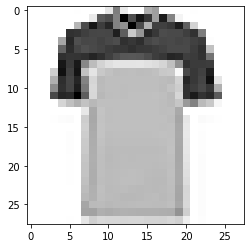

LABEL: 0
INPUT:


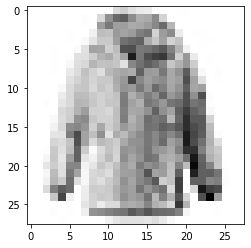

LABEL: 4
INPUT:


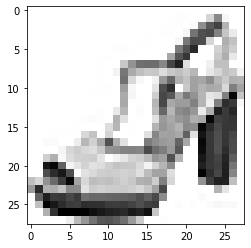

LABEL: 5
INPUT:


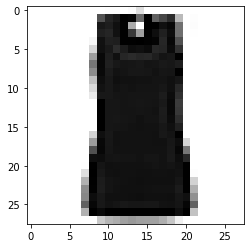

LABEL: 0
INPUT:


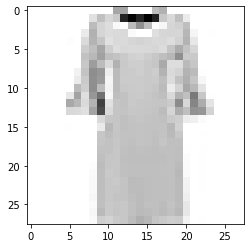

LABEL: 3
INPUT:


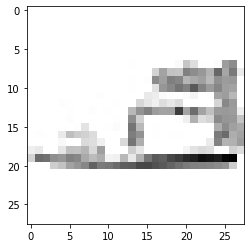

LABEL: 5
INPUT:


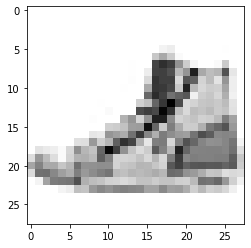

LABEL: 7
INPUT:


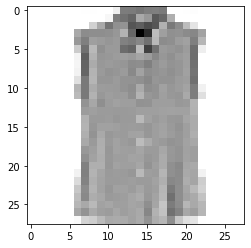

LABEL: 6
INPUT:


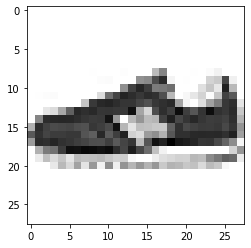

LABEL: 7
INPUT:


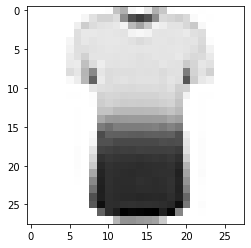

LABEL: 0
INPUT:


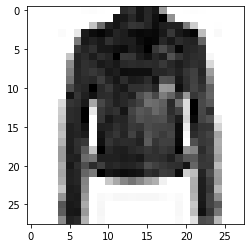

LABEL: 4
INPUT:


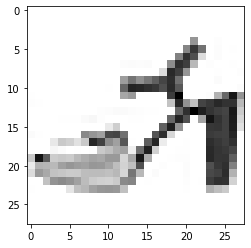

LABEL: 5
INPUT:


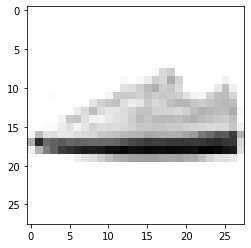

LABEL: 7
INPUT:


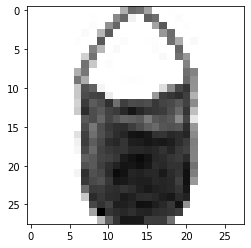

LABEL: 8
INPUT:


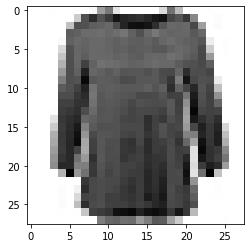

LABEL: 6
INPUT:


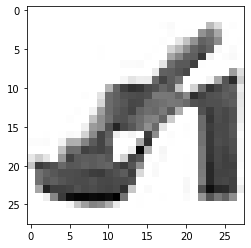

LABEL: 5
INPUT:


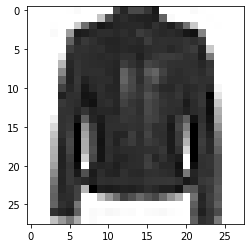

LABEL: 4
INPUT:


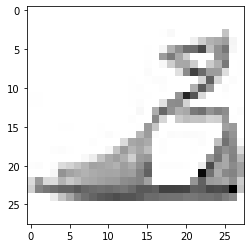

LABEL: 5
INPUT:


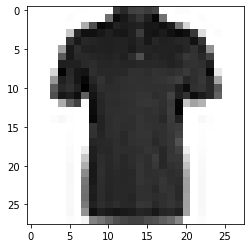

LABEL: 0
INPUT:


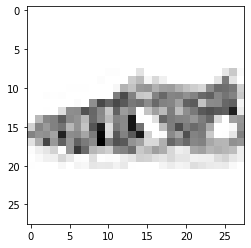

LABEL: 5
INPUT:


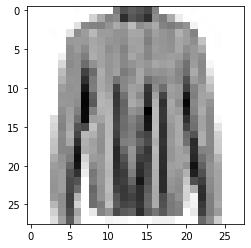

LABEL: 6
INPUT:


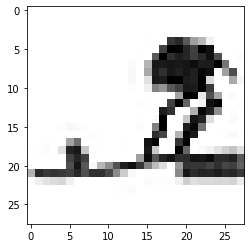

LABEL: 5
INPUT:


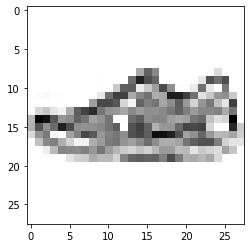

LABEL: 7
INPUT:


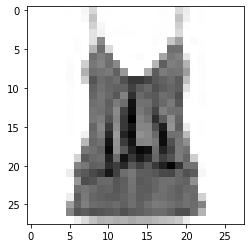

LABEL: 0
INPUT:


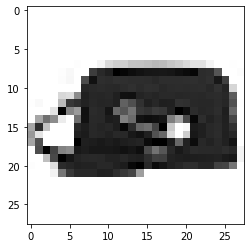

LABEL: 8
INPUT:


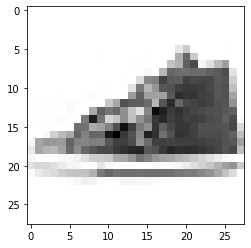

LABEL: 7
INPUT:


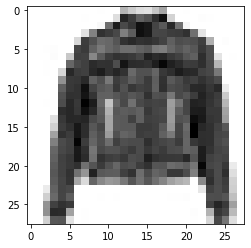

LABEL: 4
INPUT:


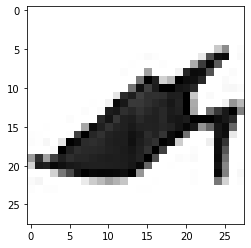

LABEL: 5
INPUT:


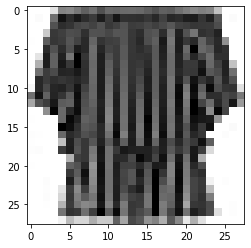

LABEL: 6
INPUT:


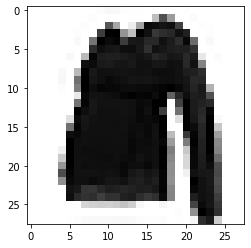

LABEL: 6
INPUT:


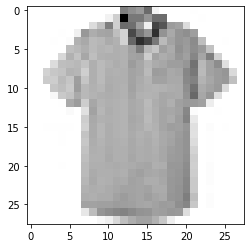

LABEL: 6
INPUT:


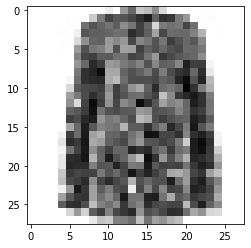

LABEL: 4
INPUT:


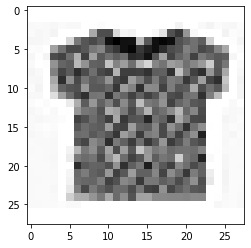

LABEL: 0
INPUT:


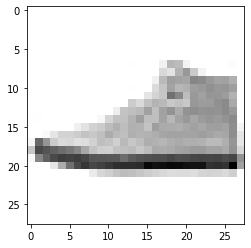

LABEL: 7
INPUT:


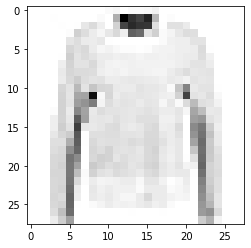

LABEL: 2
INPUT:


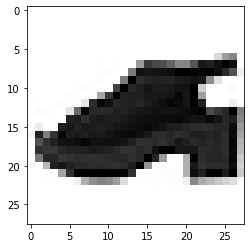

LABEL: 5
INPUT:


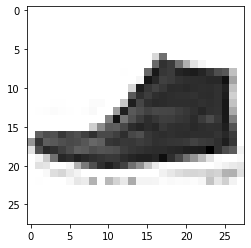

LABEL: 9
INPUT:


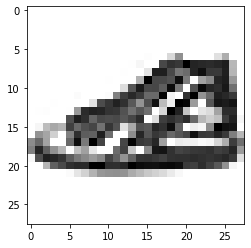

LABEL: 7
INPUT:


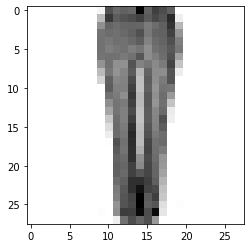

LABEL: 1
INPUT:


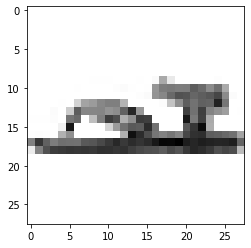

LABEL: 5
INPUT:


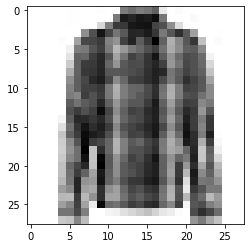

LABEL: 6
INPUT:


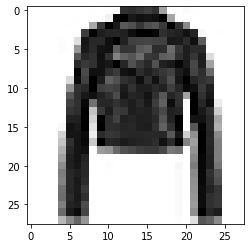

LABEL: 4
INPUT:


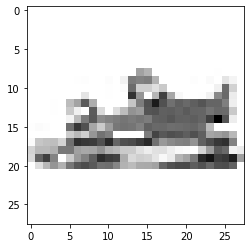

LABEL: 5
INPUT:


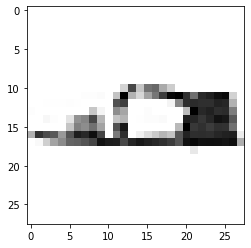

LABEL: 5
INPUT:


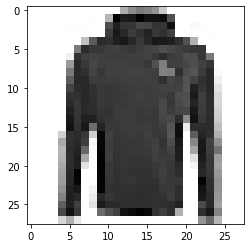

LABEL: 2
INPUT:


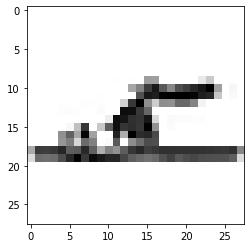

LABEL: 5
INPUT:


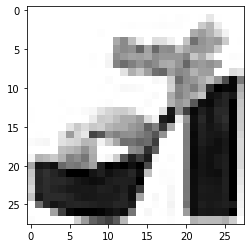

LABEL: 5
INPUT:


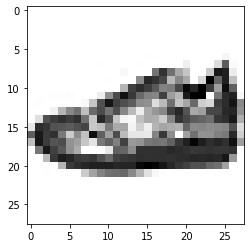

LABEL: 7
INPUT:


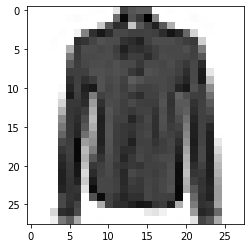

LABEL: 6
INPUT:


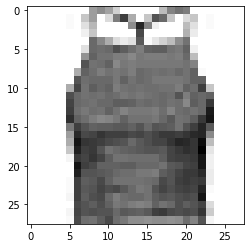

LABEL: 0
INPUT:


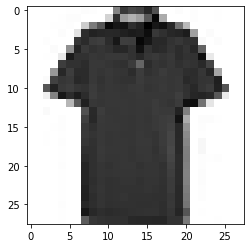

LABEL: 0
INPUT:


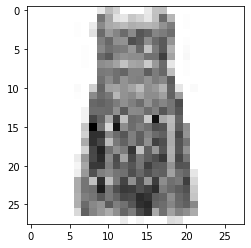

LABEL: 3
INPUT:


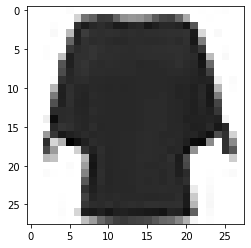

LABEL: 6
INPUT:


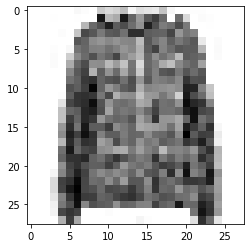

LABEL: 4
INPUT:


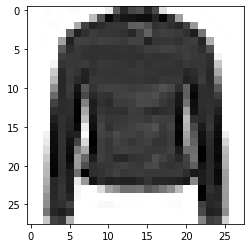

LABEL: 4
INPUT:


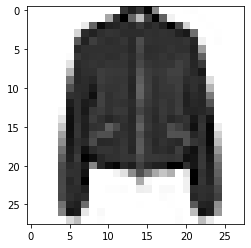

LABEL: 4
INPUT:


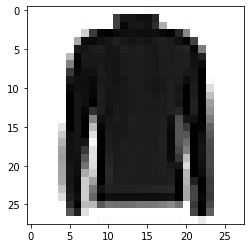

LABEL: 2
INPUT:


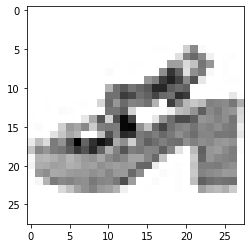

LABEL: 5
INPUT:


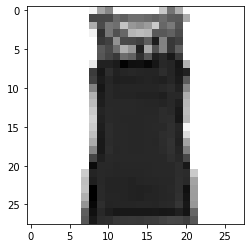

LABEL: 0
INPUT:


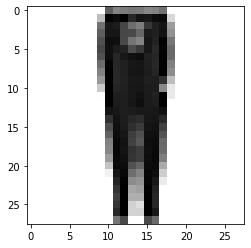

LABEL: 1
INPUT:


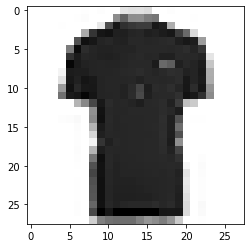

LABEL: 0
INPUT:


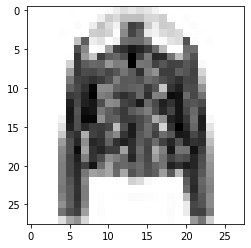

LABEL: 4
INPUT:


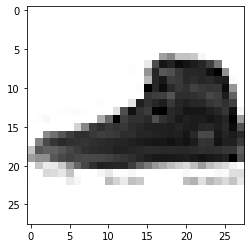

LABEL: 9
INPUT:


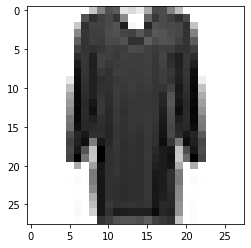

LABEL: 3
INPUT:


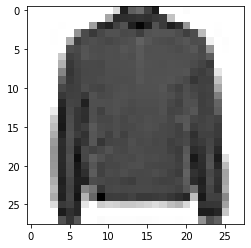

LABEL: 4
INPUT:


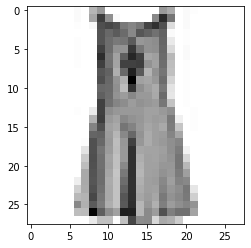

LABEL: 3
INPUT:


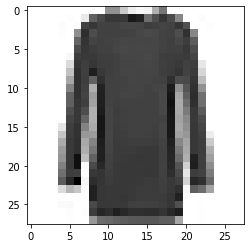

LABEL: 2
INPUT:


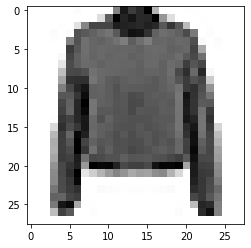

LABEL: 4
INPUT:


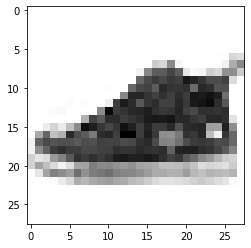

LABEL: 7
INPUT:


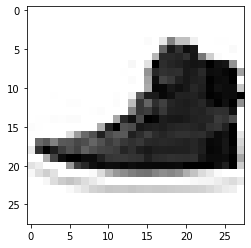

LABEL: 7
INPUT:


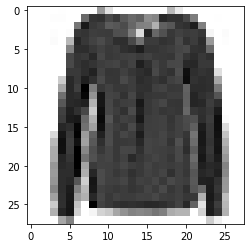

LABEL: 6
INPUT:


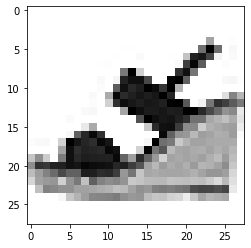

LABEL: 5
INPUT:


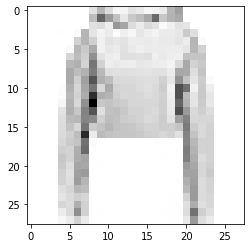

LABEL: 2
INPUT:


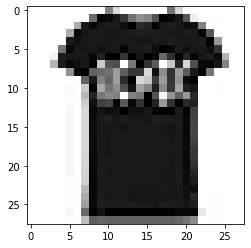

LABEL: 0
INPUT:


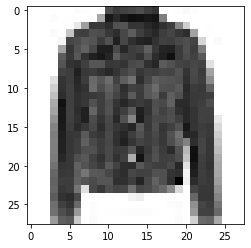

LABEL: 4
INPUT:


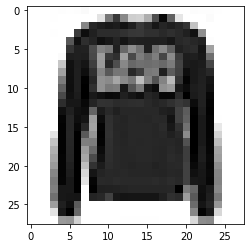

LABEL: 2
INPUT:


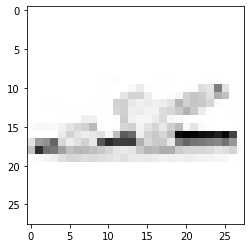

LABEL: 5
INPUT:


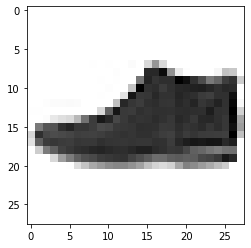

LABEL: 9
INPUT:


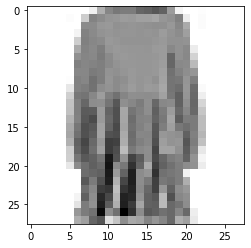

LABEL: 3
INPUT:


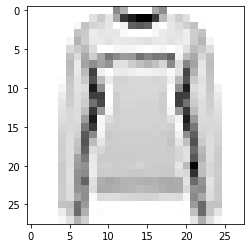

LABEL: 2
INPUT:


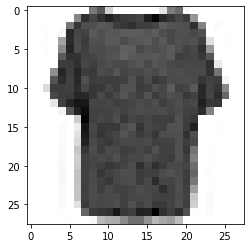

LABEL: 6
INPUT:


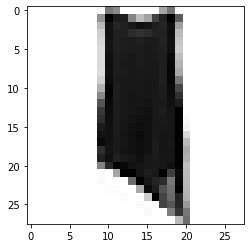

LABEL: 6
INPUT:


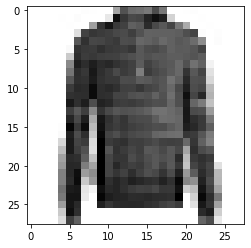

LABEL: 2
INPUT:


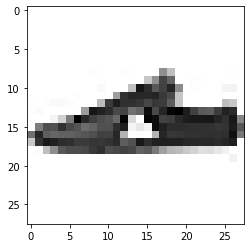

LABEL: 7
INPUT:


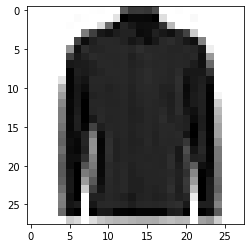

LABEL: 6
INPUT:


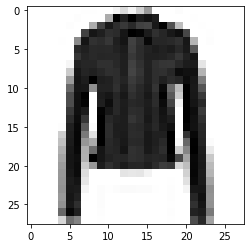

LABEL: 4
INPUT:


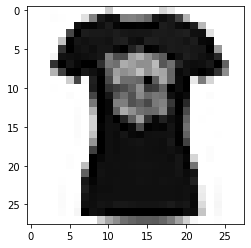

LABEL: 0
INPUT:


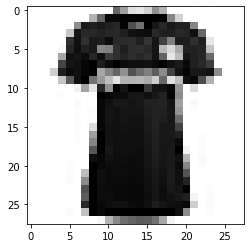

LABEL: 0
INPUT:


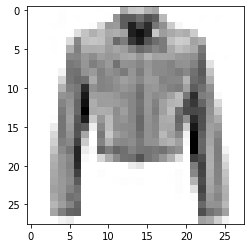

LABEL: 4
INPUT:


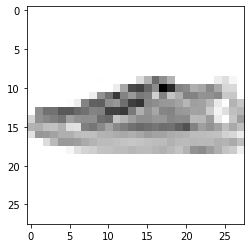

LABEL: 7
INPUT:


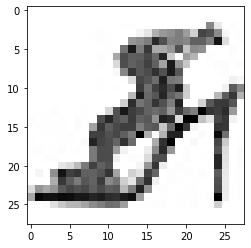

LABEL: 5
INPUT:


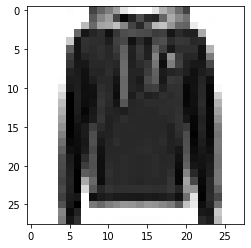

LABEL: 2
INPUT:


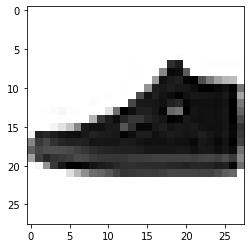

LABEL: 7
INPUT:


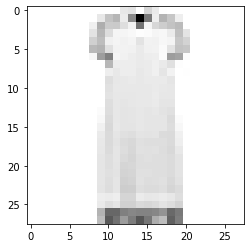

LABEL: 3
INPUT:


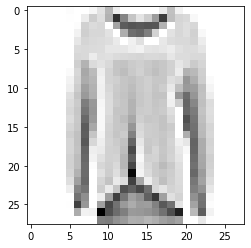

LABEL: 2
INPUT:


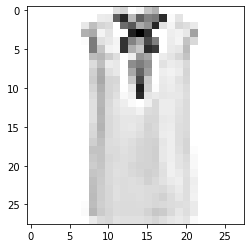

LABEL: 6
INPUT:


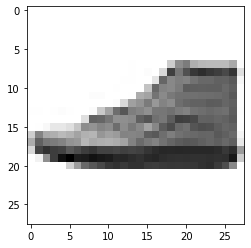

LABEL: 7
INPUT:


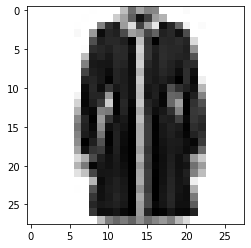

LABEL: 3
INPUT:


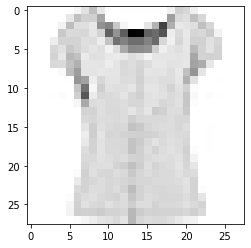

LABEL: 6
INPUT:


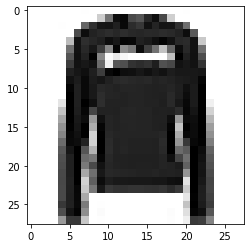

LABEL: 2
INPUT:


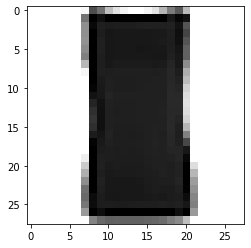

LABEL: 0
INPUT:


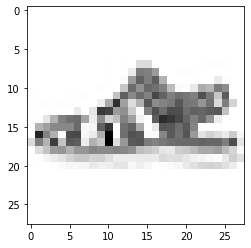

LABEL: 5
INPUT:


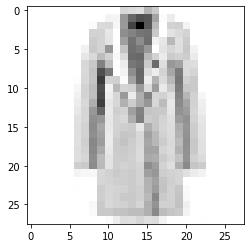

LABEL: 4
INPUT:


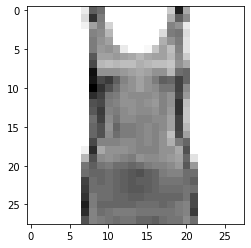

LABEL: 0
INPUT:


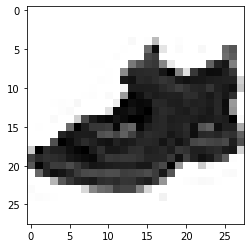

LABEL: 5
INPUT:


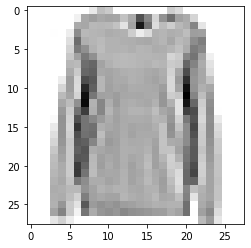

LABEL: 2
INPUT:


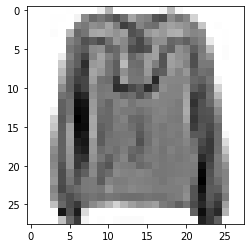

LABEL: 6
INPUT:


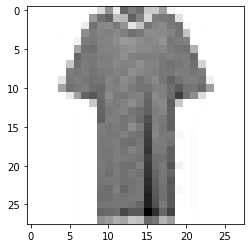

LABEL: 3
INPUT:


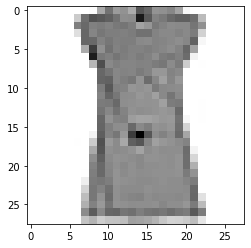

LABEL: 3
INPUT:


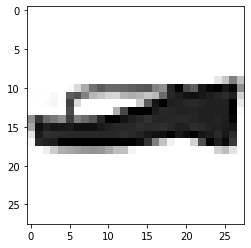

LABEL: 5
INPUT:


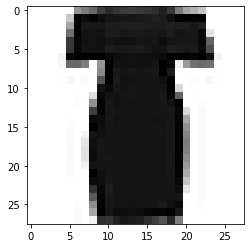

LABEL: 3
INPUT:


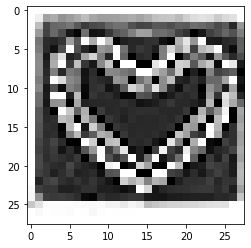

LABEL: 8
INPUT:


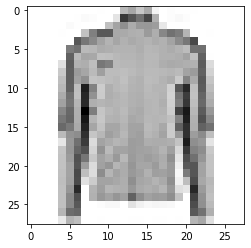

LABEL: 4
INPUT:


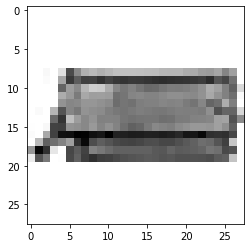

LABEL: 8
INPUT:


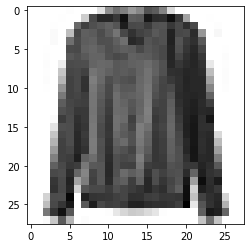

LABEL: 6
INPUT:


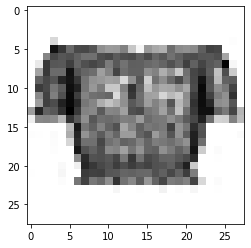

LABEL: 6
INPUT:


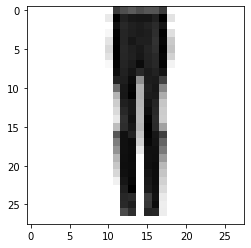

LABEL: 1
INPUT:


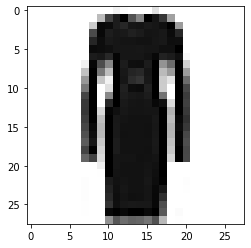

LABEL: 3
INPUT:


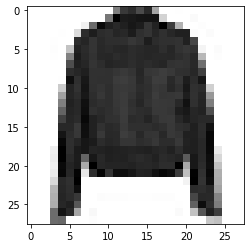

LABEL: 4
INPUT:


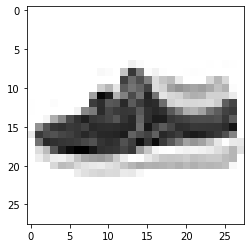

LABEL: 7
INPUT:


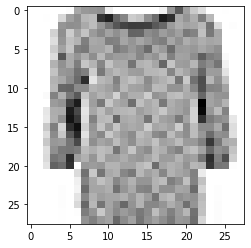

LABEL: 6
INPUT:


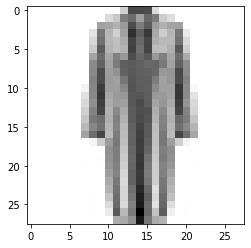

LABEL: 4
INPUT:


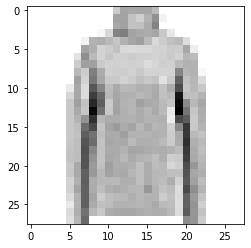

LABEL: 2
INPUT:


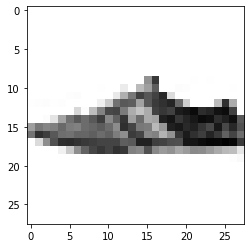

LABEL: 7
INPUT:


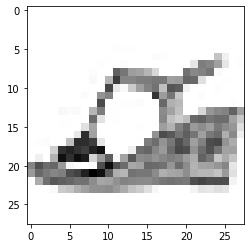

LABEL: 5
INPUT:


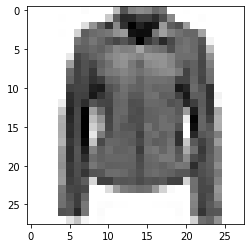

LABEL: 4
INPUT:


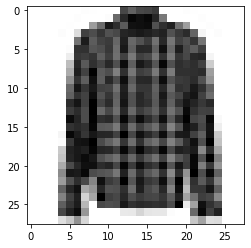

LABEL: 6
INPUT:


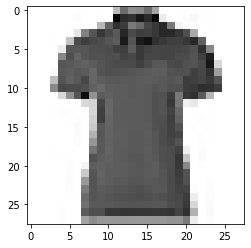

LABEL: 0
INPUT:


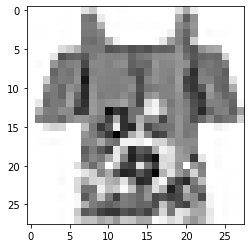

LABEL: 6
INPUT:


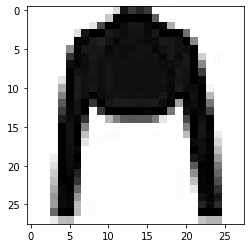

LABEL: 4
INPUT:


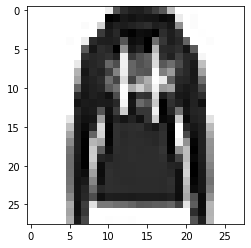

LABEL: 2
INPUT:


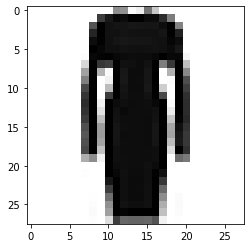

LABEL: 3
INPUT:


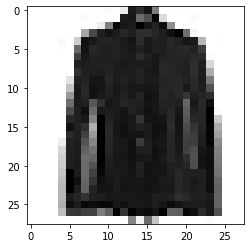

LABEL: 6
INPUT:


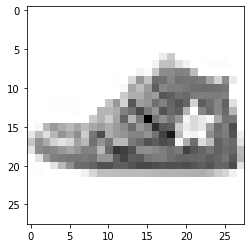

LABEL: 7
INPUT:


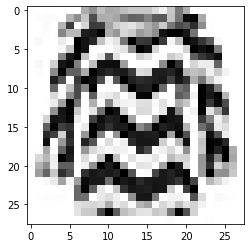

LABEL: 0
INPUT:


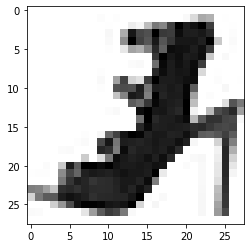

LABEL: 5
INPUT:


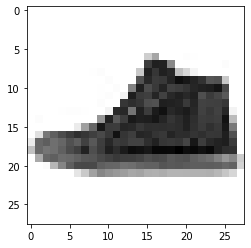

LABEL: 7
INPUT:


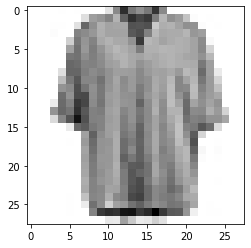

LABEL: 6
INPUT:


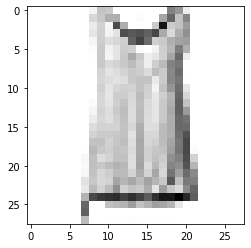

LABEL: 0
INPUT:


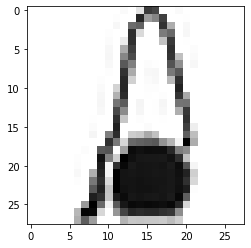

LABEL: 8
INPUT:


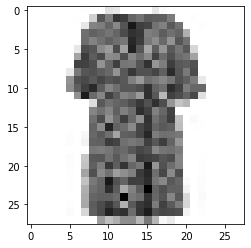

LABEL: 3
INPUT:


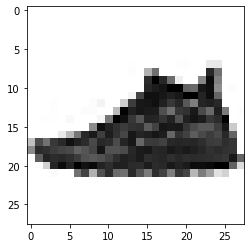

LABEL: 7
INPUT:


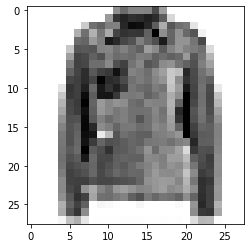

LABEL: 4
INPUT:


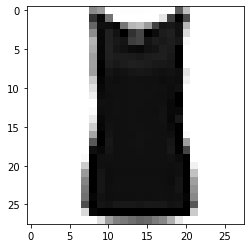

LABEL: 0
INPUT:


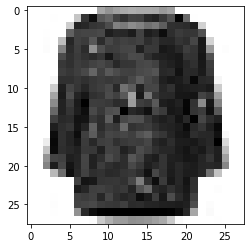

LABEL: 6
INPUT:


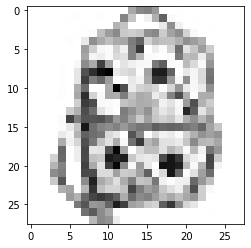

LABEL: 8
INPUT:


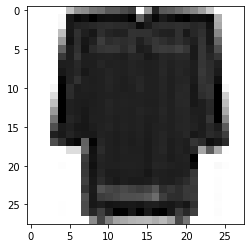

LABEL: 6
INPUT:


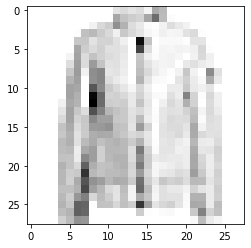

LABEL: 4
INPUT:


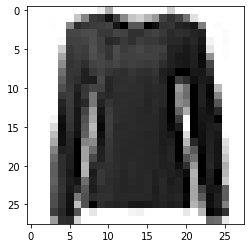

LABEL: 6
INPUT:


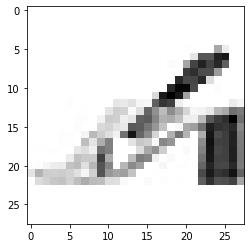

LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


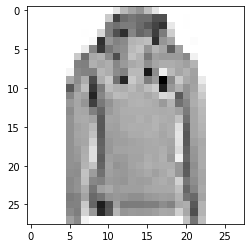

LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 8
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 8
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 0
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 9
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 9
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 0
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 1
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 9
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 9
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 8
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 3
INPUT:


LABEL: 7
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 2
INPUT:


LABEL: 3
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 8
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 4
INPUT:


LABEL: 2
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 2
INPUT:


LABEL: 4
INPUT:


LABEL: 7
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 6
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 1
INPUT:


LABEL: 6
INPUT:


LABEL: 3
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 6
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 3
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 5
INPUT:


LABEL: 2
INPUT:


LABEL: 9
INPUT:


LABEL: 4
INPUT:


LABEL: 4
INPUT:


LABEL: 0
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 7
INPUT:


LABEL: 6
INPUT:


LABEL: 7
INPUT:


LABEL: 0
INPUT:


LABEL: 4
INPUT:


LABEL: 9
INPUT:


LABEL: 2
INPUT:


LABEL: 5
INPUT:


LABEL: 4
INPUT:


LABEL: 6
INPUT:


LABEL: 5
INPUT:


LABEL: 3
INPUT:


LABEL: 3
INPUT:


LABEL: 2


6234

In [ ]:
mlp
best_mlp_large

y_pred_mlp = mlp.predict(X_test)
y_pred_mlp_large = best_mlp_large.predict(X_test)
count = 0
for i in range(len(y_test)):
    if y_pred_mlp[i] != y_test[i]:
        if y_pred_mlp_large[i] == y_test[i]:
            count +=1
            plot_input(X_test,y_test, i)
count

Let's plot some of the weigths of the multi-layer perceptron classifier, for the best NN we get with 500 data points and with 10000 data points. The code below plots the weights in a matrix form, where a figure represents all the weights of the edges entering in a hidden node. Notice that the code assumes that the NNs are called "mlp" and "best_mlp_large": you may need to replace such variables with your variable names. 



In [ ]:
print("Weights with 500 data points:")

fig, axes = plt.subplots(4, 4)
vmin, vmax = mlp.coefs_[0].min(), mlp.coefs_[0].max()
for coef, ax in zip(mlp.coefs_[0].T, axes.ravel()):
    ax.matshow(coef.reshape(28, 28), cmap=plt.cm.gray, vmin=.5 * vmin, vmax=.5 * vmax)
    ax.set_xticks(())
    ax.set_yticks(())

plt.show()

print("Weights with 10000 data points:")

fig, axes = plt.subplots(4, 4)
vmin, vmax = best_mlp_large.coefs_[0].min(), best_mlp_large.coefs_[0].max()
for coef, ax in zip(best_mlp_large.coefs_[0].T, axes.ravel()):
    ax.matshow(coef.reshape(28, 28), cmap=plt.cm.gray, vmin=.5 * vmin, vmax=.5 * vmax)
    ax.set_xticks(())
    ax.set_yticks(())
plt.show()

Weights with 500 data points:


Weights with 10000 data points:


## TO DO 9

Describe what do you observe by looking at the weights.

For weights with 10000 data points are better because we can see it is sharper than weights with 500 data points.

## TO DO 10

Pick another classifier among the ones we have seen previously (SVM or something else). Report the training and test error for such classifier with 10000 samples in the training set, if possible; if the classifier cannot run with so many data sample reduce the number of samples.

*Note*: if there are parameters to be optimized use cross-validation. If you choose SVM, you can decide if you want to use a single kernel or use the best among many; in the latter case, you need to pick the best kernel using cross-validation (using the functions available in sklearn).

**[Logistic Regression with parameters=(solver = 'liblinear', penalty = 'l1')]**

In [ ]:
from sklearn import linear_model

lr = linear_model.LogisticRegression(solver='liblinear', penalty='l1').fit(X_train, y_train)


training_error_other = 1. - lr.score(X_train, y_train)

test_error_other = 1. - lr.score(X_test, y_test)

print ('RESULTS FOR OTHER CLASSIFIER\n')

print ("Best training error (other model): %f" % training_error_other)
print ("Best test error (other model): %f" % test_error_other)

RESULTS FOR OTHER CLASSIFIER

Best training error (other model): 0.103200
Best test error (other model): 0.158460


## TO DO 11
Compare the results of NN and of the other classifier you have chosen above. Which classifier would you preferer? Provide a brief explanation.

Best NN's training error: 0.220100, test error: 0.220500 and Best logistic regression's training error: 0.103200, test error: 0.158460. Obviously, bot train and test error of logistic regression are better that NN's train and test errors. So, for this example, I prefer logistic regression because it is more appropriate for this example.

# Clustering with K-means

Clustering is a useful technique for *unsupervised* learning. We are now going to cluster 2000 images in the fashion MNIST dataset, and try to understand if the clusters we obtain correspond to the true labels.

In [ ]:
#load the required packages

from sklearn import metrics
from sklearn.cluster import KMeans

(Note that the code below assumes that the data has already been transformed as in the NN part of the notebook, so make sure to run the code for the transformation even if you do not complete the part on NN.)

In [ ]:
#let's consider only 2000 data points

X = X[permutation]
y = y[permutation]

m_training = 2000

X_train, X_test = X[:m_training], X[m_training:]
y_train, y_test = y[:m_training], y[m_training:]

## TO DO 1
Cluster the points using the KMeans() and fit() functions (see the userguide for details). For Kmeans, set: n_clusters=10 as number of clusters; n_init=10 as the number of times the algorithm will be run with different centroid seeds; random_state = ID. You can use the default setting for the other parameters.

In [ ]:
kmeans = KMeans(n_clusters=10, n_init=10, random_state=ID)

clf = kmeans.fit(X_train)

## Comparison of clusters with true labels

## TO DO 2
Now compare the obtained clusters with the true labels, using the function sklearn.metrics.cluster.contingency_matrix() (see the userguide for details). The function prints a matrix $A$ such that entry $A_{i,j}$ is is the number of samples in true class $i$ and in predicted class $j$.

In [ ]:
# compute and print the contingency matrix for the true labels vs the clustering assignments

y_pred = kmeans.predict(X_train)

metrics.cluster.contingency_matrix(y_train, y_pred)

array([[  2,   0,   0,   0,  63,  11, 128,   1,   2,   7],
       [  2,   0,   0,   0,  12, 174,   6,   0,   1,   0],
       [ 51,   0,   1,   0,  59,   1,   2,   1,   3,  64],
       [  4,   1,   0,   0,  24, 102,  49,   0,   4,   2],
       [103,   0,   1,   0,  35,   8,  18,   2,   3,  42],
       [  0,  10,   0,  56,   2,   0,   0,   0, 124,   0],
       [ 44,   0,   1,   0,  59,   5,  31,   2,  11,  39],
       [  0,  12,   0, 166,   0,   0,   0,   0,  26,   0],
       [  2,   0,  88,   9,  15,   1,   0,  76,  16,  11],
       [  1, 179,   0,  11,   2,   0,   0,   0,  12,   0]])

## TO DO 3
Based on the matrix shown above, comment on the results of clustering in terms of adherence to the true labels.

as we can see, the results are very bad because as can be seen from the table the clustring nearly did not predict any of samples.

## Choice of k with silhoutte coefficient
In many real applications it is unclear what is the correct value of $k$ to use. In practice one tries different values of $k$ and then uses some external score to choose a value of $k$. One such score is the silhoutte coefficient, that can be computed with metrics.silhouette_score(). See the definition of the silhoutte coefficient in the userguide.

## TO DO 4
Compute the clustering for k=2,3,...,15 (other parameters as above) and print the silhoutte coefficient for each such clustering.

In [ ]:
#run k-means with 10 choices of initial centroids for a range of values of n_clusters

for i in range(2,16):
    kmeans = KMeans(n_clusters=i, n_init=10, random_state=ID)
    clf = kmeans.fit(X_train)
    y_pred = kmeans.predict(X_train)
    silhouttescore = metrics.silhouette_score(X_train, y_pred)
    print("Silhoutte coefficient for number of clusters="+str(i)+": "+str(silhouttescore))

Silhoutte coefficient for number of clusters=2: 0.1941491366067133
Silhoutte coefficient for number of clusters=3: 0.1873106268978314
Silhoutte coefficient for number of clusters=4: 0.18510088092299598
Silhoutte coefficient for number of clusters=5: 0.16344380504853961
Silhoutte coefficient for number of clusters=6: 0.16026156485628756
Silhoutte coefficient for number of clusters=7: 0.16770749866443305
Silhoutte coefficient for number of clusters=8: 0.16526218652119629
Silhoutte coefficient for number of clusters=9: 0.1590009111387235
Silhoutte coefficient for number of clusters=10: 0.14635950532662156
Silhoutte coefficient for number of clusters=11: 0.14054915659135558
Silhoutte coefficient for number of clusters=12: 0.1382008395192617
Silhoutte coefficient for number of clusters=13: 0.13343983614428764
Silhoutte coefficient for number of clusters=14: 0.12397734233061854
Silhoutte coefficient for number of clusters=15: 0.12210569754778951


## TO DO 5

Based on the silhoutte score, which $k$ would you pick? Motivate your choice. Does your choice match what you know about the data? If yes, explain why you think this is the case; if no, explain what you think may be the reason.

We should pick 2 because best silhouette score is for k=2. It means our prediction is closest to being correct.